In [21]:
import ROOT as r
import math
import array
import os
import sys
import matplotlib.pyplot as plt
import numpy as np
from math import pi
import pandas as pd

#______________Add include directory_______________
current_dir = os.getcwd()
include_dir = os.path.join(current_dir, '../include')
sys.path.insert(0, include_dir)
#__________________________________________________
import ERROR
import CONFIG
import DBPARSE
from PXPY import *
from ASYMMETRY import *
from UTILITIES import *
from SIMFITS import DistributionFits
from ROOT import gStyle, TChain, TH1F, TCanvas, TLegend
import CORRECTIONS
import CALCULATE
import GETFF
from joblib import Parallel, delayed
import importlib
#importlib.reload(ASYMMETRY)

import matplotlib.colors as colors
from scipy.optimize import curve_fit

In [2]:
###############################################################################
###############################################################################

#NEEDS INELASTIC ASYMMETRY, NITROGEN CONTAMINATION

###############################################################################
###############################################################################

In [3]:
Pass="2"
config="4b"
generic=np.load(f"/media/research/TOSHIBA EXT/GEn/NumpyData/Pass{Pass}/GEN{config}/He3/final_2_{1}.npz")


W2min=CONFIG.Function_JSON("W2min",f"../config/Pass{Pass}/cuts{config}.cfg")
W2max=CONFIG.Function_JSON("W2max",f"../config/Pass{Pass}/cuts{config}.cfg")
dxmin=CONFIG.Function_JSON("dxmin",f"../config/Pass{Pass}/cuts{config}.cfg")
dxmax=CONFIG.Function_JSON("dxmax",f"../config/Pass{Pass}/cuts{config}.cfg")
dymin=CONFIG.Function_JSON("dymin",f"../config/Pass{Pass}/cuts{config}.cfg")
dymax=CONFIG.Function_JSON("dymax",f"../config/Pass{Pass}/cuts{config}.cfg")
hcalmin=CONFIG.Function_JSON("hcalmin",f"../config/Pass{Pass}/cuts{config}.cfg")

dybgmin=CONFIG.Function_JSON("dybgmin",f"../config/Pass{Pass}/cuts{config}.cfg")
dybgmax=CONFIG.Function_JSON("dybgmax",f"../config/Pass{Pass}/cuts{config}.cfg")
coinmin=CONFIG.Function_JSON("coinmin",f"../config/Pass{Pass}/cuts{config}.cfg")
coinmax=CONFIG.Function_JSON("coinmax",f"../config/Pass{Pass}/cuts{config}.cfg")
Q2=CONFIG.Function_JSON("Q2",f"../config/Pass{Pass}/cuts{config}.cfg")

#  "dxmin"	: -0.481,
#  "dxmax"	: 0.498, old gen2


print(f'W2min: {W2min}')
print(f'W2max: {W2max}')
print(f'dxmin: {dxmin}')
print(f'dxmax: {dxmax}')
print(f'dymin: {dymin}')
print(f'dymax: {dymax}')
print(f'dybgmin: {dybgmin}')
print(f'dybgmax: {dybgmax}')
print(f'Q2: {Q2}')
print(f'Coin Min: {coinmin} Coin Max: {coinmax}')

#W2min=-1.9
#dymin=-1
#W2max=2

W2min: -1
W2max: 1.9
dxmin: -0.403
dxmax: 0.406
dymin: -0.98
dymax: 0.98
dybgmin: -1.3
dybgmax: 1.2
Q2: 9.82
Coin Min: 181 Coin Max: 190


In [4]:
wscale=60
#coinscale
dyscale=60
dxscale=60
hcalscale=100

new_W2min=.87-33/wscale*2
new_W2max=.88+33/wscale
new_dxmin=-.1-9/dxscale
new_dxmax=.1+9/dxscale
new_dymin=-.1-24/dyscale
new_dymax=.1+24/dyscale
new_hcalmin=.025+30/hcalscale
new_coinmin=coinmin
new_coinmax=coinmax-2

In [5]:
#in GeV^2
m=.939565
Mp=.938
muN=-1.9103
mup=2.793

if config=="2":
    Q2=3
    tau=Q2/(4*m**2)
    theta=29.5*pi/180
if config=="3":
    Q2=6.83
    #Q2=6.62 #seans number
    tau=Q2/(4*m**2)
    theta=36.5*pi/180
if config=="4":
    Q2=9.82
    tau=Q2/(4*m**2)
    theta=35*pi/180

# Target Spin Direction

In [330]:
if config=="2":
    spintheta=59.34
    spinphi=1.84
if config=="3":
    spintheta=70.94
    spinphi=.51
if config=="4a":
    spintheta=74.07
    spinphi=.55
if config=="4b":
    spintheta=74.07
    spinphi=.55








fileNum=1
simconfig=config
if config=="4a" or config=="4b":
    simconfig="4"
genericSim=np.load(f"/media/research/TOSHIBA EXT/GEn/NumpySim/GEN{simconfig}/simulation0.npz")
genericSimIN=np.load(f"/media/research/TOSHIBA EXT/GEn/NumpySim/GEN4/insimulationNEW0.npz")

print(genericSim.files)
print(genericSimIN.files)



['nu', 'Q2', 'W2', 'vz', 'vx', 'vy', 'dx', 'dy', 'eSH', 'ePS', 'etheta', 'ephi', 'trP', 'fnucl', 'weight', 'eHCAL']
['nu', 'Q2', 'W2', 'vz', 'vx', 'vy', 'dx', 'dy', 'eSH', 'ePS', 'etheta', 'trP', 'fnucl', 'weight', 'mc_sig', 'mc_sigOld', 'mc_sigPol', 'mc_BETA', 'mc_THETA', 'eHCAL']


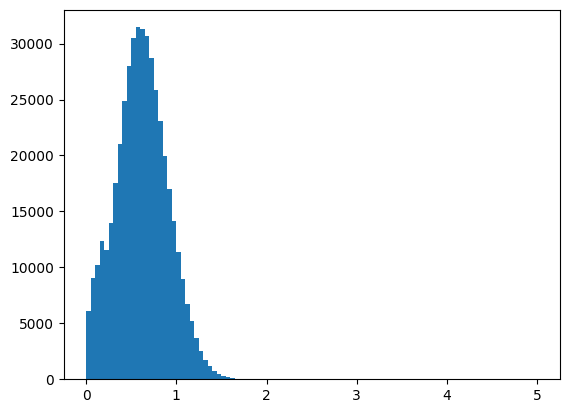

In [332]:
d=plt.hist(genericSim["eHCAL"],bins=100,range=(0,5))

In [8]:
#%load_ext memory_profiler
#%memit doit()


In [9]:
dataTarget = pd.read_csv('../DB/ProcessedHe3Pol.csv')
dataBeam = pd.read_csv('../DB/ProcessedBeamPol.csv')
target_run_num = dataTarget['Run Number'].to_numpy()

target_pol = dataTarget['Polarization'].to_numpy()

target_polE=dataTarget['Error'].to_numpy()
#target_pol=target_pol[~np.isnan(target_polE)]
#target_polE=target_polE[~np.isnan(target_polE)]
beam_run_num = dataBeam['Run Number'].to_numpy()
beam_pol = dataBeam['Polarization'].to_numpy()
beam_polE=dataBeam['Error'].to_numpy()
target_polE[np.isnan(target_polE)]=.05*target_pol[np.isnan(target_polE)]


In [10]:
print("hehe")

hehe


In [11]:
%%time
if(len(generic["dx"])<3000000):
    
    useGrinch=False

    
    genericMaster = {}
    base_dir = f"/media/research/TOSHIBA EXT/GEn/NumpyData/Pass{Pass}/GEN{config}/He3"
    i = 0
    print(f"NumPy array directory = {base_dir}")
    while os.path.exists(f"{base_dir}/final_2_{i}.npz"):
        print(f"Loading in file {i}")
        #if i>10:            #GPS
        #    break            #GPS
        file_path = f"{base_dir}/final_2_{i}.npz"
        data = np.load(file_path)

        cut=(data["ePS"]>0.2)
        if Pass=="2":
            grinchcut=(data["grinch_clus_size"]>=0)&(data["grinch_clus_trackindex"]==0)
            antigrinchcut=(data["grinch_clus_size"]<2)|(data["grinch_clus_trackindex"]!=0)
            pscut=(data["ePS"]>0) #GPS
            bbcalE=data["eSH"]+data["ePS"]
            gemP=data["trP"]
            
            epcut=bbcalE/gemP>.7 #GPS
            pscut=(data["ePS"]>0.2)
            #pscut=(data["ePS"]>0)
            if useGrinch:
                print("using grinch cut")
                #cut=antigrinchcut  #ANTIG
                cut=grinchcut
            else:
                print("using ps cut")
                cut=pscut&epcut#&grinchcut
        for key in data.files:
            if key not in genericMaster:
                cut_data = data[key][cut]
                genericMaster[key] = cut_data

            else:
                cut_data = data[key][cut]
                genericMaster[key] = np.concatenate((genericMaster[key], cut_data))

        data.close()
        i += 1

    print(f"Loaded {i} files into genericMaster.")


NumPy array directory = /media/research/TOSHIBA EXT/GEn/NumpyData/Pass2/GEN4b/He3
Loading in file 0
using ps cut
Loading in file 1
using ps cut
Loading in file 2
using ps cut
Loading in file 3
using ps cut
Loading in file 4
using ps cut
Loading in file 5
using ps cut
Loading in file 6
using ps cut
Loading in file 7
using ps cut
Loading in file 8
using ps cut
Loading in file 9
using ps cut
Loaded 10 files into genericMaster.
CPU times: user 9.97 s, sys: 3.76 s, total: 13.7 s
Wall time: 41.3 s


In [12]:
generic=genericMaster

In [13]:

wscale=60
#coinscale
dyscale=60
dxscale=60
hcalscale=100

new_W2min=.87-33/wscale*2
new_W2max=.88+33/wscale
new_dxmin=-.1-9/dxscale
new_dxmax=.1+9/dxscale
new_dymin=-.1-24/dyscale
new_dymax=.1+24/dyscale
new_hcalmin=.025+30/hcalscale
new_coinmin=coinmin
new_coinmax=coinmax-2

In [443]:
wcut=(generic["W2"] < new_W2max)&(generic["W2"]>new_W2min) 
dycut=(generic["dy"]<new_dymax)&(generic["dy"]>new_dymin) 
dxcut=(generic["dx"] < new_dxmax)&(generic["dx"]>new_dxmin) 
coincut=(new_coinmin < generic["coin_time"])&(generic["coin_time"] < new_coinmax)
bbcalE=generic["eSH"]+generic["ePS"]
gemP=generic["trP"]
epcut=bbcalE/gemP>.8
hcalecut=(generic["eHCAL"])>new_hcalmin
gcut=generic["grinch_clus_trackindex"]==0
fullcut=wcut & dycut & dxcut #& coincut&hcalecut
antidycut=abs(generic["dy"])>1.2
antidycutminus=generic["dy"]<-1.2
antidycutplus=generic["dy"]>1.2


sigma=genericSimIN["mc_sig"]
goodsig=sigma<3.3e-37

InSimw2cut=(genericSimIN["W2"] < new_W2max)&(genericSimIN["W2"]>new_W2min)
InSimdycut=(genericSimIN["dy"] < new_dymax)&(genericSimIN["dy"]>new_dymin)
Simw2cut=(genericSim["W2"] < new_W2max)&(genericSim["W2"]>new_W2min)
Simdycut=(genericSim["dy"] < new_dymax)&(genericSim["dy"]>new_dymin)
backgroundcut=InSimw2cut&InSimdycut&goodsig

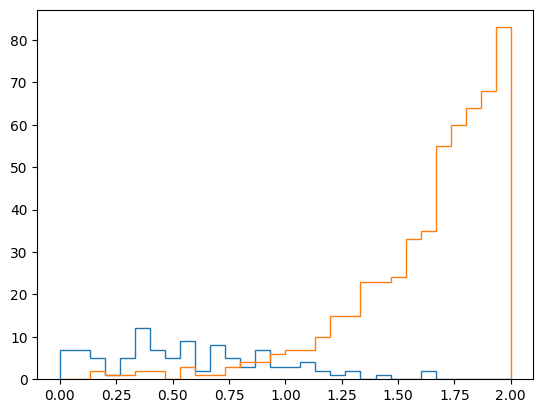

In [15]:
d=plt.hist(generic["W2"][antidycutplus&hcalecut&dxcut],
           histtype='step',bins=30,range=(0,2))
d=plt.hist(generic["W2"][antidycutminus&hcalecut&dxcut],
           histtype='step',bins=30,range=(0,2))

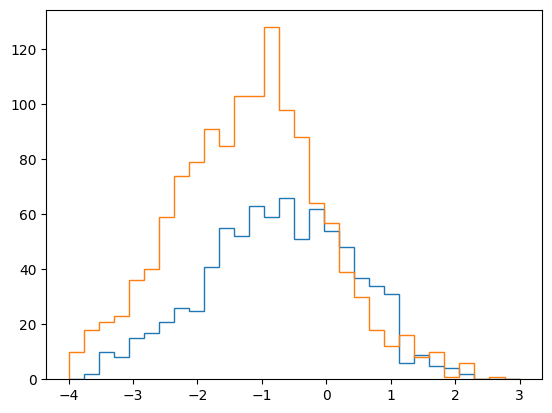

In [16]:
d=plt.hist(generic["dx"][antidycutplus&hcalecut&wcut],
           histtype='step',bins=30,range=(-4,3))
d=plt.hist(generic["dx"][antidycutminus&hcalecut&wcut],
           histtype='step',bins=30,range=(-4,3))

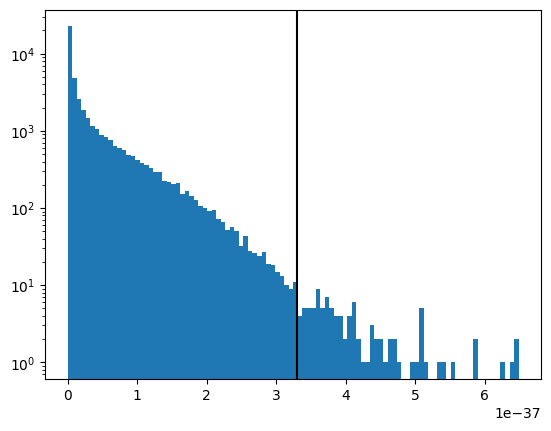

In [442]:
d=plt.hist(sigma,bins=100)
plt.yscale("log")
plt.axvline(3.3e-37,color='black')

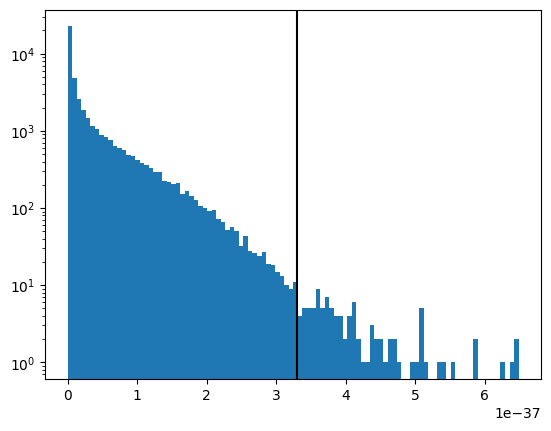

In [17]:
d=plt.hist(sigma,bins=100)
plt.yscale("log")
plt.axvline(3.3e-37,color='black')

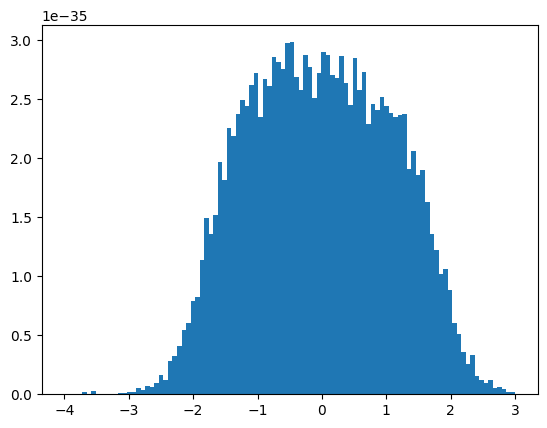

In [297]:
d=plt.hist(genericSimIN["dx"][goodsig],bins=100,range=(-4,3),
           weights=sigma[goodsig])


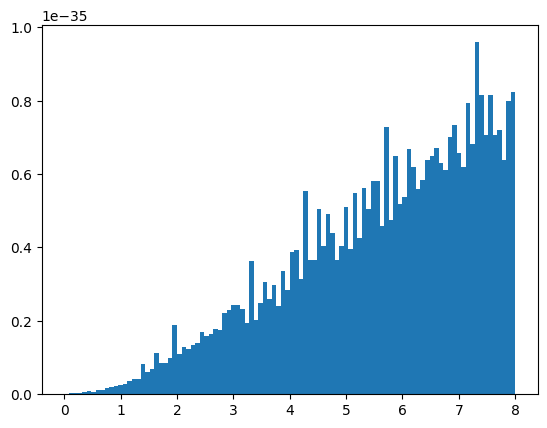

In [441]:
d=plt.hist(genericSimIN["W2"][goodsig],bins=100,range=(0,8),
           weights=sigma[goodsig])

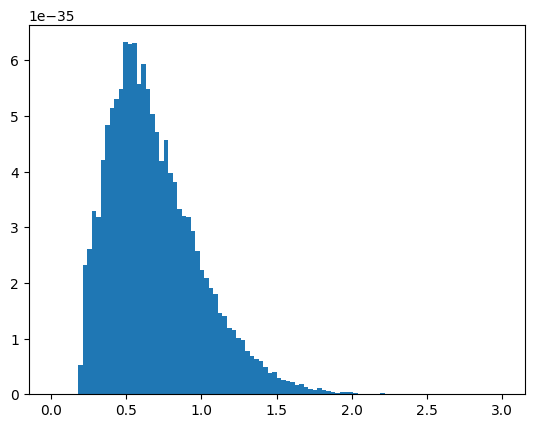

In [178]:
d=plt.hist(genericSimIN["ePS"][goodsig],bins=100,range=(0,3),
           weights=sigma[goodsig])

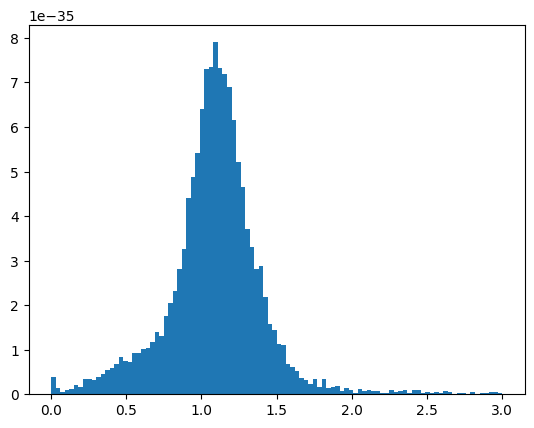

In [182]:
insimeoverp=(genericSimIN["ePS"]+genericSimIN["eSH"])/genericSimIN["trP"]
d=plt.hist(insimeoverp[goodsig],bins=100,range=(0,3),
           weights=sigma[goodsig])

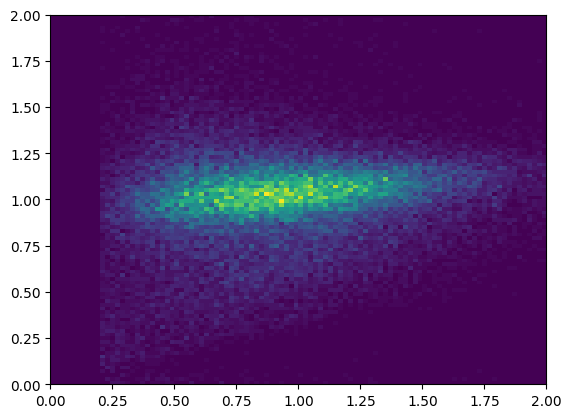

In [185]:
d=plt.hist2d(genericSimIN["ePS"][goodsig],insimeoverp[goodsig],bins=100,range=((0,2),(0,2)))

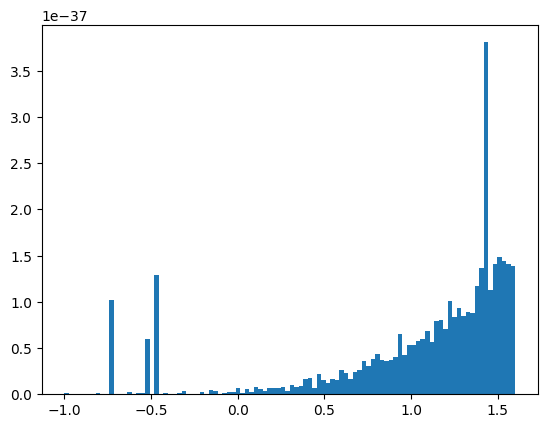

In [298]:
d=plt.hist(genericSimIN["W2"][goodsig&InSimdycut],bins=100,range=(-1,1.6),
           weights=sigma[goodsig&InSimdycut])

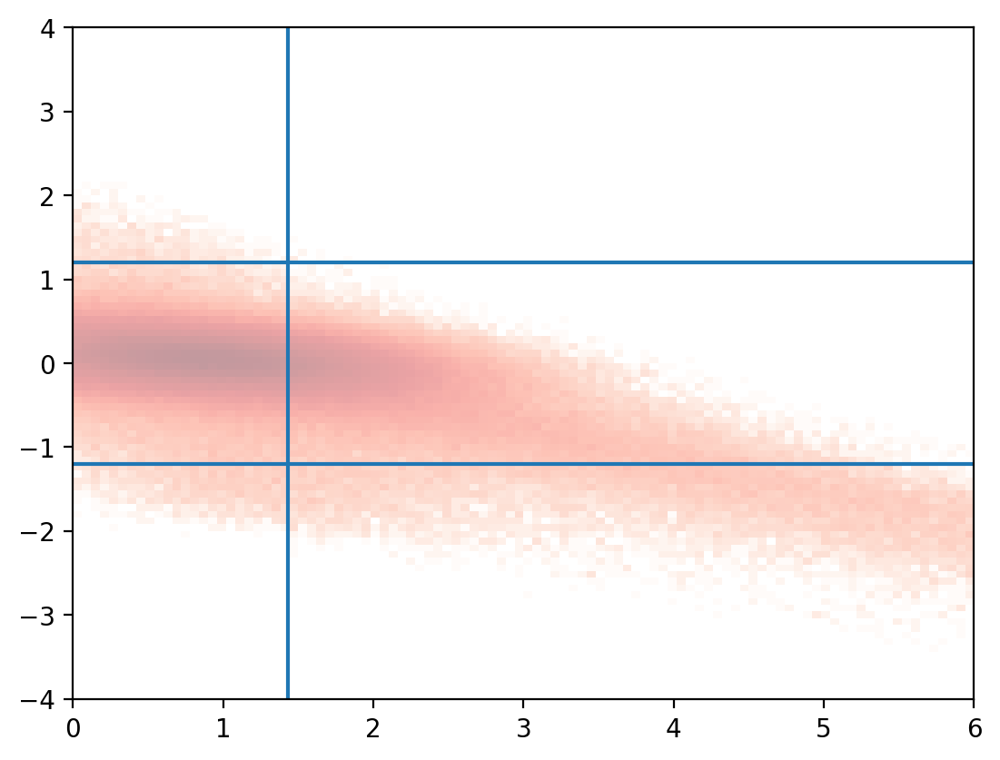

In [22]:
plt.figure(dpi=200)
#d=plt.hist2d(generic["W2"][coincut&hcalecut&dxcut],generic["dy"][coincut&hcalecut&dxcut],
#             cmap="Blues",bins=(100,100),range=((0,6),(-4,4))
#           ,norm=colors.LogNorm())
d=plt.hist2d(genericSim["W2"],genericSim["dy"],bins=(100,100),range=((0,6),(-4,4)),cmap="Reds",alpha=.4
            ,norm=colors.LogNorm())
plt.axvline(new_W2min)
plt.axvline(new_W2max)
plt.axhline(1.2)
plt.axhline(-1.2)

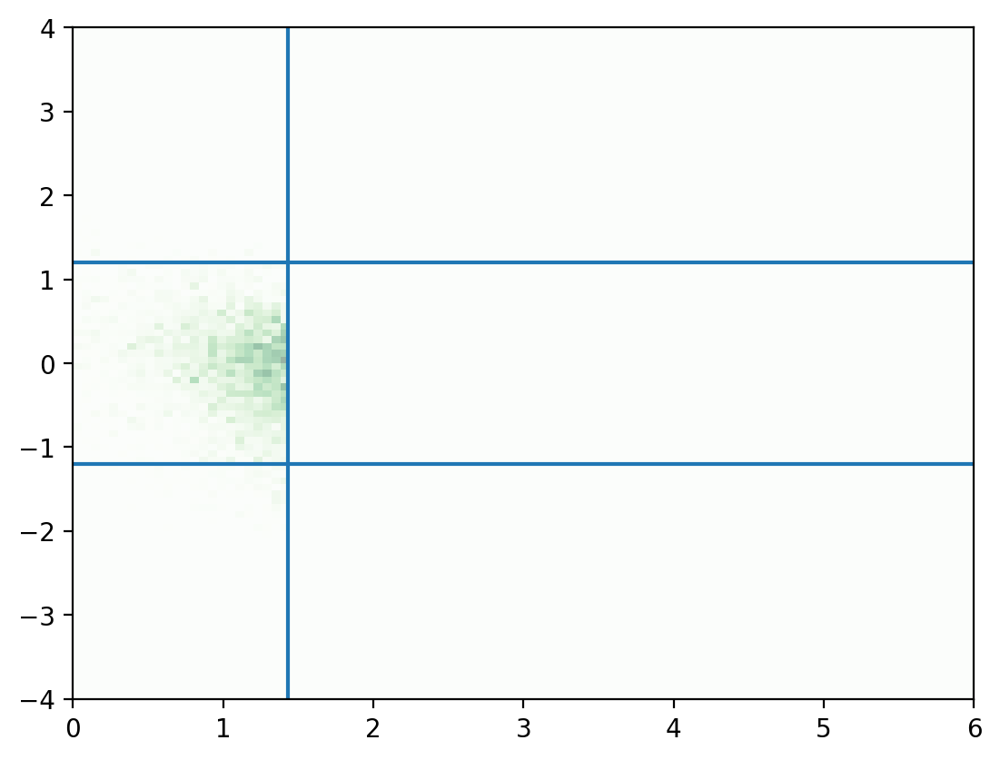

In [23]:
plt.figure(dpi=200)
#d=plt.hist2d(generic["W2"][coincut&hcalecut&dxcut],generic["dy"][coincut&hcalecut&dxcut],
#             cmap="Blues",bins=(100,100),range=((0,6),(-4,4))
#           ,norm=colors.LogNorm())
d=plt.hist2d(genericSimIN["W2"][goodsig&InSimw2cut],genericSimIN["dy"][goodsig&InSimw2cut],bins=(100,100),range=((0,6),(-4,4)),cmap="Greens",alpha=.4
            ,weights=sigma[goodsig&InSimw2cut])
plt.axvline(new_W2min)
plt.axvline(new_W2max)
plt.axhline(1.2)
plt.axhline(-1.2)

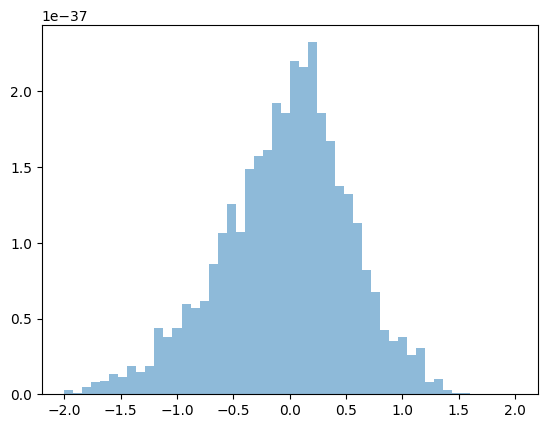

In [299]:
backgroundcut=InSimw2cut&goodsig
weight=genericSim["weight"]

d=plt.hist(genericSimIN["dy"][backgroundcut],range=(-2,2),bins=50,alpha=.5,weights=sigma[backgroundcut])
#d=plt.hist(genericSim["dy"][Simw2cut],range=(-2,2),bins=50,alpha=.5,weights=weight[Simw2cut])

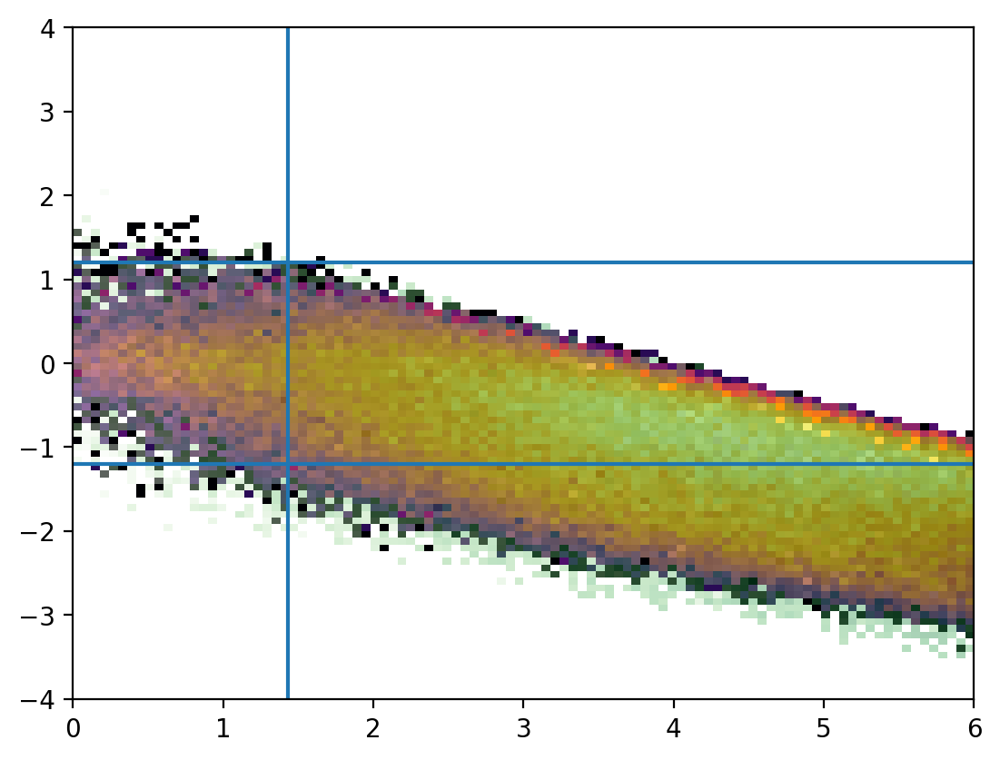

In [25]:
plt.figure(dpi=200)
d=plt.hist2d(generic["W2"][coincut&hcalecut&dxcut],generic["dy"][coincut&hcalecut&dxcut],
             cmap="inferno",bins=(100,100),range=((0,6),(-4,4))
           ,norm=colors.LogNorm())
#d=plt.hist2d(genericSim["W2"],genericSim["dy"],bins=(100,100),range=((0,6),(-4,4)),cmap="Reds",alpha=.4
#            ,norm=colors.LogNorm())

d=plt.hist2d(genericSimIN["W2"][goodsig],genericSimIN["dy"][goodsig],bins=(100,100),range=((0,6),(-4,4)),cmap="Greens",alpha=.4
            ,norm=colors.LogNorm(),weights=sigma[goodsig])
plt.axvline(new_W2min)
plt.axvline(new_W2max)
plt.axhline(1.2)
plt.axhline(-1.2)

In [ ]:
d=plt.hist2d(generic["eHCAL"][coincut],generic["dy"][coincut],bins=(100,100),range=((0,3),(-4,4)),
            norm=colors.LogNorm())

In [ ]:
import matplotlib.colors as colors
d=plt.hist2d(generic["ePS"][fullcut],generic["grinch_clus_size"][fullcut],
             bins=(100,14),range=((0,2),(0,15)),cmap='inferno')
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.patches import Ellipse
# Example data
x = generic["ePS"]
y = generic["grinch_clus_size"]

# Ellipse parameters
xc, yc = .9, 7     
a, b = .75*1.05, 7.20*1.05        
theta = 0              

# Elliptical mask: (x', y') in rotated coords
x_rot = (x - xc) * np.cos(theta) + (y - yc) * np.sin(theta)
y_rot = -(x - xc) * np.sin(theta) + (y - yc) * np.cos(theta)

ellipse_mask = (x_rot / a)**2 + (y_rot / b)**2 <= 1

# Apply mask
x_in = x[ellipse_mask]
y_in = y[ellipse_mask]

# Plot histogram of selected region
#plt.hist2d(x_in, y_in, bins=[100, 15], range=[[0, 2], [0, 15]], cmap='Blues',norm=colors.LogNorm(),alpha=1)
# Generate theta values for 180° to 270° (bottom-left quadrant)
t = np.linspace(np.pi, 1.5 * np.pi, 100)
t = np.linspace(0, 2 * np.pi, 500)
# Parametric ellipse
x = xc + a * np.cos(t) * np.cos(theta) - b * np.sin(t) * np.sin(theta)
y = yc + a * np.cos(t) * np.sin(theta) + b * np.sin(t) * np.cos(theta)

# Plot it
#lt.plot(x, y, color='magenta', linewidth=4, label='Ellipse lower-left')
plt.xlabel("ePS")
plt.ylabel("grinch_clus_size")
plt.axvline(.15,color="white")
#plt.axhline(1,color="white")
plt.title("GEN4a")
plt.show()



In [ ]:
bbcalE=generic["eSH"]+generic["ePS"]
gemP=generic["trP"]
plt.figure(dpi=200)

wcut=(generic["W2"] < new_W2max)&(generic["W2"]>new_W2min) 
dycut=(generic["dy"]<new_dymax)&(generic["dy"]>new_dymin) 
hcalecut=(generic["eHCAL"])>new_hcalmin

dxcut=(generic["dx"] < new_dxmax)&(generic["dx"]>new_dxmin) 
coincut=(new_coinmin < generic["coin_time"])&(generic["coin_time"] < new_coinmax)
fullcut=wcut & dycut & dxcut& coincut&hcalecut
d=plt.hist2d(generic["ePS"][fullcut],bbcalE[fullcut]/gemP[fullcut],
             bins=(50,50),range=((0,2),(0,1.5)),cmap='inferno')
#plt.axhline(.7)
#plt.axvline(.2)
#plt.axhline(1.05)
plt.ylabel("e/p")
plt.xlabel("bb.ps.e")
plt.title("GEN4b")

In [ ]:
d=plt.hist2d(generic["dx"][fullcut],bbcalE[fullcut]/gemP[fullcut],
             bins=(50,50),range=((-4,3),(0,1.5)),cmap='inferno')


In [ ]:
epcut=bbcalE/gemP>.8
plt.figure(dpi=200)

d=plt.hist(generic["ePS"][fullcut&~epcut],color='dodgerblue',
           label='Preshower with e/p<.8',histtype='step',bins=50,range=(0,2))
d=plt.hist(generic["ePS"][fullcut],histtype='step',color='black',
           label='Preshower',bins=50,range=(0,2))
d=plt.hist(generic["ePS"][fullcut&epcut],histtype='step',color='red',
           label='Preshower and e/p>.8',bins=50,range=(0,2))
plt.title("Preshower with and without e/p cuts GEN4b")
plt.xlabel("ps")
plt.legend(loc='upper right')

# Cuts

### Making the correct helicity

In [40]:
IHWP_IN=np.where(generic["IHWP"]==1)
helicity=generic["helicity"]
helicity[IHWP_IN]*=-1


### Cuts for data, bgsim, np sim 

In [308]:
bbcalE=generic["eSH"]+generic["ePS"]
gemP=generic["trP"]

wcut=(generic["W2"] < W2max)&(generic["W2"]>W2min) 
dycut=(generic["dy"]<dymax)&(generic["dy"]>dymin) 
dxcut=(generic["dx"] < dxmax)&(generic["dx"]>dxmin) 
coincut=(coinmin < generic["coin_time"])&(generic["coin_time"] < coinmax)
epcut=bbcalE/gemP>.8
runnumcut=generic["runnum"]>2165

fullcut=wcut & dycut & dxcut & coincut&runnumcut&epcut
fullcutfordx=wcut&dycut&coincut&runnumcut&epcut
accidentalcut=wcut&dycut&dxcut&runnumcut&epcut


anticoincut=(coinmin-8 > generic["coin_time"])|(generic["coin_time"] > coinmax+5)

hpluscut=helicity==1 #swapped for 4b
hminuscut=helicity==-1

bgcut=(genericSimIN["W2"] < W2max)&(genericSimIN["W2"]>W2min)
antibgcut=(abs(generic["dy"])>1.12)&wcut&coincut
antibgAcut=(abs(generic["dy"])>1.2)

Simwcut=(genericSim["W2"] < W2max)&(genericSim["W2"]>W2min) 
Simdycut=(abs(genericSim["dy"]) < 0.5) 
Simdxcut=(genericSim["dx"] < dxmax)&(genericSim["dx"]>dxmin) 
Simfullcut=Simwcut & Simdycut & Simdxcut

InSimdxcut=(genericSimIN["dx"] < dxmax)&(genericSimIN["dx"]>dxmin)
InSimdycut=(genericSimIN["dy"] < dymax)&(genericSimIN["dy"]>dymin)

protoncut=genericSim["fnucl"]==1
neutroncut=genericSim["fnucl"]==0
weight=genericSim["weight"]



sigma=genericSimIN["mc_sig"]
sigmaold=genericSimIN["mc_sigOld"]
sigmapol=genericSimIN["mc_sigPol"]
THETA=genericSimIN["mc_THETA"]
BETA=genericSimIN["mc_BETA"]
Q2_in=genericSimIN["Q2"]
nu_in=genericSimIN["nu"]
W2_in=genericSimIN["W2"]
x_in  = Q2_in/(2.0*Mp*nu_in)
dy_in=genericSimIN["dy"]
dx_in=genericSimIN["dx"]

dy_incut=(dy_in<dymax)&(dy_in>dymin)
bgcut=(W2_in<W2max)&(W2_in>W2min)#&(abs(dy_in) < 0.5)#&(sigma<1e-39)##&(Q2<6.1)#
sigmacut=(sigma>6e-39)
goodsigmacut=sigma<.4e-38

In [130]:
len(generic["dx"][fullcut&hpluscut]) #1501872

14316

In [131]:
len(generic["dx"][fullcut&hminuscut]) #1507945

14026

In [26]:
antibgcut=(abs(generic["dy"])>1.2)&wcut&coincut


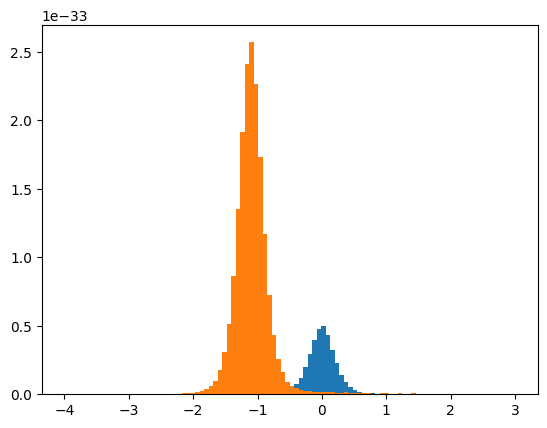

In [27]:
Simwcut=(genericSim["W2"] < new_W2max)&(genericSim["W2"]>new_W2min) 
Simdycut=(genericSim["dy"]<new_dymax)&(genericSim["dy"]>new_dymin)
Simfullcut=Simwcut & Simdycut
d=plt.hist(genericSim["dx"][Simfullcut&neutroncut],weights=weight[Simfullcut&neutroncut],bins=100,range=(-4,3))
d=plt.hist(genericSim["dx"][Simfullcut&protoncut],weights=weight[Simfullcut&protoncut],bins=100,range=(-4,3))

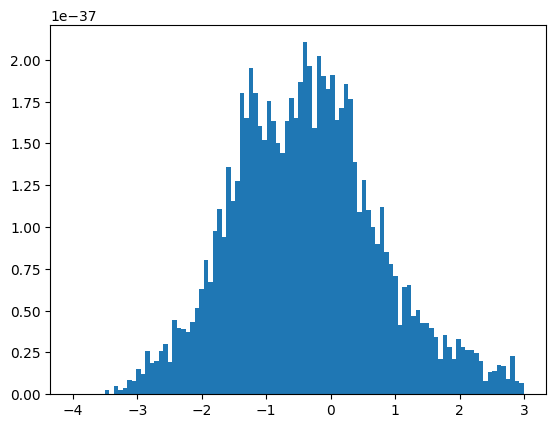

In [300]:
d=plt.hist(dx_in[bgcut&goodsigmacut],weights=sigma[bgcut&goodsigmacut],bins=100,range=(-4,3))

# Peak at Cut Variables

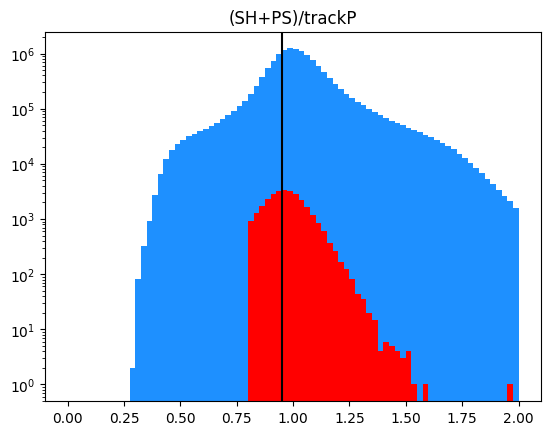

In [25]:
d=plt.hist(bbcalE/gemP,bins=80,range=(0,2),color='dodgerblue')
plt.axvline(.95,color='black')
plt.title("(SH+PS)/trackP")
d=plt.hist(bbcalE[epcut&fullcut]/gemP[epcut&fullcut],bins=80,range=(0,2),color='red')
plt.yscale("log")

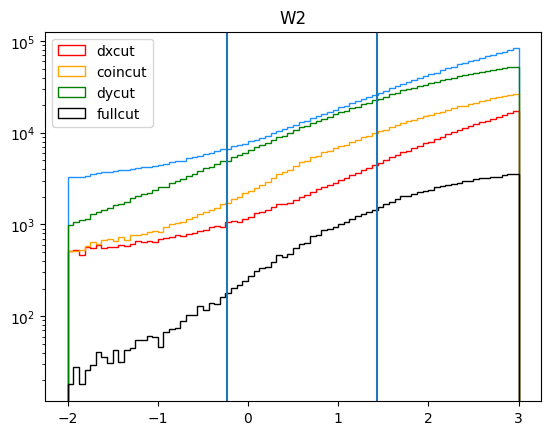

In [26]:
d=plt.hist(generic["W2"],bins=80,range=(-2,3),color='dodgerblue',histtype='step')
d=plt.hist(generic["W2"][dxcut],bins=80,range=(-2,3),color='red',label='dxcut',histtype='step')
d=plt.hist(generic["W2"][coincut],bins=80,range=(-2,3),color='orange',label='coincut',histtype='step')
d=plt.hist(generic["W2"][dycut],bins=80,range=(-2,3),color='green',label='dycut',histtype='step')
d=plt.hist(generic["W2"][dxcut&coincut&dycut],bins=80,range=(-2,3),color='black',label='fullcut',histtype='step')
plt.legend(loc='upper left')
plt.title("W2")
plt.yscale("log")
plt.axvline(new_W2min)
plt.axvline(new_W2max)

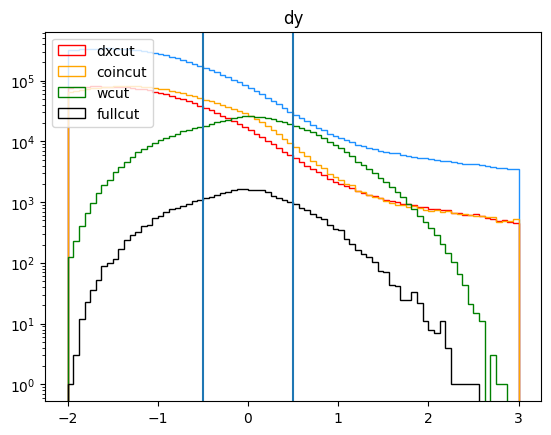

In [27]:
d=plt.hist(generic["dy"],bins=80,range=(-2,3),color='dodgerblue',histtype='step')
d=plt.hist(generic["dy"][dxcut],bins=80,range=(-2,3),color='red',label='dxcut',histtype='step')
d=plt.hist(generic["dy"][coincut],bins=80,range=(-2,3),color='orange',label='coincut',histtype='step')
d=plt.hist(generic["dy"][wcut],bins=80,range=(-2,3),color='green',label='wcut',histtype='step')
d=plt.hist(generic["dy"][dxcut&coincut&wcut],bins=80,range=(-2,3),color='black',label='fullcut',histtype='step')
plt.legend(loc='upper left')
plt.title("dy")
plt.yscale("log")
plt.axvline(new_dymin)
plt.axvline(new_dymax)

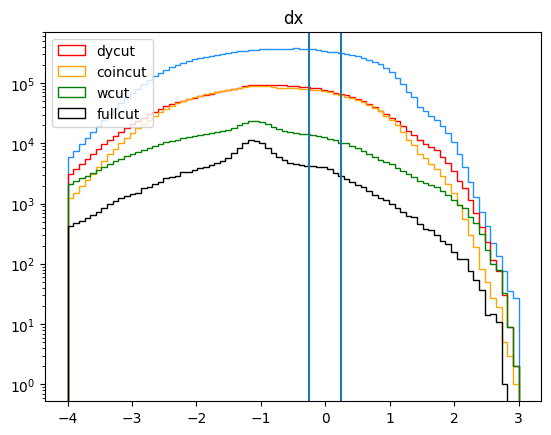

In [28]:
d=plt.hist(generic["dx"],bins=80,range=(-4,3),color='dodgerblue',histtype='step')
d=plt.hist(generic["dx"][dycut],bins=80,range=(-4,3),color='red',label='dycut',histtype='step')
d=plt.hist(generic["dx"][coincut],bins=80,range=(-4,3),color='orange',label='coincut',histtype='step')
d=plt.hist(generic["dx"][wcut],bins=80,range=(-4,3),color='green',label='wcut',histtype='step')
d=plt.hist(generic["dx"][dycut&coincut&wcut],bins=80,range=(-4,3),color='black',label='fullcut',histtype='step')
plt.legend(loc='upper left')
plt.title("dx")
plt.yscale("log")
plt.axvline(new_dxmin)
plt.axvline(new_dxmax)

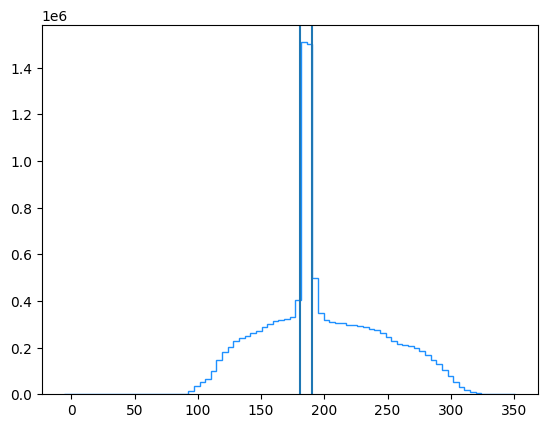

In [29]:
d=plt.hist(generic["coin_time"],bins=80,color='dodgerblue',histtype='step')
plt.axvline(coinmin)
plt.axvline(coinmax)
#plt.yscale("log")

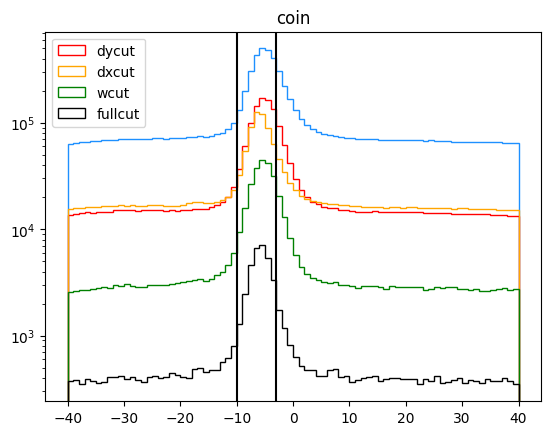

In [30]:
d=plt.hist(generic["coin_time"]-191,bins=80,range=(-40,40),color='dodgerblue',histtype='step')
d=plt.hist(generic["coin_time"][dycut]-191,bins=80,range=(-40,40),color='red',label='dycut',histtype='step')
d=plt.hist(generic["coin_time"][dxcut]-191,bins=80,range=(-40,40),color='orange',label='dxcut',histtype='step')
d=plt.hist(generic["coin_time"][wcut]-191,bins=80,range=(-40,40),color='green',label='wcut',histtype='step')
d=plt.hist(generic["coin_time"][dycut&wcut&dxcut]-191,bins=80,range=(-40,40),color='black',label='fullcut',histtype='step')
plt.legend(loc='upper left')
plt.title("coin")
plt.yscale("log")
plt.axvline(coinmin-191,color='black')
plt.axvline(coinmax-2-191,color='black')



In [223]:
new_coinmax

188

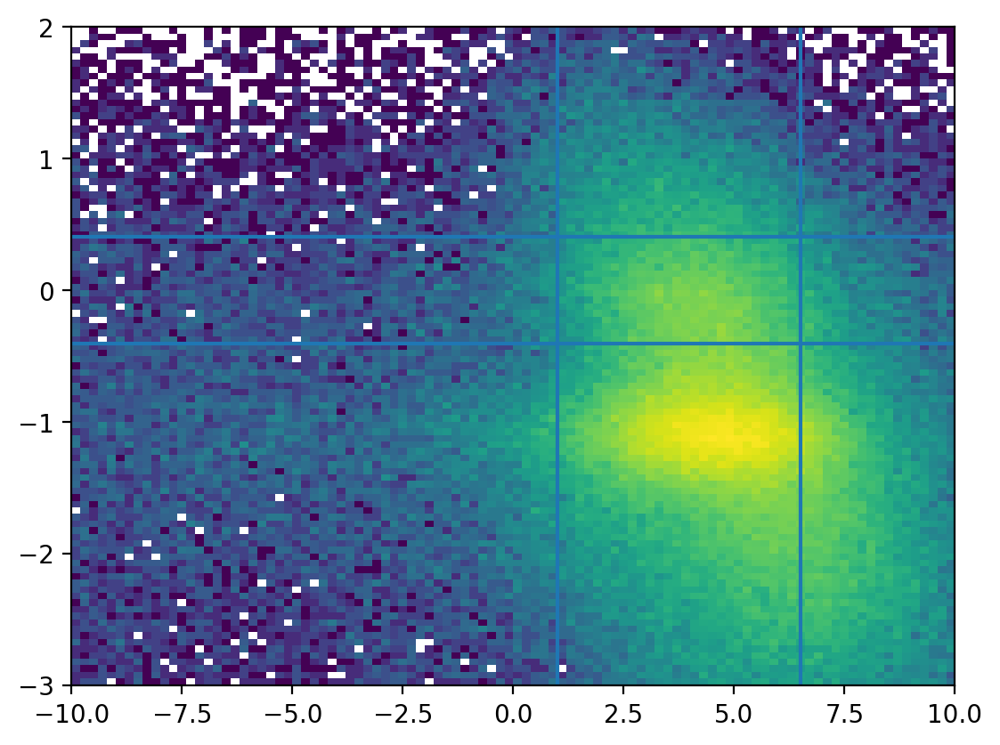

In [233]:
plt.figure(dpi=200)
d=plt.hist2d(generic["coin_time"][wcut&dycut]-181,generic["dx"][wcut&dycut],
             bins=(100,100),range=((-10,10),(-3,2)),norm=colors.LogNorm())
plt.axvline(new_coinmin+1-181)
plt.axvline(new_coinmax-.5-181)
plt.axhline(dxmin)
plt.axhline(dxmax)

# Entire Analysis

In [495]:

def weighted_avg(values, errors):
    values = np.asarray(values)
    errors = np.asarray(errors)
    
    mask = (errors > 0) & np.isfinite(errors)
    if not np.any(mask):
        raise ValueError("No valid data points: all errors are zero, negative, or non-finite.")

    weights = 1 / errors[mask]**2
    avg = np.sum(values[mask] * weights) / np.sum(weights)
    err = np.sqrt(1 / np.sum(weights))
    
    return avg, err


def calculate_Aphys_with_error(epsilon_bar, tau_bar, Lambda, Px_bar, Pz_bar, dLambda):
    """
    Calculate A_phys and its uncertainty from Lambda.

    Parameters:
    epsilon_bar : float
    tau_bar : float
    Lambda : float
    Px_bar : float
    Pz_bar : float
    dLambda : float
        Uncertainty in Lambda

    Returns:
    A_phys : float
    dA_phys : float
        Uncertainty in A_phys
    """
    E = epsilon_bar
    T = tau_bar
    L = Lambda
    Px = Px_bar
    Pz = Pz_bar

    sqrt_term = np.sqrt((2 * E * (1 - E)) / T)
    denom = 1 + (E / T) * L**2
    num = L * sqrt_term * Px + np.sqrt(1 - E**2) * Pz

    A_phys = -num / denom

    # Derivatives for error propagation
    d_num_dL = sqrt_term * Px
    d_denom_dL = 2 * (E / T) * L

    dA_dLambda = -(d_num_dL * denom - num * d_denom_dL) / denom**2
    dA_phys = abs(dA_dLambda) * dLambda

    return A_phys, dA_phys

    mup=2.793
    Q2=CONFIG.Function_JSON("Q2",f"../config/cuts{config}.cfg")
def load_data(file_path):
    """
    Load the data from the given file path into a pandas DataFrame.
    """
    columns = ["Q2", "GEp/GD", "dGEp/GD", "dGEp_Par/GD", "GMp/mu_p/GD", "dGMp/mu_p/GD", "dGMp_Par/mu_p/GD"]
    data = pd.read_csv(file_path, delim_whitespace=True, comment='#', names=columns)
    return data
def find_closest_row(data, input_Q2):
    """
    Find the row in the data with the Q2 value closest to the input_Q2.
    """
    closest_row = data.iloc[(data['Q2'] - input_Q2).abs().argmin()]
    return closest_row
def main(input_Q2):
    file_path = '../DB/proton_lookup.dat'
    data = load_data(file_path)
    closest_row = find_closest_row(data, input_Q2)
    return closest_row

def propagate_errorAP(Ap, dAp, Pp, dPp, P_beam, dP_beam, P_target, dP_target):
    f = (Ap * Pp * P_beam * P_target) 
    rel_error_squared = (
        (dAp / Ap)**2 +
        (dPp / Pp)**2 +
        (dP_beam / P_beam)**2 +
        (dP_target / P_target)**2
    )
    df = f * np.sqrt(rel_error_squared)
    return f, df


if config=="2":
    Lower=-5
    Upper=2

else:
    Lower=-4.5
    Upper=3

def Function_Fitdx(wcut,dycut,dxcut,coincut,gcut,fullcutfordx,protoncut,
                  neutroncut,pscut,epcut,hcalecut,Simwcut,Simdycut,bgcut,weight,dxmin,dxmax,hcalmin,psmin,extracut):
    
    antibgcut=(generic["dy"]<-1.12)&wcut&coincut&pscut&epcut&hcalecut
    #antibgcut=(abs(generic["dy"])>1.12)&wcut&coincut&pscut&epcut&hcalecut
    
    
    
    sigma=genericSimIN["mc_sig"]
    goodsig=sigma<3.3e-37
    InSimw2cut=(genericSimIN["W2"] < new_W2max)&(genericSimIN["W2"]>new_W2min)
    InSimdycut=(genericSimIN["dy"] < new_dymax)&(genericSimIN["dy"]>new_dymin)
    backgroundcut=InSimw2cut&InSimdycut&goodsig
    counts_p, bin_edges = np.histogram(genericSim["dx"][protoncut&Simwcut&Simdycut],   ####.065
                                       bins=100, range=(Lower, Upper),
                                       weights=weight[protoncut&Simwcut&Simdycut])

    counts_n, _         = np.histogram(genericSim["dx"][neutroncut&Simwcut&Simdycut],
                                       bins=bin_edges,
                                       weights=weight[neutroncut&Simwcut&Simdycut])
    #bgcut:  [bgcut&(goodsigmacut)]
    counts_bg,_         = np.histogram(dx_in[backgroundcut],
                                       bins=bin_edges,weights=sigma[backgroundcut])
    #counts_bg,_         = np.histogram(dx_in[bgcut&(goodsigmacut)],
    #                                   bins=bin_edges,weights=sigmaold[bgcut&(goodsigmacut)])
    counts_bg,_         = np.histogram(generic["dx"][antibgcut],
                                       bins=bin_edges)

    counts_data, _      = np.histogram(generic["dx"][fullcutfordx], bins=bin_edges)


    counts_p = counts_p.astype(float)
    counts_n = counts_n.astype(float)
    counts_bg = counts_bg.astype(float)
    #counts_acc = counts_acc.astype(float)
    counts_data = counts_data.astype(float)
    bin_centers = (bin_edges[:-1] + bin_edges[1:]) / 2
    shape=("from data")
    if config=="2":
        shape=("from data")
    fit_obj = DistributionFits(bg_shape_option=shape)
    fit_obj.hdx_data = [bin_centers, counts_data]
    fit_obj.hdx_sim_p = [bin_centers, counts_p]
    fit_obj.hdx_sim_n = [bin_centers, counts_n]
    fit_obj.hdx_bg_data = [bin_centers, counts_bg] 
    #fit_obj.hdx_acc_data = [bin_centers, counts_acc] 


    if shape=="from data+acc":
        bg_fit, total_fit, sim_p_scaled, sim_n_scaled,pop0,pop1,pop2,pop3,scale,acc_fit= fit_obj.He3_fit_dists(True)
    else:
        bg_fit, total_fit, sim_p_scaled, sim_n_scaled,pop0,pop1,pop2,scale= fit_obj.He3_fit_dists(True)

    return bg_fit,total_fit,sim_p_scaled,sim_n_scaled,bin_centers,counts_data
def Function_Plotdx(bg_fit,total_fit,sim_p_scaled,sim_n_scaled,bin_centers,counts_data,dxmin,dxmax):
    # Style config
    import matplotlib.pyplot as plt
    from matplotlib.lines import Line2D
    from matplotlib.patches import Patch
    fig, ax = plt.subplots(figsize=(10, 8))
    lw = 1.4
    l = 3
    fs = 16
    fw = 'bold'
    a = 1  # transparency for bars
    bin_width = bin_centers[1] - bin_centers[0]

    # Optional override
    if config == "2":
        lw = 1
        l = 3
        typ = "4th Order Poly"
    else:
        typ = "Background Data"



    # --------- Total Fit ---------hatch='///',
    ax.bar(bin_centers, total_fit, width=bin_width, align='center', alpha=0.7, color='orange', label="MC Fit = MC + Background")
    ax.plot(bin_centers, total_fit, '--', color='black', linewidth=lw)

    # --------- Inelastic ---------
    ax.bar(bin_centers, bg_fit, width=bin_width, align='center', alpha=0.7, color='magenta', label="MC Inelastic")
    ax.plot(bin_centers, bg_fit, '--', color='black', linewidth=lw)

    # --------- Accidental ---------
    #ax.bar(bin_centers, acc_fit, width=bin_width, align='center', alpha=0.5, color='magenta', label="MC Inelastic")
    #ax.plot(bin_centers, acc_fit, '--', color='black', linewidth=lw)

    # --------- Sim Proton ---------
    ax.bar(bin_centers, sim_p_scaled, width=bin_width, align='center', alpha=0.7, color='red', label="MC Proton")
    ax.plot(bin_centers, sim_p_scaled, '--', color='black', linewidth=lw)

    # --------- Sim Neutron ---------
    ax.bar(bin_centers, sim_n_scaled, width=bin_width, align='center', alpha=0.7, color='dodgerblue', label="MC Neutron")
    ax.plot(bin_centers, sim_n_scaled, '--', color='black', linewidth=lw)

    # --------- Data Line ---------
    ax.bar(bin_centers, counts_data, width=bin_width, align='center', alpha=.01, color='white',label="Data")
    ax.plot(bin_centers, counts_data, '-', color='grey',alpha=.8, linewidth=l, label='Data')

    # --------- Custom Legend ---------
    legend_elements = [
        Line2D([0], [0], color='grey', linewidth=3, linestyle='-', label='Data'),
        Patch(facecolor='orange', edgecolor='black', linestyle='--', label='MC Fit = MC + Background', alpha=a),
        Patch(facecolor='magenta', edgecolor='black', linestyle='--', label='Background Data', alpha=a),
        Patch(facecolor='red', edgecolor='black', linestyle='--', label='MC Proton', alpha=a),
        Patch(facecolor='dodgerblue', edgecolor='black', linestyle='--', label='MC Neutron', alpha=a)
    ]
    ax.legend(handles=legend_elements, loc='upper right', fontsize=fs)
    # --------- Labels, ticks, etc. ---------
    ax.set_title(f'Data/Simulation Comparison for GEN{config}: Δx (m)', fontsize=fs, fontweight=fw)
    ax.set_xlabel(r'$\Delta x$ (m)', fontsize=fs, fontweight=fw)
    ax.set_ylabel('Entries', fontsize=fs, fontweight=fw)
    ax.tick_params(axis='both', labelsize=fs-4)
    plt.xticks(fontsize=fs-4, fontweight=fw)
    plt.yticks(fontsize=fs-4, fontweight=fw)
    plt.tight_layout()
    #plt.yscale("log")
    plt.axvline(dxmin,color='black')
    plt.axvline(dxmax,color='black')
    # --------- Save and show ---------
    #plt.savefig(f'../plots/DataSimPass{pas}GEN{config}.png')
    plt.show()

    # Optional: Check total counts
    print("Total entries in fit:", np.sum(total_fit))



def Function_Acc(W2min,W2max,coinmin,coinmax,dymin,dymax,dxmin,dxmax,hcalmin,psmin,epcut,ShowPlots=False):
    wcut=(generic["W2"] < W2max)&(generic["W2"]>W2min) 
    dycut=(generic["dy"]<dymax)&(generic["dy"]>dymin) 
    dxcut=(generic["dx"] < dxmax)&(generic["dx"]>dxmin) 
    hcalcut=generic["eHCAL"]>hcalmin
    pscut=(generic["ePS"]>psmin)
    accidentalcut=wcut&dycut&dxcut&epcut&runnumcut&hcalcut&pscut
    anticoincut=(coinmin-8 > generic["coin_time"])|(generic["coin_time"] > coinmax+5)
    coincut=(coinmin < generic["coin_time"])&(generic["coin_time"] < coinmax)
    
    accBinRange=40
    #plt.figure(figsize=(8,6),dpi=200)
    coin_hist,coin_edges=np.histogram(generic["coin_time"][accidentalcut],
                                      bins=100,range=(coinmin-accBinRange,coinmax+accBinRange))
    coin_centers= (coin_edges[:-1] + coin_edges[1:]) / 2
    if ShowPlots:
        plt.figure(dpi=200)
        d=plt.hist(generic["coin_time"][accidentalcut],
                   bins=100,range=(coinmin-accBinRange,coinmax+accBinRange),color='orange',alpha=.4)
        plt.plot(coin_centers, coin_hist,'--',color='black',linewidth=1)

        plt.title(f"Cointime HCal-BBCal (ADC) GEN{config}")

        plt.axvline(coinmin,color='black')
        plt.axvline(coinmax,color='black')
        plt.axvspan(coinmin, coinmax, color='red', alpha=0.2)

        plt.axvline(coinmin+20,color='black')
        plt.axvline(coinmax+20,color='black')
        plt.axvspan(coinmin+20, coinmax+20, color='dodgerblue', alpha=0.3)

        plt.axvline(coinmin-20,color='black')
        plt.axvline(coinmax-20,color='black')
        plt.axvspan(coinmin-20, coinmax-20, color='dodgerblue', alpha=0.3)
        plt.xlabel("[ns]")

        #plt.yscale("log")
    outside_coin_right=(coin_centers >= coinmin+25) & (coin_centers <= coinmax+25)
    outside_coin_left=(coin_centers >= coinmin-25) & (coin_centers <= coinmax-25)
    inside_coin=(coin_centers >= coinmin) & (coin_centers <= coinmax)

    outside_number=(np.sum(coin_hist[outside_coin_right])+np.sum(coin_hist[outside_coin_left]))/2
    inside_number=(np.sum(coin_hist[inside_coin]))

    f_acc=outside_number/inside_number
    f_acc_error=f_acc * math.sqrt(1 / outside_number + 1 / inside_number)

    plus_coin_hist,plus_coin_edges=np.histogram(generic["coin_time"][anticoincut&accidentalcut&hpluscut],bins=100,range=(coinmin-30,coinmax+60))
    minus_coin_hist,minus_coin_edges=np.histogram(generic["coin_time"][anticoincut&accidentalcut&hminuscut],bins=100,range=(coinmin-30,coinmax+60))
    if ShowPlots:
        deez_hist,deez_edges=np.histogram(generic["coin_time"][wcut&dycut&dxcut&hcalcut&anticoincut],bins=100,
                range=(coinmin-30,coinmax+60))
        deez_centers= (deez_edges[:-1] + deez_edges[1:]) / 2
        plt.figure(dpi=200)
        plt.yscale("log")
        plt.title(f"Cointime HCal-BBCal (ADC) GEN{config}")
        plt.hist(generic["coin_time"][wcut&dycut&dxcut&hcalcut&anticoincut],bins=100,
                range=(coinmin-30,coinmax+60),color="dodgerblue",alpha=.5,label="Asymmetry Region")
        plt.plot(deez_centers, deez_hist,'--',color='black',linewidth=1)
        plt.xlabel("[ns]")
        deez_hist,deez_edges=np.histogram(generic["coin_time"][wcut&dycut&dxcut&hcalcut&coincut],bins=100,
                range=(coinmin-30,coinmax+60))
        deez_centers= (deez_edges[:-1] + deez_edges[1:]) / 2
        plt.hist(generic["coin_time"][wcut&dycut&dxcut&hcalcut&coincut],bins=100,
                range=(coinmin-30,coinmax+60),color="orange",alpha=.5,label="Coincidence Region")
        plt.plot(deez_centers, deez_hist,'--',color='black',linewidth=1)
        plt.legend(loc='upper right')
        
        plt.figure(dpi=200)
        plt.title(f"Cointime HCal-BBCal (ADC) GEN{config}")
        plt.xlabel("[ns]")
        deez_hist,deez_edges=np.histogram(generic["coin_time"][wcut&dycut&dxcut&hcalcut],bins=100,
                range=(coinmin-15,coinmax+15))
        deez_centers= (deez_edges[:-1] + deez_edges[1:]) / 2
        plt.hist(generic["coin_time"][wcut&dycut&dxcut&hcalcut],bins=100,
                range=(coinmin-15,coinmax+15),color="orange",alpha=.5)
        plt.plot(deez_centers, deez_hist,'--',color='black',linewidth=1)
    coin_plus_total = np.sum(plus_coin_hist)
    coin_minus_total = np.sum(minus_coin_hist)

    A_acc=(coin_plus_total-coin_minus_total)/(coin_plus_total+coin_minus_total)
    A_acc_error=2*math.sqrt(coin_plus_total * coin_minus_total) / (coin_plus_total + coin_minus_total)**(3/2)
    #print(f"N_plus: {coin_plus_total} N_minus: {coin_minus_total}")
    #print(f"f_acc: {f_acc:.4f}+={f_acc_error:.4f} A_acc: {A_acc:.6f}+-{A_acc_error:.4f}")
    return f_acc,f_acc_error,A_acc,A_acc_error
    


def Function_Inelastic(W2min,W2max,coinmin,coinmax,dymin,dymax,dxmin,dxmax,hcalmin):
    wcut=(generic["W2"] < W2max)&(generic["W2"]>W2min) 
    coincut=(coinmin < generic["coin_time"])&(generic["coin_time"] < coinmax)
    
    
    antibgcut=(abs(generic["dy"])>1.2)&wcut&coincut
    antibgAcut=(abs(generic["dy"])>2)
    accBinRange=100
    #plt.figure(figsize=(8,6),dpi=200)
    inhist,coin_edges=np.histogram(generic["dx"][antibgcut],
                                      bins=200,range=(-4,3))
    coin_centers= (coin_edges[:-1] + coin_edges[1:]) / 2
    d=plt.hist(generic["dx"][antibgcut],
                                      bins=200,range=(-4,3))
    """d=plt.hist(generic["coin_time"][accidentalcut],
               bins=200,range=(coinmin-accBinRange,coinmax+accBinRange),color='orange',alpha=.4)
    plt.plot(coin_centers, coin_hist,'--',color='black',linewidth=2)

    plt.title("Cointime hcal-bbcal (ADC)")

    plt.axvline(coinmin,color='black')
    plt.axvline(coinmax,color='black')
    plt.axvspan(coinmin, coinmax, color='red', alpha=0.2)

    plt.axvline(coinmin+20,color='black')
    plt.axvline(coinmax+20,color='black')
    plt.axvspan(coinmin+20, coinmax+20, color='dodgerblue', alpha=0.3)

    plt.axvline(coinmin-20,color='black')
    plt.axvline(coinmax-20,color='black')
    plt.axvspan(coinmin-20, coinmax-20, color='dodgerblue', alpha=0.3)
"""

    plus_in_hist,plus_in_edges=np.histogram(generic["dx"][antibgAcut&hpluscut],bins=100,range=(dxmin,dxmax))
    minus_in_hist,minus_in_edges=np.histogram(generic["dx"][antibgAcut&hminuscut],bins=100,range=(dxmin,dxmax))
    """plt.hist(generic["coin_time"][wcut&dycut&dxcut&anticoincut],bins=100,
            range=(coinmin-30,coinmax+60))
    plt.hist(generic["coin_time"][wcut&dycut&dxcut&coincut],bins=100,
            range=(coinmin-30,coinmax+60))"""
    in_plus_total = np.sum(plus_in_hist)
    in_minus_total = np.sum(minus_in_hist)
    print(in_plus_total,in_minus_total)
    A_in=(in_plus_total-in_minus_total)/(in_plus_total+in_minus_total)
    A_in_error=2*math.sqrt(in_plus_total * in_minus_total) / (in_plus_total + in_minus_total)**(3/2)
    #print(f"N_plus: {coin_plus_total} N_minus: {coin_minus_total}")
    #print(f"f_acc: {f_acc:.4f}+={f_acc_error:.4f} A_acc: {A_acc:.6f}+-{A_acc_error:.4f}")
    return A_in,A_in_error

def Function_Proton(f_p,f_p_error):
    mup=2.793
    Q2=CONFIG.Function_JSON("Q2",f"../config/cuts{config}.cfg")
    def load_data(file_path):
        """
        Load the data from the given file path into a pandas DataFrame.
        """
        columns = ["Q2", "GEp/GD", "dGEp/GD", "dGEp_Par/GD", "GMp/mu_p/GD", "dGMp/mu_p/GD", "dGMp_Par/mu_p/GD"]
        data = pd.read_csv(file_path, delim_whitespace=True, comment='#', names=columns)
        return data
    def find_closest_row(data, input_Q2):
        """
        Find the row in the data with the Q2 value closest to the input_Q2.
        """
        closest_row = data.iloc[(data['Q2'] - input_Q2).abs().argmin()]
        return closest_row
    def main(input_Q2):
        file_path = '../DB/proton_lookup.dat'
        data = load_data(file_path)
        closest_row = find_closest_row(data, input_Q2)
        return closest_row
    row=main(Q2)
    R=np.round(row[1]/row[4]/mup,4)


    #in GeV^2

    def Aperp(R, tau, theta):
        tan_half_theta = np.tan(np.radians(theta) / 2)
        numerator = -R * 2 * np.sqrt(tau * (tau + 1)) * tan_half_theta
        denominator = R**2 + (tau + 2 * tau * (1 + tau) * tan_half_theta**2)
        A_perp = numerator / denominator
        return A_perp

    Ap=Aperp(R,tau,theta)
    P_p=-.04 # seamus thesis
    P_beam=CONFIG.Function_JSON("Pbeam",f"../config/cuts{config}.cfg")
    P_target=CONFIG.Function_JSON("Ptarget",f"../config/cuts{config}.cfg")

    A_p=Ap*P_p*P_beam*P_target/100/100
    #Aphys_p=Ap*P_p*P_beam*P_target/100/100
    #print(f"f_p: {f_p:.4f}+={f_p_error:.4f} A_p: {A_p:.7f}")
    return A_p



def Function_N2():
    hdx_sim_n=np.histogram(genericSim["dx"],range=(-.4,.4),
                       bins=100)
    he3simfrac=np.sum(hdx_sim_n[0])/len(genericSim["dx"])


    #the sim fraction
    n2simfrac=135874/268774

    n2overhe3counts=n2simfrac/he3simfrac/14 # divide by 14 because nitrogen molecule has 14 times n

    n2overhe3counts

    1.5*14*n2overhe3counts
    98.5

    nAtoms=100
    nN2=.015
    nHe3=.985

    f_n2=nN2*14/(14*nN2+nHe3)*n2overhe3counts
    f_n2=.0248
    f_n2_error=.02*f_n2
    return f_n2,f_n2_error

def ShowW2(dxcut,dycut,coincut,hcalecut,pscut,epcut,Simdycut,Simdxcut,InSimdycut,InSimdxcut,f_n,f_bg,f_p,W2min,W2max):
    neutronW2=neutroncut&Simdycut&Simdxcut
    protonW2=protoncut&Simdycut&Simdxcut
    bgW2=InSimdycut&InSimdxcut&goodsig#macut
    dataW2    = dycut & dxcut & coincut&hcalecut&pscut&epcut
    # Data (no scaling/normalization for raw data)
    hist_data = plt.hist(generic["W2"][dataW2], bins=80, range=(W2min, W2max), color='black')
    counts_data, bins_data = hist_data[0], hist_data[1]
    scale=np.sum(counts_data)

    # Sim proton
    hist_p = plt.hist(genericSim["W2"][protonW2], bins=80,weights=weight[protonW2], range=(W2min, W2max), color='dodgerblue', alpha=0.5)
    counts_p, bins_p = hist_p[0], hist_p[1]
    norm_counts_p = counts_p / np.sum(counts_p)
    scaled_counts_p = norm_counts_p *f_p

    # Sim neutron
    hist_n = plt.hist(genericSim["W2"][neutronW2], bins=80, weights=weight[neutronW2],range=(W2min, W2max), color='red', alpha=0.5)
    counts_n, bins_n = hist_n[0], hist_n[1]
    norm_counts_n = counts_n / np.sum(counts_n)
    scaled_counts_n = norm_counts_n * (f_n)

    # Background
    hist_bg = plt.hist(genericSimIN["W2"][goodsigmacut&bgW2], bins=80,weights=sigma[goodsigmacut&bgW2], range=(W2min, W2max), color='orange', alpha=0.5)
    counts_bg, bins_bg = hist_bg[0], hist_bg[1]
    norm_counts_bg = counts_bg / np.sum(counts_bg)
    scaled_counts_bg = norm_counts_bg * (f_bg)


    # Bin centers
    bin_centers_p = 0.5 * (bins_p[1:] + bins_p[:-1])
    bin_centers_n = 0.5 * (bins_n[1:] + bins_n[:-1])
    bin_centers_bg = 0.5 * (bins_bg[1:] + bins_bg[:-1])
    bin_centers_data = 0.5 * (bins_data[1:] + bins_data[:-1])

    # Plot
    plt.figure(dpi=200)
    plt.step(bin_centers_p, scaled_counts_p*scale, where='mid', color='red', label='Proton Sim')
    plt.step(bin_centers_n, scaled_counts_n*scale, where='mid', color='dodgerblue', label='Neutron Sim')
    plt.step(bin_centers_bg, scaled_counts_bg*scale, where='mid', color='orange', label='BG Distribution')
    plt.step(bin_centers_data, counts_data, where='mid', color='black', label='Data')
    plt.step(bin_centers_data, scaled_counts_p*scale+scaled_counts_n*scale+scaled_counts_bg*scale, where='mid', color='grey', label='Sum of Sim')
    
    plt.title(f"W$^2$ GEN{config}")
    plt.xlabel(r"W$^2$ [GeV$^2$]")
    plt.ylabel("Counts (scaled)")
    plt.legend()
    plt.grid(True)
    plt.ylim(0, np.max(counts_data)*1.1)
    plt.show()
    return

In [496]:
def ShowW2_fixed_ratio(dxcut, dycut, coincut,hcalecut,pscut,epcut,
                       Simdycut, Simdxcut, InSimdycut, InSimdxcut,InSimhcalcut,
                       f_n, f_p, W2min, W2max,Plot=True):
    # Define cuts
    neutronW2 = neutroncut & Simdycut & Simdxcut
    protonW2  = protoncut  & Simdycut & Simdxcut
    bgW2      = InSimdycut & InSimdxcut&goodsig#macut#&InSimhcalcut
    dataW2    = dycut & dxcut & coincut&hcalecut&pscut&epcut

    # Bin settings
    bins = np.linspace(W2min, W2max, 80)
    bin_centers = 0.5 * (bins[1:] + bins[:-1])

    # Histograms
    counts_data, _ = np.histogram(generic["W2"][dataW2], bins=bins)

    counts_p, _  = np.histogram(genericSim["W2"][protonW2],  bins=bins, weights=weight[protonW2])
    counts_n, _  = np.histogram(genericSim["W2"][neutronW2], bins=bins, weights=weight[neutronW2])
    counts_bg, _ = np.histogram(genericSimIN["W2"][bgW2],     bins=bins, weights=sigma[bgW2])

    # Normalize
    counts_p_norm  = counts_p / np.sum(counts_p)
    counts_n_norm  = counts_n / np.sum(counts_n)
    counts_bg_norm = counts_bg / np.sum(counts_bg)

    # Combine p+n using fixed ratio
    ratio_total = f_p + f_n
    shape_pn = (f_p * counts_p_norm + f_n * counts_n_norm) / ratio_total

    # Fit: Data ≈ A * shape_pn + B * counts_bg_norm
    def fit_func(x, A, B):
        return A * shape_pn + B * counts_bg_norm

    popt, _ = curve_fit(fit_func, bin_centers, counts_data, p0=[1, 1])
    A_fit, B_fit = popt

    # Get scaled components
    fitted_p  = A_fit * f_p / ratio_total * counts_p_norm
    fitted_n  = A_fit * f_n / ratio_total * counts_n_norm
    fitted_bg = B_fit * counts_bg_norm
    fitted_total = fitted_p + fitted_n + fitted_bg

    # Plot
    if Plot:
        plt.figure(dpi=200)
        plt.step(bin_centers, counts_data, where='mid', color='black', label='Data')
        plt.step(bin_centers, fitted_p, where='mid', color='red', label=f'Proton × {A_fit*f_p/ratio_total:.2f}')
        plt.step(bin_centers, fitted_n, where='mid', color='dodgerblue', label=f'Neutron × {A_fit*f_n/ratio_total:.2f}')
        plt.step(bin_centers, fitted_bg, where='mid', color='orange', label=f'Background × {B_fit:.2f}')
        plt.step(bin_centers, fitted_total, where='mid', color='gray', label='Total Fit')
        plt.title(f"W$^2$ GEN{config}")
        plt.xlabel(r"W$^2$ [GeV$^2$]")
        plt.ylabel("Counts")
        plt.legend()
        plt.grid(True)
        plt.ylim(0, np.max(counts_data)*1.1)
        plt.show()

    return B_fit/(A_fit+B_fit),A_fit/(A_fit+B_fit)



In [497]:
def DoItAll(W2min,W2max,coinmin,coinmax,dymin,dymax,dxmin,dxmax,hcalmin,psmin,epmin,
            printStats=True,printPlot=True,
            extracut=False,
           cluscut=0):
    print(f"{W2min:.4f}")
    print(f"{W2max:.4f}")
    print(f"{dxmin:.4f}")
    print(f"{dxmax:.4f}")
    print(f"{dymin:.4f}")
    print(f"{dymax:.4f}")
    print(f"{coinmin:.4f}")
    print(f"{coinmax:.4f}")
    print(f"{hcalmin:.4f}")
    
    bbcalE=generic["eSH"]+generic["ePS"]
    gemP=generic["trP"]
    wcut=(generic["W2"] < W2max)&(generic["W2"]>W2min) 
    dycut=(generic["dy"]<dymax)&(generic["dy"]>dymin) 
    dxcut=(generic["dx"] < dxmax)&(generic["dx"]>dxmin) 
    coincut=(coinmin < generic["coin_time"])&(generic["coin_time"] < coinmax)
    epcut=bbcalE/gemP>epmin
    runnumcut=generic["runnum"]>2165
    hcalecut=(generic["eHCAL"])>hcalmin
    pscut=(generic["ePS"]>psmin)
    
    fullcut=wcut&dycut&dxcut&coincut&epcut&runnumcut&hcalecut&pscut
    fullcutfordx=wcut&dycut&coincut&epcut&runnumcut&hcalecut&pscut
    fullcutforw2=dxcut&dycut&coincut&epcut&runnumcut&hcalecut&pscut
    accidentalcut=wcut&dycut&dxcut&epcut&runnumcut&hcalecut&pscut
    if extracut:
        gcut=(generic["grinch_clus_size"]>=-1)#&(generic["grinch_clus_trackindex"]==0)
        fullcut=fullcut&gcut
        fullcutfordx=fullcutfordx&gcut
        accidentalcut=accidentalcut&gcut
    else:
        gcut=(generic["grinch_clus_size"]>=-1)#&(generic["grinch_clus_trackindex"]==0)
        
    weight=genericSim["weight"]
    
    bgcut=(W2_in<W2max)&(W2_in>W2min)
    InSimdxcut=(genericSimIN["dx"] < dxmax)&(genericSimIN["dx"]>dxmin)
    InSimdycut=(genericSimIN["dy"] < dymax)&(genericSimIN["dy"]>dymin)
    InSimhcalcut=(genericSimIN["eHCAL"]<hcalmin)
    Simwcut=(genericSim["W2"] < W2max)&(genericSim["W2"]>W2min) 
    Simdycut=(genericSim["dy"]<dymax)&(genericSim["dy"]>dymin)
    #Simfullcut=Simwcut & Simdycut & Simdxcut
    
    
    FitResult=Function_Fitdx(wcut,dycut,dxcut,
                            coincut,gcut,fullcutfordx,protoncut,
                            neutroncut,pscut,epcut,hcalecut,Simwcut,Simdycut,bgcut,weight,dxmin,dxmax,hcalmin,psmin,extracut=extracut)
     
    
    
    
    bg_fit=FitResult[0]
    total_fit=FitResult[1]
    sim_p_scaled=FitResult[2]
    sim_n_scaled=FitResult[3]
    bin_centers=FitResult[4]
    counts_data=FitResult[5]
    mask = (bin_centers >= dxmin) & (bin_centers <= dxmax)

    # Sum the corresponding bin contents
    N_p  = np.sum(sim_p_scaled[mask])
    N_n  = np.sum(sim_n_scaled[mask])
    N_bg = np.sum(bg_fit[mask])
    N_total = np.sum(total_fit[mask])
    N_total = np.sum(counts_data[mask])

    


    f_p=N_p/N_total
    f_bg=N_bg/N_total
    f_n=N_n/N_total
    f_p_error=f_p * math.sqrt(1 / N_p + 1 / N_total)
    f_bg_error=f_bg* math.sqrt(1 / N_bg + 1 / N_total)
    f_n_error=f_n* math.sqrt(1 / N_n + 1 / N_total)
    
    #############EXPERIMENTAL
    f_bg_old=f_bg
    f_n_old=f_n
    f_p_old=f_p
    f_bg_w2,f_np_w2=ShowW2_fixed_ratio(dxcut, dycut, coincut,hcalecut,pscut,epcut,
                                       Simdycut, Simdxcut, InSimdycut, InSimdxcut,
                       InSimhcalcut,f_n, f_p, W2min, W2max,Plot=True)
    
    if extracut:
        f_p=f_p/f_n*f_np_w2

        f_n=f_np_w2-f_p
        f_bg=f_bg_w2
        print(f_np_w2,f_p,f_n,f_bg)
    
    f_acc,f_acc_error,A_acc,A_acc_error=Function_Acc(W2min,W2max,coinmin,coinmax,dymin,dymax,dxmin,dxmax,
                                                     hcalmin,psmin,epcut)
    
    
    
    #A_p=Function_Proton(f_p,f_p_error)
    f_nitrogen,f_nitrogen_error=Function_N2()
    #temp below
    if printPlot:
        Function_Plotdx(FitResult[0],FitResult[1],FitResult[2],FitResult[3],FitResult[4],FitResult[5],dxmin,dxmax)
        ShowW2(dxcut,dycut,coincut,hcalecut,pscut,epcut,
               Simdycut,Simdxcut,InSimdycut,InSimdxcut,f_n_old,f_bg_old,f_p_old,W2min,W2max)
 

    A_inelastic=0
    A_inelastic_error=.0005 
    A_inelastic,A_inelastic_error=Function_Inelastic(W2min,W2max,coinmin,coinmax,dymin,dymax,dxmin,dxmax,hcalmin)
    #print("INELASTIC: ",A_inelastic,A_inelastic_error)
    
#ARAW
    N_minus_raw=len(np.where(helicity[fullcut]==-1)[0])
    N_plus_raw=len(np.where(helicity[fullcut]==1)[0])
    #SEAN JEFFAS KIN3: N_minus_raw=20336
    #SEAN JEFFAS KIN3: N_plus_raw=21224
    #SEAN JEFFAS fN=.29
    #SEAN JEFFAS NEUTRONS: 12052.4
    NEUTRONSSSSS=f_n*(N_minus_raw+N_plus_raw)
    A_raw=(N_plus_raw-N_minus_raw)/(N_plus_raw+N_minus_raw)
    A_raw_error=2*math.sqrt(N_plus_raw * N_minus_raw) / (N_plus_raw + N_minus_raw)**(3/2)
    
    
    
#FILTER HELICITY    
    runs_filtered = generic["runnum"][fullcut]
    helicity_filtered = helicity[fullcut]
    # Now apply the run number cut:
    valid_runs = runs_filtered > 2165 
    runs_filtered = runs_filtered[valid_runs]
    helicity_filtered = helicity_filtered[valid_runs]
    
#ARAW PER RUN
    pluscut = helicity_filtered == 1
    minuscut = helicity_filtered == -1
    unique_runnum, run_idx = np.unique(runs_filtered, return_inverse=True)
   
    N_plus_per_run = np.bincount(run_idx, weights=pluscut.astype(int))
    N_minus_per_run = np.bincount(run_idx, weights=minuscut.astype(int))
    
   #CHECK FOR SAFE N VALUES
    A_raw_per_run = np.full_like(N_plus_per_run, np.nan, dtype=float)
    A_raw_error_per_run = np.full_like(N_plus_per_run, np.nan, dtype=float)
    valid = (N_plus_per_run > 0) & (N_minus_per_run > 0)
    denominator = (N_plus_per_run + N_minus_per_run)[valid]
    A_raw_per_run[valid] = (N_plus_per_run[valid] - N_minus_per_run[valid]) / denominator
    A_raw_error_per_run[valid] = 2 * np.sqrt(N_plus_per_run[valid] * N_minus_per_run[valid]) / denominator**1.5

    
    A_raw_per_run = (N_plus_per_run - N_minus_per_run) / (N_plus_per_run + N_minus_per_run)
    A_raw_error_per_run = 2 * np.sqrt(N_plus_per_run * N_minus_per_run) / (N_plus_per_run + N_minus_per_run)**1.5
    A_raw_error_per_run=A_raw_error_per_run[~np.isnan(A_raw_per_run)]
    unique_runnum=unique_runnum[~np.isnan(A_raw_per_run)]
    A_raw_per_run=A_raw_per_run[~np.isnan(A_raw_per_run)]
    
    matching_pol_runs_i = np.searchsorted(target_run_num, unique_runnum)

    
    
    P_beam_per_run = beam_pol[matching_pol_runs_i]/100
    P_beamE_per_run = beam_polE[matching_pol_runs_i]/100
    P_target_per_run = target_pol[matching_pol_runs_i]/100
    P_targetE_per_run = target_polE[matching_pol_runs_i]/100
    weightedaverage,weightedaverageE=weighted_avg(A_raw_per_run,A_raw_error_per_run)
    #print(P_target_per_run)
    #print(P_targetE_per_run)
   
    
    P_neutron = 0.95
#PROTON+++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++
    statistical_error_per_run=A_raw_error_per_run
    P_target_avg,_ =weighted_avg(P_target_per_run,statistical_error_per_run)
    P_beam_avg,_ =weighted_avg(P_beam_per_run,statistical_error_per_run)
    P_target_error_avg,_ =weighted_avg(P_targetE_per_run,statistical_error_per_run)
    P_beam_error_avg,_ =weighted_avg(P_beamE_per_run,statistical_error_per_run)
    goodhel=(helicity[fullcut]==1) | (helicity[fullcut]==-1)

    Q2_avg=np.mean(generic["Q2"][fullcut][goodhel])
    etheta_avg=np.mean(generic["etheta"][fullcut][goodhel])

    tau_avg=Q2_avg/(4*m**2)

    epsilon_avg=1/(1+2*(1+tau_avg)*math.tan(etheta_avg/2)**2)

    
    trPx = generic["trPx"][fullcut][goodhel]
    trPy = generic["trPy"][fullcut][goodhel]
    trPz = generic["trPz"][fullcut][goodhel]
    ebeam = generic["ebeam"][fullcut][goodhel]

    Px,Pz=compute_Px_Pz(trPx,trPy,trPz,ebeam,spintheta,spinphi)
    Px_avg=np.mean(Px)
    Pz_avg=np.mean(Pz)
   





    row=main(Q2_avg)
    R=np.round(row[1]/row[4]/mup,4)
    RE=R/mup*np.sqrt((row[2]/row[1])**2+(row[5]/row[4])**2)
    Ap,A_p_e=calculate_Aphys_with_error(epsilon_avg, tau_avg, R, Px_avg, Pz_avg,RE)
    P_p=-.03 # seamus thesis


    #A_p=Ap*P_p*P_beam_avg*P_target_avg
    A_p,A_p_sig=propagate_errorAP(Ap, A_p_e, P_p, 0, P_beam_avg, P_beam_error_avg, P_target_avg, P_target_error_avg)
    
#PROTON+++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++    
    
#APHYS 
    f_inelastic=f_bg-f_acc-f_nitrogen
    f_inelastic_error=np.sqrt(f_acc_error**2+f_bg_error**2)
    fA=f_acc*A_acc + f_inelastic*A_inelastic + f_p*A_p
    f=f_acc+f_nitrogen+f_p+f_inelastic
     
    A_corrected_per_run = (A_raw_per_run - fA) / (1 - f)
    f_neutron=(1-f)
    A_phys_per_run = A_corrected_per_run / (P_beam_per_run * P_target_per_run * P_neutron)
    statistical_error_per_run=A_raw_error_per_run/(P_beam_per_run * P_target_per_run * P_neutron*f_neutron)
    A_Phys_wavg,A_Phys_wavgE=weighted_avg(A_phys_per_run,statistical_error_per_run)
    
    
#Target and Beam
    P_target_avg,_ =weighted_avg(P_target_per_run,statistical_error_per_run)
    P_beam_avg,_ =weighted_avg(P_beam_per_run,statistical_error_per_run)
    P_target_error_avg,_ =weighted_avg(P_targetE_per_run,statistical_error_per_run)
    P_beam_error_avg,_ =weighted_avg(P_beamE_per_run,statistical_error_per_run)
    
    #plt.hist(P_targetE_per_run/P_target_per_run*100,bins=30)
    
    

#Error prop

    f1=f_acc
    sig_f1=f_acc_error

    A1=A_acc
    sig_A1=A_acc_error

    f2=f_p
    sig_f2=f_p_error

    A2=A_p
    sig_A2=A_p_sig

    f3=f_inelastic
    sig_f3=f_inelastic_error
    #print(f_inelastic)
    A3=A_inelastic
    sig_A3=A_inelastic_error

    f4=f_nitrogen
    sig_f4=f_nitrogen_error

    Pb=P_beam_avg
    sig_Pb=P_beam_error_avg
    Pt=P_target_avg
    sig_Pt=P_target_error_avg
    #sig_Pt=0
    Pn=P_neutron

    P_total=Pb*Pt*Pn
    sig_P_total = ((sig_Pb / Pb)**2 + (sig_Pt / Pt)**2)**0.5

    fn=1-f1-f2-f3-f4
    #print(fn)
    A = A_Phys_wavg
    P=P_total
    
    dAdf1=((A*P-A1)/(P*fn)*sig_f1)**2
    dAdf2=((A*P-A2)/(P*fn)*sig_f2)**2
    dAdf3=((A*P-A3)/(P*fn)*sig_f3)**2
    dAdf4=((A*P)/(P*fn)*sig_f4)**2

    dAdA1=(f1/(P*fn)*sig_A1)**2
    dAdA2=(f2/(P*fn)*sig_A2)**2
    dAdA3=(f3/(P*fn)*sig_A3)**2

    #dAdP=(A/P**2*sig_P_total)**2
    dAdP=(A*sig_P_total)**2

    A_phys_sys_error=(dAdf1+dAdf2+dAdf3+dAdf4+dAdA1+dAdA2+dAdA3+dAdP)**(1/2)
    A_phys_stat_error=A_Phys_wavgE
    A_phys_comb_error=np.sqrt(A_phys_sys_error**2+A_phys_stat_error**2)

    
    total_var = dAdf1 + dAdf2 + dAdf3 + dAdf4 + dAdA1 + dAdA2 + dAdA3 + dAdP
    rel_contribs = {
        "f_acc": 100*dAdf1 / total_var,
        "f_p": 100*dAdf2 / total_var,
        "f_inelastic": 100*dAdf3 / total_var,
        "f_N2": 100*dAdf4 / total_var,
        "A_acc": 100*dAdA1 / total_var,
        "A_p": 100*dAdA2 / total_var,
        "A_inelastic": 100*dAdA3 / total_var,
        "P": 100*dAdP / total_var
    }

    """    print("A =", A)
    print("P =", P)
    print("σ_P =", sig_P_total)
    print("term =", (A / P**2) * sig_P_total)"""

    
    
    goodhel=(helicity[fullcut]==1) | (helicity[fullcut]==-1)
    Q2_avg=np.mean(generic["Q2"][fullcut][goodhel])
    etheta_avg=np.mean(generic["etheta"][fullcut][goodhel])
    tau_avg=Q2_avg/(4*m**2)
    epsilon_avg=1/(1+2*(1+tau_avg)*math.tan(etheta_avg/2)**2)
    
    
    trPx = generic["trPx"][fullcut][goodhel]
    trPy = generic["trPy"][fullcut][goodhel]
    trPz = generic["trPz"][fullcut][goodhel]
    ebeam = generic["ebeam"][fullcut][goodhel]
    Px,Pz=compute_Px_Pz(trPx,trPy,trPz,ebeam,spintheta,spinphi)
    Px_avg=np.mean(Px)
    Pz_avg=np.mean(Pz)
    
    
    
    A=epsilon_avg/tau_avg*A_Phys_wavg
    B=np.sqrt((2*epsilon_avg)*(1-epsilon_avg)/tau_avg)*Px_avg
    C=A_Phys_wavg+np.sqrt(1-epsilon_avg**2)*Pz_avg

    A_error_stat = (epsilon_avg / tau_avg) * A_phys_stat_error
    C_error_stat = A_phys_stat_error
    A_error_sys = (epsilon_avg / tau_avg) * A_phys_sys_error
    C_error_sys = A_phys_sys_error

    # Results
    
    ratio=(-B+np.sqrt(B**2-4*A*C))/(2*A)

    discriminant = B**2 - 4*A*C
    ratio_error_stat = np.sqrt(((C / (A * np.sqrt(discriminant)) + ratio / A)**2) * A_error_stat**2 + (C_error_stat**2 / discriminant))
    ratio_error_sys = np.sqrt(((C / (A * np.sqrt(discriminant)) + ratio / A)**2) * A_error_sys**2 + (C_error_sys**2 / discriminant))
    
    if printStats:
        print(f"Total events in range ({dxmin}, {dxmax}):")
        print(f"  Sim Proton:   {N_p:.2f}")
        print(f"  Sim Neutron:  {N_n:.2f}")
        print(f"  Background:   {N_bg:.2f}")
        
        print(f"  Total:        {N_total:.2f}")
        print(f"Fraction of events in range ({dxmin}, {dxmax}):")
        print(f"   Proton Fraction: {f_p:.2f}")
        print(f"   Background Fraction: {f_bg:.2f}")
        print(f"   W2 Background Fraction: {f_bg_w2:.2f}")
        print(f"   Neutron Fraction: {f_n:.2f}") 
        print("__________________________________________________")
        print(f"Target Weighted Avg: {P_target_avg:.3}+-{P_target_error_avg:.4f}  {100*P_target_error_avg/P_target_avg:.4f}%")
        print(f"Beam Weighted Avg: {P_beam_avg:.3}+-{P_beam_error_avg:.4f}  {100*P_beam_error_avg/P_beam_avg:.4f}%")

        print("__________________________________________________")
        print(f"epsilon = {epsilon_avg:.4f}")
        print(f"tau_avg = {tau_avg:.4f}")
        print(f"Q2 = {Q2_avg:.4f}")
        print(f"Px: {Px_avg:.4f} Pz: {Pz_avg:.4f}")
        print(f"A = {A:.5f} ± {A_error_stat:.5f} ± {A_error_sys:.5f}")
        print(f"B = {B:.5f} (no propagated error)")
        print(f"C = {C:.5f} ± {C_error_stat:.5f} ± {C_error_sys:.5f}")

        print("__________________________________________________")

        print(f"N_plus: {N_plus_raw} N_minus: {N_minus_raw}")
        print(f"A_raw: {A_raw:.4f}+={A_raw_error:.4f}")
        print(f"A_raw_weighted: {weightedaverage:.3}+-{weightedaverageE:.4f}  {100*weightedaverageE/weightedaverage:.4f}%")

        print("__________________________________________________")
        print(f"A_phys_weighted: {A_Phys_wavg:.3}")
        print(f"A_phys_stat_error: {A_Phys_wavgE:.4f}  {A_Phys_wavgE/A_Phys_wavg*100:.4f}%")
        print(f"A_phys_sys_error: {A_phys_sys_error:.4f}  {A_phys_sys_error/A_Phys_wavg*100:.4}%")

        print(f"GEn/GMn*muN: {ratio*muN:.5f}+-{ratio_error_stat*muN:.5f}+-{ratio_error_sys*muN:.5f}")
        print(f"Relative Error: {abs((ratio_error_stat**2+ratio_error_sys**2)**(1/2)/ratio*100):.4f}%")


    statdict = {
        "N_p": N_p,
        "N_n": N_n,
        "N_bg": N_bg,
        "N_total": N_total,
        "f_p": f_p,
        "f_p_e":f_p_error,
        "f_bg": f_bg,
        "f_bg_e": f_bg_error,
        "f_n": f_n,
        "f_n_e":f_n_error,
        "f_nitrogen":f_nitrogen,
        "f_nitrogen_e":f_nitrogen_error,
        "f_acc":f_acc,
        "f_acc_e":f_acc_error,
        "A_acc": A_acc,
        "A_acc_e":A_acc_error,
        "A_p":A_p,
        "A_p_e":A_p_sig,
        "A_inelastic":A_inelastic,
        "A_inelastic_e":A_inelastic_error,
        "P_beam":P_beam_avg,
        "P_beam_e":P_beam_error_avg,
        "P_target":P_target_avg,
        "P_target_e":P_target_error_avg,
        "N_plus_raw": N_plus_raw,
        "N_minus_raw": N_minus_raw,
        "A_raw": A_raw,
        "A_raw_rel_error": A_raw_error / A_raw,
        "A_Phys_wavg": A_Phys_wavg,
        "A_phys_rel_sys_error": A_phys_sys_error / A_Phys_wavg,
        "A_phys_rel_sat_error": A_Phys_wavgE / A_Phys_wavg,
        "tau":tau_avg,
        "epsilon":epsilon_avg,
        "Q2":Q2_avg,
        "Px":Px_avg,
        "Pz":Pz_avg,
        "GE/GM * muN": ratio * muN,
        "GE/GM_stat_error": abs(ratio_error_stat * muN),
        "GE/GM_sys_error": abs(ratio_error_sys * muN)

    }

    save_dir = "kin4saves"
    os.makedirs(save_dir, exist_ok=True)

    # Use a variable name like kin="kin4a" earlier in your script
    np.savez(f"{save_dir}/kin4bMETHOD6.npz",
        A_phys_per_run=A_phys_per_run,
        statistical_error_per_run=statistical_error_per_run,
        P_beam_per_run=P_beam_per_run,
        P_target_per_run=P_target_per_run,
        P_beamE_per_run=P_beamE_per_run,
        P_targetE_per_run=P_targetE_per_run,
        A_raw_per_run=A_raw_per_run,
        A_raw_error_per_run=A_raw_error_per_run,
        N_plus_raw=N_plus_raw,
        N_minus_raw=N_minus_raw,
        N_total=N_total,
        N_p=N_p,
        N_n=N_n,
        N_bg=N_bg,
        f_acc=f_acc, f_acc_error=f_acc_error,
        f_p=f_p, f_p_error=f_p_error,
        f_bg=f_bg, f_bg_error=f_bg_error,
        f_n=f_n, f_n_error=f_n_error,
        f_inelastic=f_inelastic, f_inelastic_error=f_inelastic_error,
        f_nitrogen=f_nitrogen, f_nitrogen_error=f_nitrogen_error,
        A_acc=A_acc, A_acc_error=A_acc_error,
        A_p=A_p, A_p_error=A_p_sig,
        A_inelastic=A_inelastic, A_inelastic_error=A_inelastic_error,
        P_beam_avg=P_beam_avg, P_beam_error_avg=P_beam_error_avg,
        P_target_avg=P_target_avg, P_target_error_avg=P_target_error_avg,
        A_Phys_wavg=A_Phys_wavg, A_Phys_wavgE=A_Phys_wavgE,
        A_raw=A_raw, A_raw_error=A_raw_error,
        Q2_avg=Q2_avg, tau_avg=tau_avg, epsilon_avg=epsilon_avg, etheta_avg=etheta_avg,
        Px_avg=Px_avg, Pz_avg=Pz_avg,
        ratio=ratio,
        ratio_error_stat=ratio_error_stat,
        ratio_error_sys=ratio_error_sys,
        muN=muN
    )

    
    return rel_contribs,total_var, statdict,Q2_avg
    

In [498]:



wscale=60
#coinscale
dyscale=60
dxscale=60
hcalscale=100

new_W2min=.87-33/wscale*2
new_W2max=.88+33/wscale
#new_W2max=2
#new_W2min=-1
new_dxmin=-.1-9/dxscale
new_dxmax=.1+9/dxscale
new_dymin=-.1-24/dyscale
new_dymax=.1+24/dyscale
new_hcalmin=.025+30/hcalscale
new_coinmin=coinmin#+1
new_coinmax=coinmax-2#-.5

"""dyscale=20
dxscale=20
hcalscale=100
wscale=20
new_W2min=.87-11/wscale*2
new_W2max=.88+11/wscale
new_dxmin=-.1-4/dxscale
new_dxmax=.1+4/dxscale
new_dymin=-.1-8/dyscale
new_dymax=.1+8/dyscale
new_hcalmin=.025+20/hcalscale
new_coinmin=coinmin
new_coinmax=coinmax-2
new_psmin=.2"""

'dyscale=20\ndxscale=20\nhcalscale=100\nwscale=20\nnew_W2min=.87-11/wscale*2\nnew_W2max=.88+11/wscale\nnew_dxmin=-.1-4/dxscale\nnew_dxmax=.1+4/dxscale\nnew_dymin=-.1-8/dyscale\nnew_dymax=.1+8/dyscale\nnew_hcalmin=.025+20/hcalscale\nnew_coinmin=coinmin\nnew_coinmax=coinmax-2\nnew_psmin=.2'

In [499]:
print(f"{new_W2min:.4f}")
print(f"{new_W2max:.4f}")
print(f"{new_dxmin:.4f}")
print(f"{new_dxmax:.4f}")
print(f"{new_dymin:.4f}")
print(f"{new_dymax:.4f}")
print(f"{new_coinmin:.4f}")
print(f"{new_coinmax:.4f}")
print(f"{new_hcalmin:.4f}")
epmin=.7

-0.2300
1.4300
-0.2500
0.2500
-0.5000
0.5000
181.0000
188.0000
0.3250


-2.0000
1.7000
-0.2500
0.2500
-0.5000
0.5000
181.0000
188.0000
0.3250


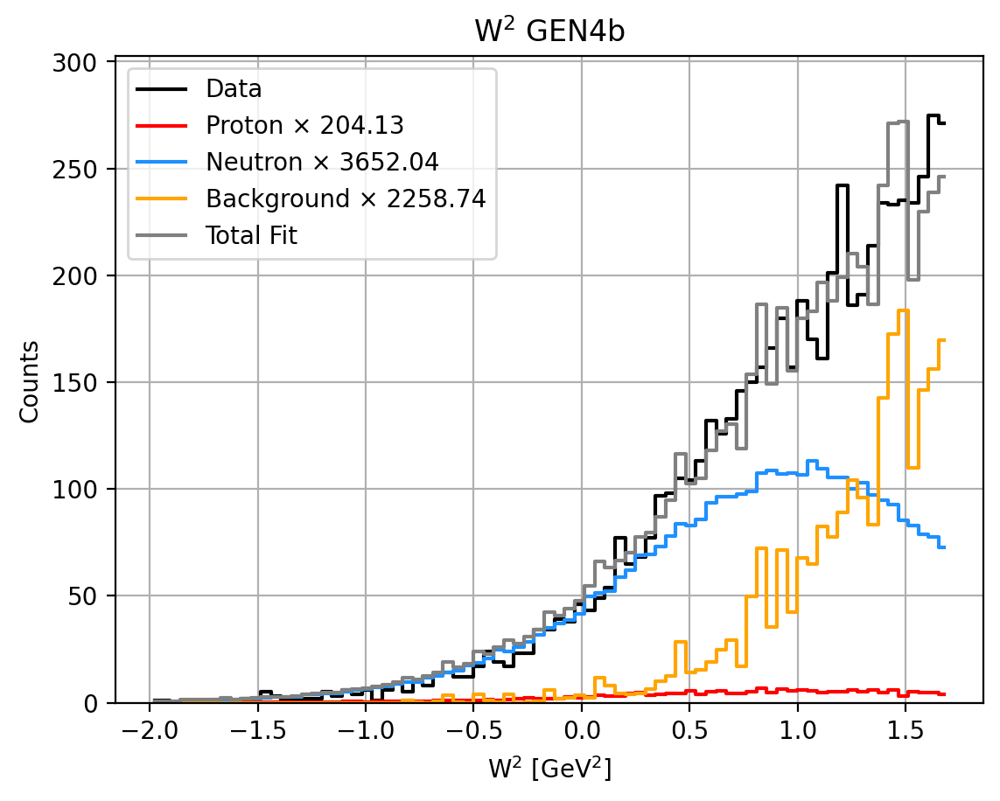

0.6306174969355435 0.03524849053430076 0.5953690064012427 0.3693825030644566


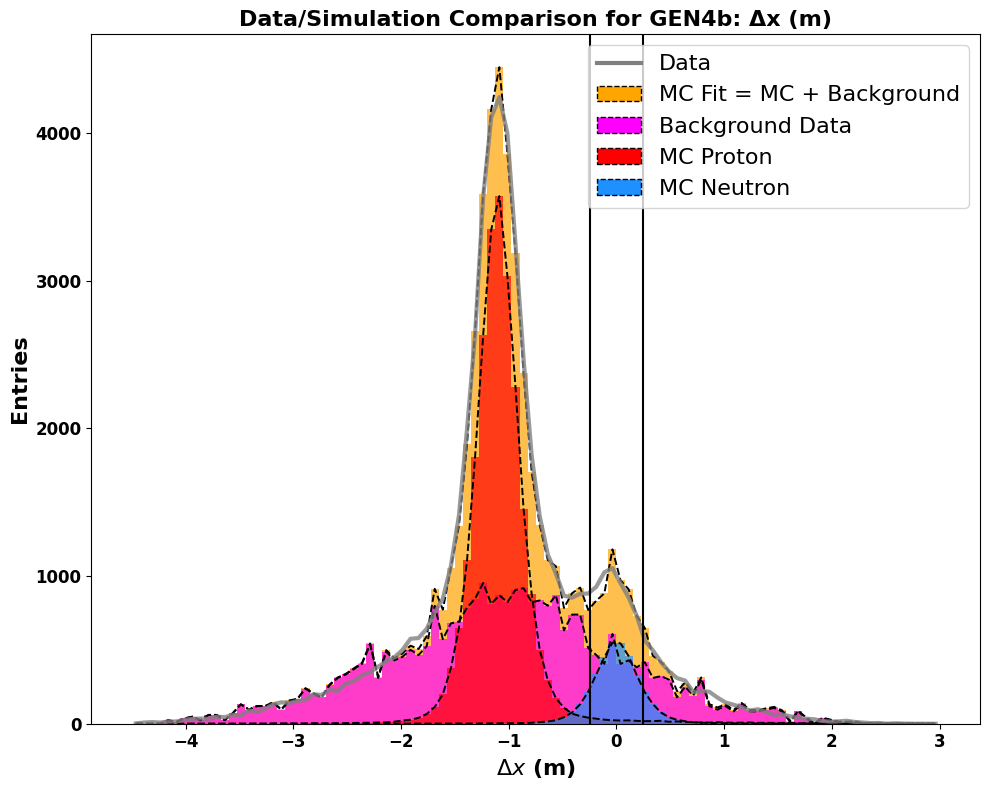

Total entries in fit: 56245.47297844097


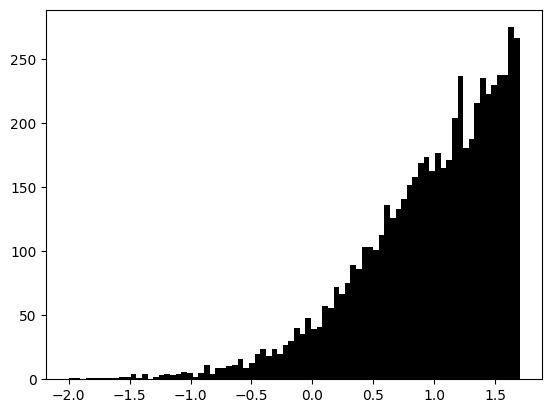

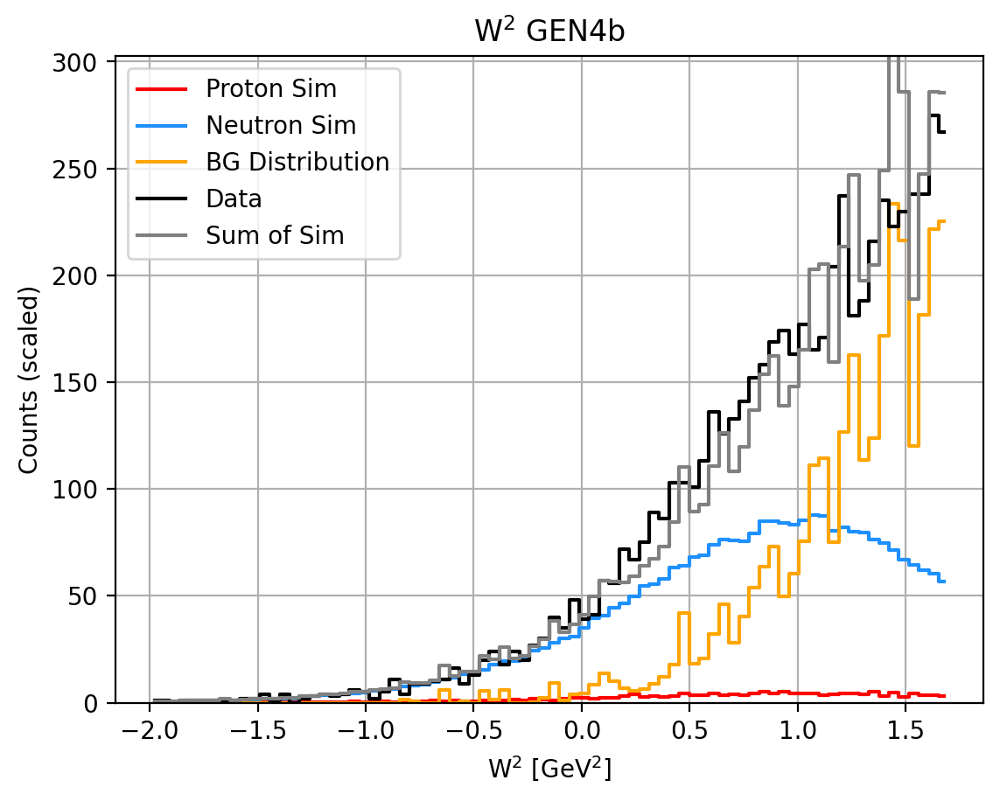

196398 196752
Total events in range (-0.25, 0.25):
  Sim Proton:   148.97
  Sim Neutron:  2665.24
  Background:   2693.35
  Total:        5542.00
Fraction of events in range (-0.25, 0.25):
   Proton Fraction: 0.04
   Background Fraction: 0.37
   W2 Background Fraction: 0.37
   Neutron Fraction: 0.60
__________________________________________________
Target Weighted Avg: 0.379+-0.0214  5.6568%
Beam Weighted Avg: 0.808+-0.0010  0.1201%
__________________________________________________
epsilon = 0.5751
tau_avg = 2.7560
Q2 = 9.7316
Px: 0.9906 Pz: -0.0269
A = 0.04328 ± 0.01535 ± 0.00271
B = 0.41714 (no propagated error)
C = 0.18544 ± 0.07359 ± 0.01298
__________________________________________________
N_plus: 3039 N_minus: 2876
A_raw: 0.0276+=0.0130
A_raw_weighted: 0.0352+-0.0125  35.4562%
__________________________________________________
A_phys_weighted: 0.207
A_phys_stat_error: 0.0736  35.4782%
A_phys_sys_error: 0.0130  6.257%
GEn/GMn*muN: 0.89249+--0.37355+--0.06588
Relative Error: 42.

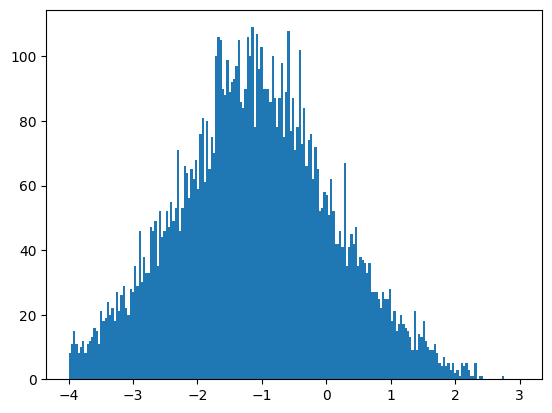

In [503]:
#rel_contribs,_,statdict,Q2_avg=DoItAll(W2min,W2max,coinmin,coinmax,dymin,dymax,dxmin,dxmax)
rel_contribs,_,statdict,Q2_avg=DoItAll(-2,1.7,new_coinmin,new_coinmax,new_dymin,new_dymax,
                                       new_dxmin,new_dxmax,new_hcalmin,.2,epmin,extracut=True,cluscut=1)




Starting W2
0.5033
0.8800
-0.9030
0.9060
-1.4800
1.4800
181.0000
188.0000
0.0250


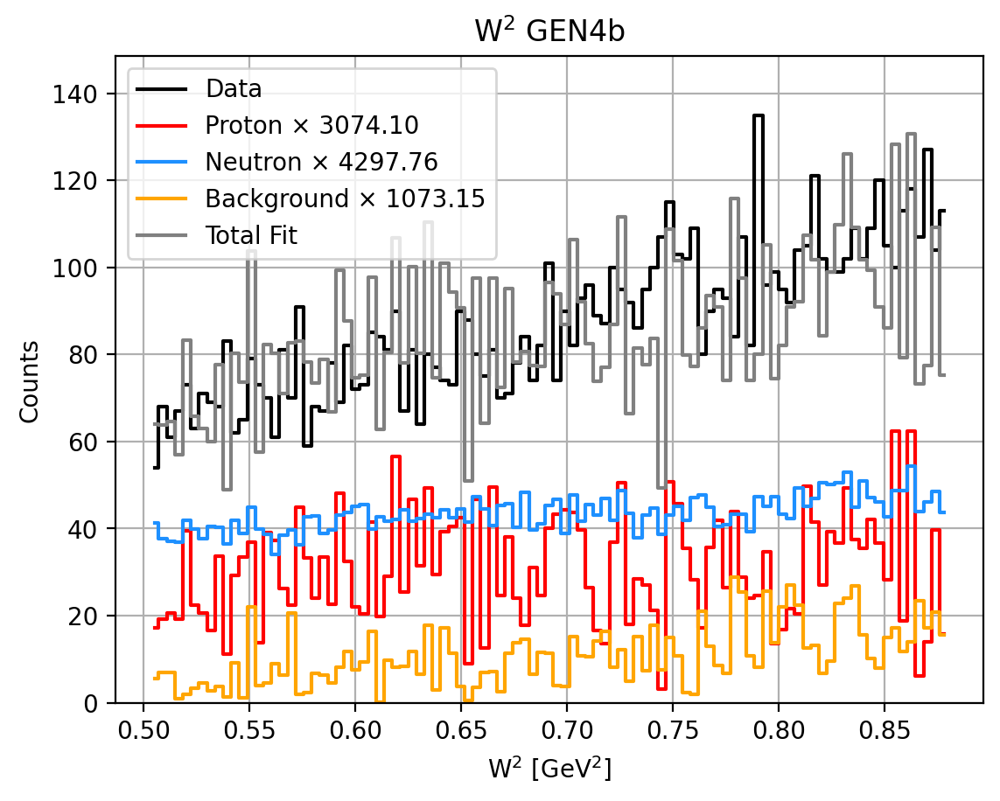

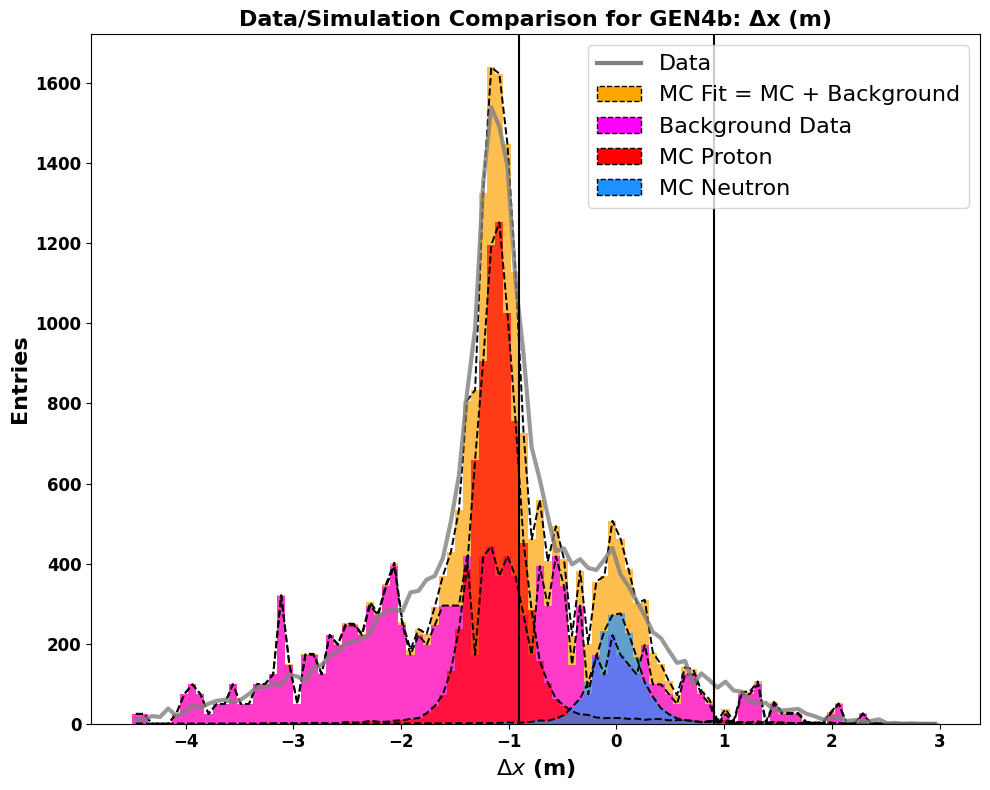

Total entries in fit: 23824.06508241743


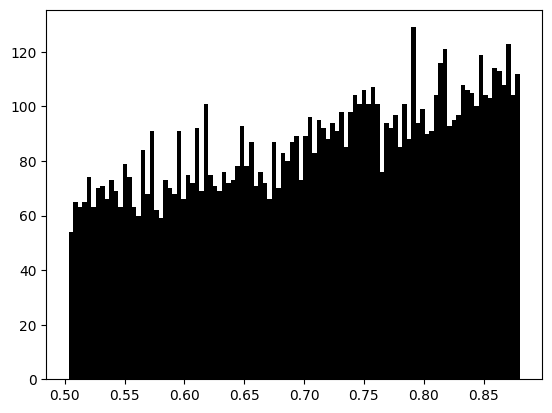

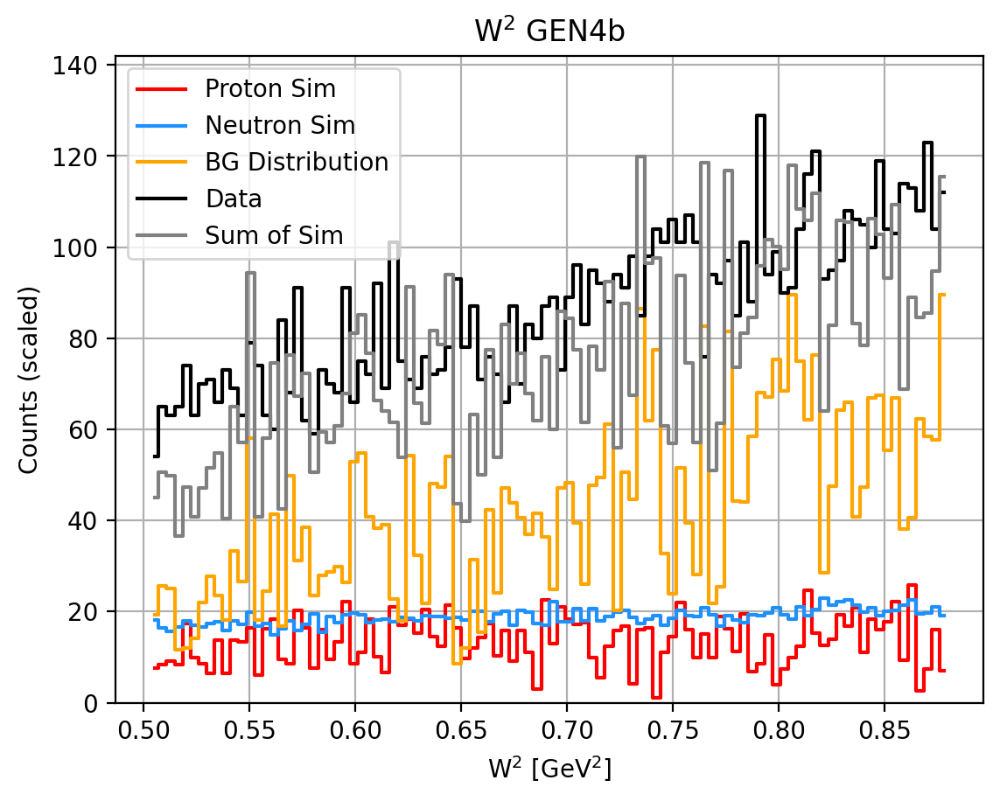

685108 684293
Total events in range (-0.903, 0.906):
  Sim Proton:   1339.81
  Sim Neutron:  1873.13
  Background:   4255.72
  Total:        8604.00
Fraction of events in range (-0.903, 0.906):
   Proton Fraction: 0.16
   Background Fraction: 0.49
   W2 Background Fraction: 0.13
   Neutron Fraction: 0.22
__________________________________________________
Target Weighted Avg: 0.378+-0.0217  5.7316%
Beam Weighted Avg: 0.808+-0.0010  0.1201%
__________________________________________________
epsilon = 0.5696
tau_avg = 2.8054
Q2 = 9.9063
Px: 0.9868 Pz: -0.0310
A = 0.01624 ± 0.02136 ± 0.00201
B = 0.41253 (no propagated error)
C = 0.05451 ± 0.10522 ± 0.00990
__________________________________________________
N_plus: 4276 N_minus: 4229
A_raw: 0.0055+=0.0108
A_raw_weighted: 0.00897+-0.0105  116.6460%
__________________________________________________
A_phys_weighted: 0.08
A_phys_stat_error: 0.1052  131.5575%
A_phys_sys_error: 0.0099  12.38%
GEn/GMn*muN: 0.25376+--0.49239+--0.04635
Relative Err

/tmp/ipykernel_15907/1529990197.py:152: RuntimeWarning: invalid value encountered in divide
  A_raw_per_run = (N_plus_per_run - N_minus_per_run) / (N_plus_per_run + N_minus_per_run)
/tmp/ipykernel_15907/1529990197.py:153: RuntimeWarning: invalid value encountered in divide
  A_raw_error_per_run = 2 * np.sqrt(N_plus_per_run * N_minus_per_run) / (N_plus_per_run + N_minus_per_run)**1.5


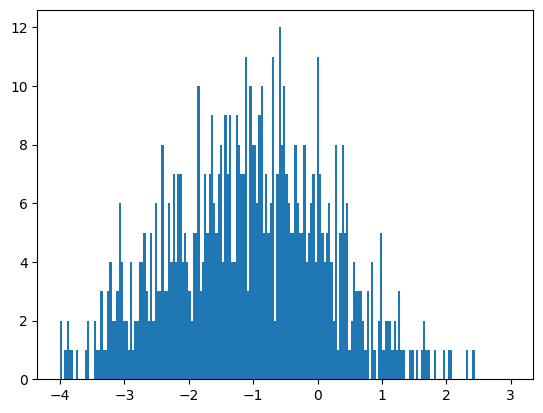

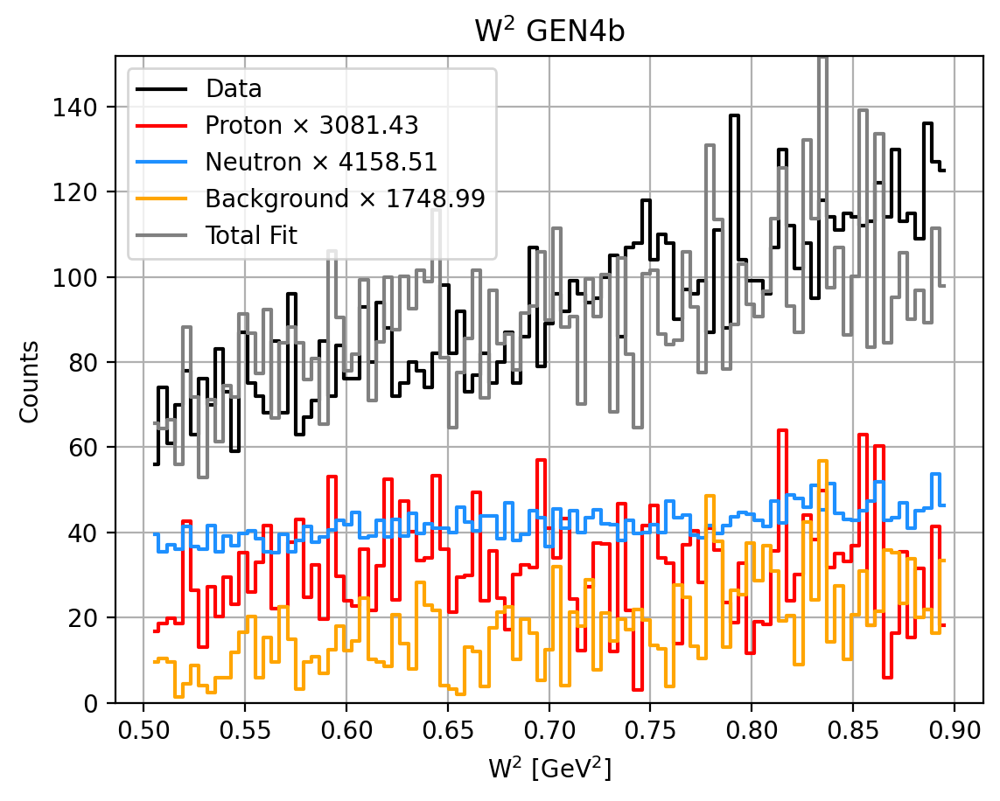

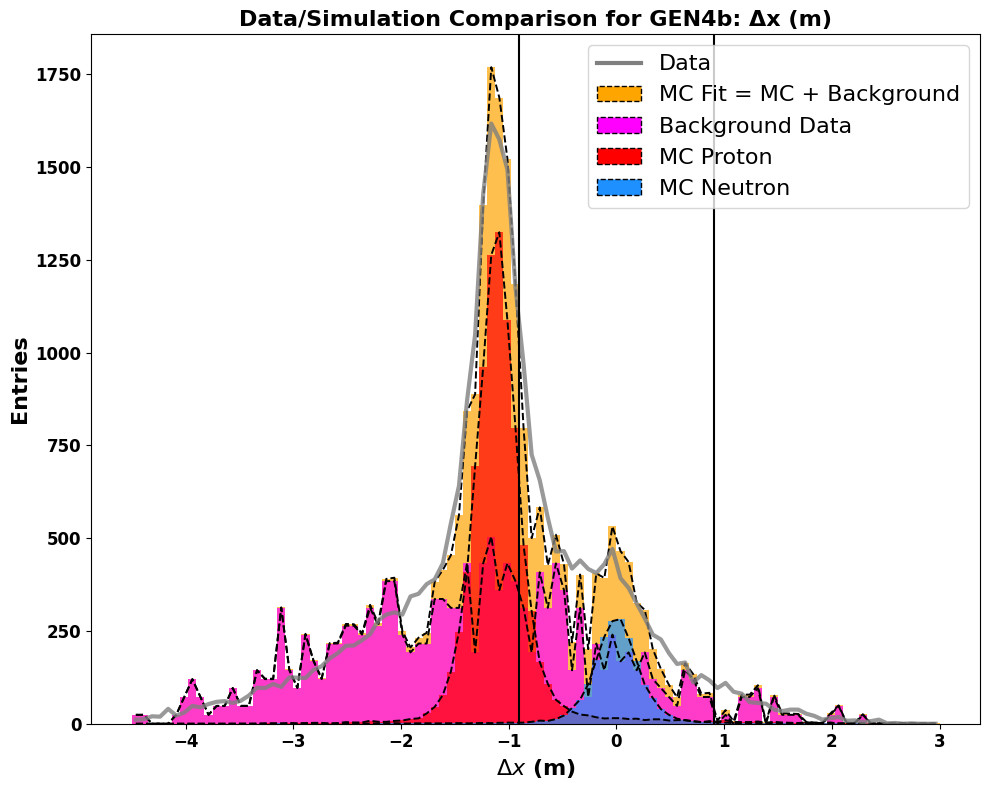

Total entries in fit: 25269.58151394329


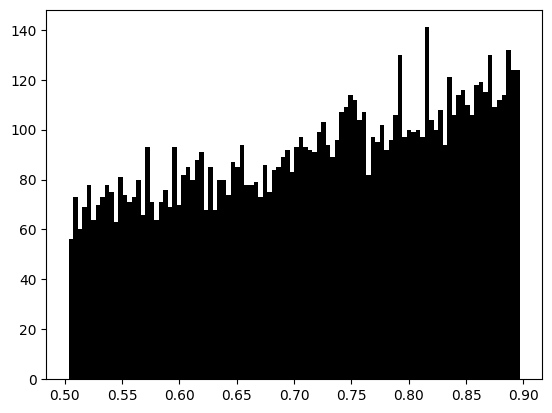

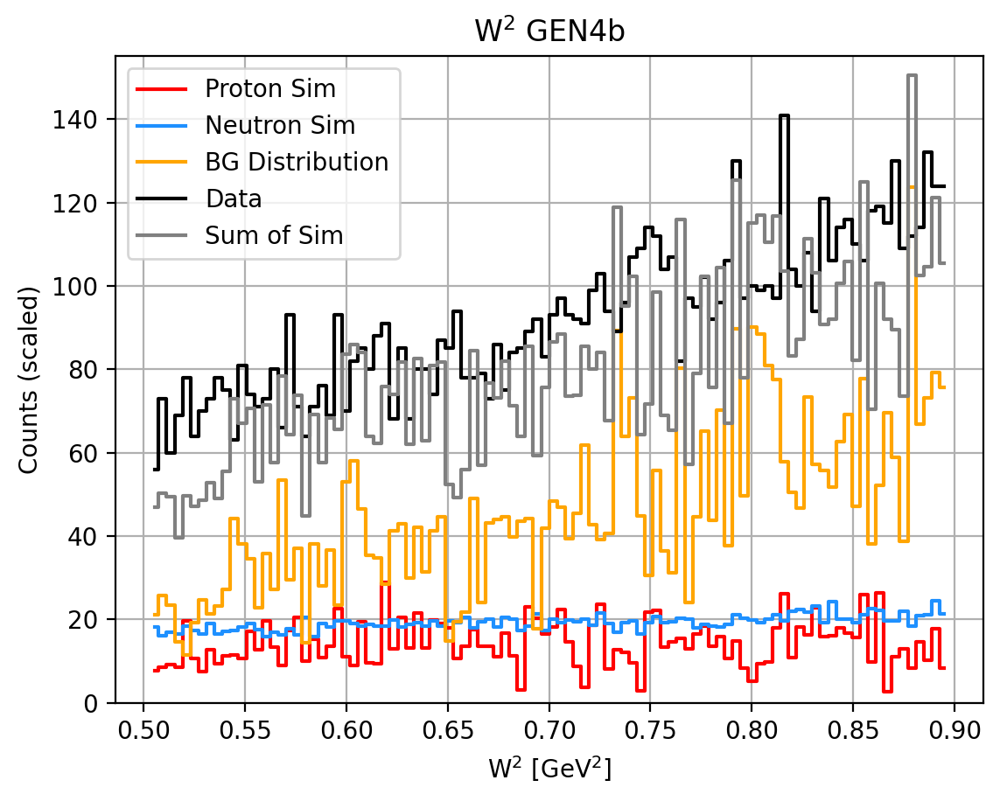

685108 684293
Total events in range (-0.903, 0.906):
  Sim Proton:   1416.74
  Sim Neutron:  1911.95
  Background:   4585.78
  Total:        9124.00
Fraction of events in range (-0.903, 0.906):
   Proton Fraction: 0.16
   Background Fraction: 0.50
   W2 Background Fraction: 0.19
   Neutron Fraction: 0.21
__________________________________________________
Target Weighted Avg: 0.378+-0.0218  5.7518%
Beam Weighted Avg: 0.808+-0.0010  0.1201%
__________________________________________________
epsilon = 0.5697
tau_avg = 2.8036
Q2 = 9.8999
Px: 0.9868 Pz: -0.0307
A = 0.01714 ± 0.02127 ± 0.00204
B = 0.41264 (no propagated error)
C = 0.05912 ± 0.10466 ± 0.01004
__________________________________________________
N_plus: 4549 N_minus: 4469
A_raw: 0.0089+=0.0105
A_raw_weighted: 0.00904+-0.0102  112.5694%
__________________________________________________
A_phys_weighted: 0.0844
A_phys_stat_error: 0.1047  124.0686%
A_phys_sys_error: 0.0100  11.9%
GEn/GMn*muN: 0.27535+--0.49042+--0.04703
Relative Er

/tmp/ipykernel_15907/1529990197.py:152: RuntimeWarning: invalid value encountered in divide
  A_raw_per_run = (N_plus_per_run - N_minus_per_run) / (N_plus_per_run + N_minus_per_run)
/tmp/ipykernel_15907/1529990197.py:153: RuntimeWarning: invalid value encountered in divide
  A_raw_error_per_run = 2 * np.sqrt(N_plus_per_run * N_minus_per_run) / (N_plus_per_run + N_minus_per_run)**1.5


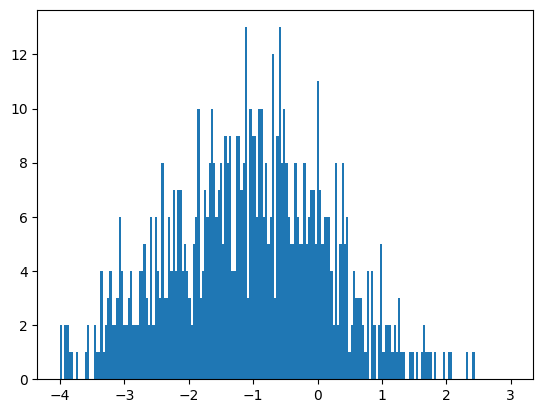

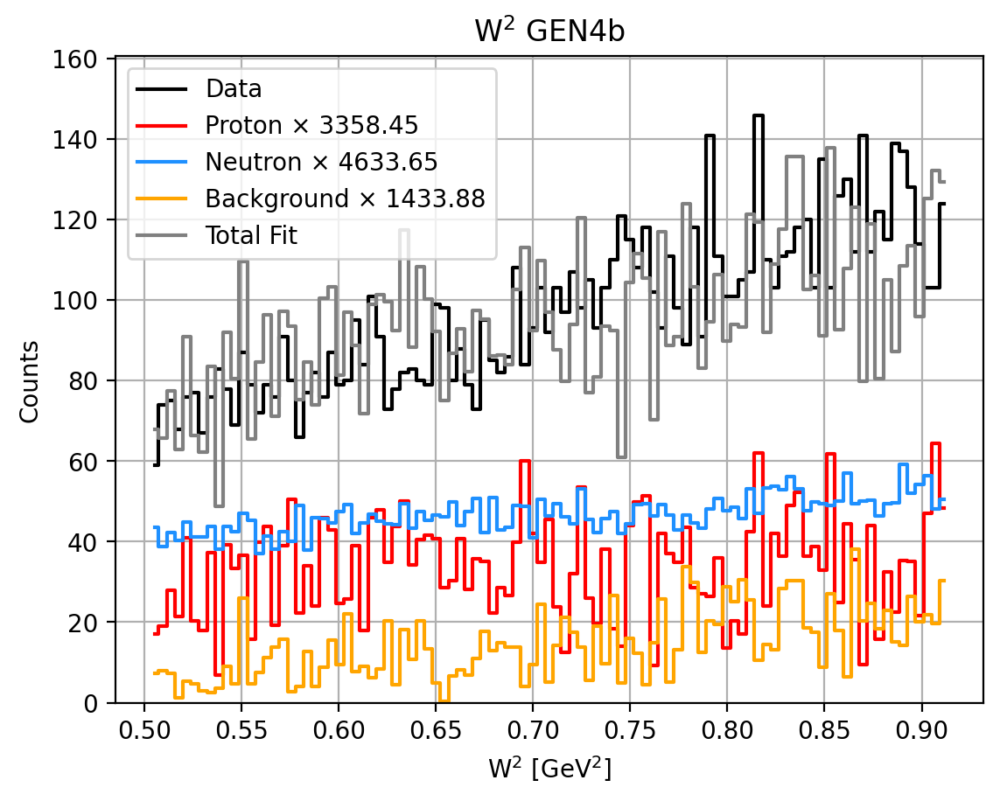

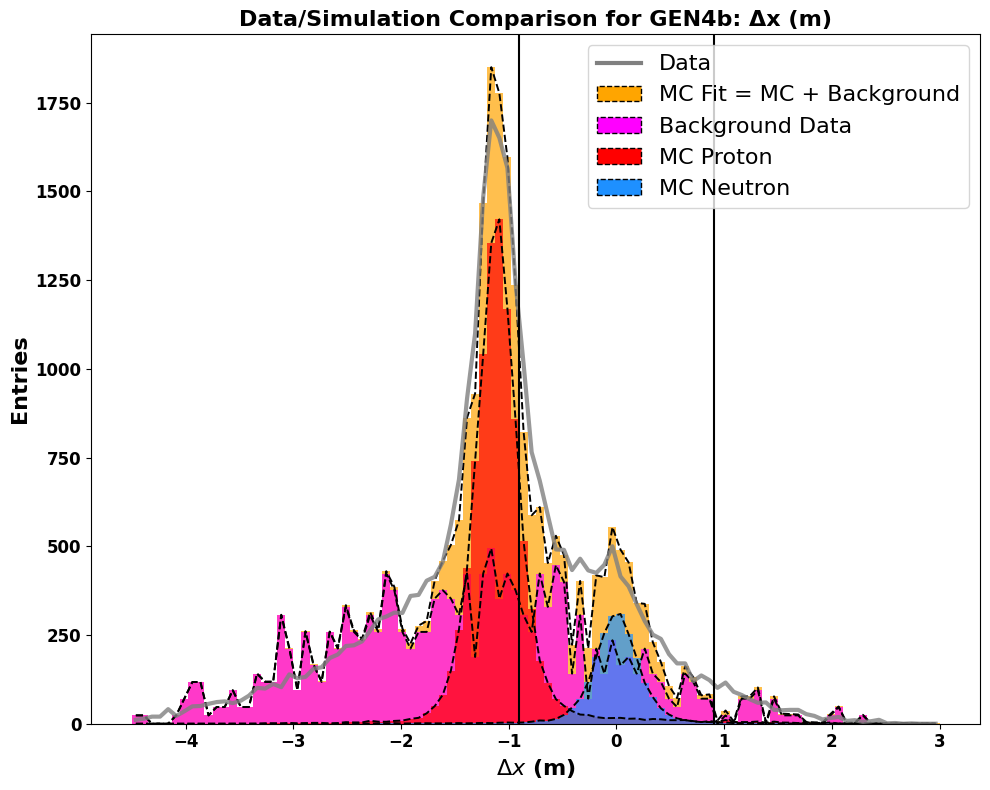

Total entries in fit: 26611.588115800292


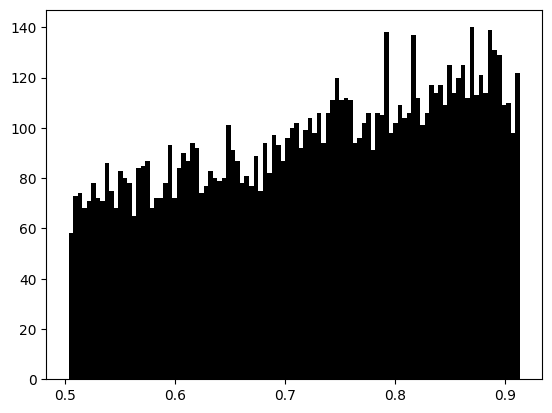

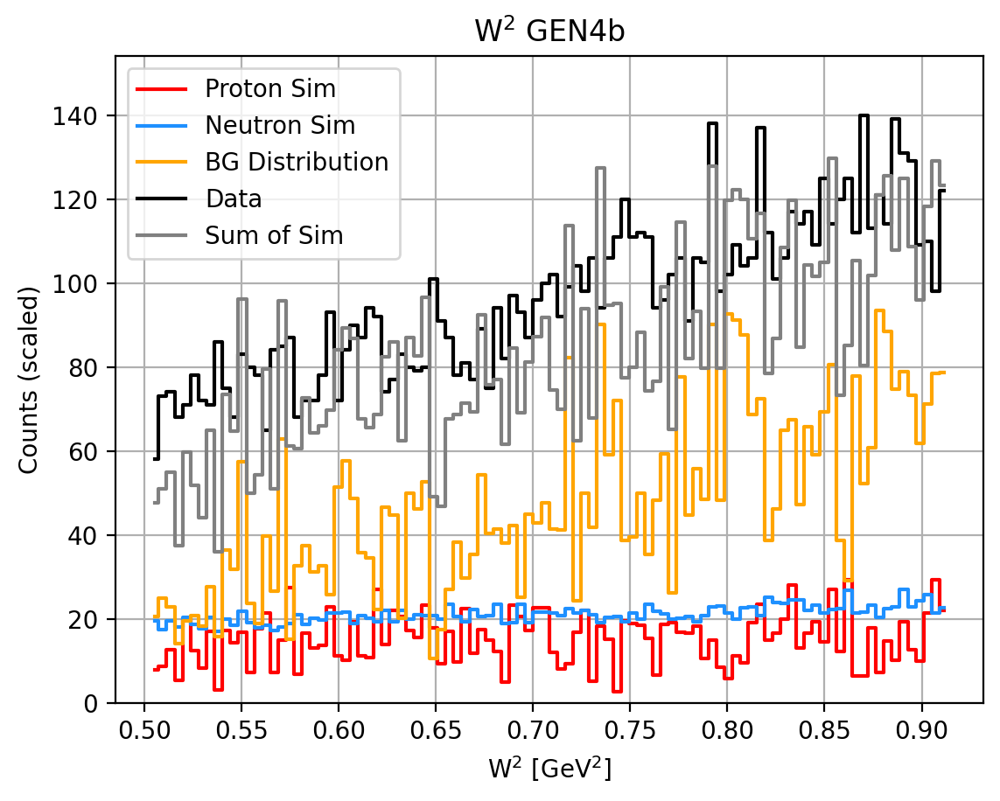

685108 684293
Total events in range (-0.903, 0.906):
  Sim Proton:   1517.33
  Sim Neutron:  2093.46
  Background:   4750.04
  Total:        9569.00
Fraction of events in range (-0.903, 0.906):
   Proton Fraction: 0.16
   Background Fraction: 0.50
   W2 Background Fraction: 0.15
   Neutron Fraction: 0.22
__________________________________________________
Target Weighted Avg: 0.379+-0.0218  5.7695%
Beam Weighted Avg: 0.808+-0.0010  0.1201%
__________________________________________________
epsilon = 0.5699
tau_avg = 2.8019
Q2 = 9.8937
Px: 0.9867 Pz: -0.0305
A = 0.01652 ± 0.02067 ± 0.00197
B = 0.41274 (no propagated error)
C = 0.05613 ± 0.10160 ± 0.00971
__________________________________________________
N_plus: 4779 N_minus: 4679
A_raw: 0.0106+=0.0103
A_raw_weighted: 0.00911+-0.0100  109.4147%
__________________________________________________
A_phys_weighted: 0.0812
A_phys_stat_error: 0.1016  125.1200%
A_phys_sys_error: 0.0097  11.95%
GEn/GMn*muN: 0.26120+--0.47542+--0.04542
Relative E

/tmp/ipykernel_15907/1529990197.py:152: RuntimeWarning: invalid value encountered in divide
  A_raw_per_run = (N_plus_per_run - N_minus_per_run) / (N_plus_per_run + N_minus_per_run)
/tmp/ipykernel_15907/1529990197.py:153: RuntimeWarning: invalid value encountered in divide
  A_raw_error_per_run = 2 * np.sqrt(N_plus_per_run * N_minus_per_run) / (N_plus_per_run + N_minus_per_run)**1.5


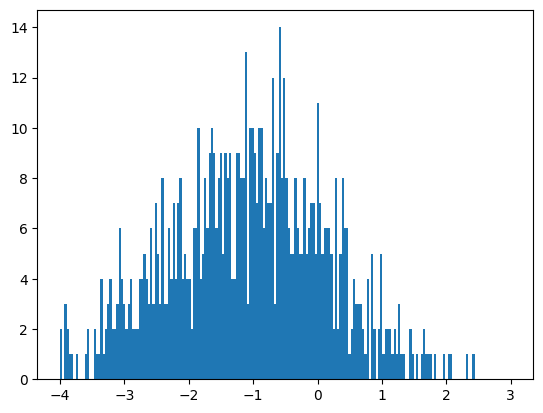

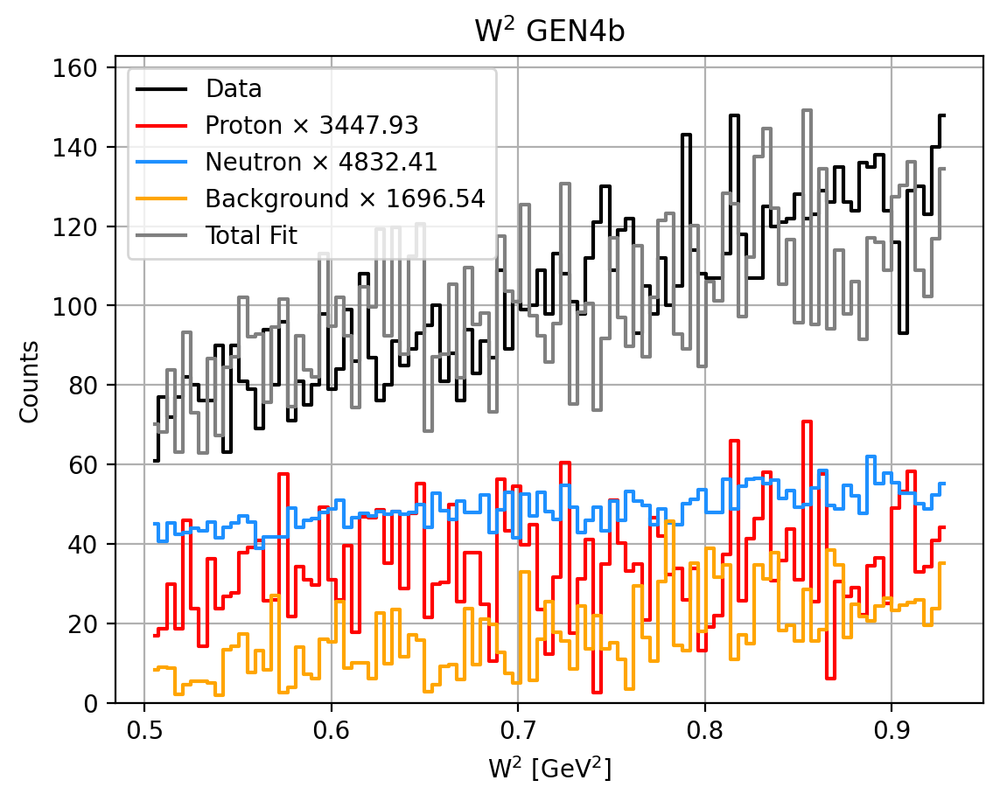

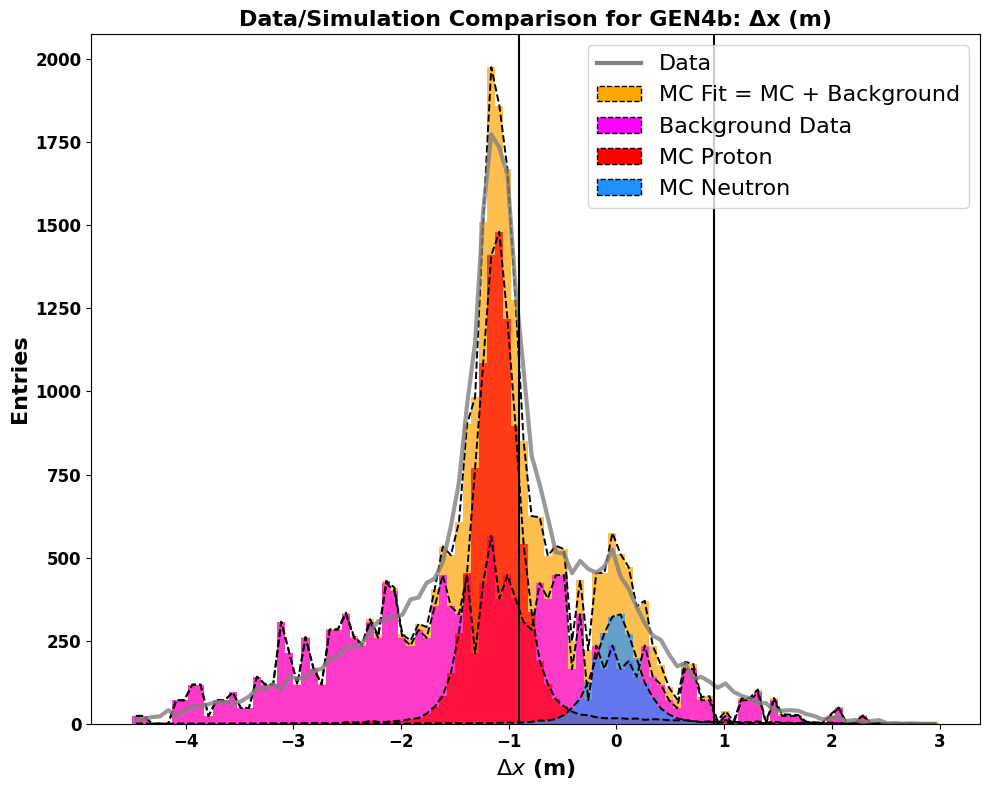

Total entries in fit: 28001.33497284318


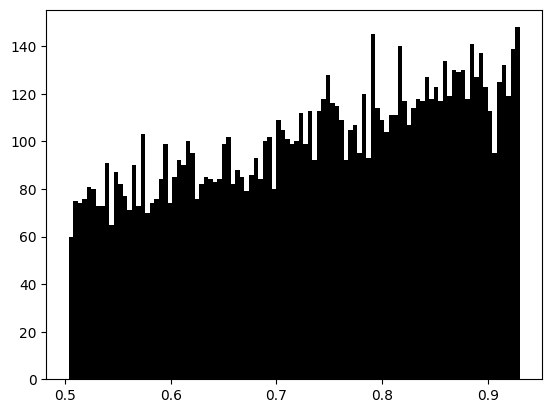

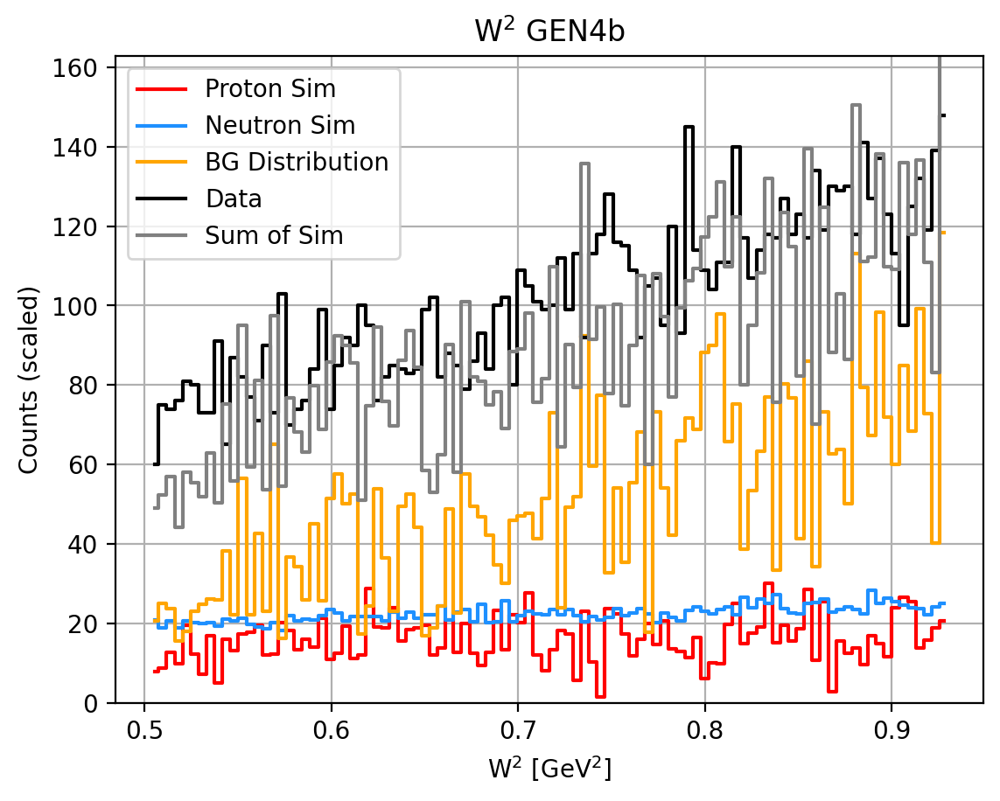

685108 684293
Total events in range (-0.903, 0.906):
  Sim Proton:   1589.20
  Sim Neutron:  2227.32
  Background:   5061.30
  Total:        10087.00
Fraction of events in range (-0.903, 0.906):
   Proton Fraction: 0.16
   Background Fraction: 0.50
   W2 Background Fraction: 0.17
   Neutron Fraction: 0.22
__________________________________________________
Target Weighted Avg: 0.379+-0.0218  5.7606%
Beam Weighted Avg: 0.808+-0.0010  0.1201%
__________________________________________________
epsilon = 0.5701
tau_avg = 2.7999
Q2 = 9.8868
Px: 0.9868 Pz: -0.0303
A = 0.02558 ± 0.02047 ± 0.00234
B = 0.41289 (no propagated error)
C = 0.10076 ± 0.10052 ± 0.01147
__________________________________________________
N_plus: 5051 N_minus: 4921
A_raw: 0.0130+=0.0100
A_raw_weighted: 0.0136+-0.0097  71.6452%
__________________________________________________
A_phys_weighted: 0.126
A_phys_stat_error: 0.1005  80.0028%
A_phys_sys_error: 0.0115  9.128%
GEn/GMn*muN: 0.47346+--0.47986+--0.05475
Relative Erro

/tmp/ipykernel_15907/1529990197.py:152: RuntimeWarning: invalid value encountered in divide
  A_raw_per_run = (N_plus_per_run - N_minus_per_run) / (N_plus_per_run + N_minus_per_run)
/tmp/ipykernel_15907/1529990197.py:153: RuntimeWarning: invalid value encountered in divide
  A_raw_error_per_run = 2 * np.sqrt(N_plus_per_run * N_minus_per_run) / (N_plus_per_run + N_minus_per_run)**1.5


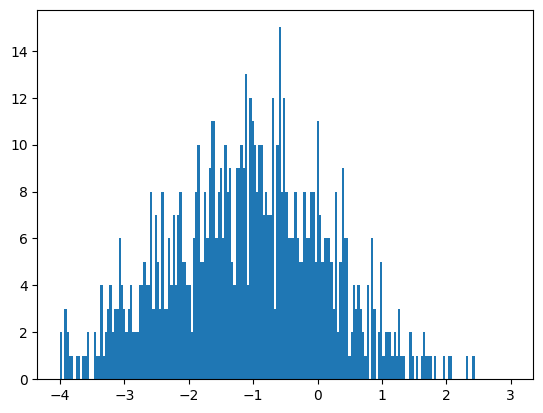

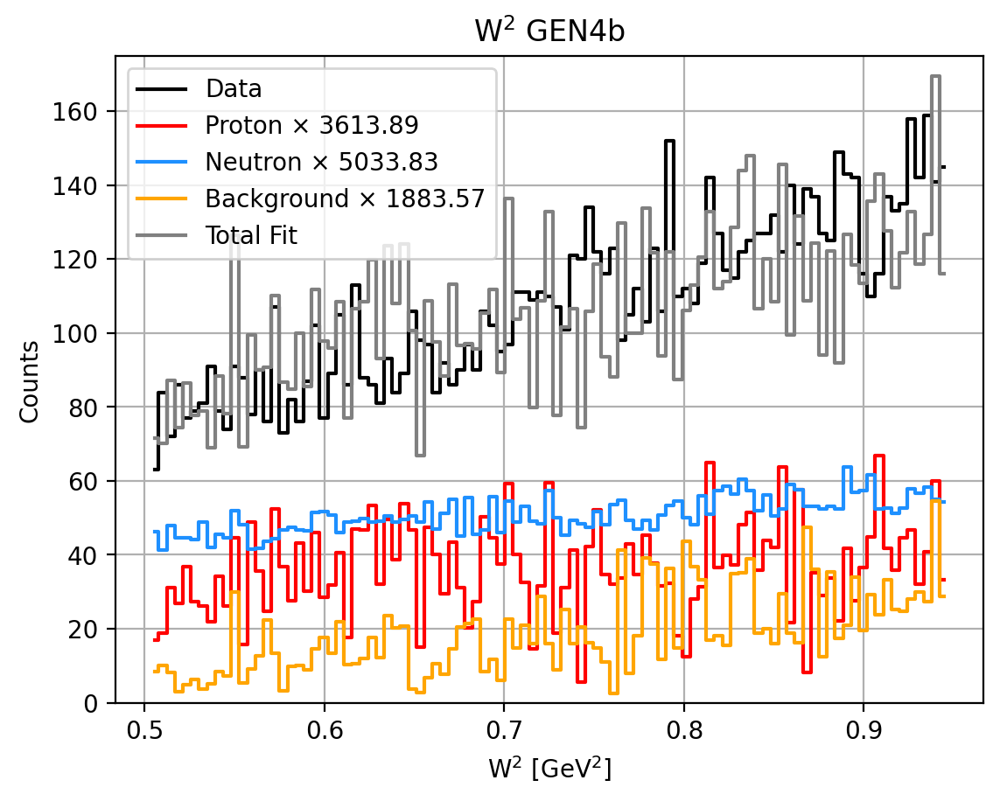

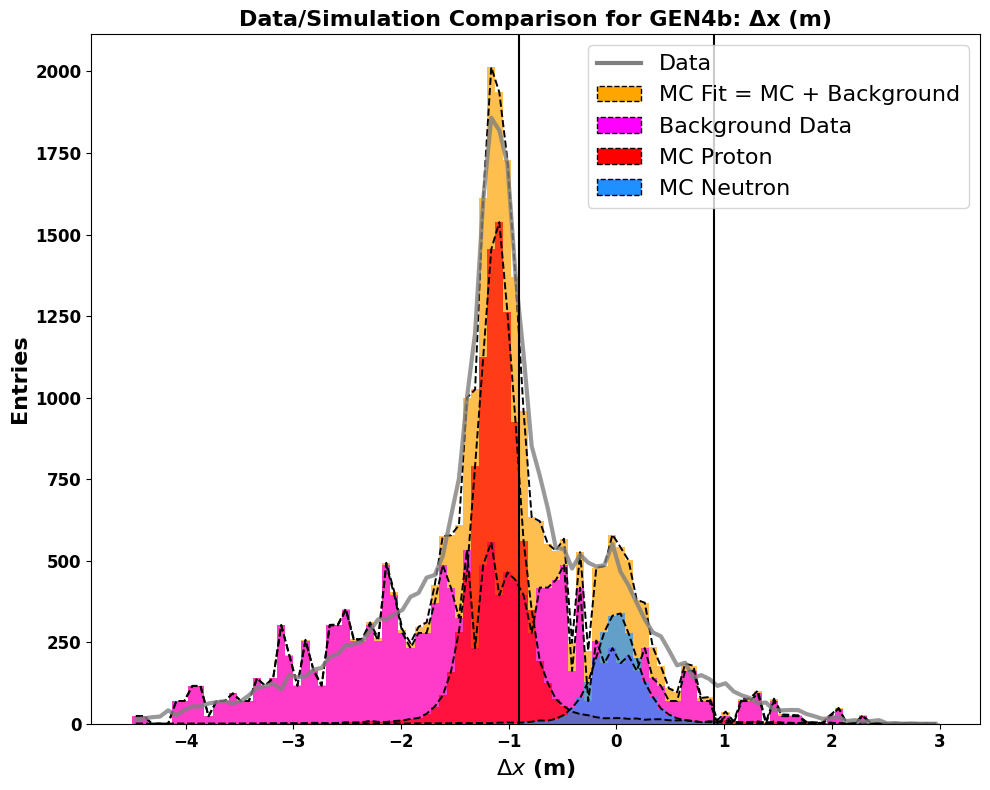

Total entries in fit: 29283.30392749561


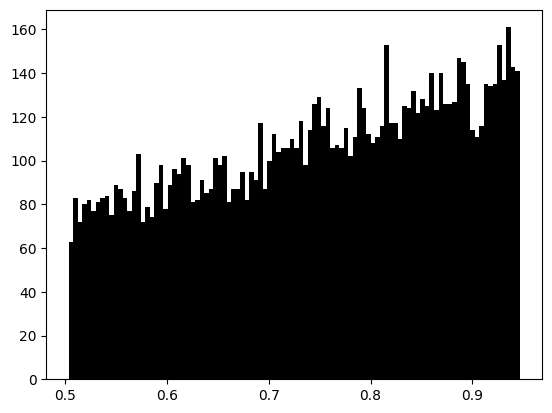

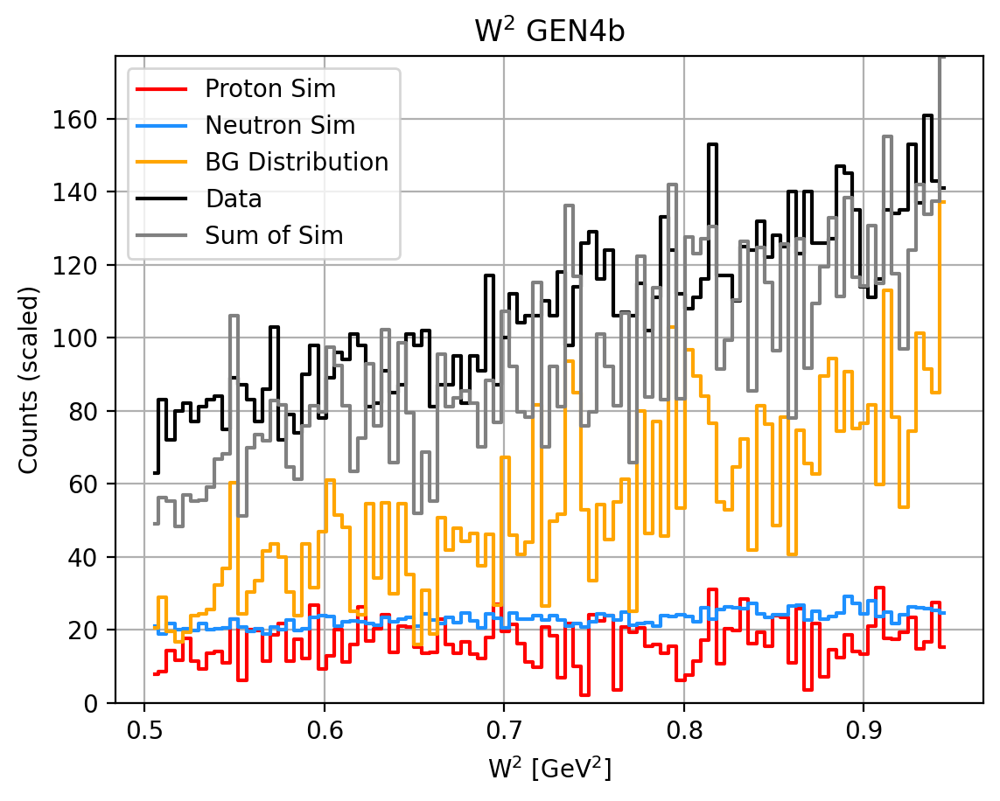

685108 684293
Total events in range (-0.903, 0.906):
  Sim Proton:   1642.22
  Sim Neutron:  2287.47
  Background:   5402.96
  Total:        10632.00
Fraction of events in range (-0.903, 0.906):
   Proton Fraction: 0.15
   Background Fraction: 0.51
   W2 Background Fraction: 0.18
   Neutron Fraction: 0.22
__________________________________________________
Target Weighted Avg: 0.379+-0.0218  5.7589%
Beam Weighted Avg: 0.808+-0.0010  0.1201%
__________________________________________________
epsilon = 0.5702
tau_avg = 2.7982
Q2 = 9.8809
Px: 0.9868 Pz: -0.0300
A = 0.02142 ± 0.02018 ± 0.00213
B = 0.41301 (no propagated error)
C = 0.08047 ± 0.09906 ± 0.01048
__________________________________________________
N_plus: 5318 N_minus: 5196
A_raw: 0.0116+=0.0098
A_raw_weighted: 0.0115+-0.0095  82.7429%
__________________________________________________
A_phys_weighted: 0.105
A_phys_stat_error: 0.0991  94.2336%
A_phys_sys_error: 0.0105  9.966%
GEn/GMn*muN: 0.37602+--0.46774+--0.04947
Relative Erro

/tmp/ipykernel_15907/1529990197.py:152: RuntimeWarning: invalid value encountered in divide
  A_raw_per_run = (N_plus_per_run - N_minus_per_run) / (N_plus_per_run + N_minus_per_run)
/tmp/ipykernel_15907/1529990197.py:153: RuntimeWarning: invalid value encountered in divide
  A_raw_error_per_run = 2 * np.sqrt(N_plus_per_run * N_minus_per_run) / (N_plus_per_run + N_minus_per_run)**1.5


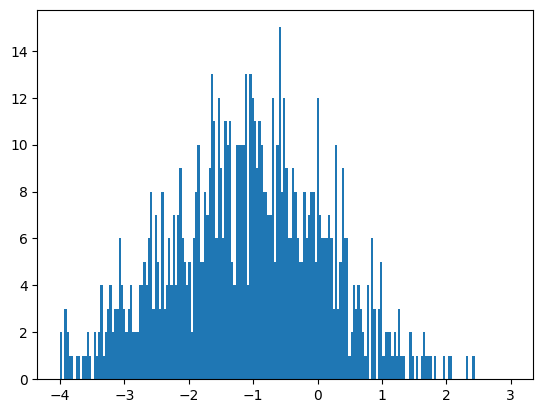

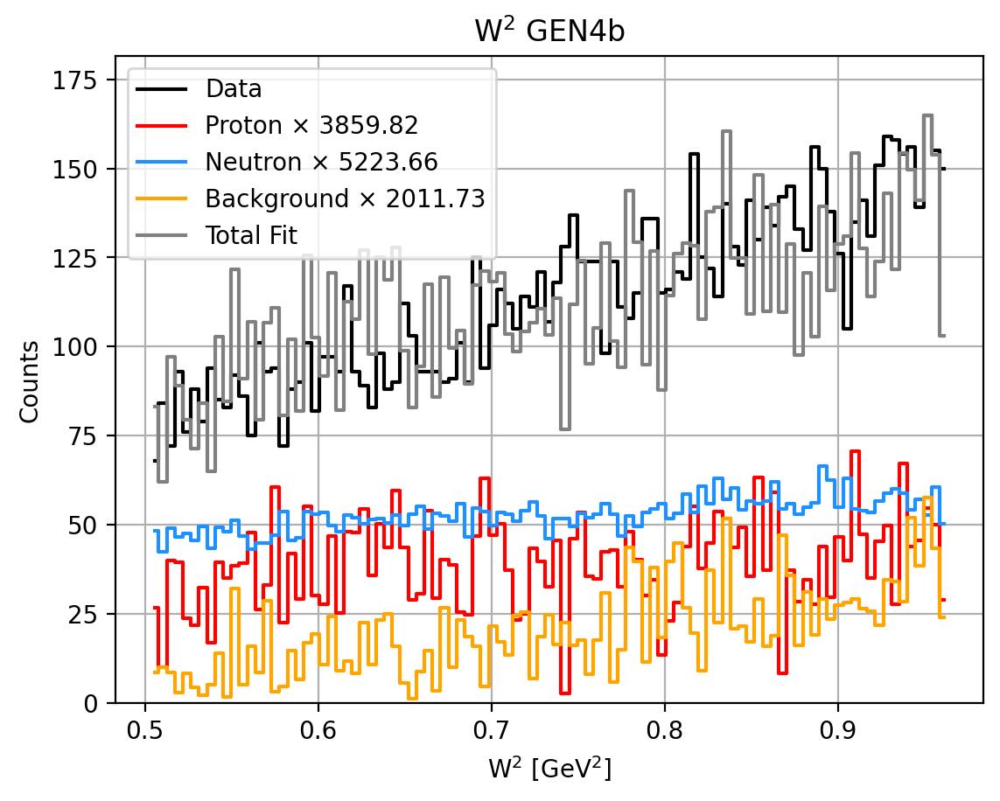

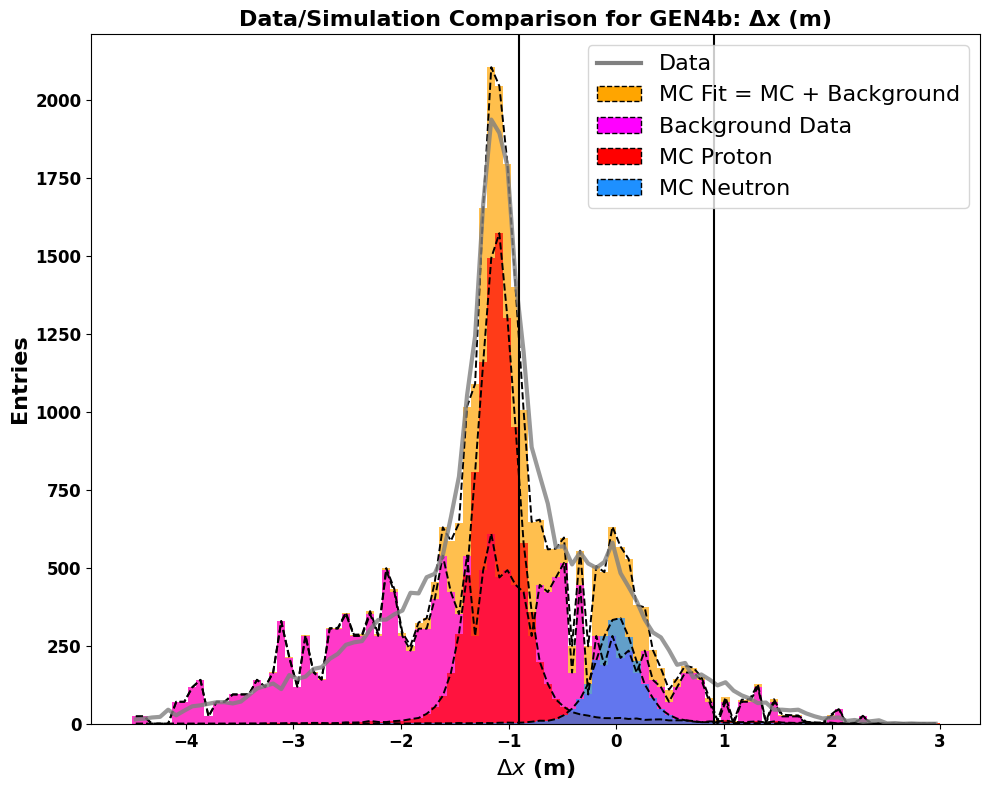

Total entries in fit: 30837.01528527955


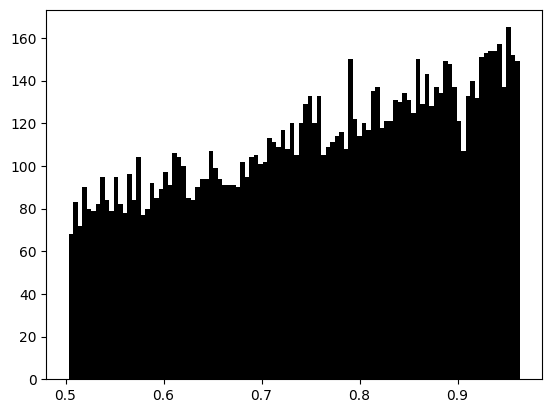

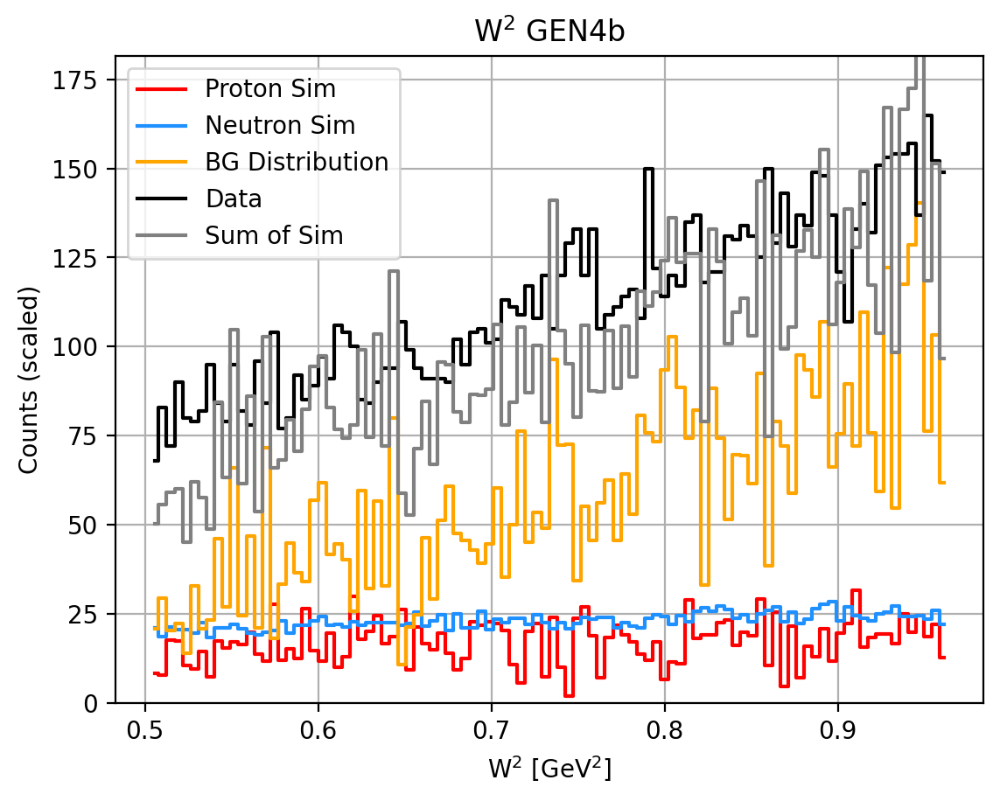

685108 684293
Total events in range (-0.903, 0.906):
  Sim Proton:   1692.16
  Sim Neutron:  2290.08
  Background:   5839.97
  Total:        11181.00
Fraction of events in range (-0.903, 0.906):
   Proton Fraction: 0.15
   Background Fraction: 0.52
   W2 Background Fraction: 0.18
   Neutron Fraction: 0.20
__________________________________________________
Target Weighted Avg: 0.379+-0.0218  5.7523%
Beam Weighted Avg: 0.808+-0.0010  0.1201%
__________________________________________________
epsilon = 0.5703
tau_avg = 2.7965
Q2 = 9.8746
Px: 0.9868 Pz: -0.0297
A = 0.02506 ± 0.02039 ± 0.00232
B = 0.41312 (no propagated error)
C = 0.09846 ± 0.09997 ± 0.01136
__________________________________________________
N_plus: 5592 N_minus: 5467
A_raw: 0.0113+=0.0095
A_raw_weighted: 0.0129+-0.0093  71.8185%
__________________________________________________
A_phys_weighted: 0.123
A_phys_stat_error: 0.1000  81.3552%
A_phys_sys_error: 0.0114  9.246%
GEn/GMn*muN: 0.46209+--0.47629+--0.05413
Relative Erro

/tmp/ipykernel_15907/1529990197.py:152: RuntimeWarning: invalid value encountered in divide
  A_raw_per_run = (N_plus_per_run - N_minus_per_run) / (N_plus_per_run + N_minus_per_run)
/tmp/ipykernel_15907/1529990197.py:153: RuntimeWarning: invalid value encountered in divide
  A_raw_error_per_run = 2 * np.sqrt(N_plus_per_run * N_minus_per_run) / (N_plus_per_run + N_minus_per_run)**1.5


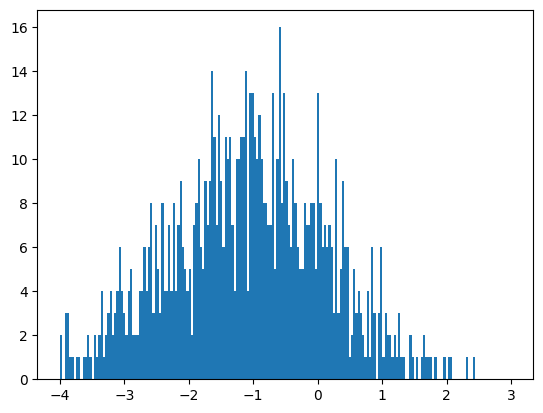

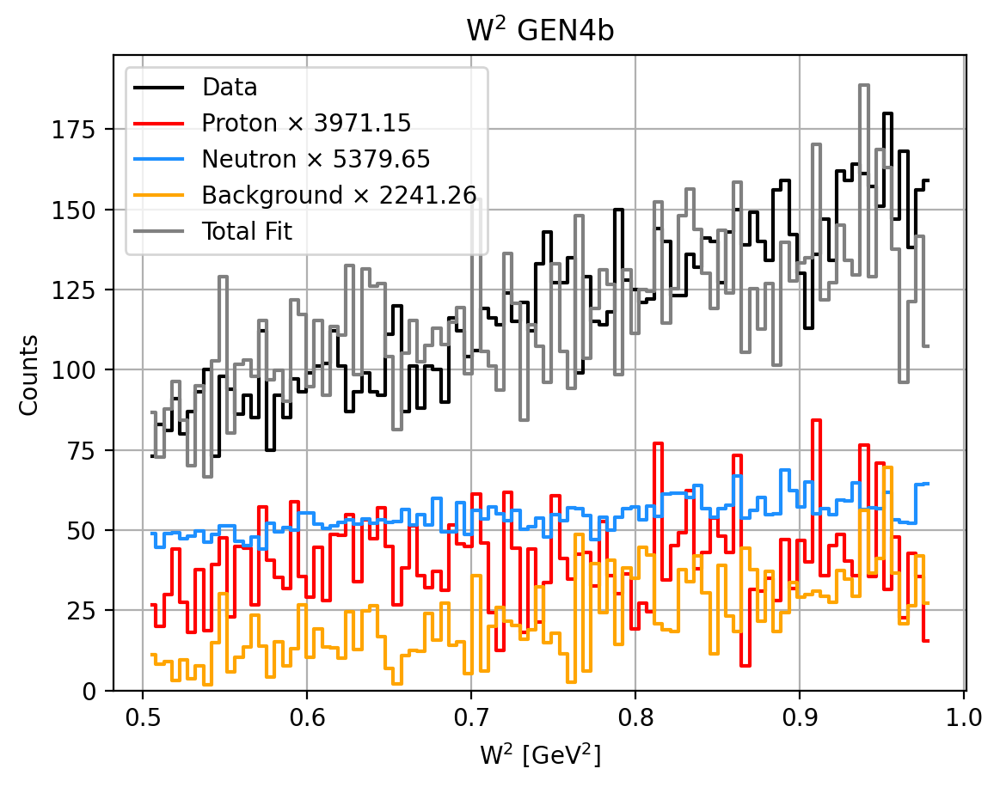

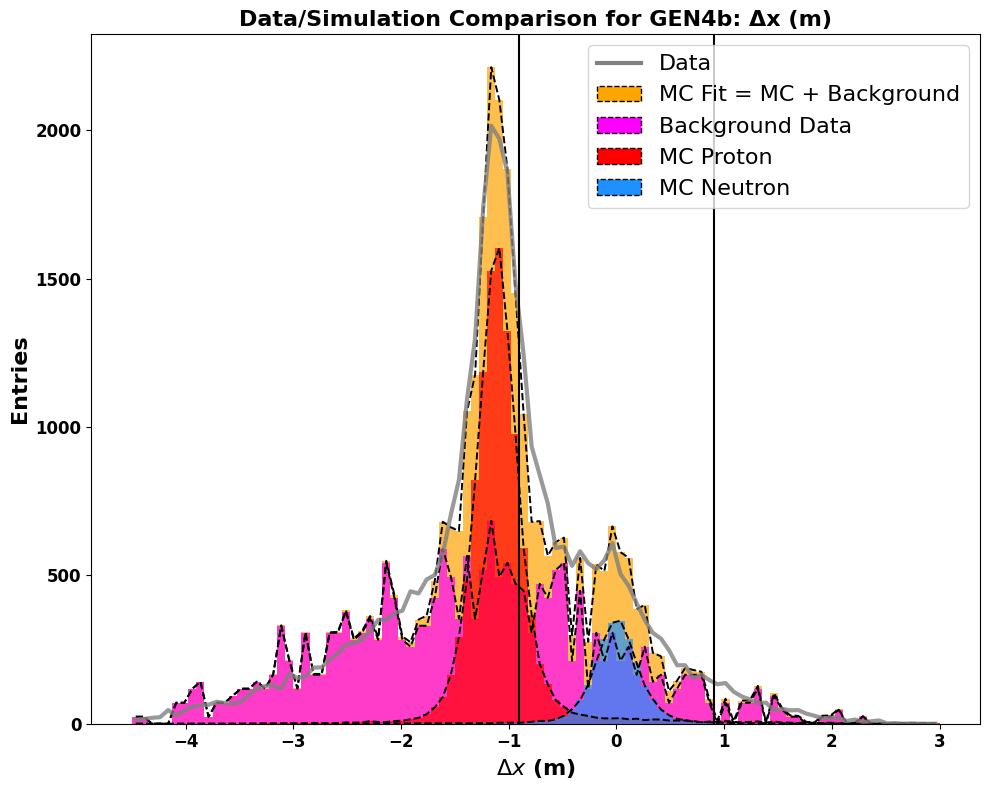

Total entries in fit: 32341.569557242805


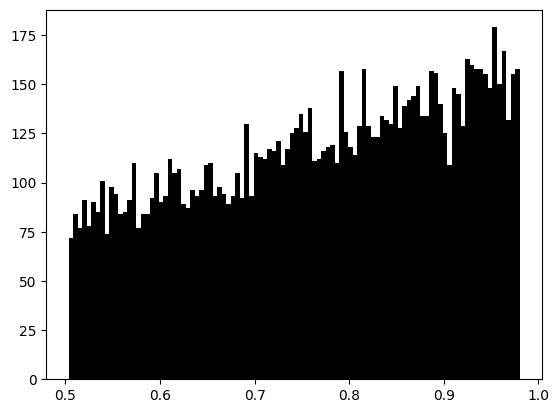

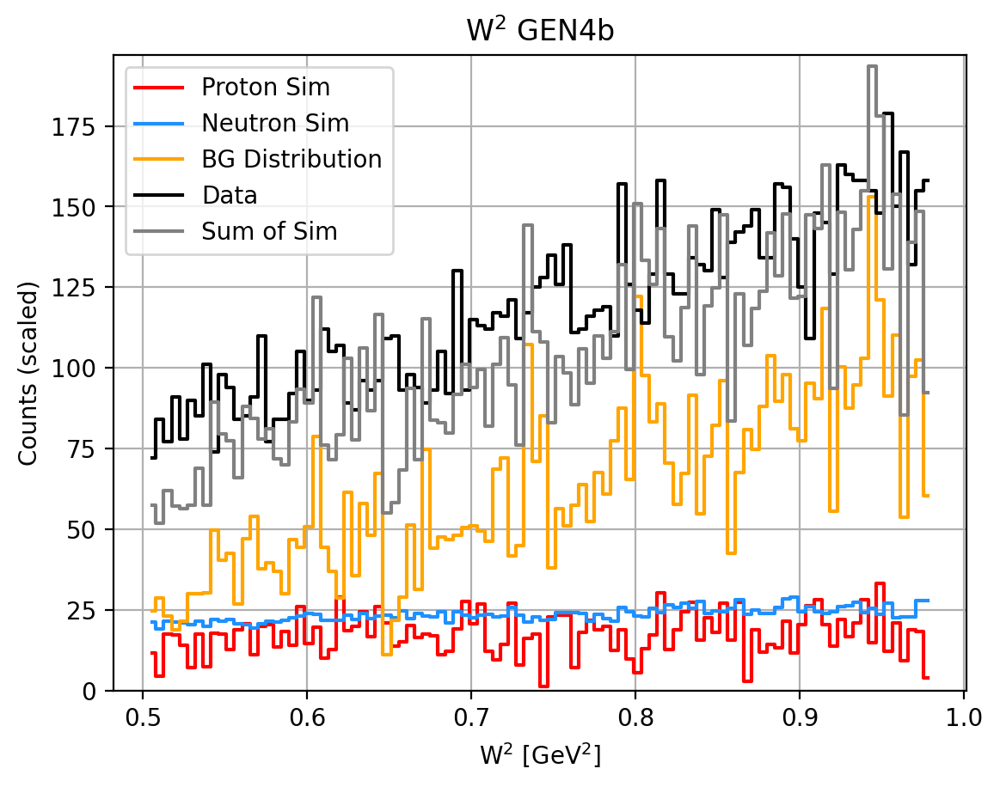

685108 684293
Total events in range (-0.903, 0.906):
  Sim Proton:   1725.86
  Sim Neutron:  2337.99
  Background:   6271.41
  Total:        11710.00
Fraction of events in range (-0.903, 0.906):
   Proton Fraction: 0.15
   Background Fraction: 0.54
   W2 Background Fraction: 0.19
   Neutron Fraction: 0.20
__________________________________________________
Target Weighted Avg: 0.379+-0.0218  5.7670%
Beam Weighted Avg: 0.808+-0.0010  0.1201%
__________________________________________________
epsilon = 0.5704
tau_avg = 2.7947
Q2 = 9.8683
Px: 0.9868 Pz: -0.0295
A = 0.03098 ± 0.02053 ± 0.00263
B = 0.41324 (no propagated error)
C = 0.12756 ± 0.10056 ± 0.01288
__________________________________________________
N_plus: 5866 N_minus: 5713
A_raw: 0.0132+=0.0093
A_raw_weighted: 0.0151+-0.0091  60.1226%
__________________________________________________
A_phys_weighted: 0.152
A_phys_stat_error: 0.1006  66.2561%
A_phys_sys_error: 0.0129  8.488%
GEn/GMn*muN: 0.60398+--0.48812+--0.06253
Relative Erro

/tmp/ipykernel_15907/1529990197.py:152: RuntimeWarning: invalid value encountered in divide
  A_raw_per_run = (N_plus_per_run - N_minus_per_run) / (N_plus_per_run + N_minus_per_run)
/tmp/ipykernel_15907/1529990197.py:153: RuntimeWarning: invalid value encountered in divide
  A_raw_error_per_run = 2 * np.sqrt(N_plus_per_run * N_minus_per_run) / (N_plus_per_run + N_minus_per_run)**1.5


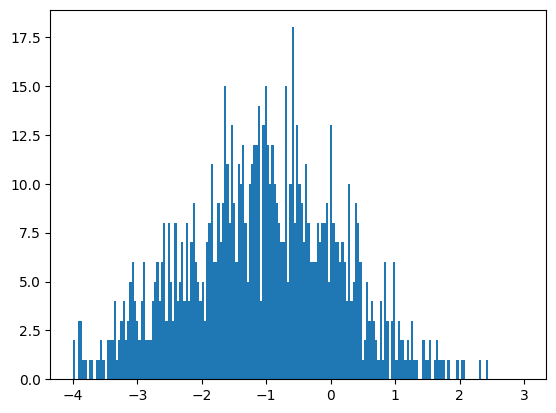

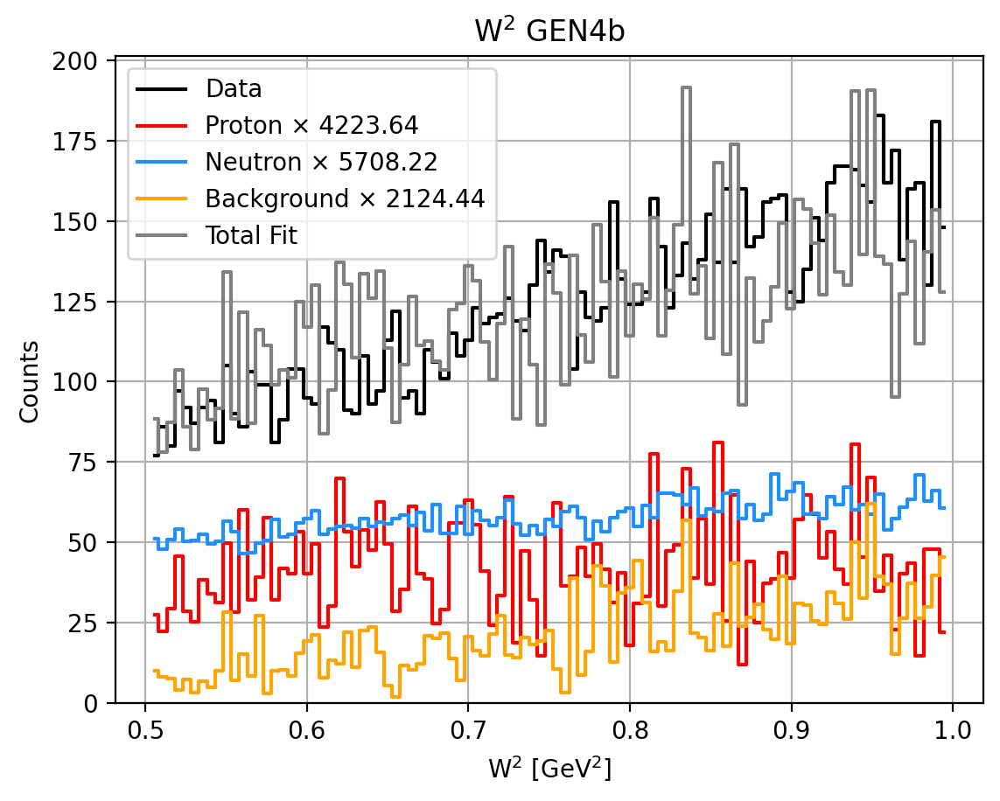

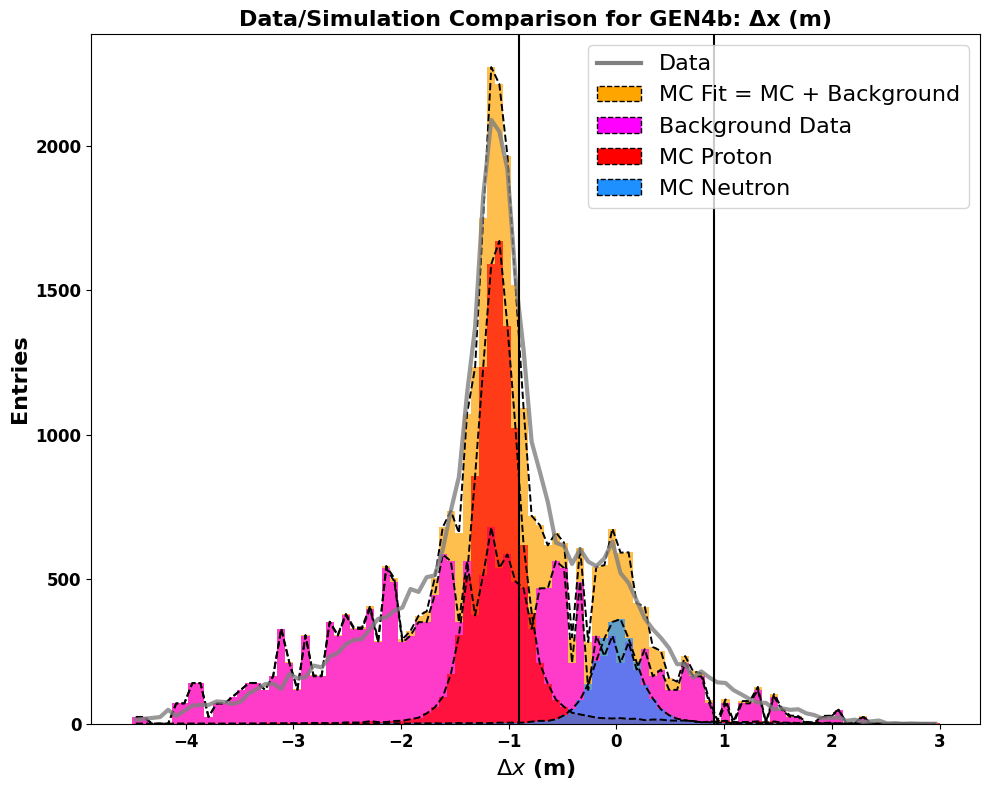

Total entries in fit: 33761.064258204235


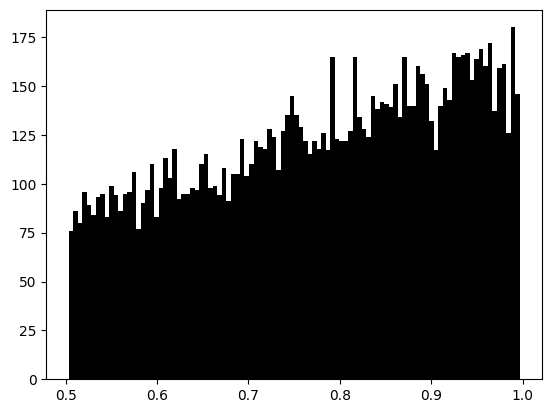

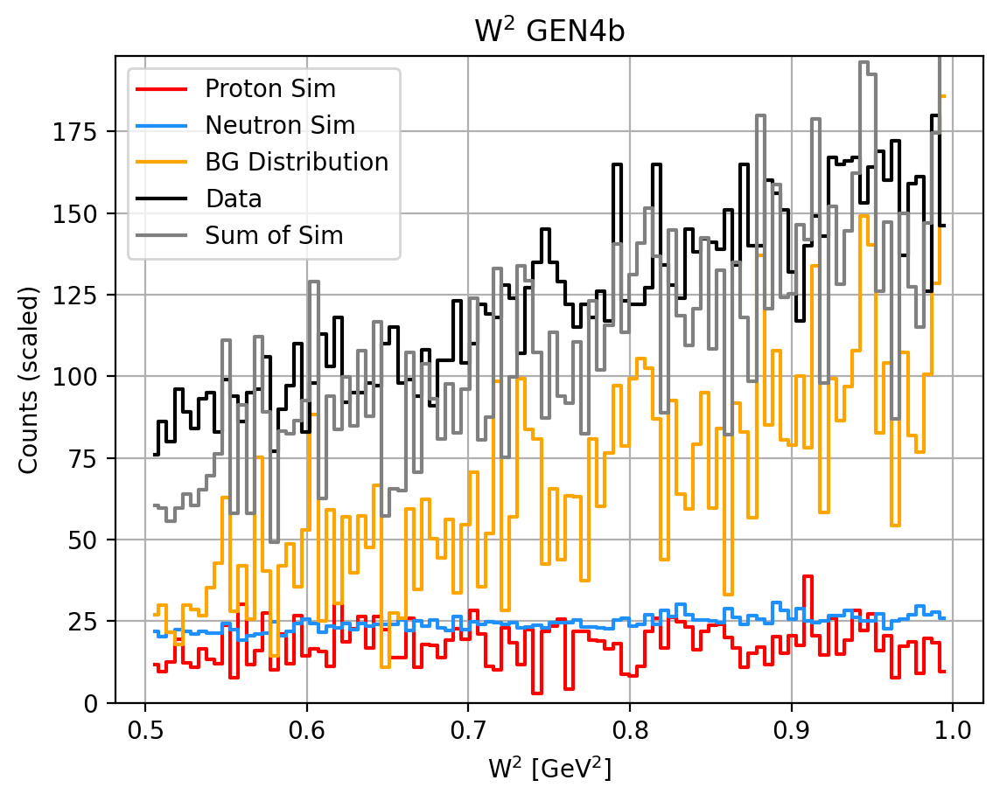

685108 684293
Total events in range (-0.903, 0.906):
  Sim Proton:   1797.03
  Sim Neutron:  2428.66
  Background:   6630.63
  Total:        12213.00
Fraction of events in range (-0.903, 0.906):
   Proton Fraction: 0.15
   Background Fraction: 0.54
   W2 Background Fraction: 0.18
   Neutron Fraction: 0.20
__________________________________________________
Target Weighted Avg: 0.379+-0.0218  5.7639%
Beam Weighted Avg: 0.808+-0.0010  0.1201%
__________________________________________________
epsilon = 0.5707
tau_avg = 2.7925
Q2 = 9.8607
Px: 0.9868 Pz: -0.0293
A = 0.02871 ± 0.02060 ± 0.00254
B = 0.41337 (no propagated error)
C = 0.11638 ± 0.10081 ± 0.01242
__________________________________________________
N_plus: 6110 N_minus: 5967
A_raw: 0.0118+=0.0091
A_raw_weighted: 0.0137+-0.0089  64.6957%
__________________________________________________
A_phys_weighted: 0.14
A_phys_stat_error: 0.1008  71.7653%
A_phys_sys_error: 0.0124  8.841%
GEn/GMn*muN: 0.54877+--0.48530+--0.05979
Relative Error

/tmp/ipykernel_15907/1529990197.py:152: RuntimeWarning: invalid value encountered in divide
  A_raw_per_run = (N_plus_per_run - N_minus_per_run) / (N_plus_per_run + N_minus_per_run)
/tmp/ipykernel_15907/1529990197.py:153: RuntimeWarning: invalid value encountered in divide
  A_raw_error_per_run = 2 * np.sqrt(N_plus_per_run * N_minus_per_run) / (N_plus_per_run + N_minus_per_run)**1.5


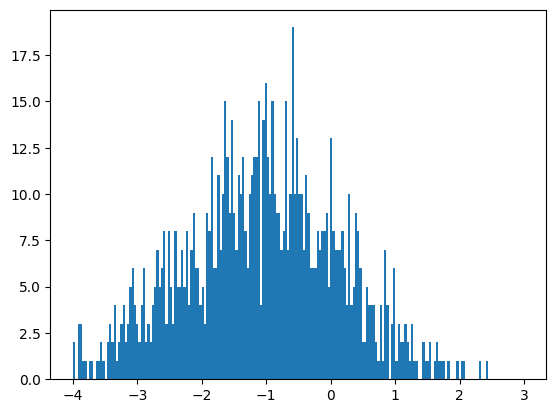

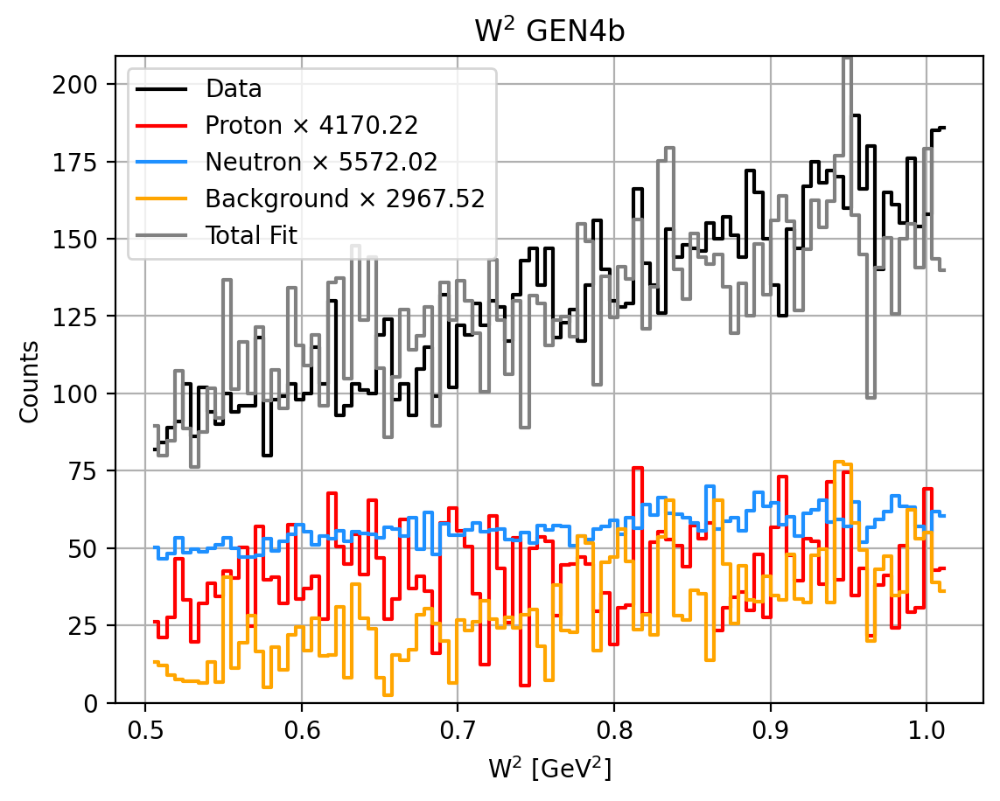

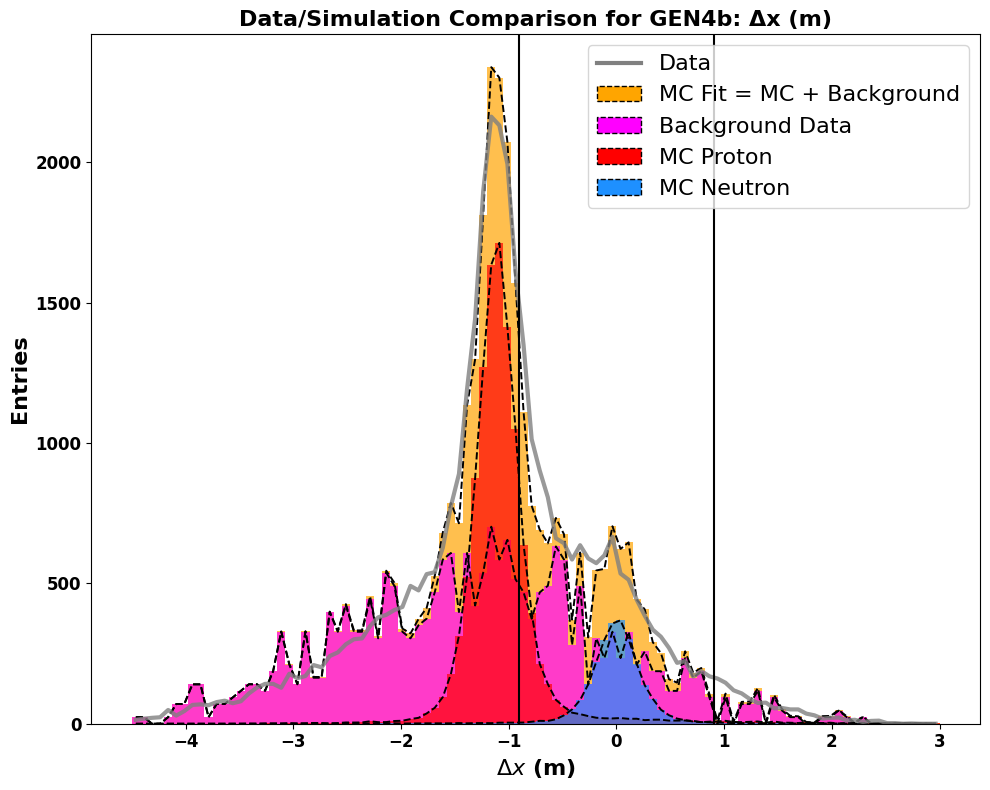

Total entries in fit: 35358.59894276097


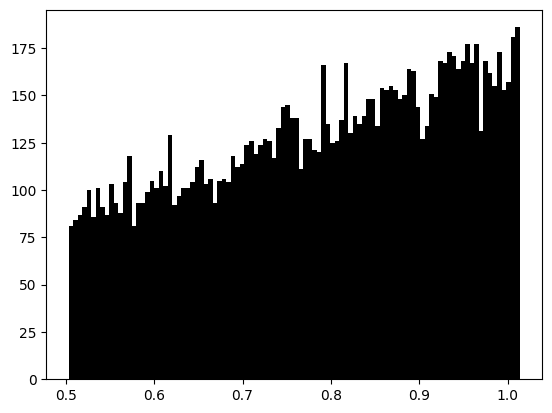

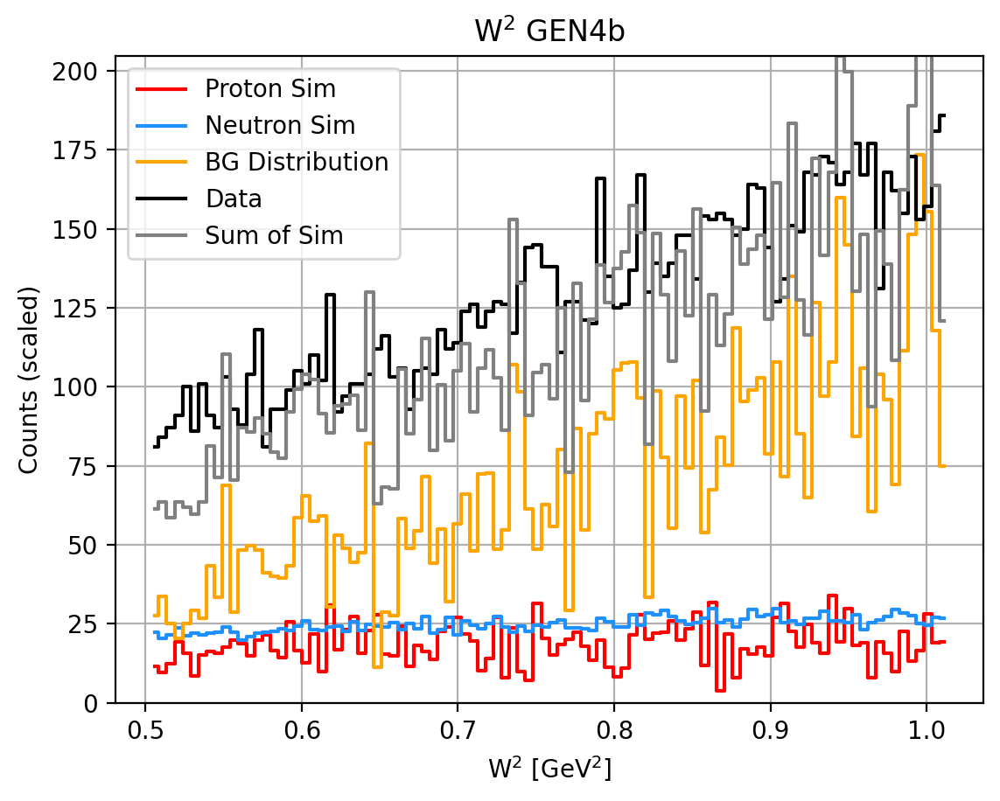

685108 684293
Total events in range (-0.903, 0.906):
  Sim Proton:   1847.37
  Sim Neutron:  2468.35
  Background:   7113.37
  Total:        12779.00
Fraction of events in range (-0.903, 0.906):
   Proton Fraction: 0.14
   Background Fraction: 0.56
   W2 Background Fraction: 0.23
   Neutron Fraction: 0.19
__________________________________________________
Target Weighted Avg: 0.378+-0.0218  5.7557%
Beam Weighted Avg: 0.808+-0.0010  0.1201%
__________________________________________________
epsilon = 0.5708
tau_avg = 2.7910
Q2 = 9.8553
Px: 0.9869 Pz: -0.0290
A = 0.03080 ± 0.02092 ± 0.00269
B = 0.41349 (no propagated error)
C = 0.12677 ± 0.10232 ± 0.01315
__________________________________________________
N_plus: 6401 N_minus: 6237
A_raw: 0.0130+=0.0089
A_raw_weighted: 0.0146+-0.0087  59.5585%
__________________________________________________
A_phys_weighted: 0.151
A_phys_stat_error: 0.1023  67.9338%
A_phys_sys_error: 0.0132  8.733%
GEn/GMn*muN: 0.59967+--0.49599+--0.06376
Relative Erro

/tmp/ipykernel_15907/1529990197.py:152: RuntimeWarning: invalid value encountered in divide
  A_raw_per_run = (N_plus_per_run - N_minus_per_run) / (N_plus_per_run + N_minus_per_run)
/tmp/ipykernel_15907/1529990197.py:153: RuntimeWarning: invalid value encountered in divide
  A_raw_error_per_run = 2 * np.sqrt(N_plus_per_run * N_minus_per_run) / (N_plus_per_run + N_minus_per_run)**1.5


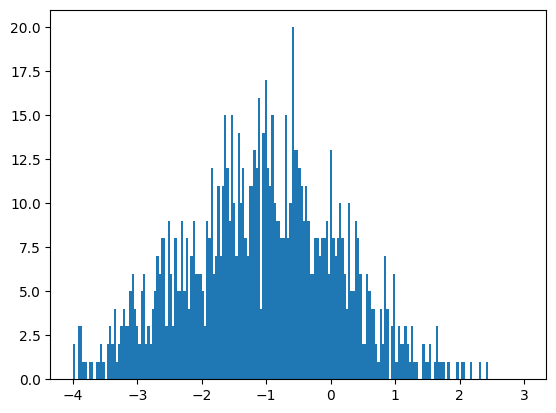

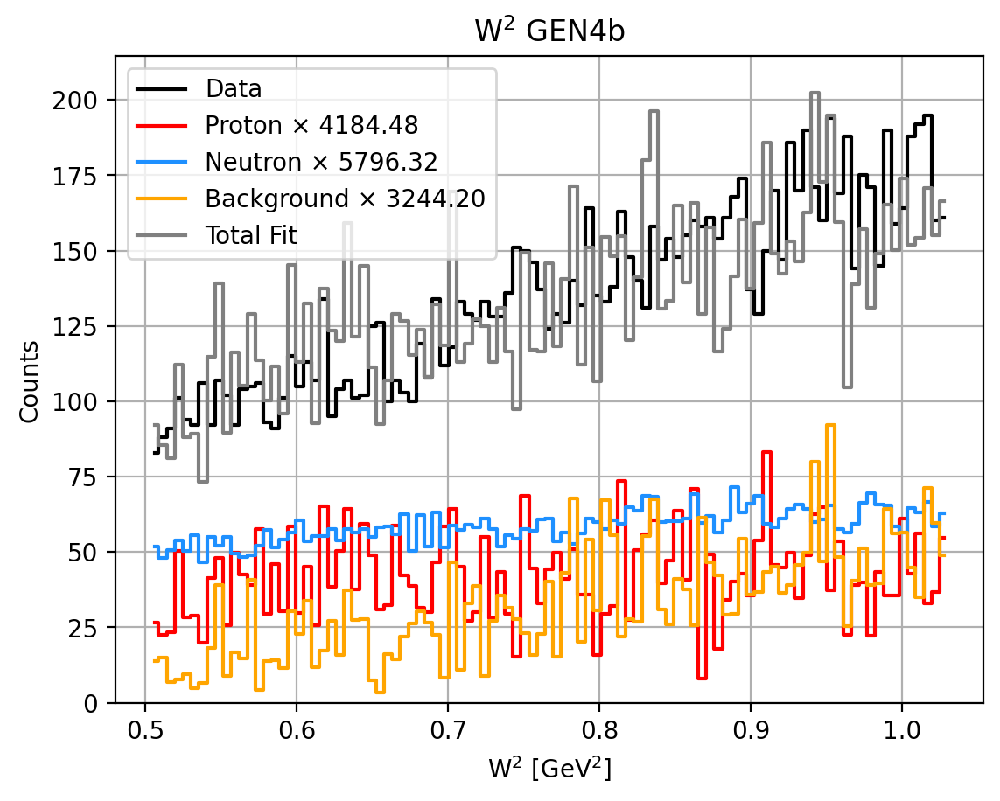

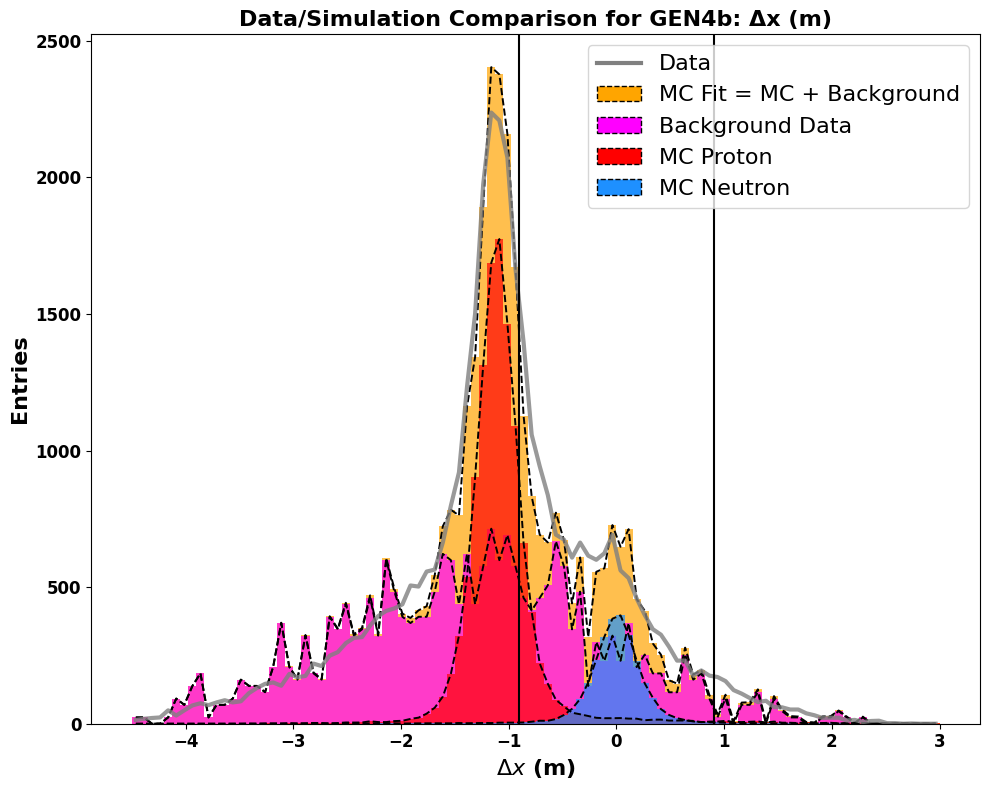

Total entries in fit: 36848.98002784011


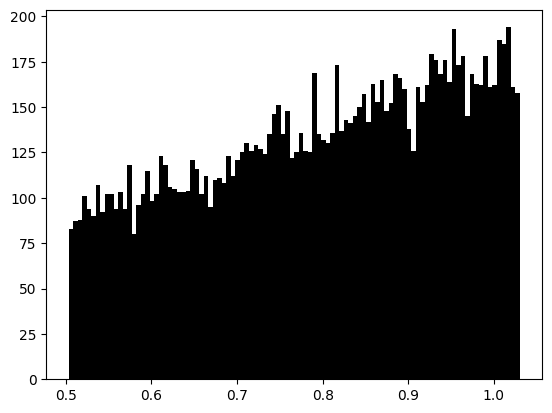

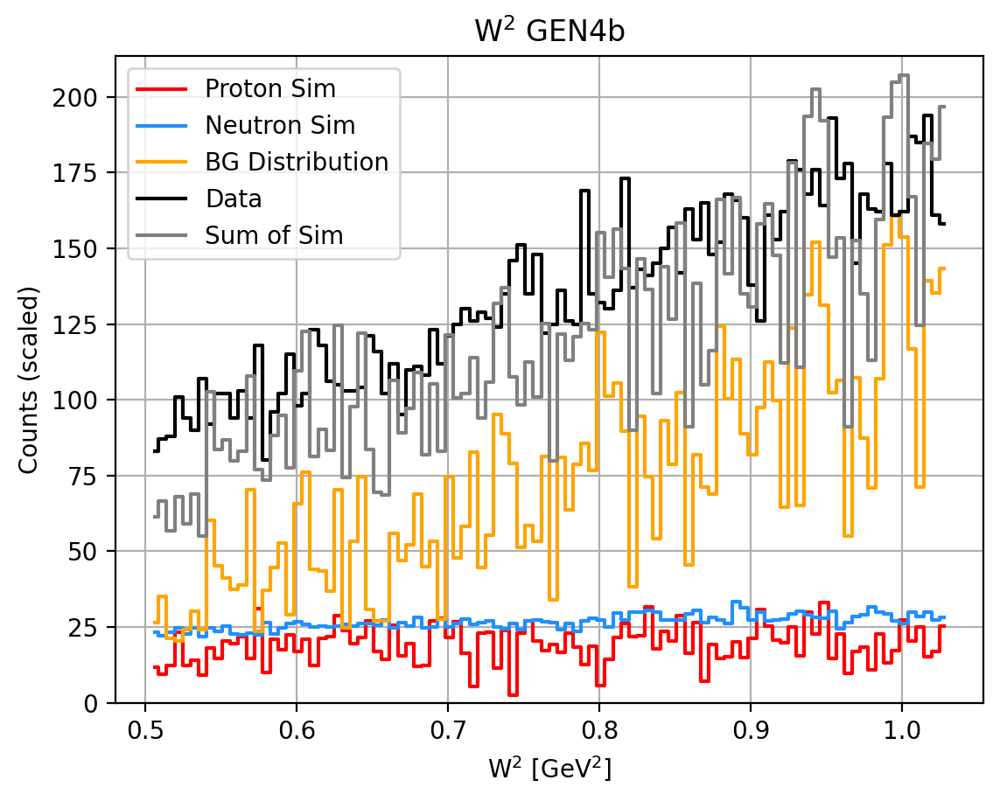

685108 684293
Total events in range (-0.903, 0.906):
  Sim Proton:   1913.73
  Sim Neutron:  2650.89
  Background:   7253.22
  Total:        13315.00
Fraction of events in range (-0.903, 0.906):
   Proton Fraction: 0.14
   Background Fraction: 0.54
   W2 Background Fraction: 0.25
   Neutron Fraction: 0.20
__________________________________________________
Target Weighted Avg: 0.378+-0.0219  5.7944%
Beam Weighted Avg: 0.808+-0.0010  0.1201%
__________________________________________________
epsilon = 0.5710
tau_avg = 2.7889
Q2 = 9.8481
Px: 0.9869 Pz: -0.0288
A = 0.02514 ± 0.01968 ± 0.00234
B = 0.41361 (no propagated error)
C = 0.09912 ± 0.09614 ± 0.01143
__________________________________________________
N_plus: 6672 N_minus: 6501
A_raw: 0.0130+=0.0087
A_raw_weighted: 0.013+-0.0085  65.4386%
__________________________________________________
A_phys_weighted: 0.123
A_phys_stat_error: 0.0961  78.2862%
A_phys_sys_error: 0.0114  9.311%
GEn/GMn*muN: 0.46466+--0.45757+--0.05442
Relative Error

/tmp/ipykernel_15907/1529990197.py:152: RuntimeWarning: invalid value encountered in divide
  A_raw_per_run = (N_plus_per_run - N_minus_per_run) / (N_plus_per_run + N_minus_per_run)
/tmp/ipykernel_15907/1529990197.py:153: RuntimeWarning: invalid value encountered in divide
  A_raw_error_per_run = 2 * np.sqrt(N_plus_per_run * N_minus_per_run) / (N_plus_per_run + N_minus_per_run)**1.5


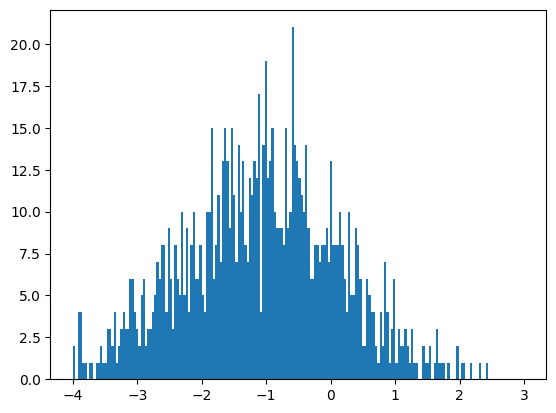

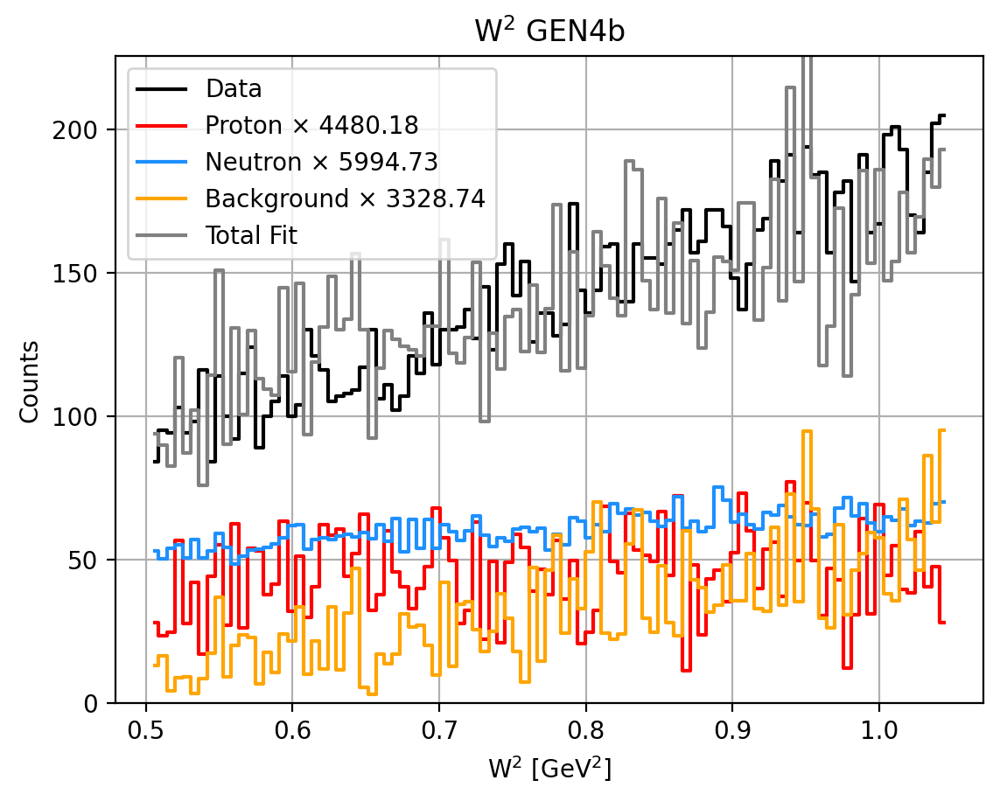

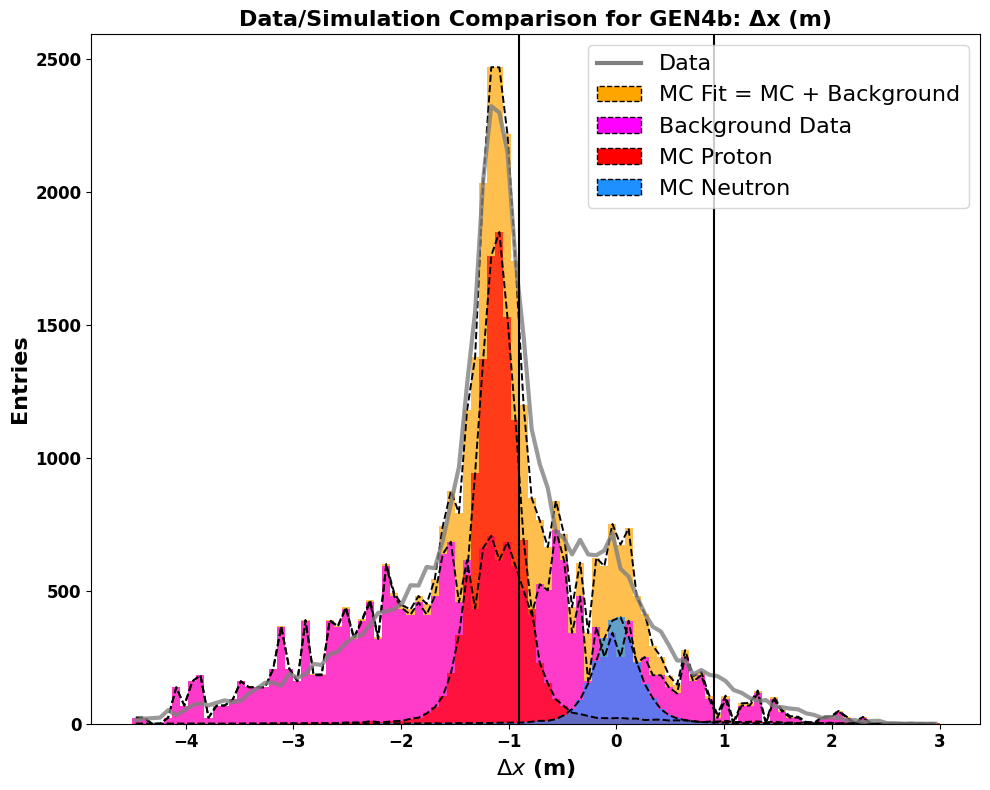

Total entries in fit: 38344.520480692016


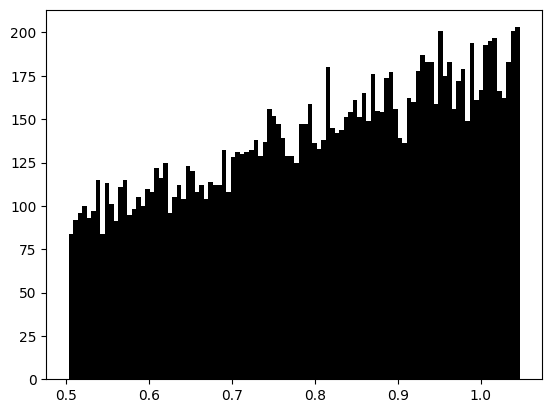

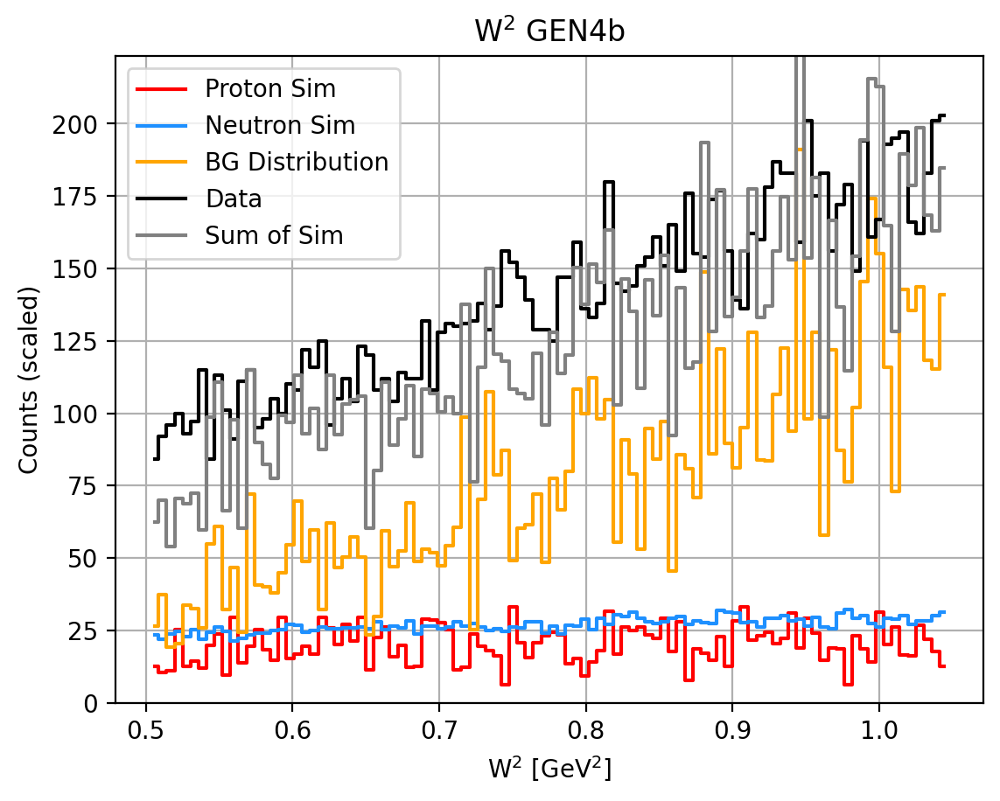

685108 684293
Total events in range (-0.903, 0.906):
  Sim Proton:   1999.79
  Sim Neutron:  2675.82
  Background:   7642.36
  Total:        13908.00
Fraction of events in range (-0.903, 0.906):
   Proton Fraction: 0.14
   Background Fraction: 0.55
   W2 Background Fraction: 0.24
   Neutron Fraction: 0.19
__________________________________________________
Target Weighted Avg: 0.378+-0.0219  5.7932%
Beam Weighted Avg: 0.808+-0.0010  0.1201%
__________________________________________________
epsilon = 0.5712
tau_avg = 2.7869
Q2 = 9.8409
Px: 0.9869 Pz: -0.0286
A = 0.02792 ± 0.01959 ± 0.00247
B = 0.41375 (no propagated error)
C = 0.11273 ± 0.09560 ± 0.01207
__________________________________________________
N_plus: 6983 N_minus: 6780
A_raw: 0.0147+=0.0085
A_raw_weighted: 0.0144+-0.0083  57.9470%
__________________________________________________
A_phys_weighted: 0.136
A_phys_stat_error: 0.0956  70.1854%
A_phys_sys_error: 0.0121  8.859%
GEn/GMn*muN: 0.53041+--0.45864+--0.05789
Relative Erro

/tmp/ipykernel_15907/1529990197.py:152: RuntimeWarning: invalid value encountered in divide
  A_raw_per_run = (N_plus_per_run - N_minus_per_run) / (N_plus_per_run + N_minus_per_run)
/tmp/ipykernel_15907/1529990197.py:153: RuntimeWarning: invalid value encountered in divide
  A_raw_error_per_run = 2 * np.sqrt(N_plus_per_run * N_minus_per_run) / (N_plus_per_run + N_minus_per_run)**1.5


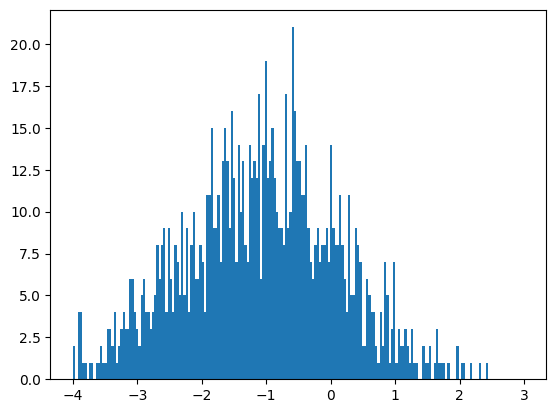

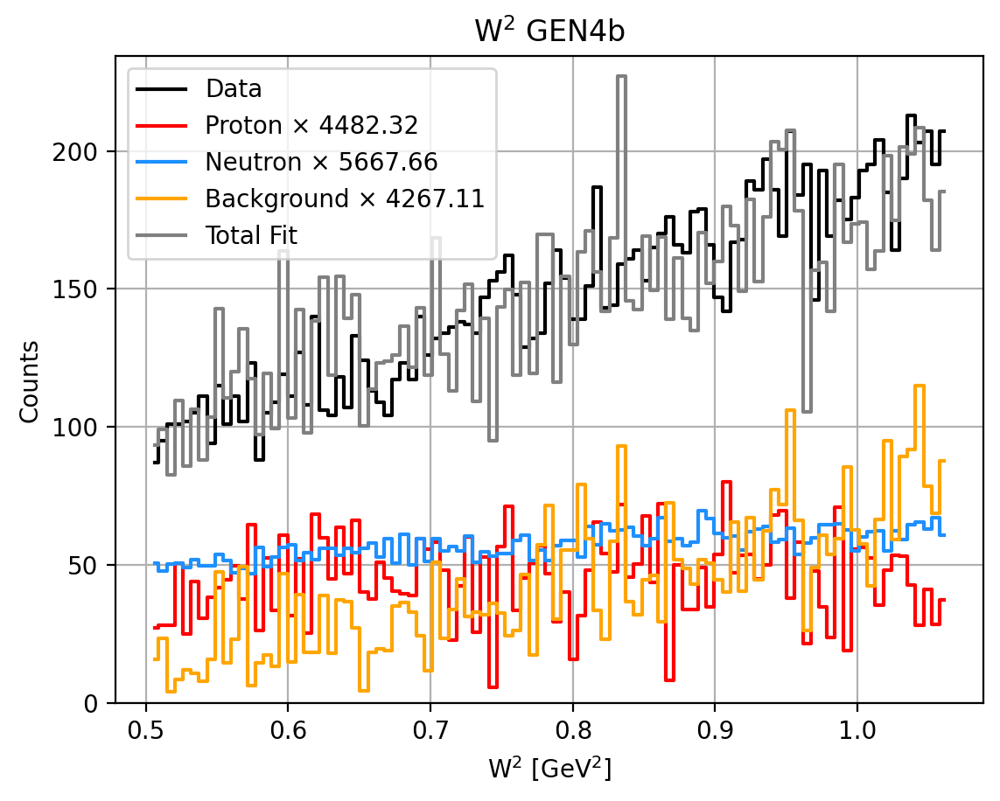

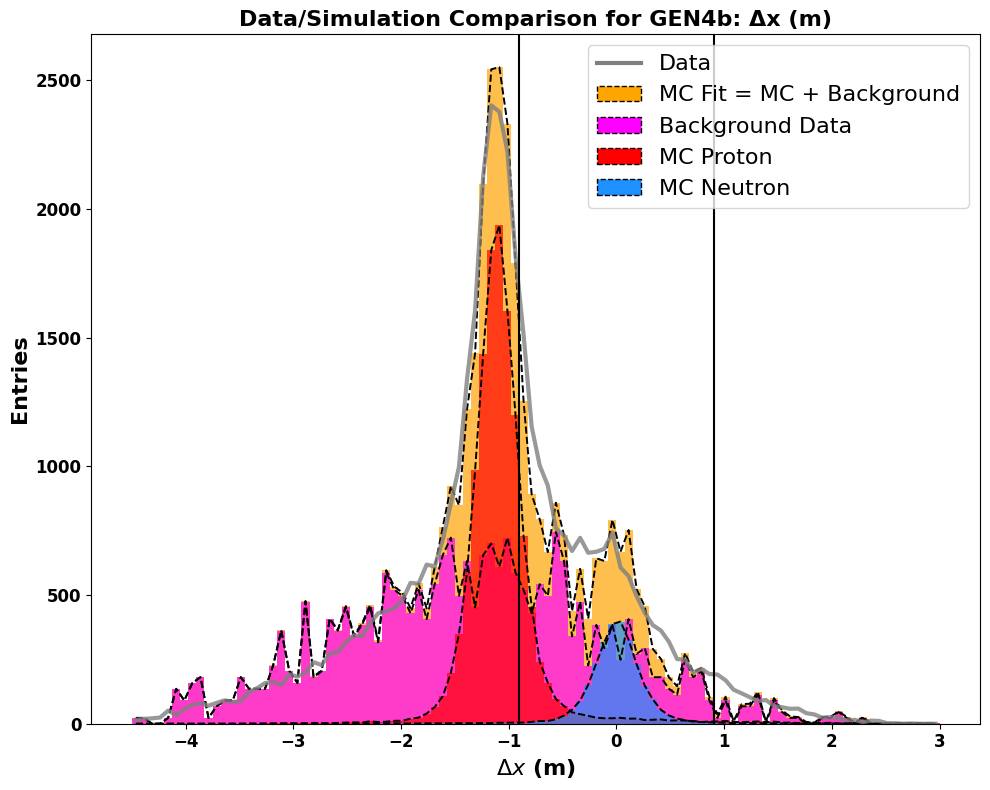

Total entries in fit: 39858.63833647


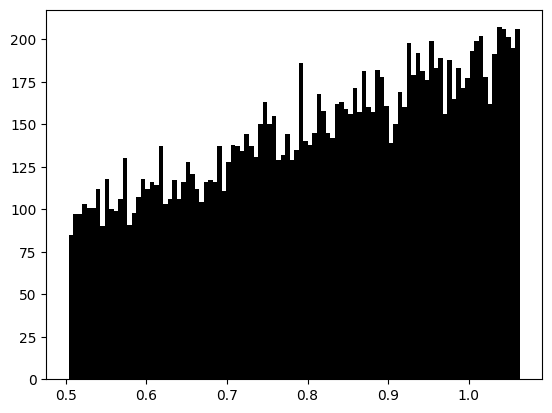

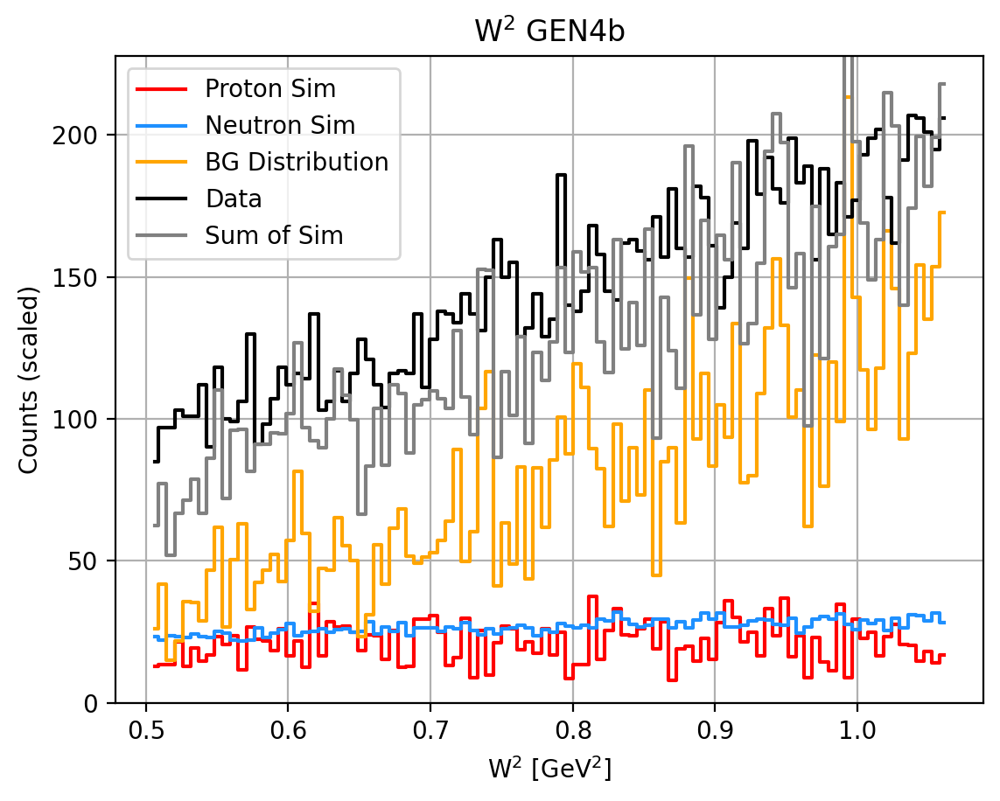

685108 684293
Total events in range (-0.903, 0.906):
  Sim Proton:   2098.92
  Sim Neutron:  2653.98
  Background:   8018.88
  Total:        14504.00
Fraction of events in range (-0.903, 0.906):
   Proton Fraction: 0.14
   Background Fraction: 0.55
   W2 Background Fraction: 0.30
   Neutron Fraction: 0.18
__________________________________________________
Target Weighted Avg: 0.378+-0.0219  5.7961%
Beam Weighted Avg: 0.808+-0.0010  0.1201%
__________________________________________________
epsilon = 0.5714
tau_avg = 2.7849
Q2 = 9.8338
Px: 0.9869 Pz: -0.0284
A = 0.02876 ± 0.01951 ± 0.00251
B = 0.41388 (no propagated error)
C = 0.11689 ± 0.09508 ± 0.01225
__________________________________________________
N_plus: 7278 N_minus: 7070
A_raw: 0.0145+=0.0083
A_raw_weighted: 0.0145+-0.0082  56.5231%
__________________________________________________
A_phys_weighted: 0.14
A_phys_stat_error: 0.0951  67.8240%
A_phys_sys_error: 0.0123  8.739%
GEn/GMn*muN: 0.55051+--0.45720+--0.05891
Relative Error

/tmp/ipykernel_15907/1529990197.py:152: RuntimeWarning: invalid value encountered in divide
  A_raw_per_run = (N_plus_per_run - N_minus_per_run) / (N_plus_per_run + N_minus_per_run)
/tmp/ipykernel_15907/1529990197.py:153: RuntimeWarning: invalid value encountered in divide
  A_raw_error_per_run = 2 * np.sqrt(N_plus_per_run * N_minus_per_run) / (N_plus_per_run + N_minus_per_run)**1.5


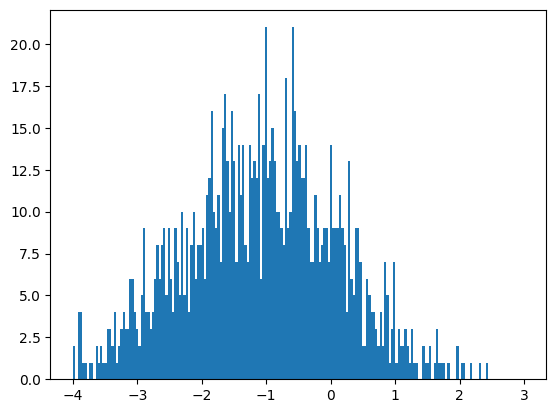

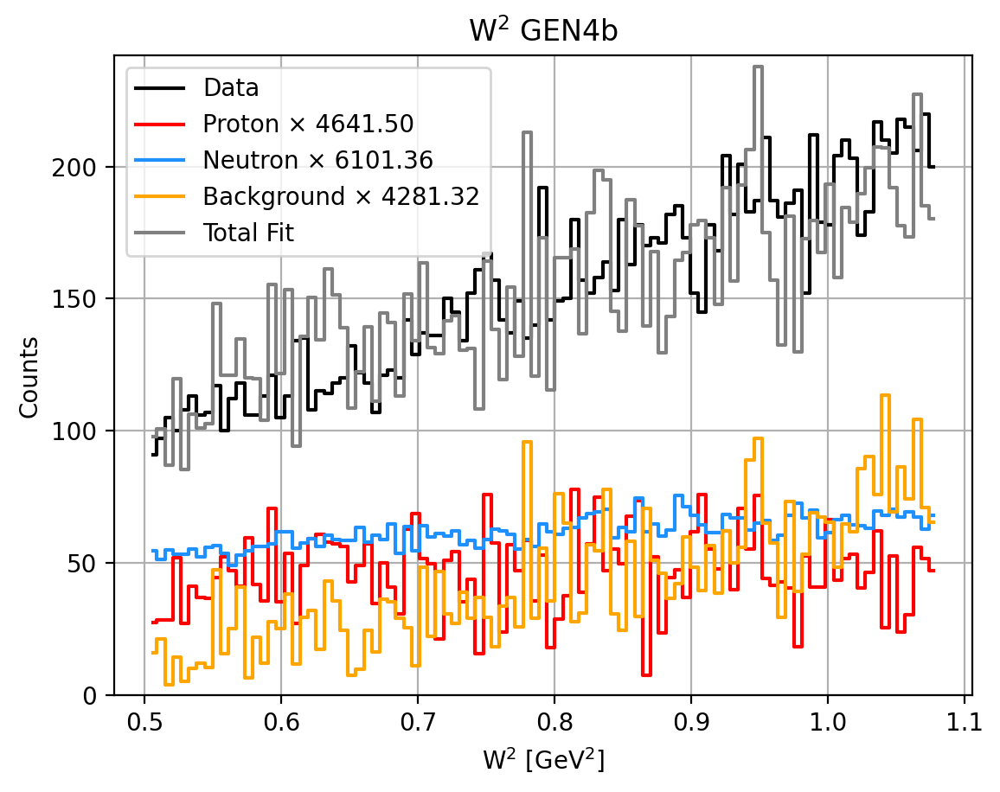

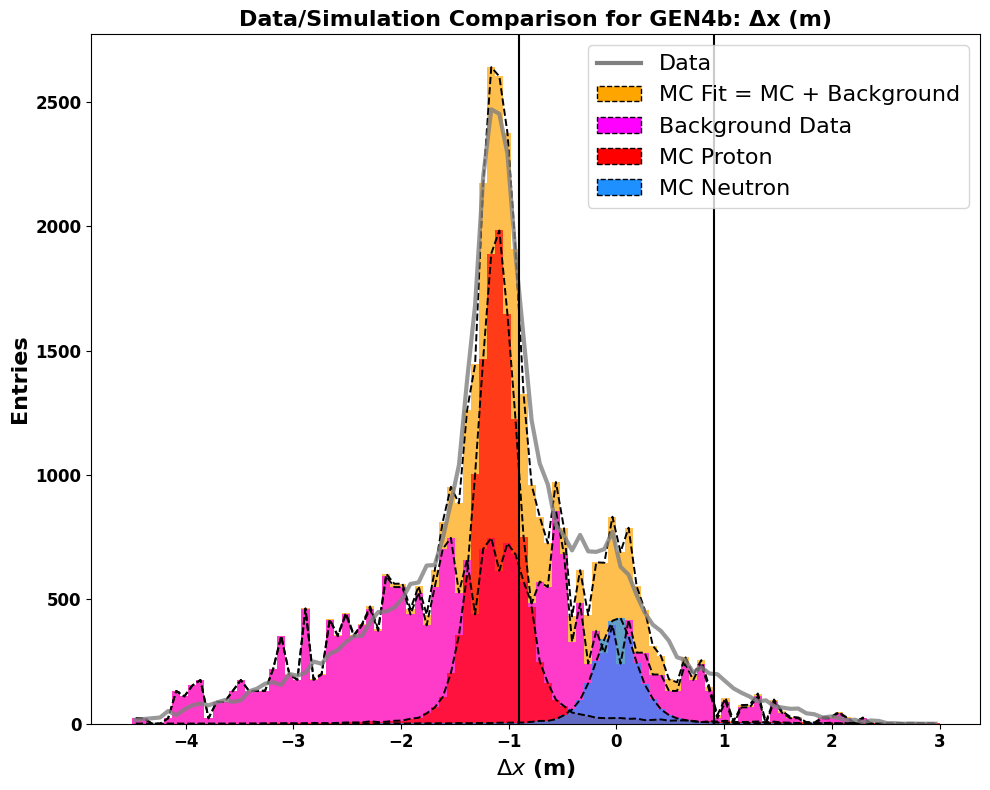

Total entries in fit: 41340.95155202358


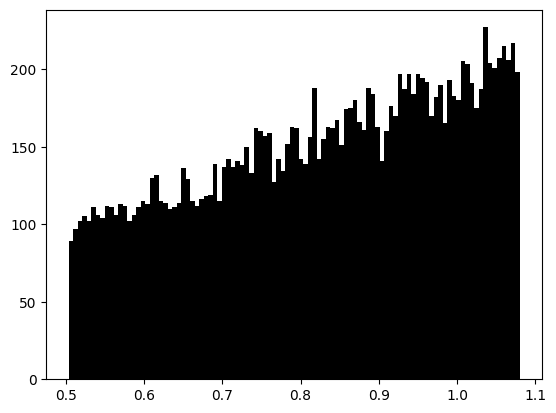

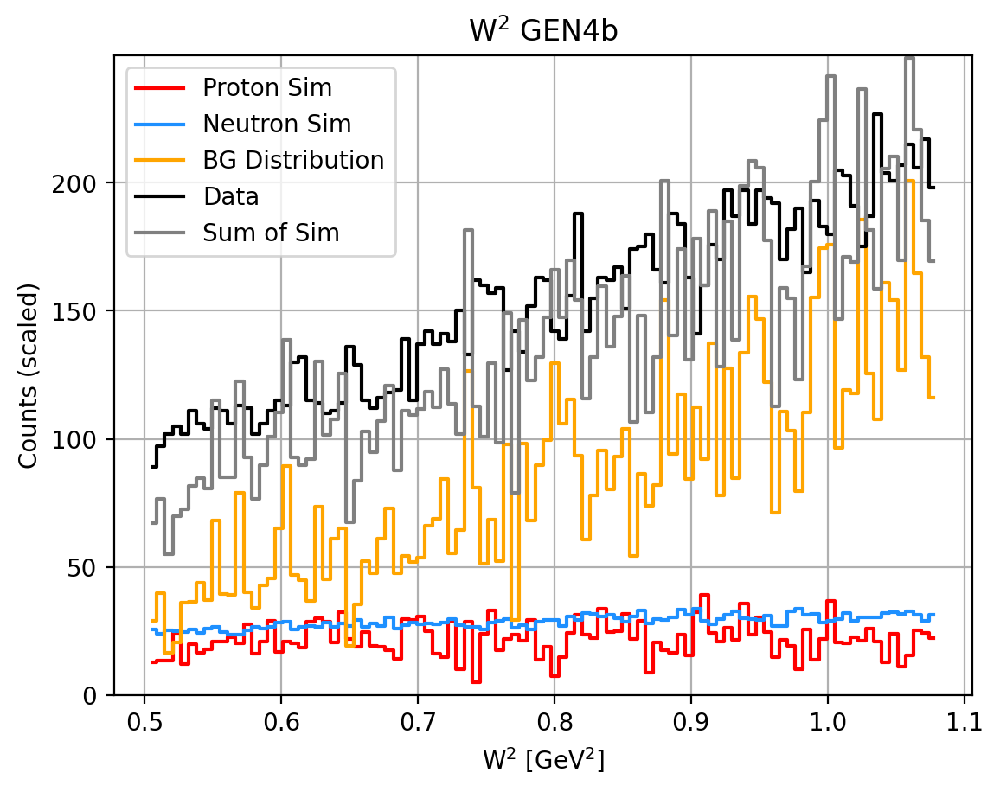

685108 684293
Total events in range (-0.903, 0.906):
  Sim Proton:   2159.80
  Sim Neutron:  2839.11
  Background:   8503.87
  Total:        15107.00
Fraction of events in range (-0.903, 0.906):
   Proton Fraction: 0.14
   Background Fraction: 0.56
   W2 Background Fraction: 0.28
   Neutron Fraction: 0.19
__________________________________________________
Target Weighted Avg: 0.378+-0.0219  5.7983%
Beam Weighted Avg: 0.808+-0.0010  0.1201%
__________________________________________________
epsilon = 0.5716
tau_avg = 2.7829
Q2 = 9.8269
Px: 0.9869 Pz: -0.0281
A = 0.02620 ± 0.01970 ± 0.00243
B = 0.41401 (no propagated error)
C = 0.10448 ± 0.09590 ± 0.01182
__________________________________________________
N_plus: 7566 N_minus: 7377
A_raw: 0.0126+=0.0082
A_raw_weighted: 0.0128+-0.0080  62.8539%
__________________________________________________
A_phys_weighted: 0.128
A_phys_stat_error: 0.0959  75.1727%
A_phys_sys_error: 0.0118  9.262%
GEn/GMn*muN: 0.49003+--0.45739+--0.05636
Relative Erro

/tmp/ipykernel_15907/1529990197.py:152: RuntimeWarning: invalid value encountered in divide
  A_raw_per_run = (N_plus_per_run - N_minus_per_run) / (N_plus_per_run + N_minus_per_run)
/tmp/ipykernel_15907/1529990197.py:153: RuntimeWarning: invalid value encountered in divide
  A_raw_error_per_run = 2 * np.sqrt(N_plus_per_run * N_minus_per_run) / (N_plus_per_run + N_minus_per_run)**1.5


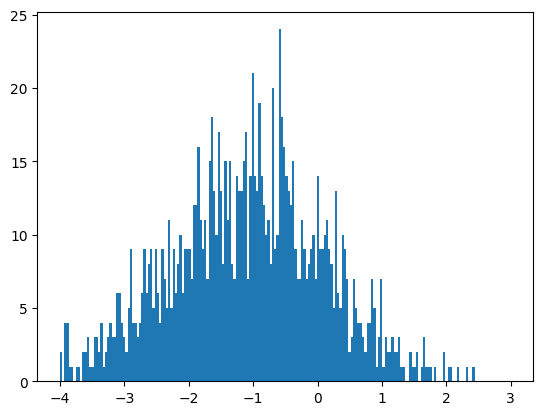

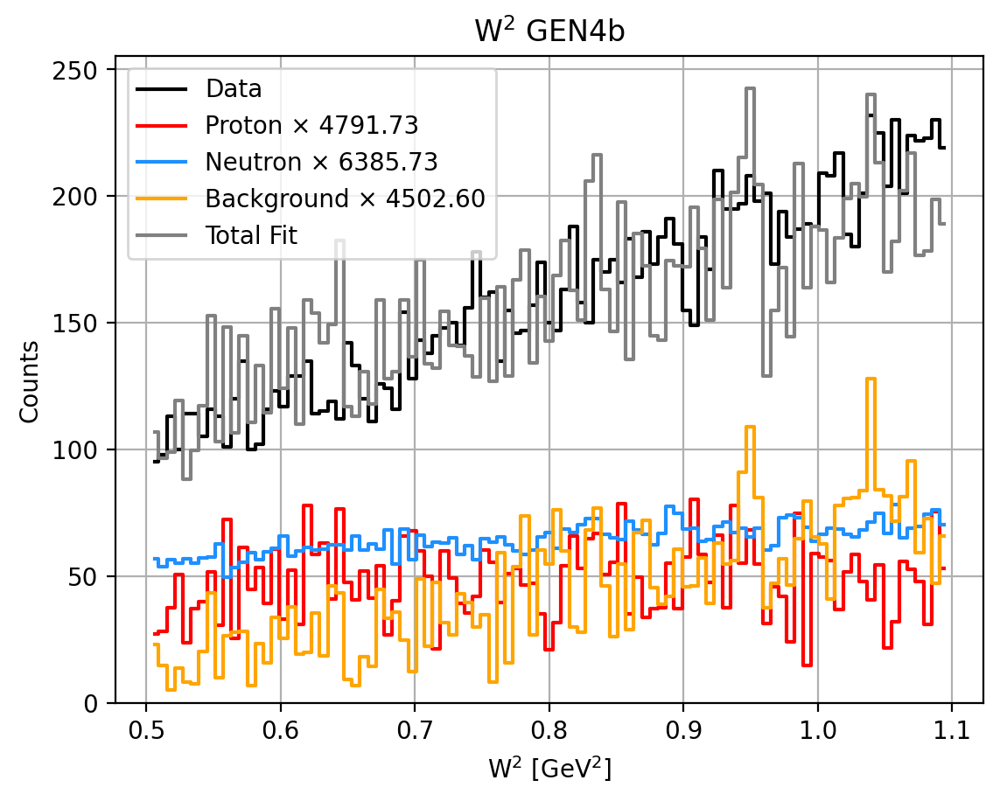

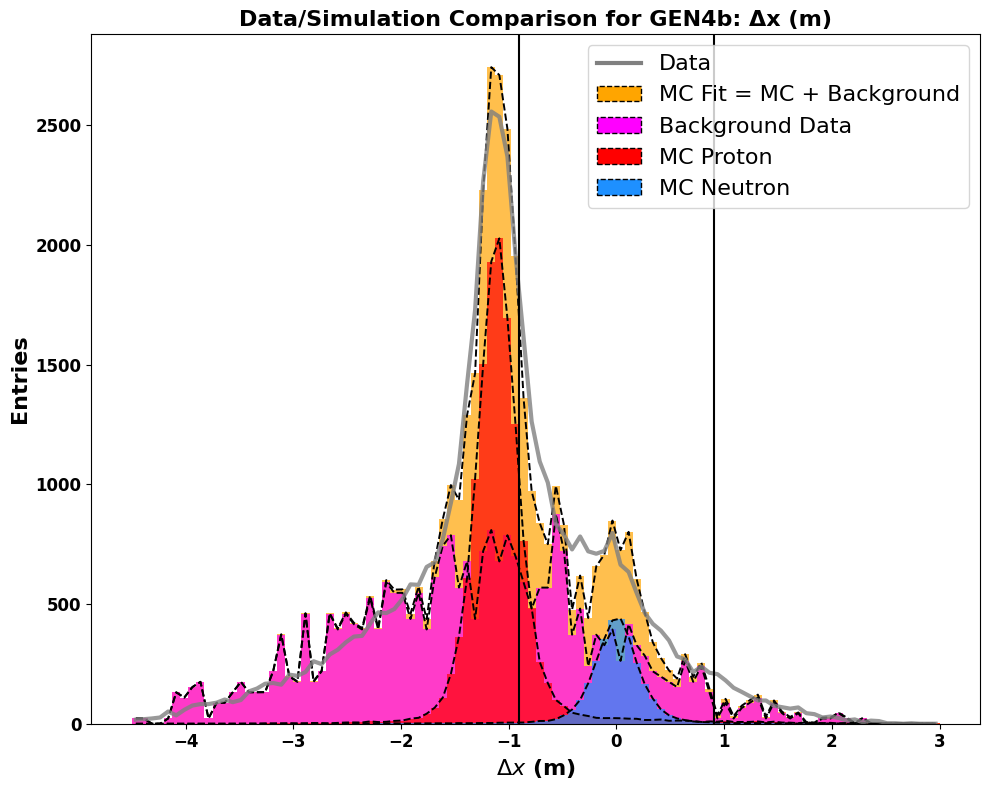

Total entries in fit: 42876.394907923604


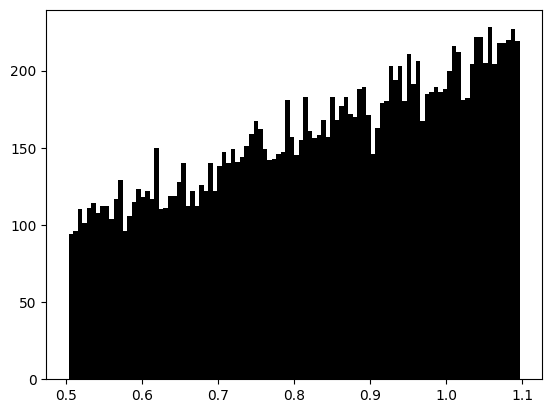

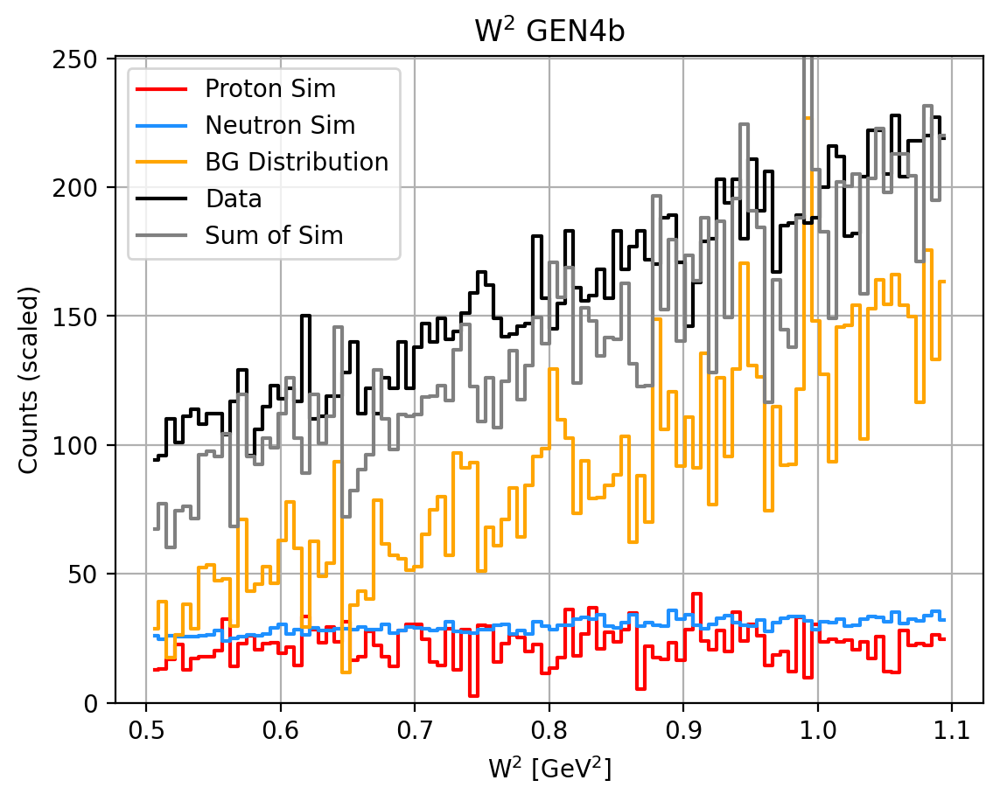

685108 684293
Total events in range (-0.903, 0.906):
  Sim Proton:   2214.29
  Sim Neutron:  2950.88
  Background:   8833.98
  Total:        15737.00
Fraction of events in range (-0.903, 0.906):
   Proton Fraction: 0.14
   Background Fraction: 0.56
   W2 Background Fraction: 0.29
   Neutron Fraction: 0.19
__________________________________________________
Target Weighted Avg: 0.378+-0.0219  5.7967%
Beam Weighted Avg: 0.808+-0.0010  0.1201%
__________________________________________________
epsilon = 0.5718
tau_avg = 2.7806
Q2 = 9.8188
Px: 0.9869 Pz: -0.0279
A = 0.02801 ± 0.01911 ± 0.00247
B = 0.41416 (no propagated error)
C = 0.11328 ± 0.09291 ± 0.01199
__________________________________________________
N_plus: 7886 N_minus: 7684
A_raw: 0.0130+=0.0080
A_raw_weighted: 0.0135+-0.0079  58.5238%
__________________________________________________
A_phys_weighted: 0.136
A_phys_stat_error: 0.0929  68.2144%
A_phys_sys_error: 0.0120  8.807%
GEn/GMn*muN: 0.53254+--0.44539+--0.05750
Relative Erro

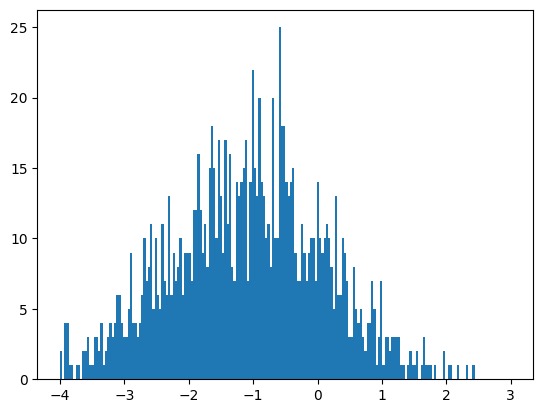

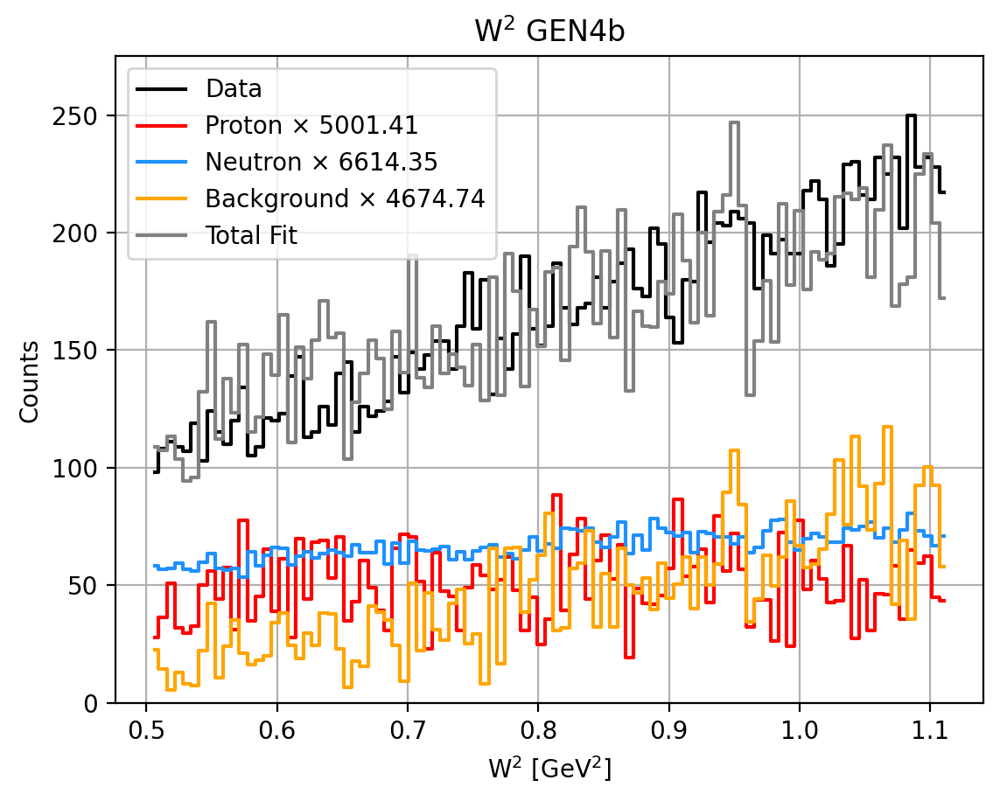

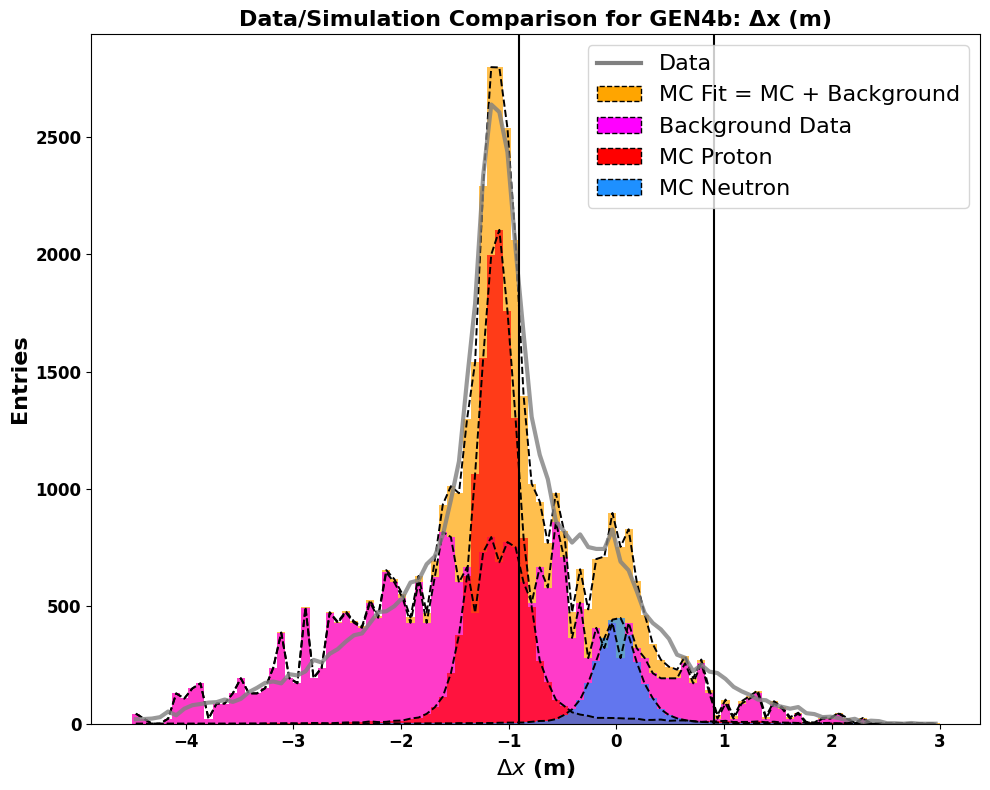

Total entries in fit: 44559.81402031276


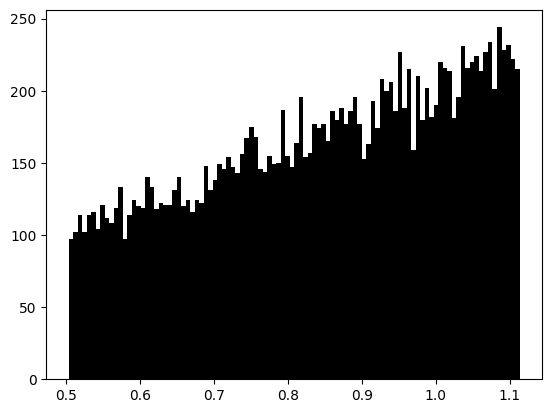

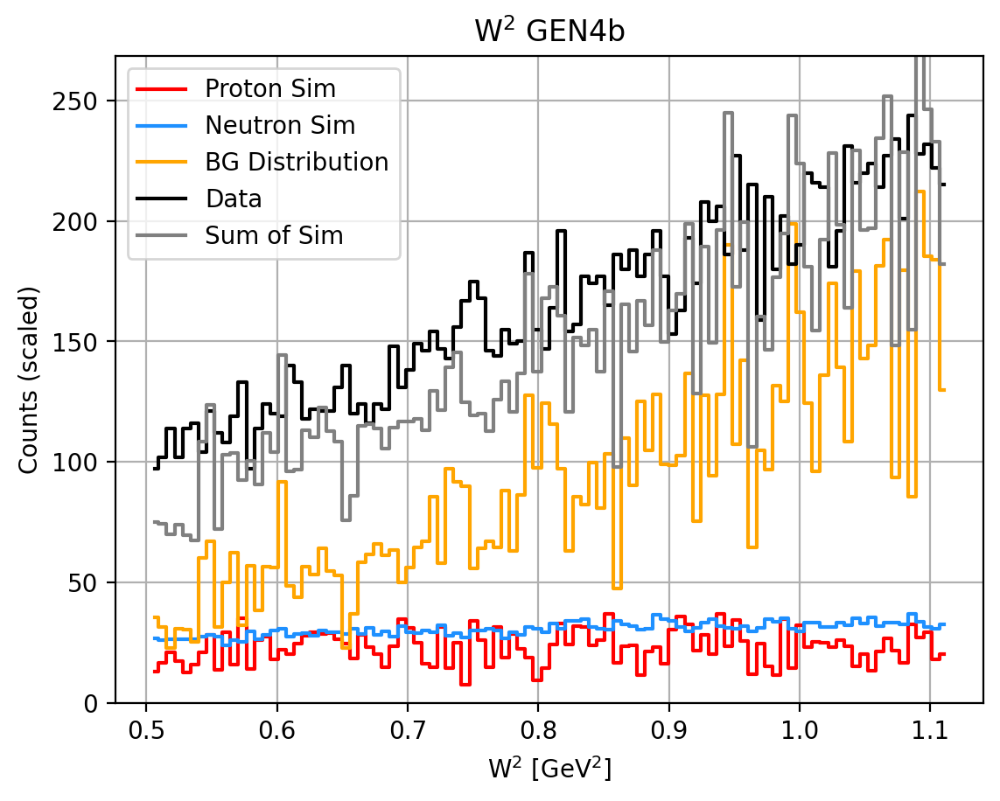

685108 684293
Total events in range (-0.903, 0.906):
  Sim Proton:   2297.09
  Sim Neutron:  3037.90
  Background:   9181.67
  Total:        16340.00
Fraction of events in range (-0.903, 0.906):
   Proton Fraction: 0.14
   Background Fraction: 0.56
   W2 Background Fraction: 0.29
   Neutron Fraction: 0.19
__________________________________________________
Target Weighted Avg: 0.378+-0.0219  5.7906%
Beam Weighted Avg: 0.808+-0.0010  0.1201%
__________________________________________________
epsilon = 0.5720
tau_avg = 2.7787
Q2 = 9.8120
Px: 0.9870 Pz: -0.0277
A = 0.03426 ± 0.01879 ± 0.00276
B = 0.41430 (no propagated error)
C = 0.14368 ± 0.09128 ± 0.01340
__________________________________________________
N_plus: 8217 N_minus: 7954
A_raw: 0.0163+=0.0079
A_raw_weighted: 0.016+-0.0077  48.1942%
__________________________________________________
A_phys_weighted: 0.166
A_phys_stat_error: 0.0913  54.8516%
A_phys_sys_error: 0.0134  8.054%
GEn/GMn*muN: 0.68266+--0.44747+--0.06570
Relative Error

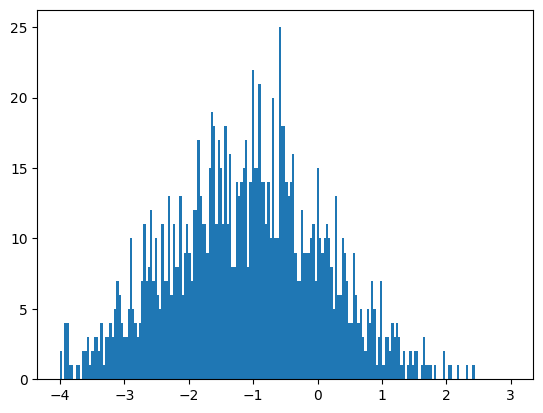

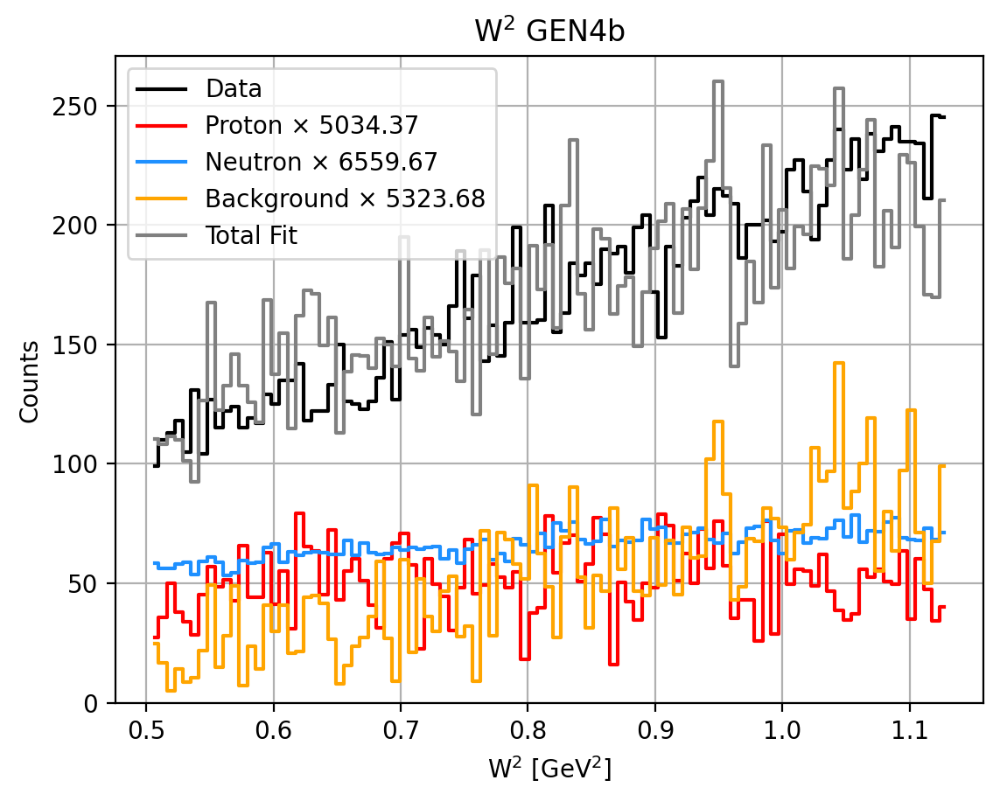

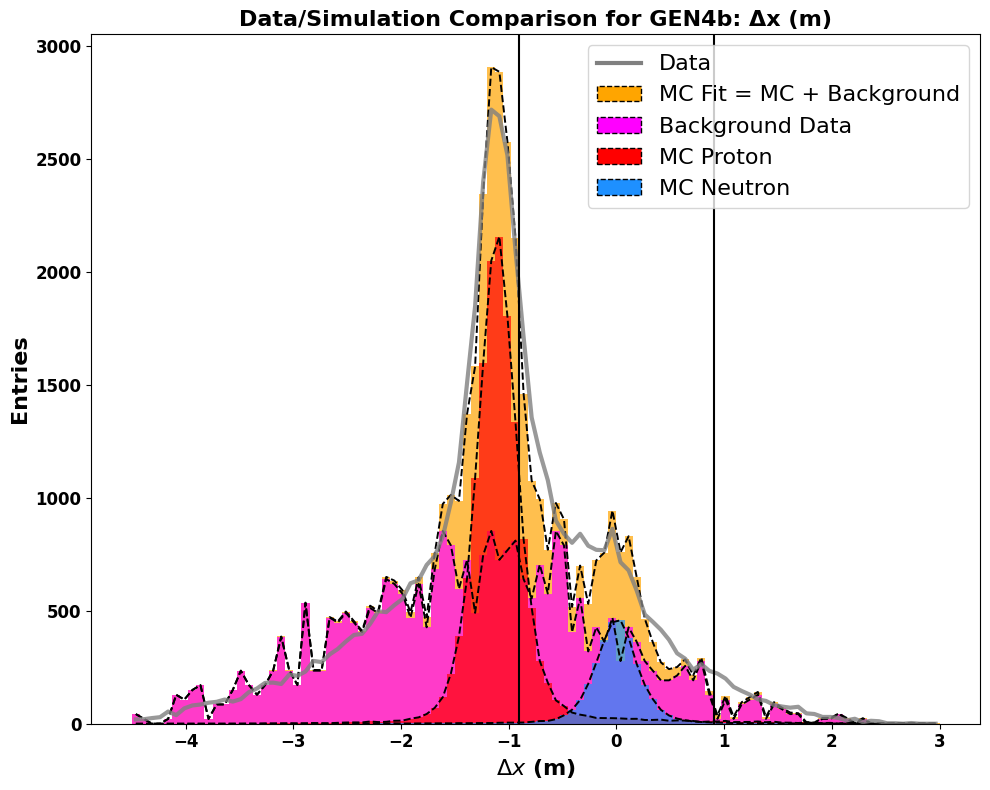

Total entries in fit: 46224.791076610345


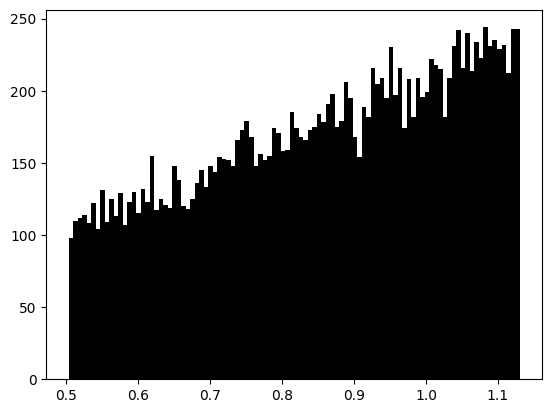

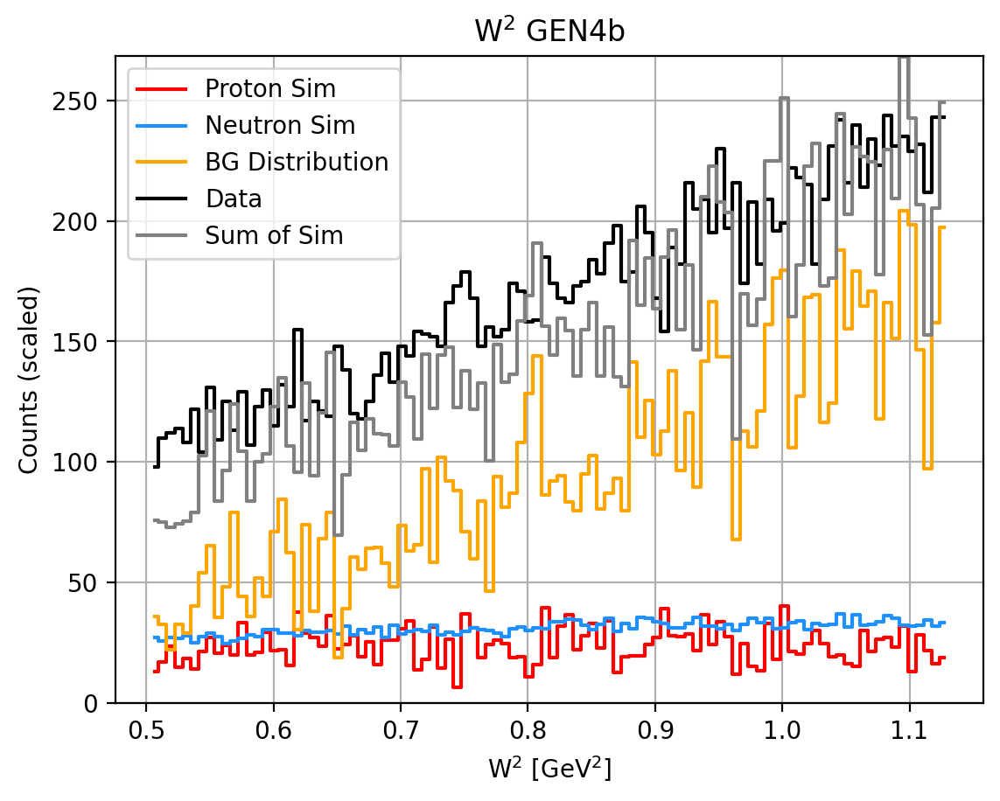

685108 684293
Total events in range (-0.903, 0.906):
  Sim Proton:   2359.78
  Sim Neutron:  3074.74
  Background:   9688.60
  Total:        16963.00
Fraction of events in range (-0.903, 0.906):
   Proton Fraction: 0.14
   Background Fraction: 0.57
   W2 Background Fraction: 0.31
   Neutron Fraction: 0.18
__________________________________________________
Target Weighted Avg: 0.378+-0.0219  5.7869%
Beam Weighted Avg: 0.808+-0.0010  0.1201%
__________________________________________________
epsilon = 0.5723
tau_avg = 2.7764
Q2 = 9.8039
Px: 0.9869 Pz: -0.0275
A = 0.03363 ± 0.01898 ± 0.00276
B = 0.41443 (no propagated error)
C = 0.14061 ± 0.09207 ± 0.01337
__________________________________________________
N_plus: 8529 N_minus: 8263
A_raw: 0.0158+=0.0077
A_raw_weighted: 0.0151+-0.0076  50.2675%
__________________________________________________
A_phys_weighted: 0.163
A_phys_stat_error: 0.0921  56.4252%
A_phys_sys_error: 0.0134  8.197%
GEn/GMn*muN: 0.66703+--0.45005+--0.06538
Relative Erro

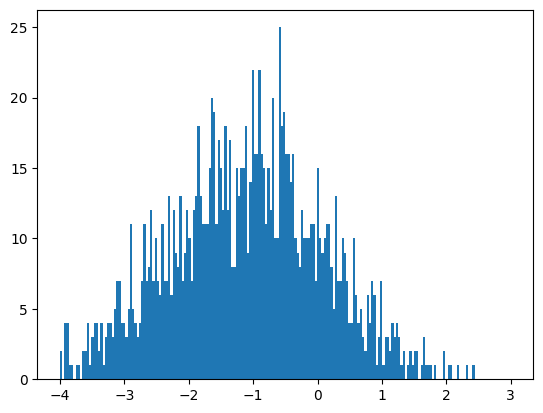

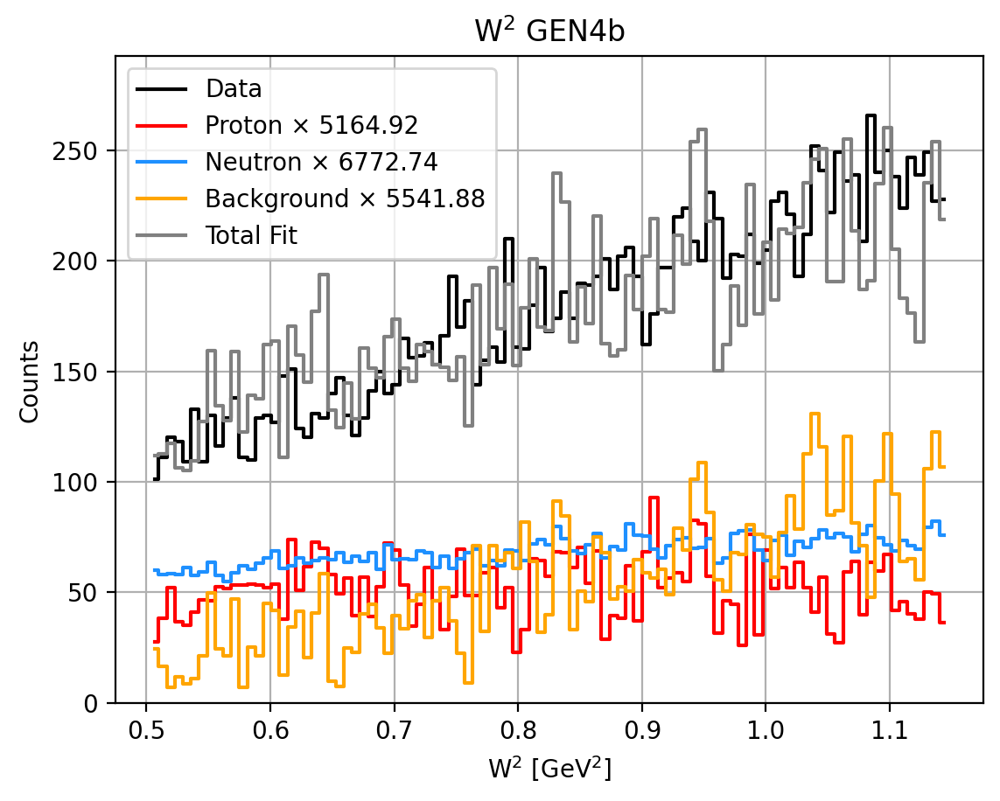

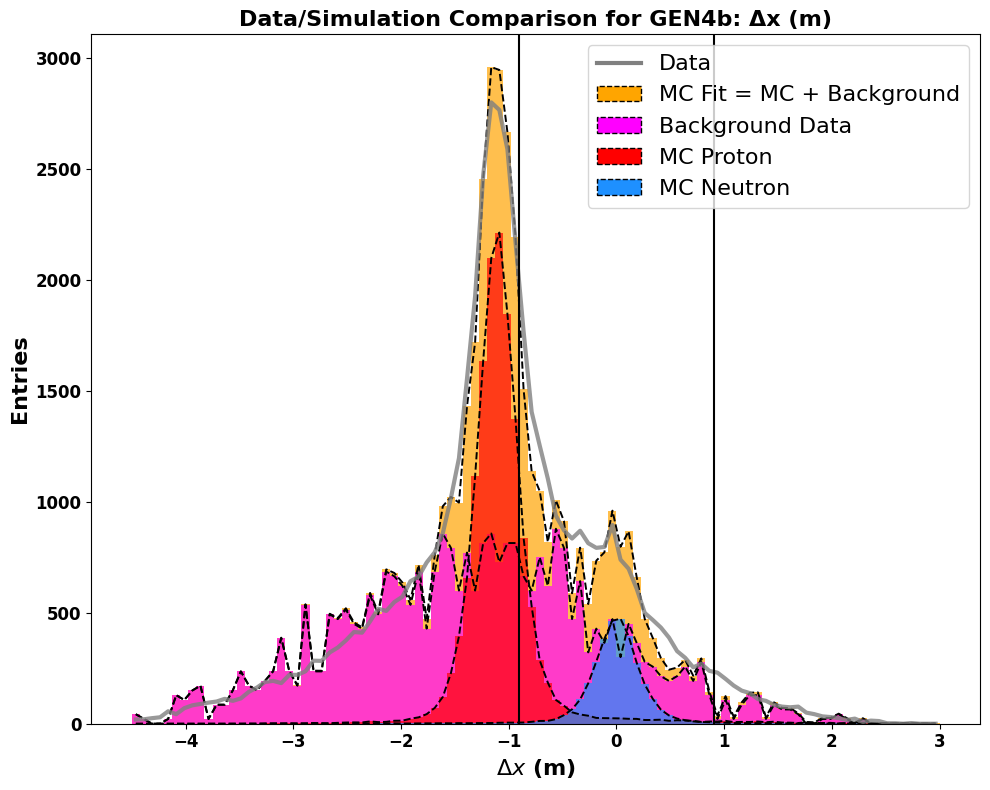

Total entries in fit: 47928.20324216906


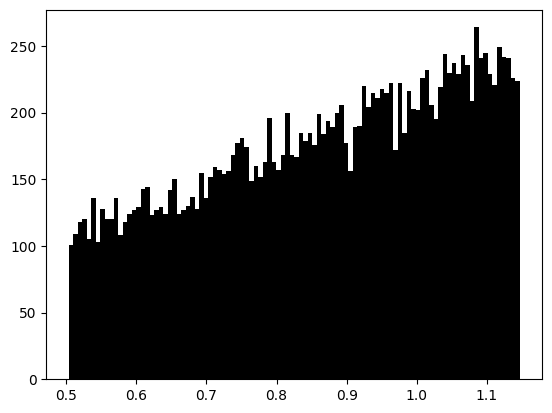

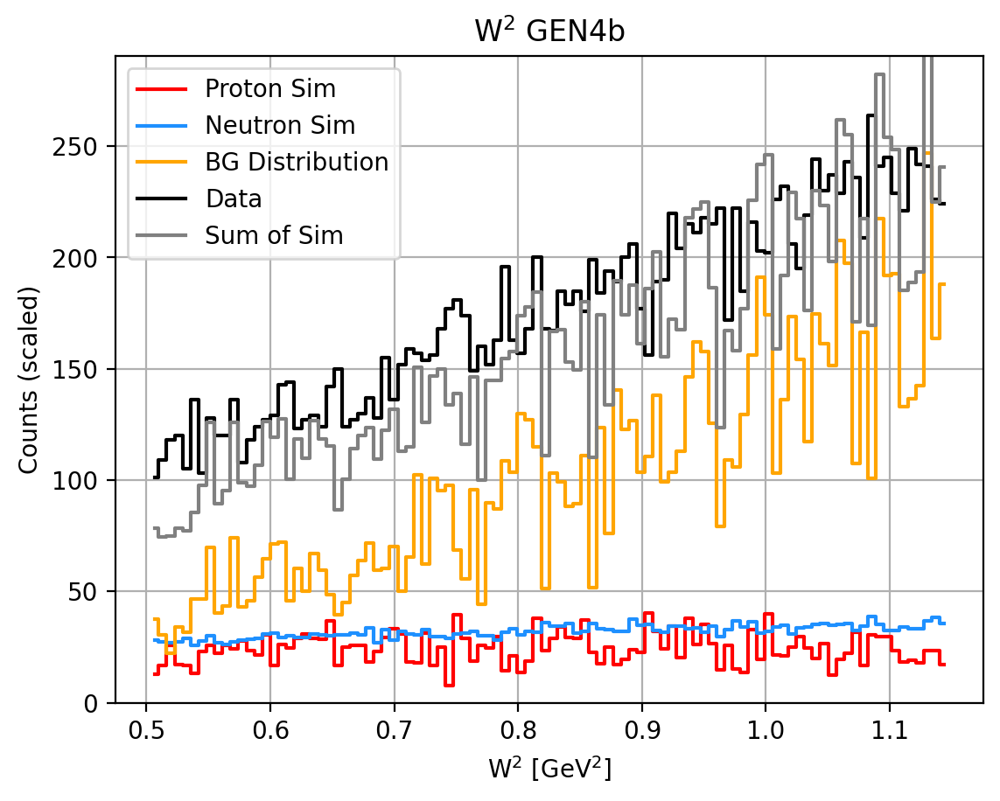

685108 684293
Total events in range (-0.903, 0.906):
  Sim Proton:   2421.95
  Sim Neutron:  3175.89
  Background:   10128.32
  Total:        17552.00
Fraction of events in range (-0.903, 0.906):
   Proton Fraction: 0.14
   Background Fraction: 0.58
   W2 Background Fraction: 0.32
   Neutron Fraction: 0.18
__________________________________________________
Target Weighted Avg: 0.378+-0.0219  5.7863%
Beam Weighted Avg: 0.808+-0.0010  0.1201%
__________________________________________________
epsilon = 0.5725
tau_avg = 2.7745
Q2 = 9.7972
Px: 0.9870 Pz: -0.0273
A = 0.03625 ± 0.01900 ± 0.00291
B = 0.41455 (no propagated error)
C = 0.15329 ± 0.09211 ± 0.01410
__________________________________________________
N_plus: 8824 N_minus: 8550
A_raw: 0.0158+=0.0076
A_raw_weighted: 0.0156+-0.0075  47.9495%
__________________________________________________
A_phys_weighted: 0.176
A_phys_stat_error: 0.0921  52.4277%
A_phys_sys_error: 0.0141  8.026%
GEn/GMn*muN: 0.73083+--0.45508+--0.06967
Relative Err

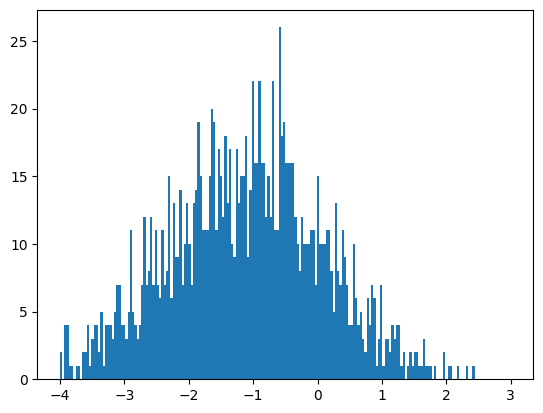

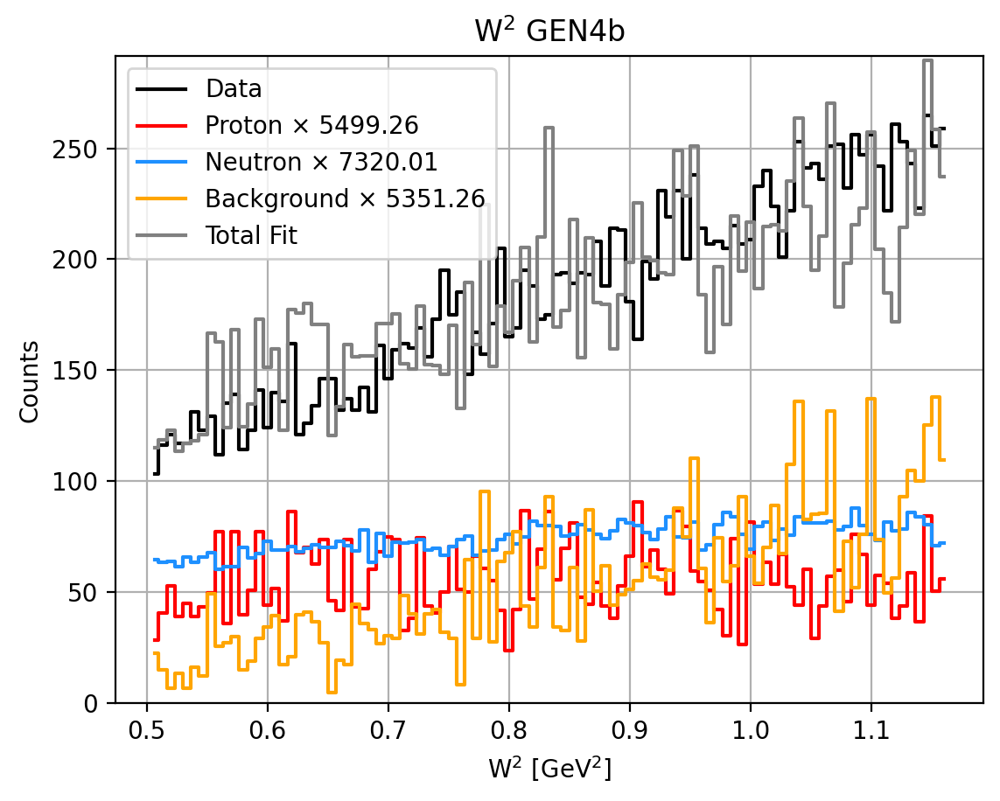

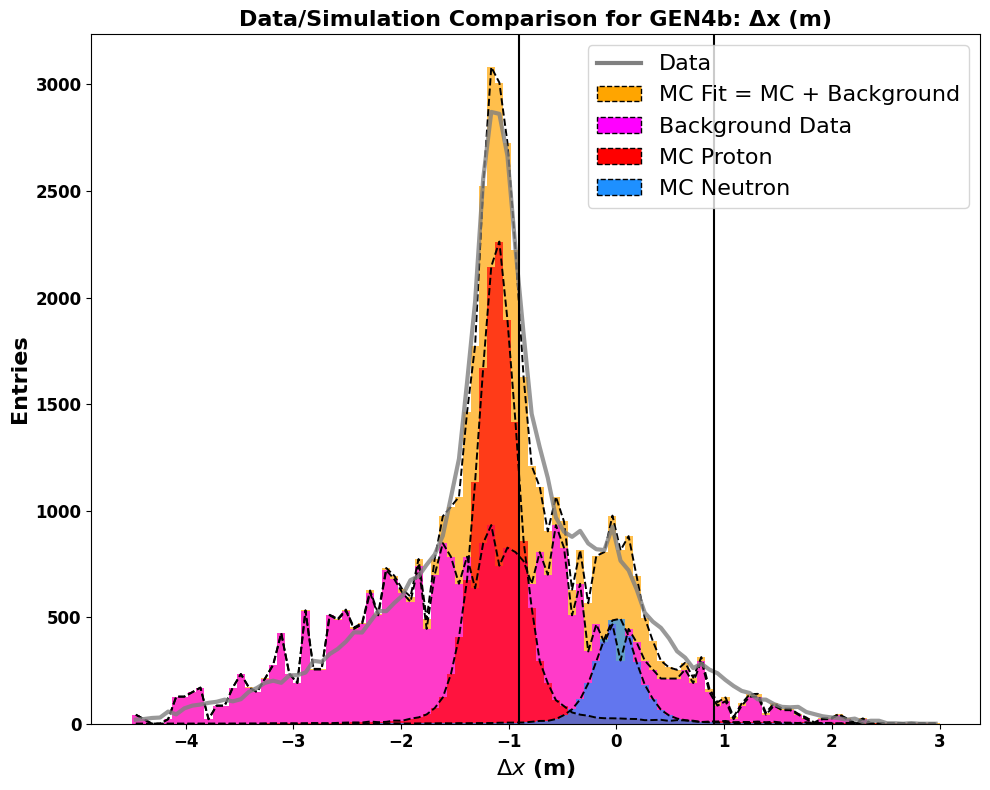

Total entries in fit: 49790.476113900884


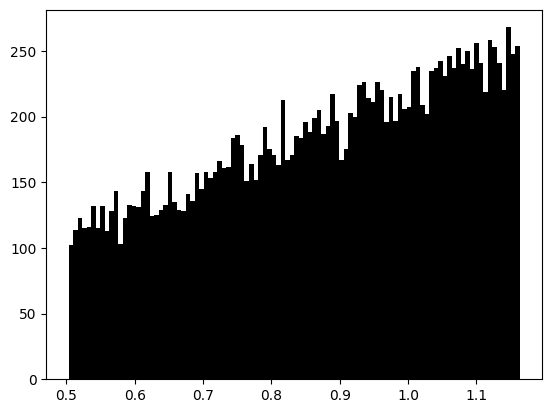

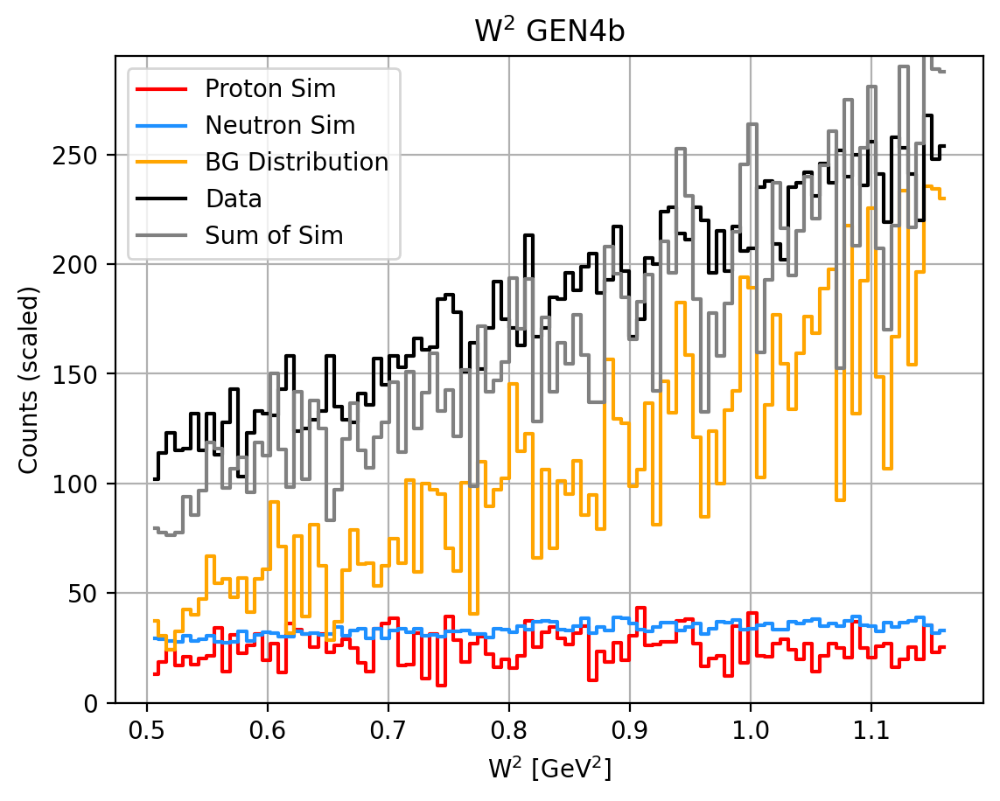

685108 684293
Total events in range (-0.903, 0.906):
  Sim Proton:   2490.54
  Sim Neutron:  3315.13
  Background:   10699.72
  Total:        18202.00
Fraction of events in range (-0.903, 0.906):
   Proton Fraction: 0.14
   Background Fraction: 0.59
   W2 Background Fraction: 0.29
   Neutron Fraction: 0.18
__________________________________________________
Target Weighted Avg: 0.378+-0.0219  5.7863%
Beam Weighted Avg: 0.808+-0.0010  0.1201%
__________________________________________________
epsilon = 0.5727
tau_avg = 2.7723
Q2 = 9.7894
Px: 0.9869 Pz: -0.0271
A = 0.02907 ± 0.01936 ± 0.00260
B = 0.41468 (no propagated error)
C = 0.11848 ± 0.09370 ± 0.01258
__________________________________________________
N_plus: 9130 N_minus: 8891
A_raw: 0.0133+=0.0074
A_raw_weighted: 0.0121+-0.0073  60.6519%
__________________________________________________
A_phys_weighted: 0.141
A_phys_stat_error: 0.0937  66.5953%
A_phys_sys_error: 0.0126  8.942%
GEn/GMn*muN: 0.55721+--0.45010+--0.06044
Relative Err

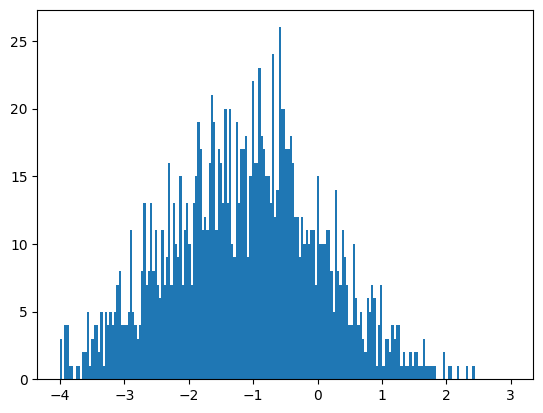

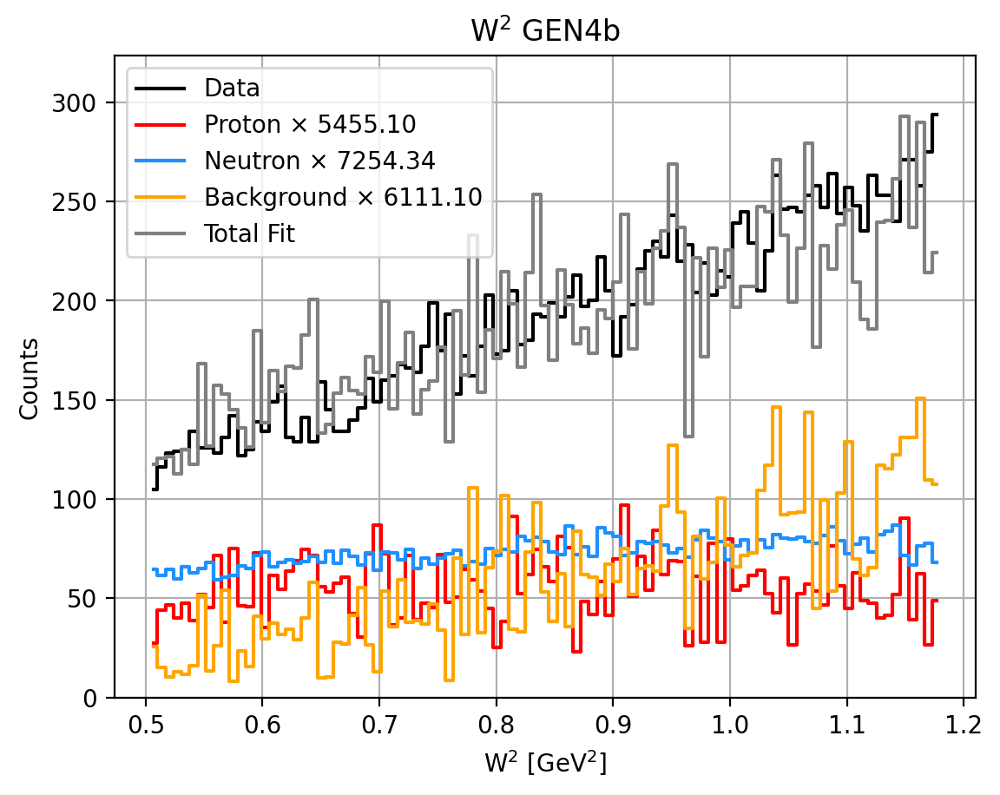

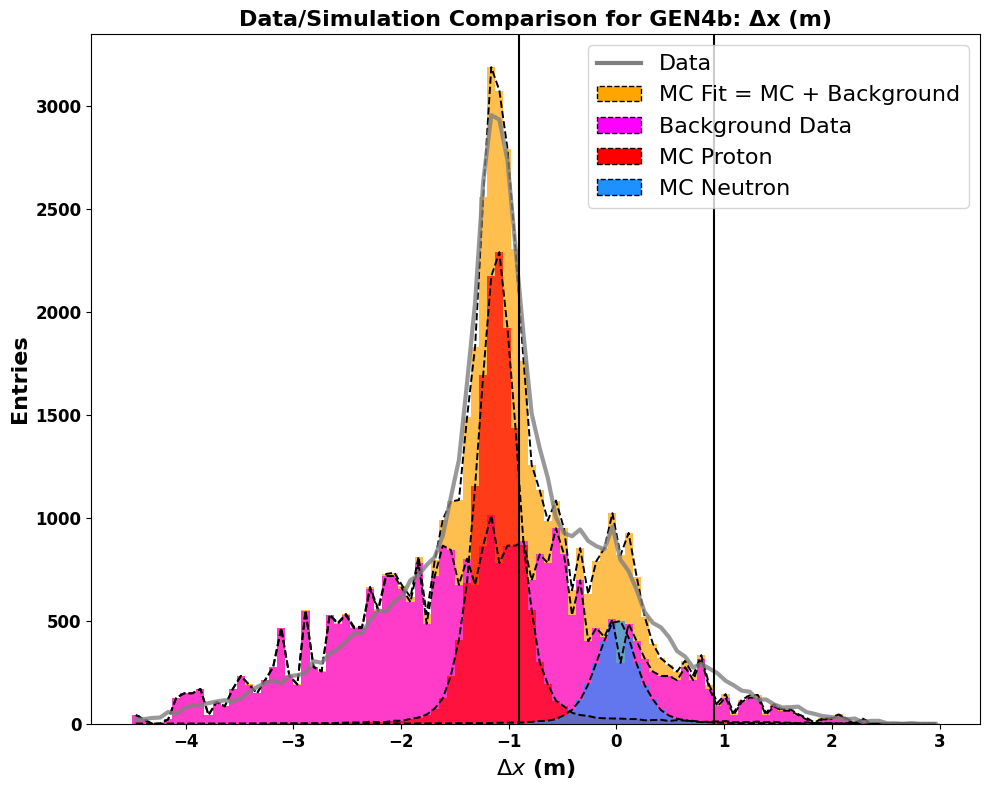

Total entries in fit: 51622.240660059295


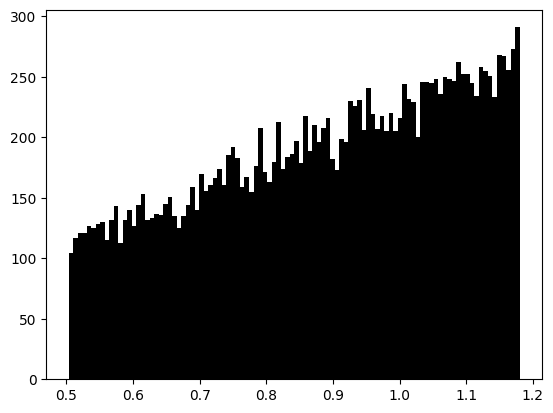

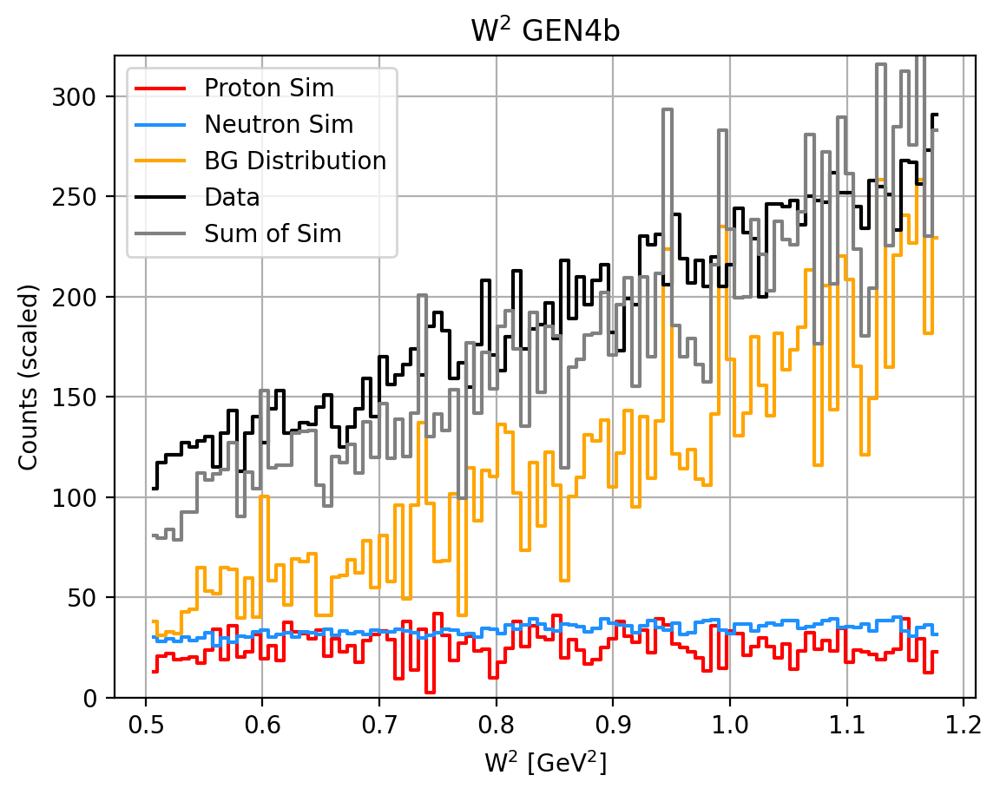

685108 684293
Total events in range (-0.903, 0.906):
  Sim Proton:   2525.10
  Sim Neutron:  3357.94
  Background:   11375.38
  Total:        18887.00
Fraction of events in range (-0.903, 0.906):
   Proton Fraction: 0.13
   Background Fraction: 0.60
   W2 Background Fraction: 0.32
   Neutron Fraction: 0.18
__________________________________________________
Target Weighted Avg: 0.378+-0.0219  5.7828%
Beam Weighted Avg: 0.808+-0.0010  0.1201%
__________________________________________________
epsilon = 0.5728
tau_avg = 2.7704
Q2 = 9.7828
Px: 0.9869 Pz: -0.0268
A = 0.03038 ± 0.01985 ± 0.00273
B = 0.41481 (no propagated error)
C = 0.12494 ± 0.09598 ± 0.01319
__________________________________________________
N_plus: 9465 N_minus: 9231
A_raw: 0.0125+=0.0073
A_raw_weighted: 0.0122+-0.0072  58.8483%
__________________________________________________
A_phys_weighted: 0.147
A_phys_stat_error: 0.0960  65.3283%
A_phys_sys_error: 0.0132  8.976%
GEn/GMn*muN: 0.58868+--0.46301+--0.06362
Relative Err

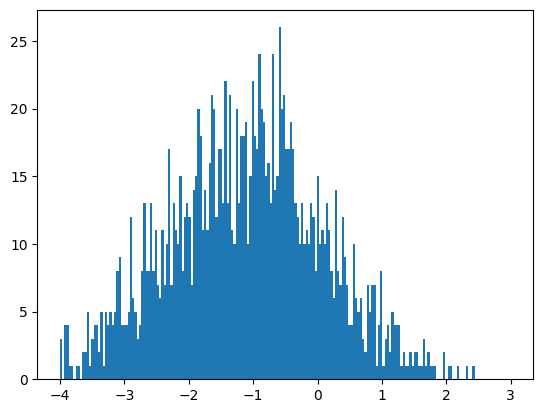

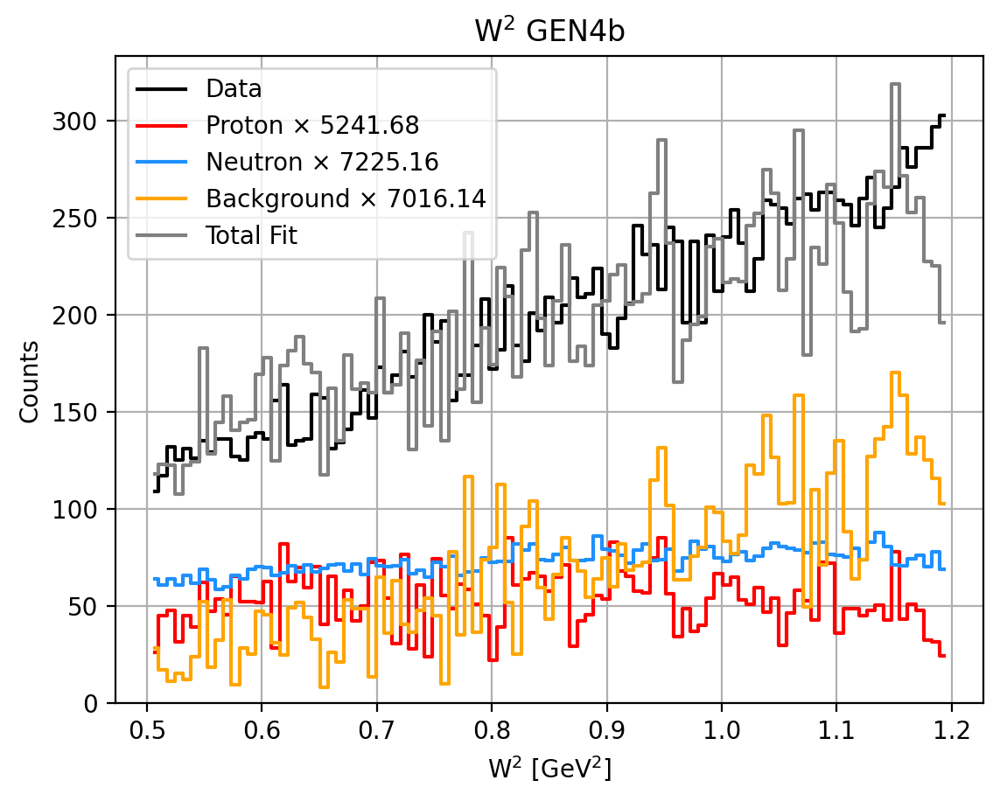

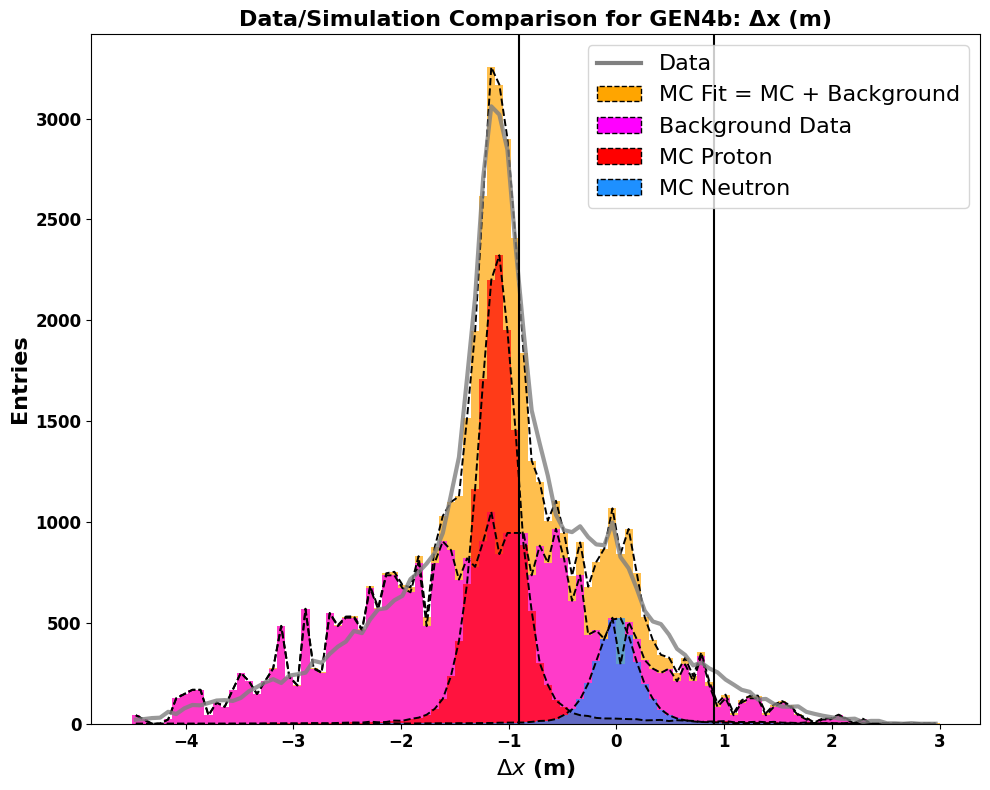

Total entries in fit: 53487.72804673308


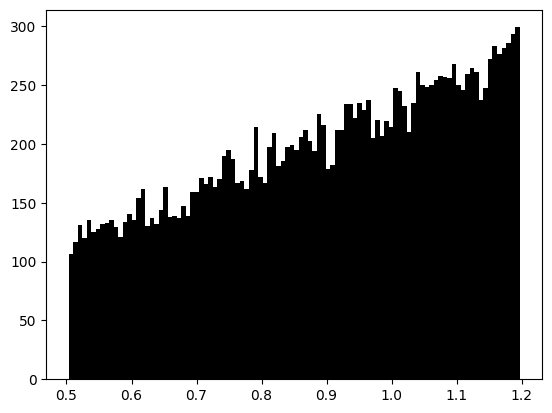

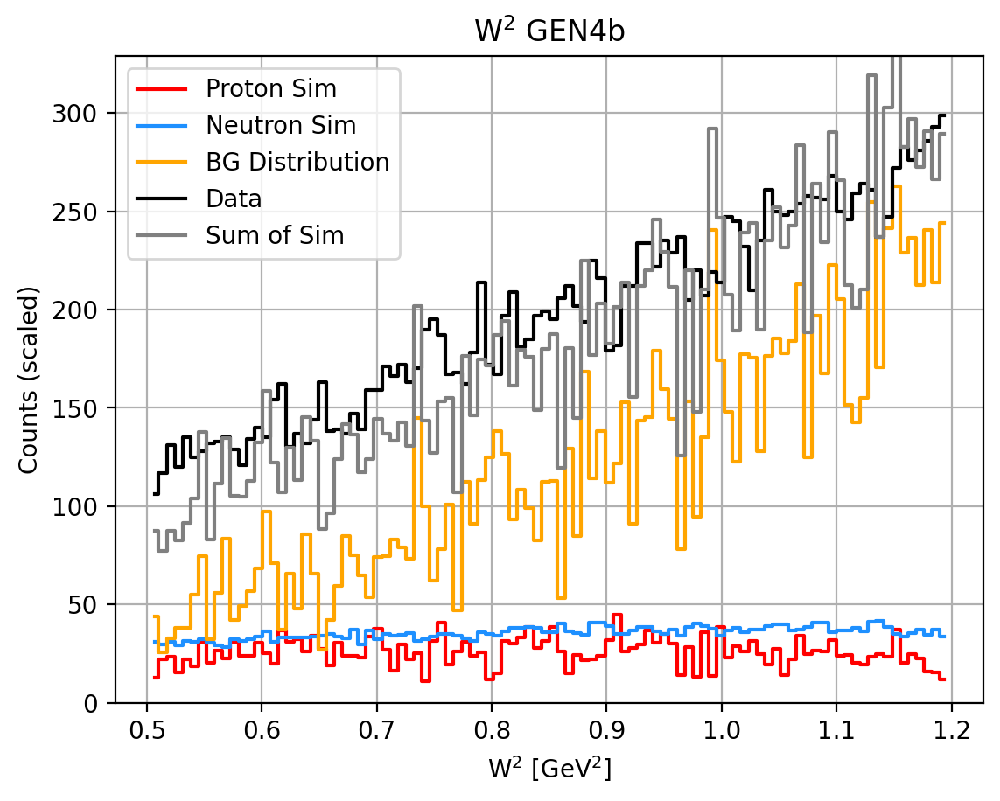

685108 684293
Total events in range (-0.903, 0.906):
  Sim Proton:   2555.70
  Sim Neutron:  3522.79
  Background:   11918.02
  Total:        19588.00
Fraction of events in range (-0.903, 0.906):
   Proton Fraction: 0.13
   Background Fraction: 0.61
   W2 Background Fraction: 0.36
   Neutron Fraction: 0.18
__________________________________________________
Target Weighted Avg: 0.378+-0.0218  5.7724%
Beam Weighted Avg: 0.808+-0.0010  0.1201%
__________________________________________________
epsilon = 0.5731
tau_avg = 2.7681
Q2 = 9.7745
Px: 0.9870 Pz: -0.0266
A = 0.02742 ± 0.01975 ± 0.00260
B = 0.41495 (no propagated error)
C = 0.11065 ± 0.09540 ± 0.01255
__________________________________________________
N_plus: 9807 N_minus: 9582
A_raw: 0.0116+=0.0072
A_raw_weighted: 0.0113+-0.0071  62.7006%
__________________________________________________
A_phys_weighted: 0.132
A_phys_stat_error: 0.0954  72.0281%
A_phys_sys_error: 0.0125  9.473%
GEn/GMn*muN: 0.51869+--0.45560+--0.05992
Relative Err

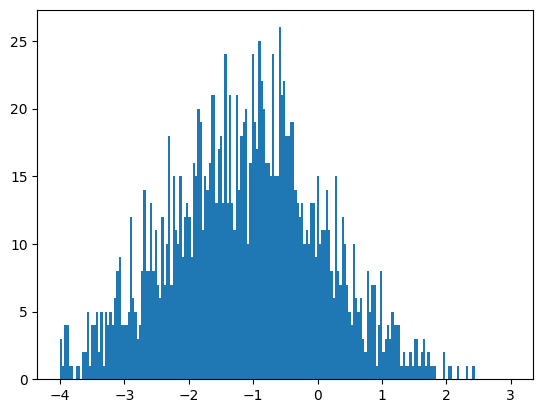

In [479]:
gen=[]
gensys=[]
genstat=[]
araw=[]
arawerror=[]
aphysstaterror=[]
aphyssyserror=[]
cutindex=[]



stepsize=20
print("Starting W2")
for i in range(0,stepsize):
    #print(i)
    try: _,_,stats1,_=DoItAll(.87-11/wscale*2,.88+i/wscale,coinmin,coinmax-2,dymin-.5,dymax+.5,dxmin-.5,dxmax+.5,hcalmin,False,False)
    except:
        continue
    cutindex.append(i)
    A=stats1['GE/GM * muN']
    B=stats1['GE/GM_stat_error']
    C=stats1['GE/GM_sys_error']
    D=stats1['A_raw']
    E=stats1['A_raw_rel_error']
    F=stats1["A_phys_rel_sys_error"]
    G=stats1["A_phys_rel_sat_error"]
    gen.append(A)
    gensys.append(C)
    genstat.append(B)
    araw.append(D)
    arawerror.append(E)
    aphysstaterror.append(G)
    aphyssyserror.append(F)


In [355]:
rel_contribs

{'f_acc': 0.0001636991342888024,
 'f_p': 0.34568292282734947,
 'f_inelastic': 8.78152372422768,
 'f_N2': 0.012388708442745722,
 'A_acc': 3.023354384782606,
 'A_p': 0.00013169038249193082,
 'A_inelastic': 1.802351172237072,
 'P': 86.03440369796577}

In [402]:
GEGM=statdict['GE/GM * muN']
GEGMstat=statdict['GE/GM_stat_error']
GEGMsys=statdict['GE/GM_sys_error']

In [403]:
GEGME=np.sqrt(GEGMstat**2+GEGMsys**2)

In [404]:
GEN2Data = {
    'Q2': [Q2_avg],
    'ExpName': ['GEn-II'],
    'R': [GEGM ],
    'R_err': [GEGME],
    'GEn': [0],   # assuming GEn and GEn_err are present in the file
    'GEn_err': [0]
}

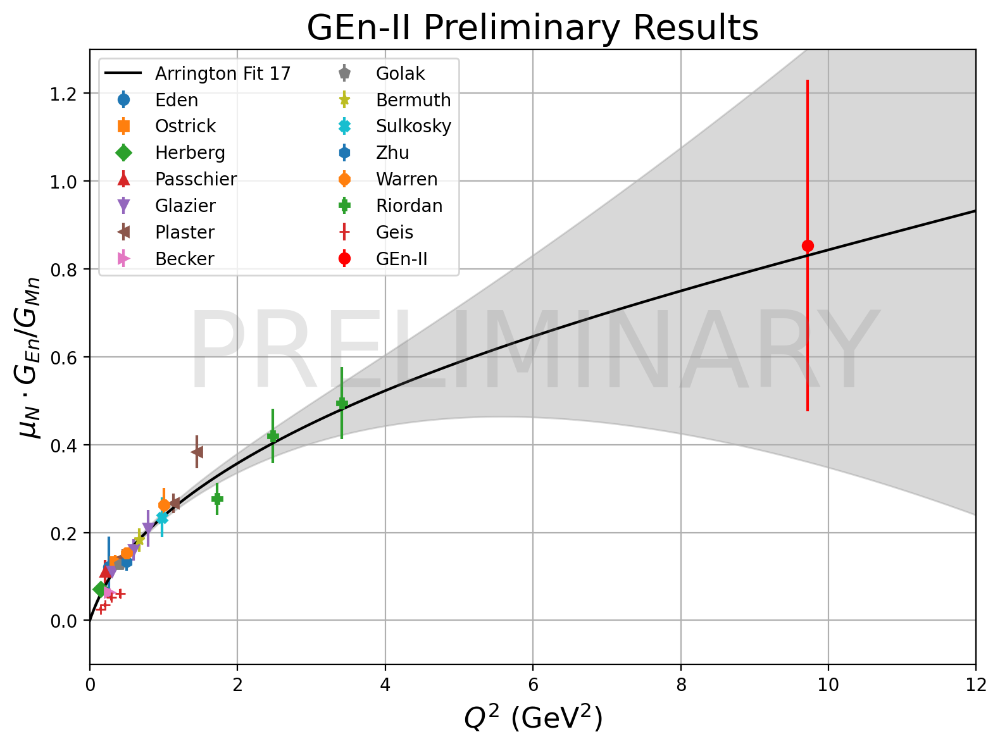

In [405]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from GETFF import Function_GETFF  # Assuming you have this imported somewhere

# Load theory Q2 and GEn/GD ratio
GEntheory = np.transpose(np.loadtxt('../DB/neutron_lookup.dat'))
Q2t = np.sort(GEntheory[0])

# Calculate GE/GM and uncertainties using GETFF
GEGD, GEGDE, GMGD, GMGDE = [], [], [], []
for q2 in Q2t:
    GEGD.append(Function_GETFF(3, q2)[0])
    GEGDE.append(Function_GETFF(3, q2)[1])
    GMGD.append(Function_GETFF(4, q2)[0])
    GMGDE.append(Function_GETFF(4, q2)[1])

GEGD = np.array(GEGD)
GEGDE = np.array(GEGDE)
GMGD = np.array(GMGD)
GMGDE = np.array(GMGDE)

# Error propagation: GE/GM with uncertainty
def eprop(GE, GEE, GM, GMM):
    R = GE / GM
    fractional_error = np.sqrt((GEE / GE)**2 + (GMM / GM)**2)
    return R, R * fractional_error

RatFit, RatFitE = eprop(GEGD, GEGDE, GMGD, GMGDE)

# Load world data
df = pd.read_csv("../DB/GEn_World_Data.csv")
mu_n = 1.91

# Setup plot
fig, ax = plt.subplots(figsize=(8, 6), dpi=200)
marker_styles = ['o', 's', 'D', '^', 'v', '<', '>', 'p', '*', 'X', 'h', '8', 'P', '+', 'x', '|', '_']
experiments = df["Experiment"].unique()
markers = {exp: marker_styles[i % len(marker_styles)] for i, exp in enumerate(experiments)}

# Plot world data
for exp in experiments:
    subset = df[df["Experiment"] == exp]
    ax.errorbar(subset["Q2"], mu_n * subset["GEn"] / subset["GMn"],
                subset["RatE"], fmt=markers[exp], label=exp)
plt.errorbar(GEN2Data['Q2'],GEN2Data['R'],GEN2Data['R_err'],fmt='o',color='red',label='GEn-II')

# Plot fit and shaded error band
ax.plot(Q2t, RatFit, color='black', label='Arrington Fit 17')
ax.fill_between(Q2t, RatFit - RatFitE, RatFit + RatFitE, color='gray', alpha=0.3)

# Watermark and labels
ax.text(0.5, 0.5, 'PRELIMINARY', fontsize=60, color='gray',
        ha='center', va='center', alpha=0.2, transform=ax.transAxes)

ax.set_xlim(0, 12)
ax.set_ylim(-0.1, 1.3)
ax.grid(True)
ax.set_xlabel('$Q^2$ (GeV$^2$)', fontsize=16)
ax.set_ylabel(r'$\mu_N \cdot G_{En} / G_{Mn}$', fontsize=16)
ax.set_title('GEn-II Preliminary Results', fontsize=20)
ax.legend(loc='upper left', fontsize=10, ncol=2)
#plt.yscale("log")
plt.tight_layout()
plt.savefig("PrelimResults.pdf")
plt.show()


In [31]:
with open("kin4bresultsMETHOD5.txt",'w') as f:
    for i,key in enumerate(statdict):
        if i<4:
            f.write(key+","+f"{statdict[key]:.0f}\n")
        else:
            f.write(key+","+f"{statdict[key]:.4f}\n")

In [335]:
#experimental

-1.0000
1.0000
-0.2500
0.2500
-0.5000
0.5000
181.0000
188.0000
0.3250


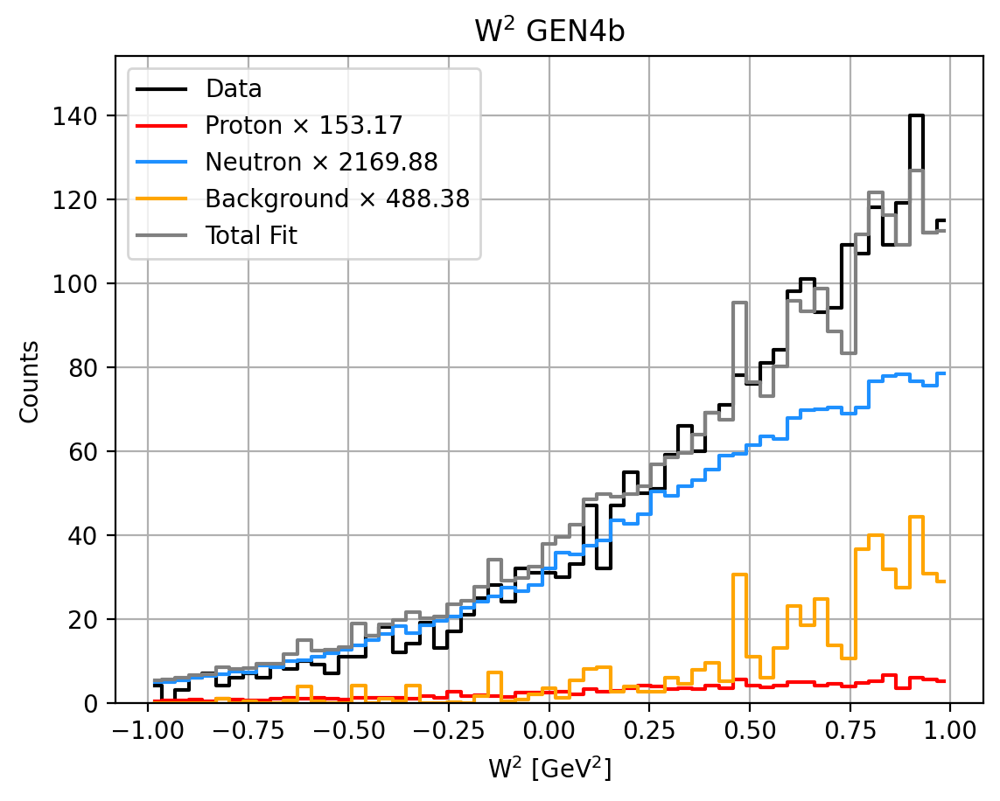

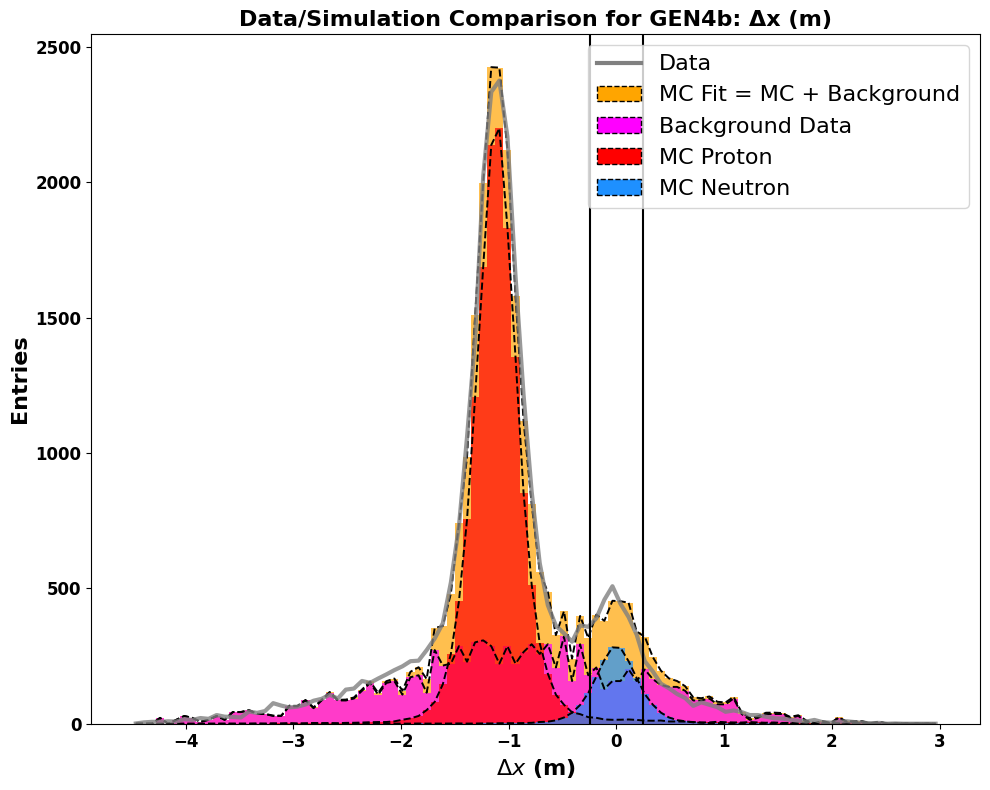

Total entries in fit: 26858.942773182247


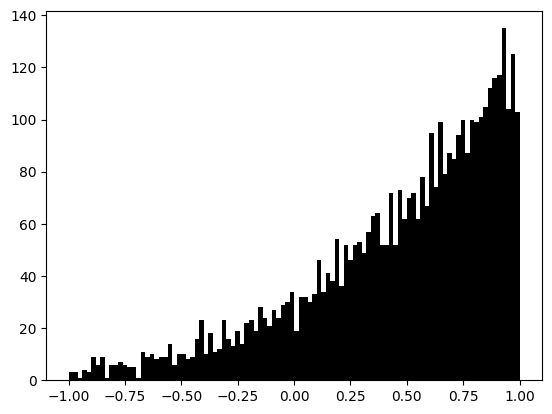

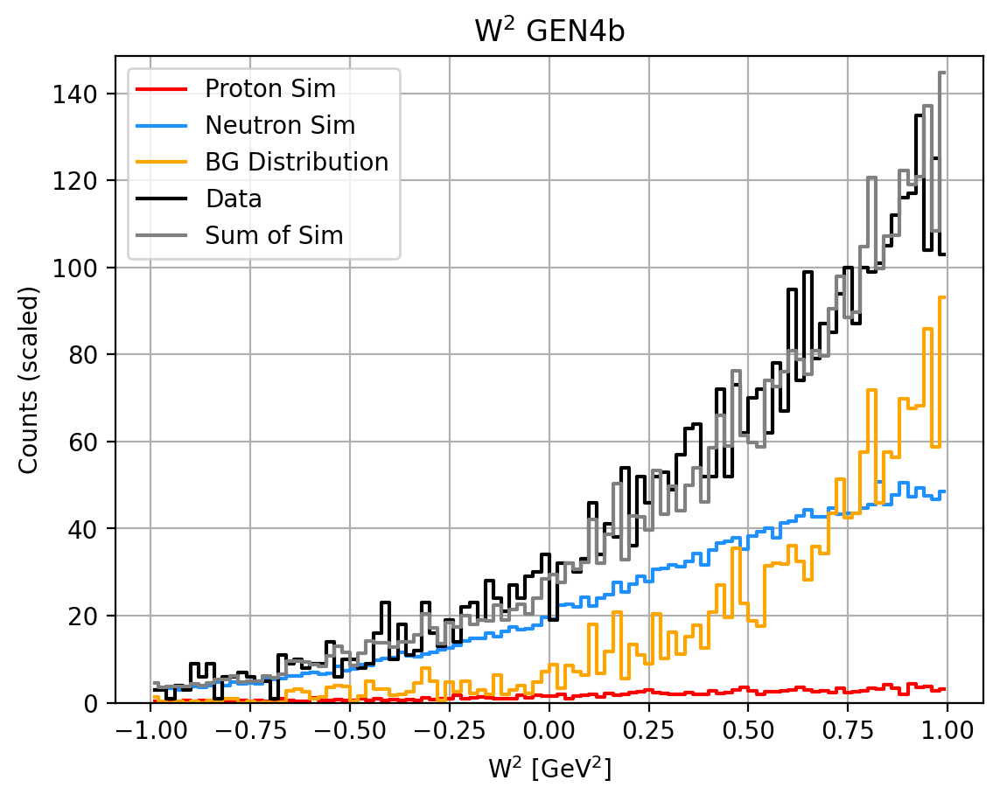

196398 196752
Total events in range (-0.25, 0.25):
  Sim Proton:   96.79
  Sim Neutron:  1371.20
  Background:   1009.78
  Total:        2521.00
Fraction of events in range (-0.25, 0.25):
   Proton Fraction: 0.04
   Background Fraction: 0.40
   W2 Background Fraction: 0.17
   Neutron Fraction: 0.54
__________________________________________________
Target Weighted Avg: 0.38+-0.0212  5.5940%
Beam Weighted Avg: 0.808+-0.0010  0.1201%
__________________________________________________
epsilon = 0.5637
tau_avg = 2.8583
Q2 = 10.0931
Px: 0.9899 Pz: -0.0365
A = 0.04710 ± 0.02323 ± 0.00307
B = 0.41065 (no propagated error)
C = 0.20866 ± 0.11780 ± 0.01558
__________________________________________________
N_plus: 1370 N_minus: 1285
A_raw: 0.0320+=0.0194
A_raw_weighted: 0.0372+-0.0188  50.7004%
__________________________________________________
A_phys_weighted: 0.239
A_phys_stat_error: 0.1178  49.3233%
A_phys_sys_error: 0.0156  6.525%
GEn/GMn*muN: 1.03497+--0.62678+--0.08291
Relative Error: 61.0

/tmp/ipykernel_15907/1429301314.py:147: RuntimeWarning: invalid value encountered in divide
  A_raw_per_run = (N_plus_per_run - N_minus_per_run) / (N_plus_per_run + N_minus_per_run)
/tmp/ipykernel_15907/1429301314.py:148: RuntimeWarning: invalid value encountered in divide
  A_raw_error_per_run = 2 * np.sqrt(N_plus_per_run * N_minus_per_run) / (N_plus_per_run + N_minus_per_run)**1.5


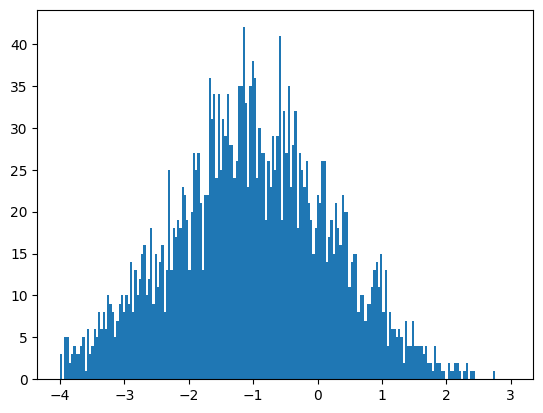

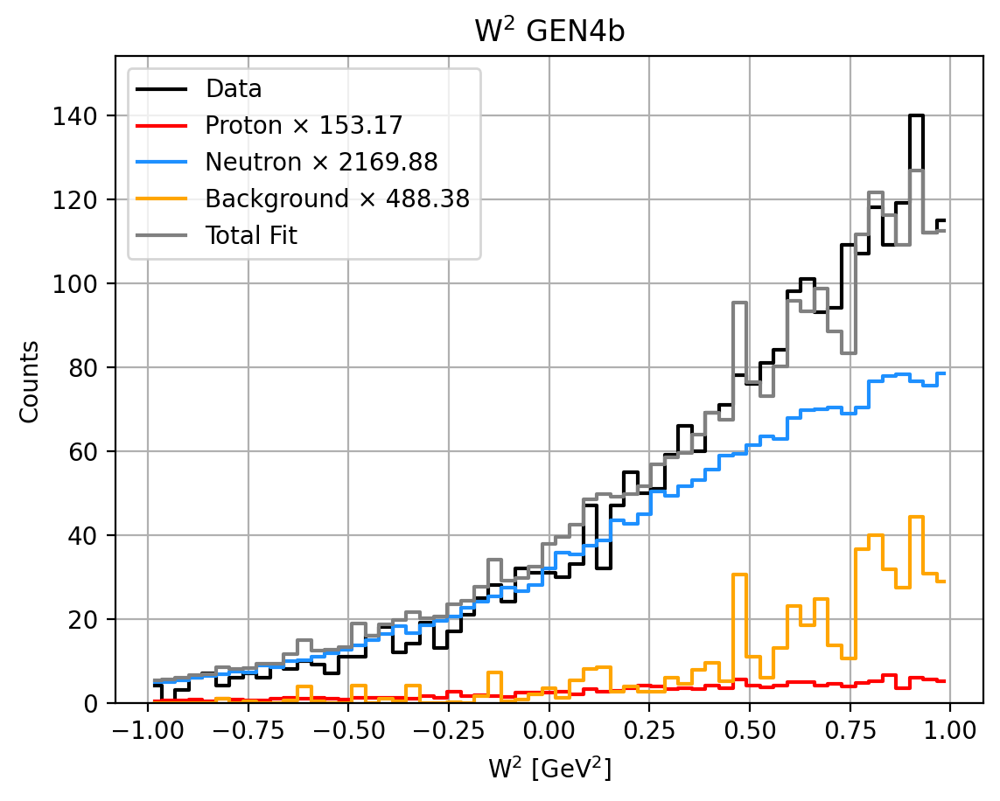

0.826287733591448 0.058326596783072795 0.7679611368083752 0.17371226640855197


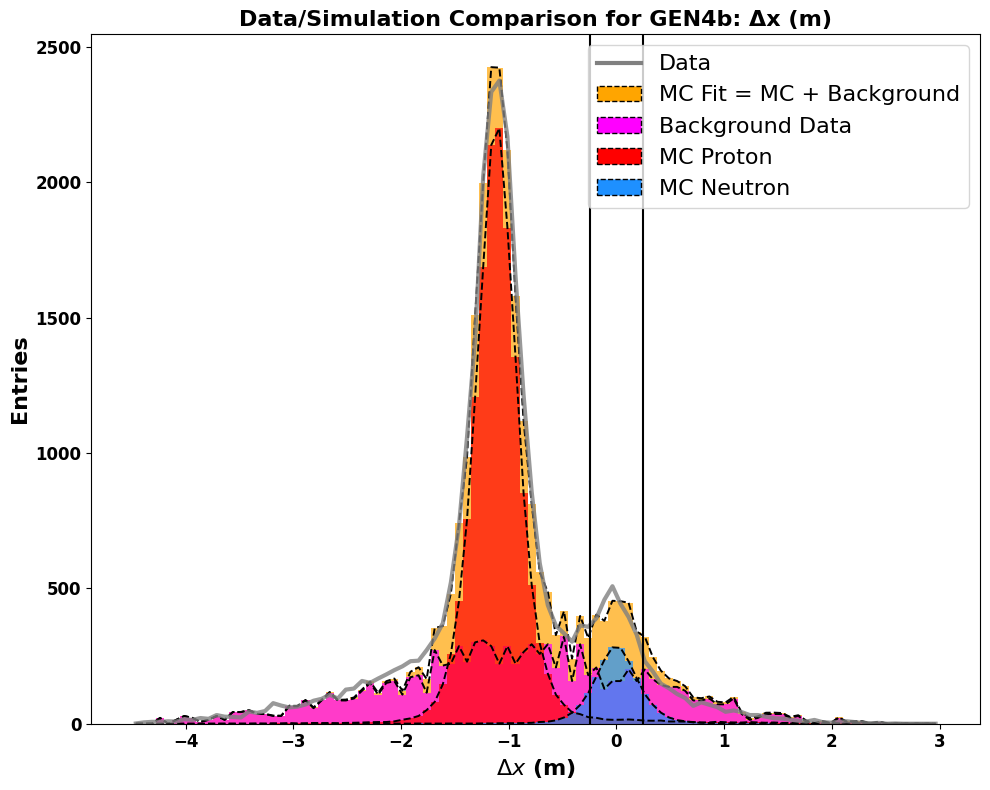

Total entries in fit: 26858.942773182247


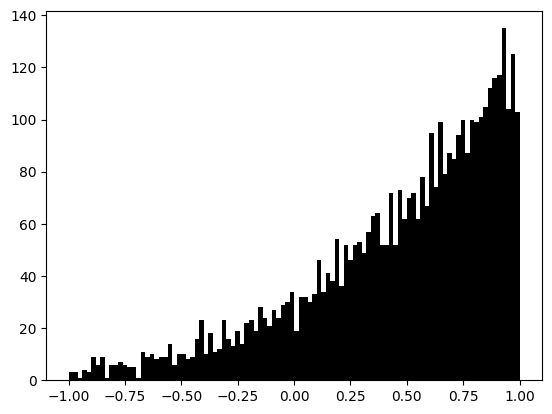

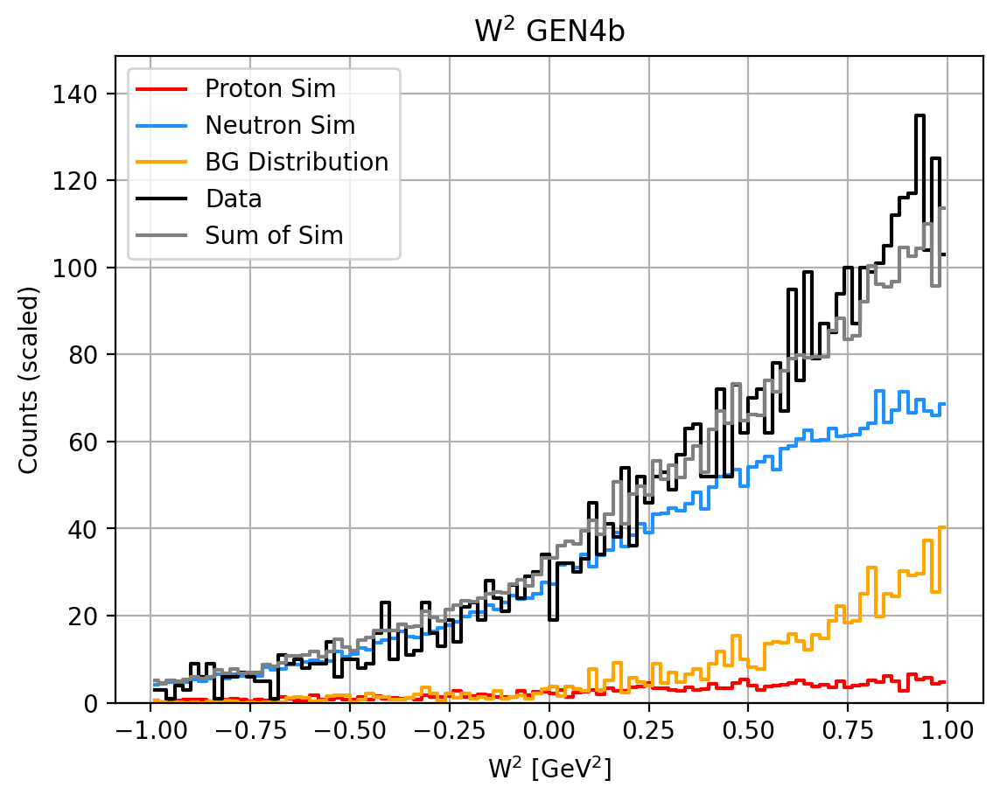

196398 196752
Total events in range (-0.25, 0.25):
  Sim Proton:   96.79
  Sim Neutron:  1371.20
  Background:   1009.78
  Total:        2521.00
Fraction of events in range (-0.25, 0.25):
   Proton Fraction: 0.06
   Background Fraction: 0.17
   W2 Background Fraction: 0.17
   Neutron Fraction: 0.77
__________________________________________________
Target Weighted Avg: 0.38+-0.0212  5.5940%
Beam Weighted Avg: 0.808+-0.0010  0.1201%
__________________________________________________
epsilon = 0.5637
tau_avg = 2.8583
Q2 = 10.0931
Px: 0.9899 Pz: -0.0365
A = 0.03423 ± 0.01697 ± 0.00208
B = 0.41065 (no propagated error)
C = 0.14341 ± 0.08606 ± 0.01056
__________________________________________________
N_plus: 1370 N_minus: 1285
A_raw: 0.0320+=0.0194
A_raw_weighted: 0.0372+-0.0188  50.7004%
__________________________________________________
A_phys_weighted: 0.174
A_phys_stat_error: 0.0861  49.5804%
A_phys_sys_error: 0.0106  6.084%
GEn/GMn*muN: 0.68777+--0.42604+--0.05228
Relative Error: 62.4

/tmp/ipykernel_15907/1429301314.py:147: RuntimeWarning: invalid value encountered in divide
  A_raw_per_run = (N_plus_per_run - N_minus_per_run) / (N_plus_per_run + N_minus_per_run)
/tmp/ipykernel_15907/1429301314.py:148: RuntimeWarning: invalid value encountered in divide
  A_raw_error_per_run = 2 * np.sqrt(N_plus_per_run * N_minus_per_run) / (N_plus_per_run + N_minus_per_run)**1.5


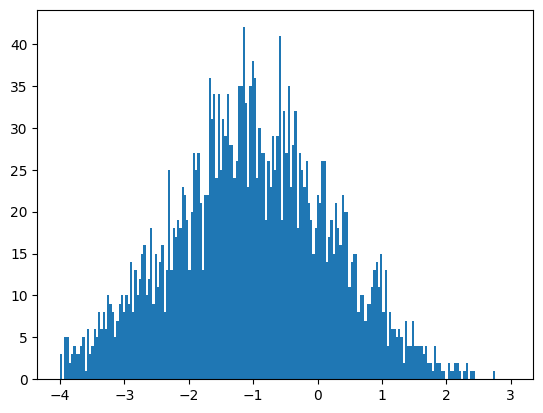

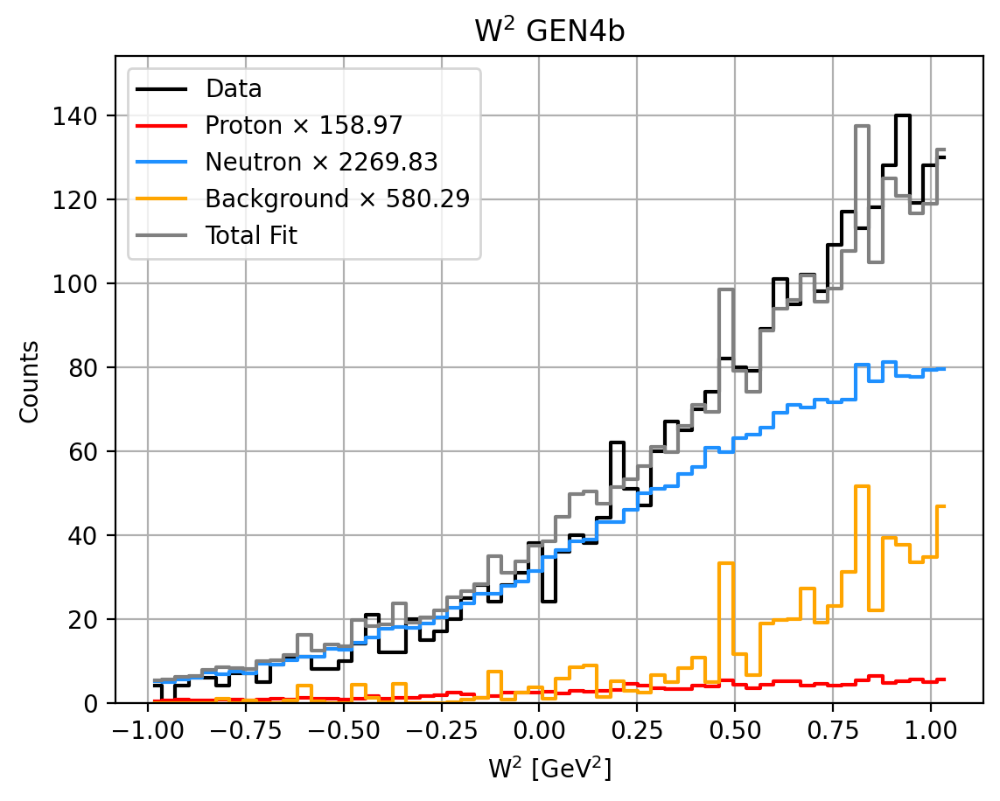

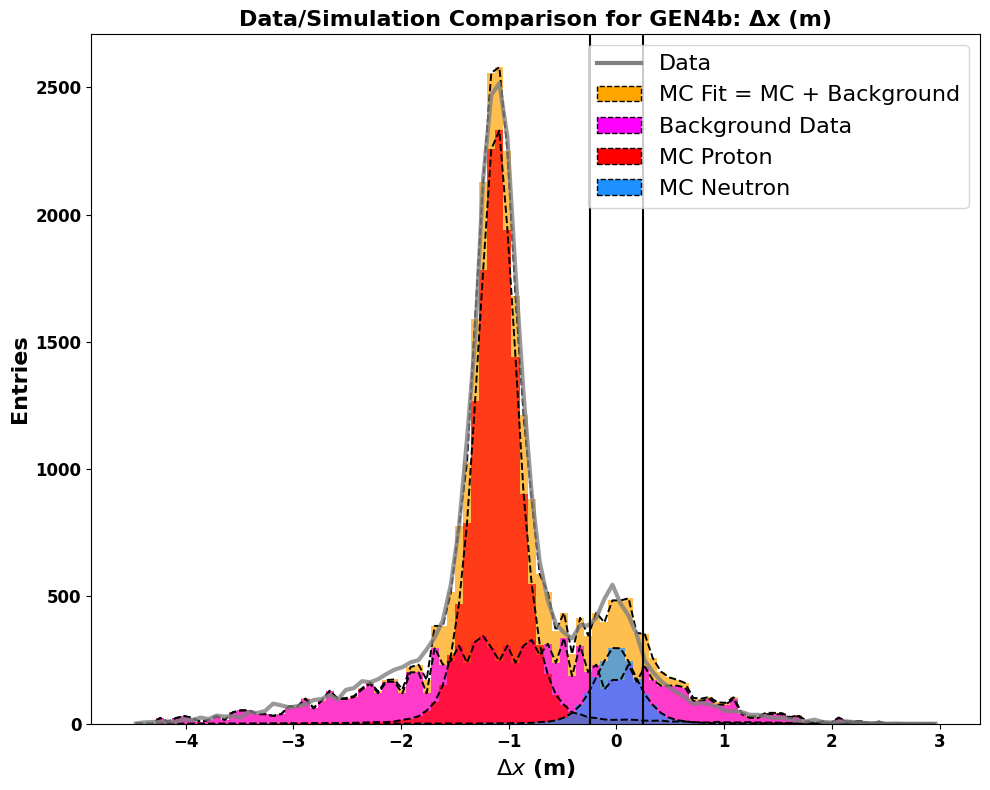

Total entries in fit: 28685.635762157726


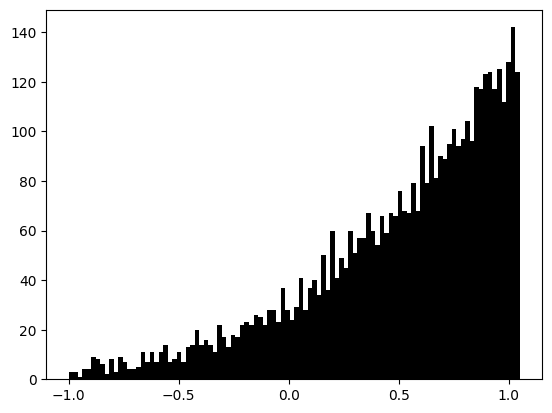

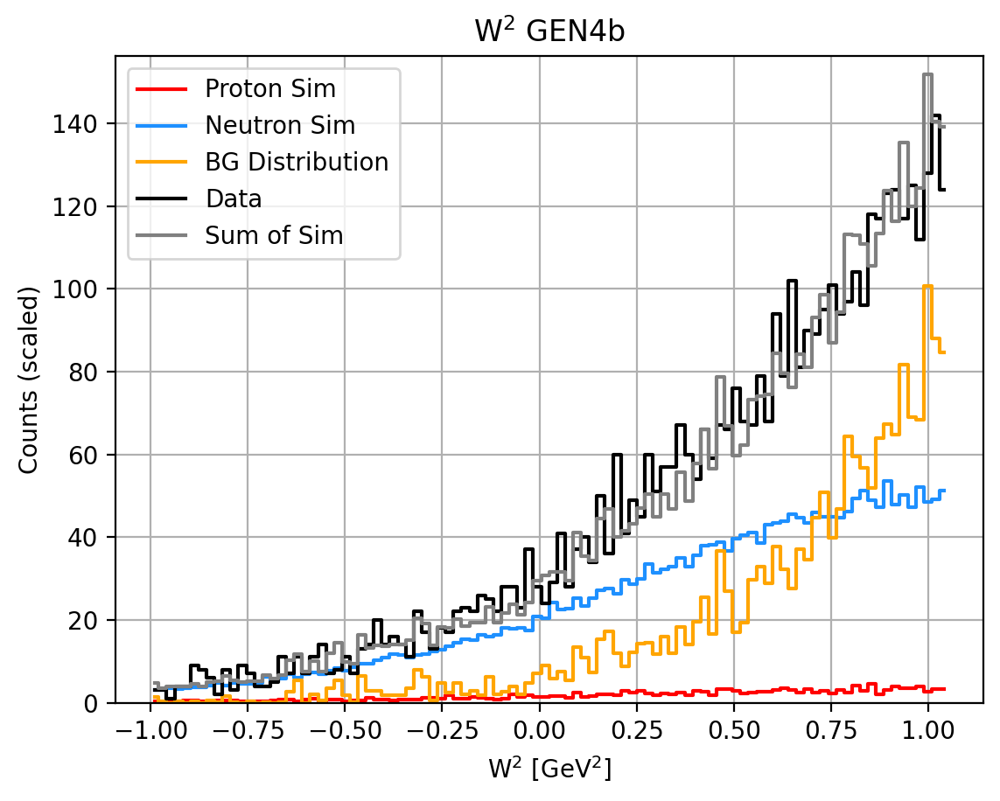

196398 196752
Total events in range (-0.25, 0.25):
  Sim Proton:   101.12
  Sim Neutron:  1443.78
  Background:   1106.99
  Total:        2698.00
Fraction of events in range (-0.25, 0.25):
   Proton Fraction: 0.04
   Background Fraction: 0.41
   W2 Background Fraction: 0.19
   Neutron Fraction: 0.54
__________________________________________________
Target Weighted Avg: 0.379+-0.0212  5.5892%
Beam Weighted Avg: 0.808+-0.0010  0.1201%
__________________________________________________
epsilon = 0.5645
tau_avg = 2.8505
Q2 = 10.0653
Px: 0.9899 Pz: -0.0357
A = 0.05391 ± 0.02283 ± 0.00349
B = 0.41114 (no propagated error)
C = 0.24276 ± 0.11528 ± 0.01761
__________________________________________________
N_plus: 1477 N_minus: 1375
A_raw: 0.0358+=0.0187
A_raw_weighted: 0.0414+-0.0181  43.7978%
__________________________________________________
A_phys_weighted: 0.272
A_phys_stat_error: 0.1153  42.3495%
A_phys_sys_error: 0.0176  6.469%
GEn/GMn*muN: 1.23212+--0.64686+--0.09881
Relative Error: 53

/tmp/ipykernel_15907/1429301314.py:147: RuntimeWarning: invalid value encountered in divide
  A_raw_per_run = (N_plus_per_run - N_minus_per_run) / (N_plus_per_run + N_minus_per_run)
/tmp/ipykernel_15907/1429301314.py:148: RuntimeWarning: invalid value encountered in divide
  A_raw_error_per_run = 2 * np.sqrt(N_plus_per_run * N_minus_per_run) / (N_plus_per_run + N_minus_per_run)**1.5


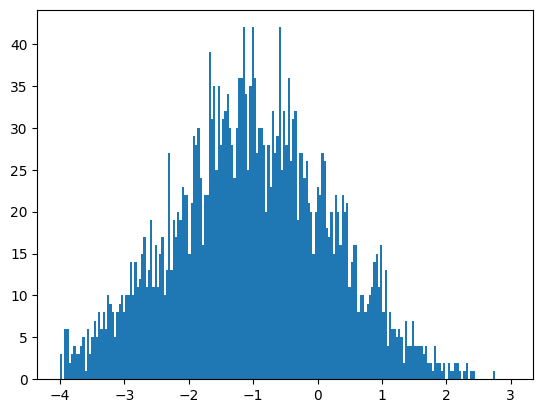

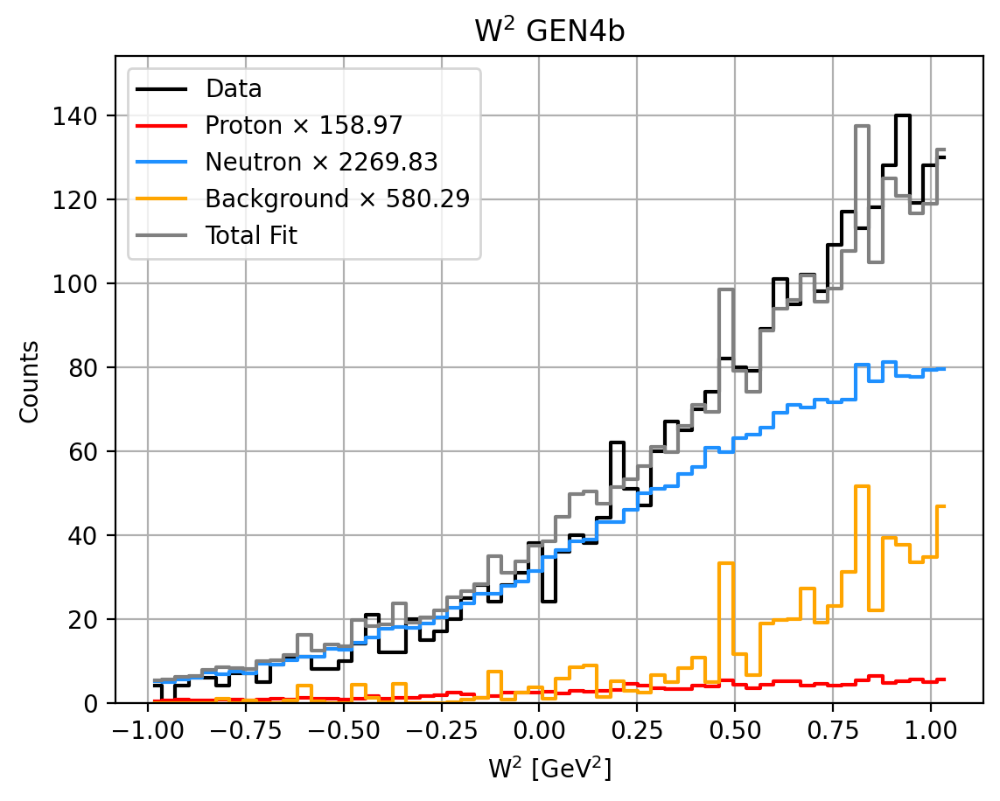

0.8071547800293962 0.056531327895882985 0.7506234521335132 0.1928452199706039


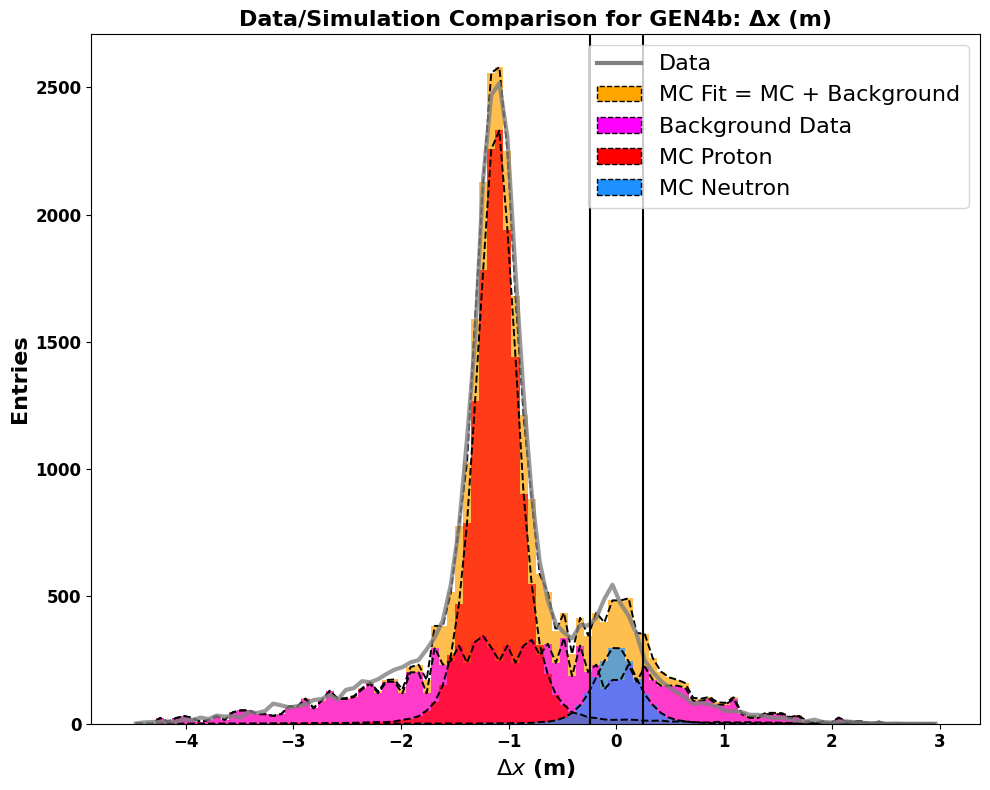

Total entries in fit: 28685.635762157726


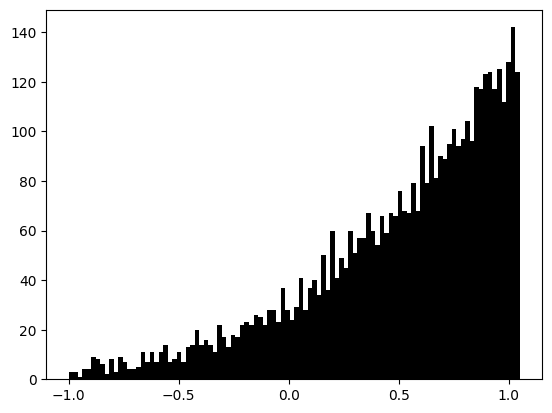

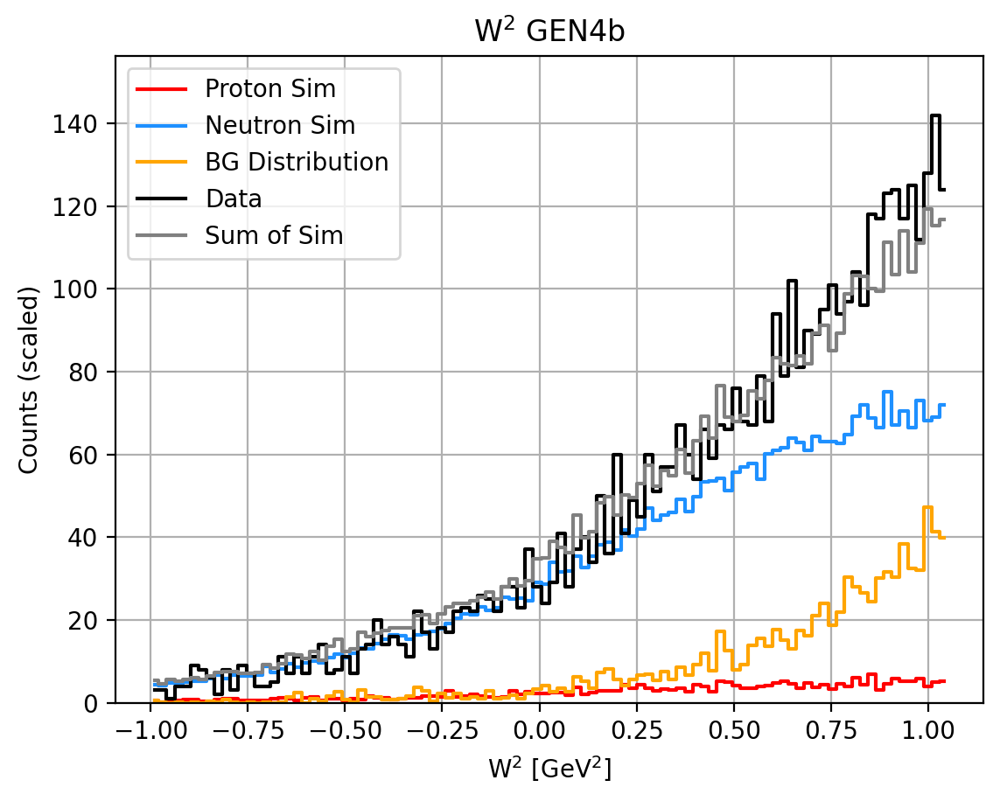

196398 196752
Total events in range (-0.25, 0.25):
  Sim Proton:   101.12
  Sim Neutron:  1443.78
  Background:   1106.99
  Total:        2698.00
Fraction of events in range (-0.25, 0.25):
   Proton Fraction: 0.06
   Background Fraction: 0.19
   W2 Background Fraction: 0.19
   Neutron Fraction: 0.75
__________________________________________________
Target Weighted Avg: 0.379+-0.0212  5.5892%
Beam Weighted Avg: 0.808+-0.0010  0.1201%
__________________________________________________
epsilon = 0.5645
tau_avg = 2.8505
Q2 = 10.0653
Px: 0.9899 Pz: -0.0357
A = 0.03948 ± 0.01679 ± 0.00239
B = 0.41114 (no propagated error)
C = 0.16992 ± 0.08481 ± 0.01209
__________________________________________________
N_plus: 1477 N_minus: 1375
A_raw: 0.0358+=0.0187
A_raw_weighted: 0.0414+-0.0181  43.7978%
__________________________________________________
A_phys_weighted: 0.199
A_phys_stat_error: 0.0848  42.5382%
A_phys_sys_error: 0.0121  6.064%
GEn/GMn*muN: 0.82358+--0.42993+--0.06129
Relative Error: 52

/tmp/ipykernel_15907/1429301314.py:147: RuntimeWarning: invalid value encountered in divide
  A_raw_per_run = (N_plus_per_run - N_minus_per_run) / (N_plus_per_run + N_minus_per_run)
/tmp/ipykernel_15907/1429301314.py:148: RuntimeWarning: invalid value encountered in divide
  A_raw_error_per_run = 2 * np.sqrt(N_plus_per_run * N_minus_per_run) / (N_plus_per_run + N_minus_per_run)**1.5


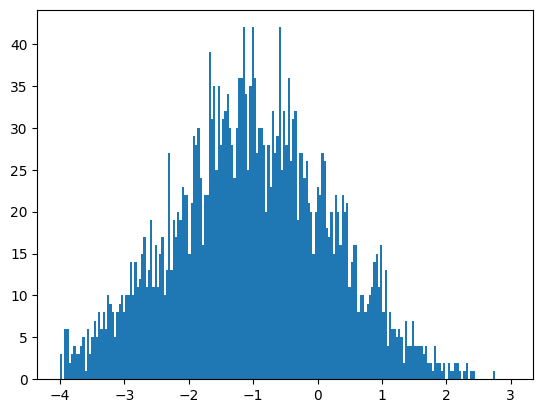

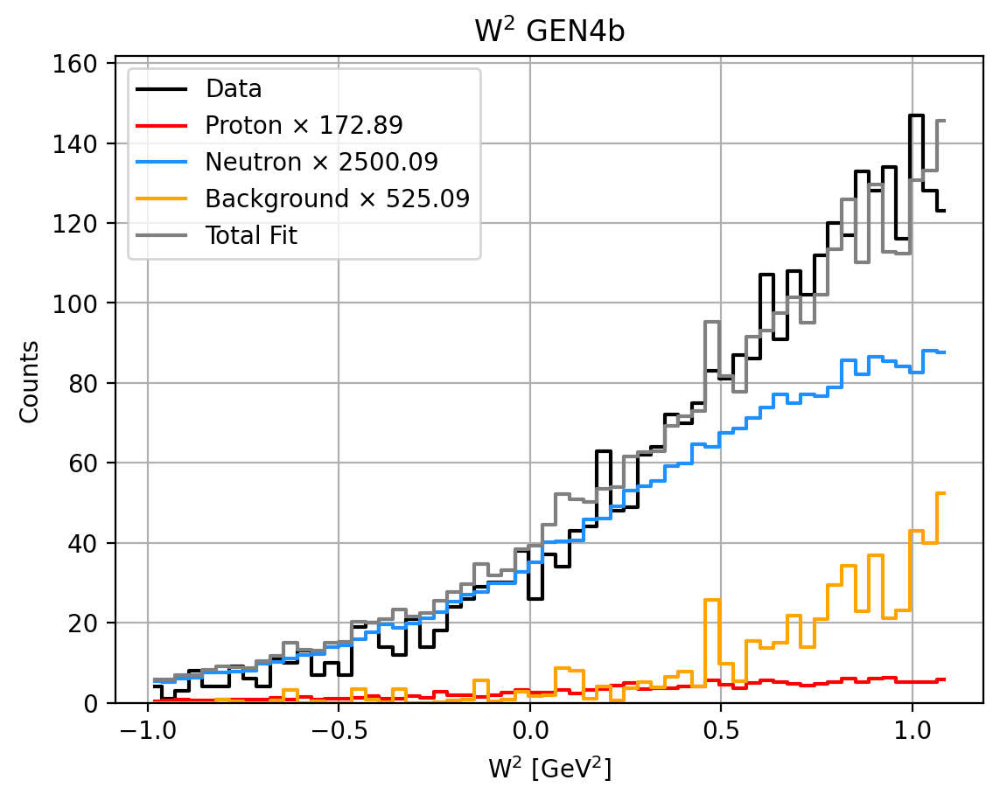

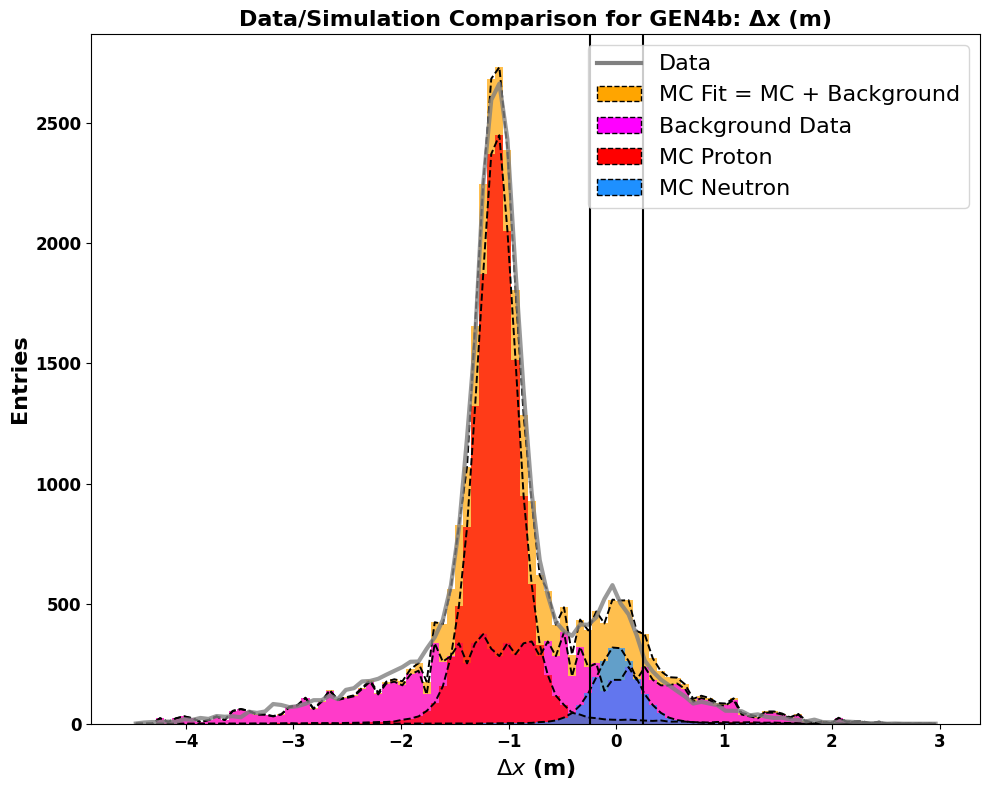

Total entries in fit: 30484.032290550906


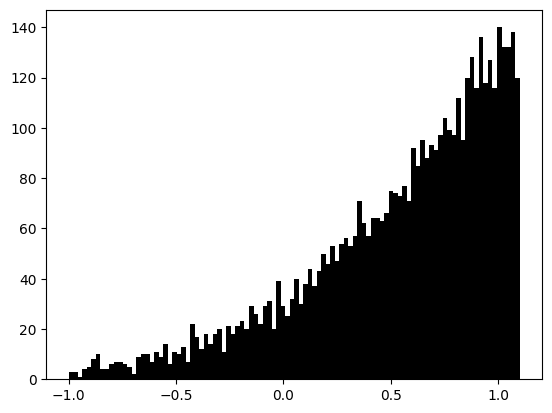

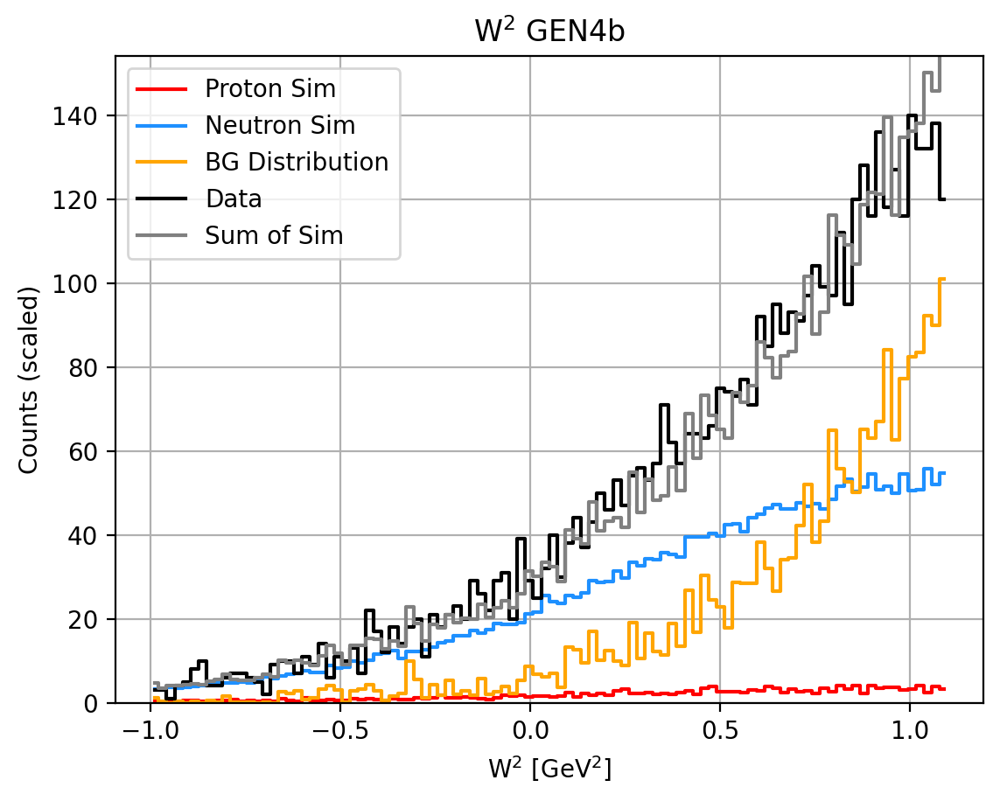

196398 196752
Total events in range (-0.25, 0.25):
  Sim Proton:   106.25
  Sim Neutron:  1536.42
  Background:   1171.80
  Total:        2863.00
Fraction of events in range (-0.25, 0.25):
   Proton Fraction: 0.04
   Background Fraction: 0.41
   W2 Background Fraction: 0.16
   Neutron Fraction: 0.54
__________________________________________________
Target Weighted Avg: 0.38+-0.0214  5.6250%
Beam Weighted Avg: 0.808+-0.0010  0.1201%
__________________________________________________
epsilon = 0.5653
tau_avg = 2.8434
Q2 = 10.0402
Px: 0.9901 Pz: -0.0351
A = 0.06138 ± 0.02202 ± 0.00394
B = 0.41162 (no propagated error)
C = 0.27977 ± 0.11076 ± 0.01980
__________________________________________________
N_plus: 1554 N_minus: 1469
A_raw: 0.0281+=0.0182
A_raw_weighted: 0.0458+-0.0175  38.2283%
__________________________________________________
A_phys_weighted: 0.309
A_phys_stat_error: 0.1108  35.8770%
A_phys_sys_error: 0.0198  6.413%
GEn/GMn*muN: 1.46616+--0.67118+--0.11997
Relative Error: 46.

/tmp/ipykernel_15907/1429301314.py:147: RuntimeWarning: invalid value encountered in divide
  A_raw_per_run = (N_plus_per_run - N_minus_per_run) / (N_plus_per_run + N_minus_per_run)
/tmp/ipykernel_15907/1429301314.py:148: RuntimeWarning: invalid value encountered in divide
  A_raw_error_per_run = 2 * np.sqrt(N_plus_per_run * N_minus_per_run) / (N_plus_per_run + N_minus_per_run)**1.5


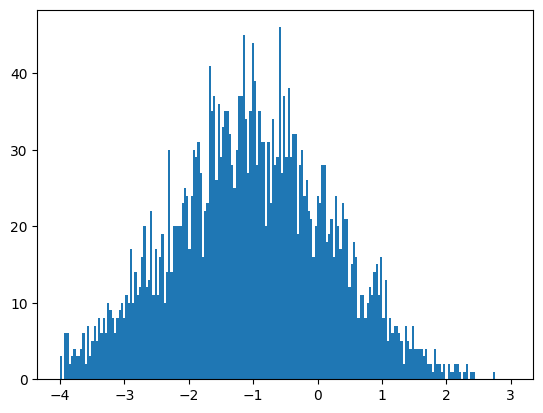

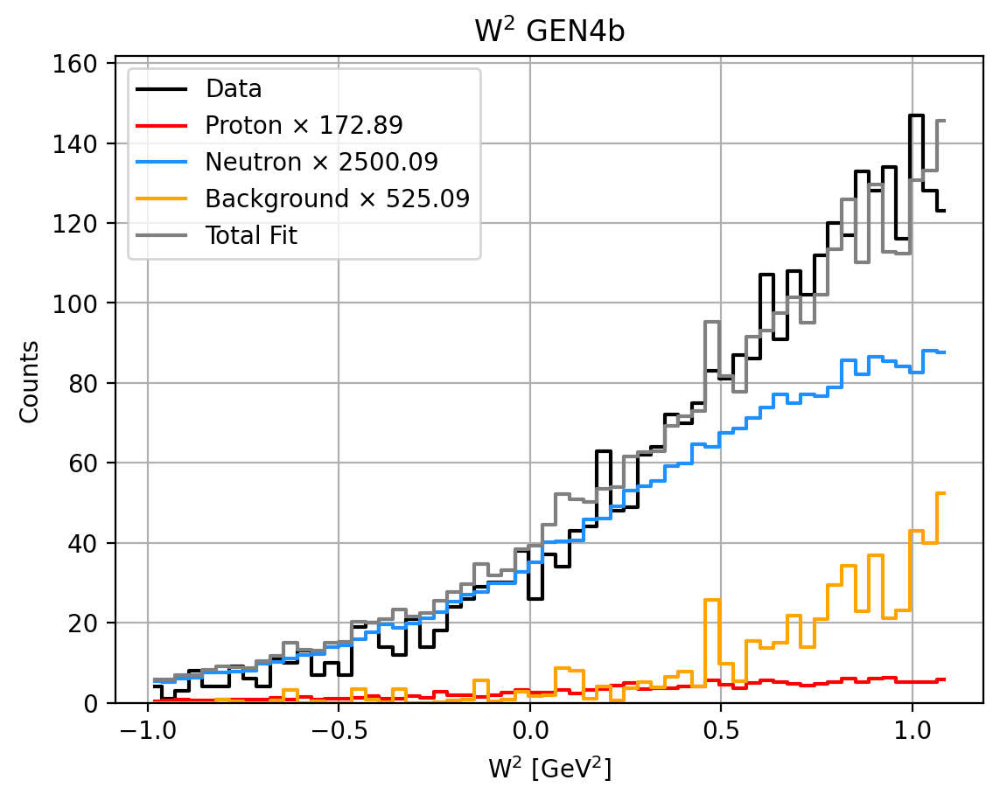

0.8358109502768668 0.05780070319512185 0.7780102470817449 0.16418904972313317


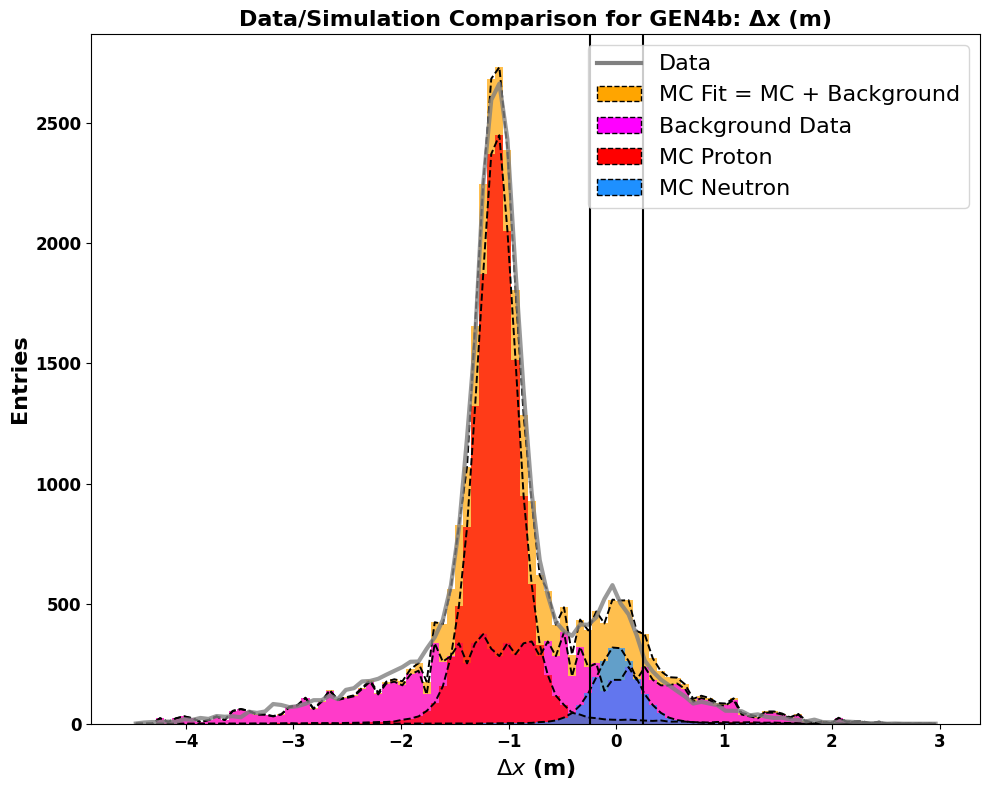

Total entries in fit: 30484.032290550906


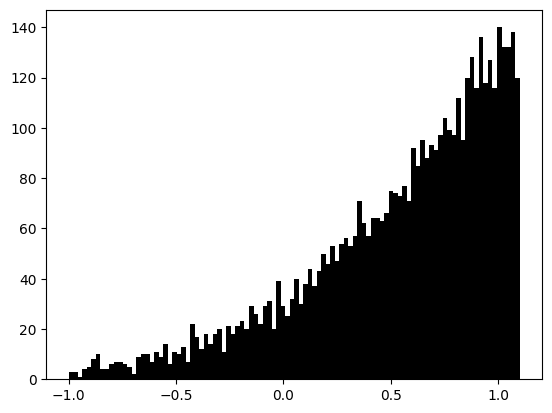

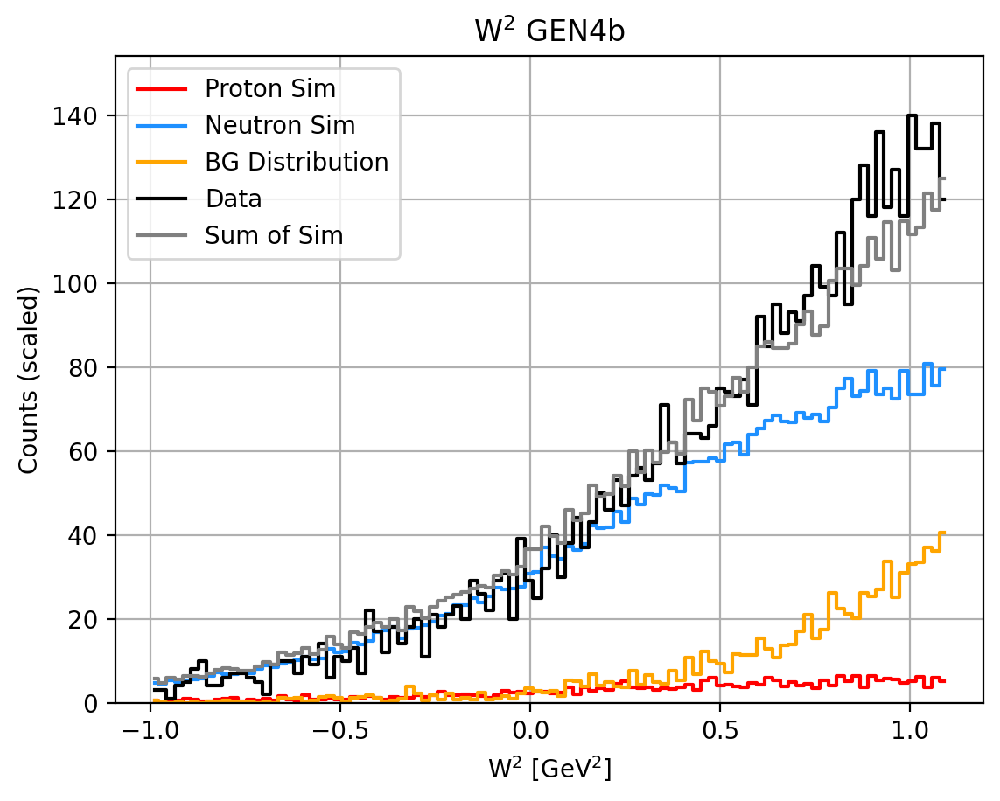

196398 196752
Total events in range (-0.25, 0.25):
  Sim Proton:   106.25
  Sim Neutron:  1536.42
  Background:   1171.80
  Total:        2863.00
Fraction of events in range (-0.25, 0.25):
   Proton Fraction: 0.06
   Background Fraction: 0.16
   W2 Background Fraction: 0.16
   Neutron Fraction: 0.78
__________________________________________________
Target Weighted Avg: 0.38+-0.0214  5.6250%
Beam Weighted Avg: 0.808+-0.0010  0.1201%
__________________________________________________
epsilon = 0.5653
tau_avg = 2.8434
Q2 = 10.0402
Px: 0.9901 Pz: -0.0351
A = 0.04348 ± 0.01567 ± 0.00262
B = 0.41162 (no propagated error)
C = 0.18975 ± 0.07881 ± 0.01318
__________________________________________________
N_plus: 1554 N_minus: 1469
A_raw: 0.0281+=0.0182
A_raw_weighted: 0.0458+-0.0175  38.2283%
__________________________________________________
A_phys_weighted: 0.219
A_phys_stat_error: 0.0788  36.0356%
A_phys_sys_error: 0.0132  6.025%
GEn/GMn*muN: 0.92825+--0.40807+--0.06823
Relative Error: 44.

/tmp/ipykernel_15907/1429301314.py:147: RuntimeWarning: invalid value encountered in divide
  A_raw_per_run = (N_plus_per_run - N_minus_per_run) / (N_plus_per_run + N_minus_per_run)
/tmp/ipykernel_15907/1429301314.py:148: RuntimeWarning: invalid value encountered in divide
  A_raw_error_per_run = 2 * np.sqrt(N_plus_per_run * N_minus_per_run) / (N_plus_per_run + N_minus_per_run)**1.5


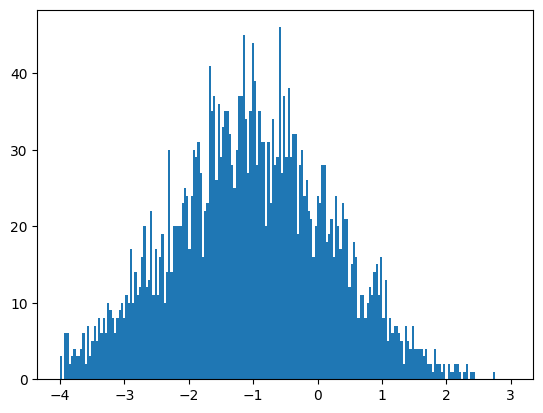

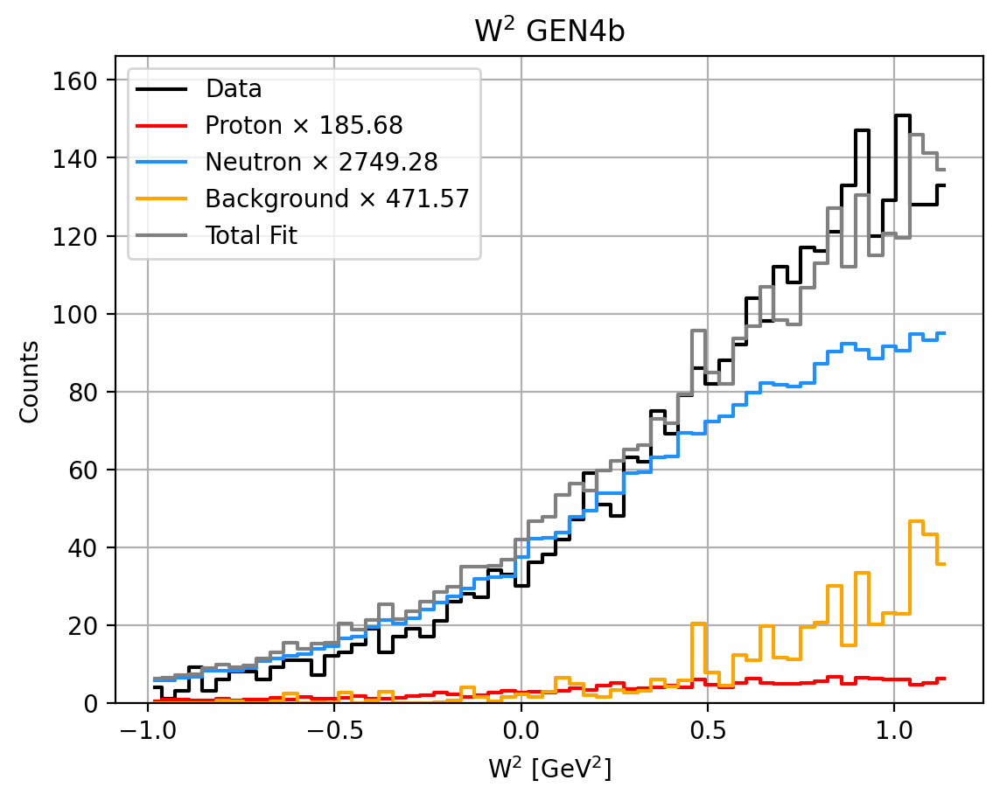

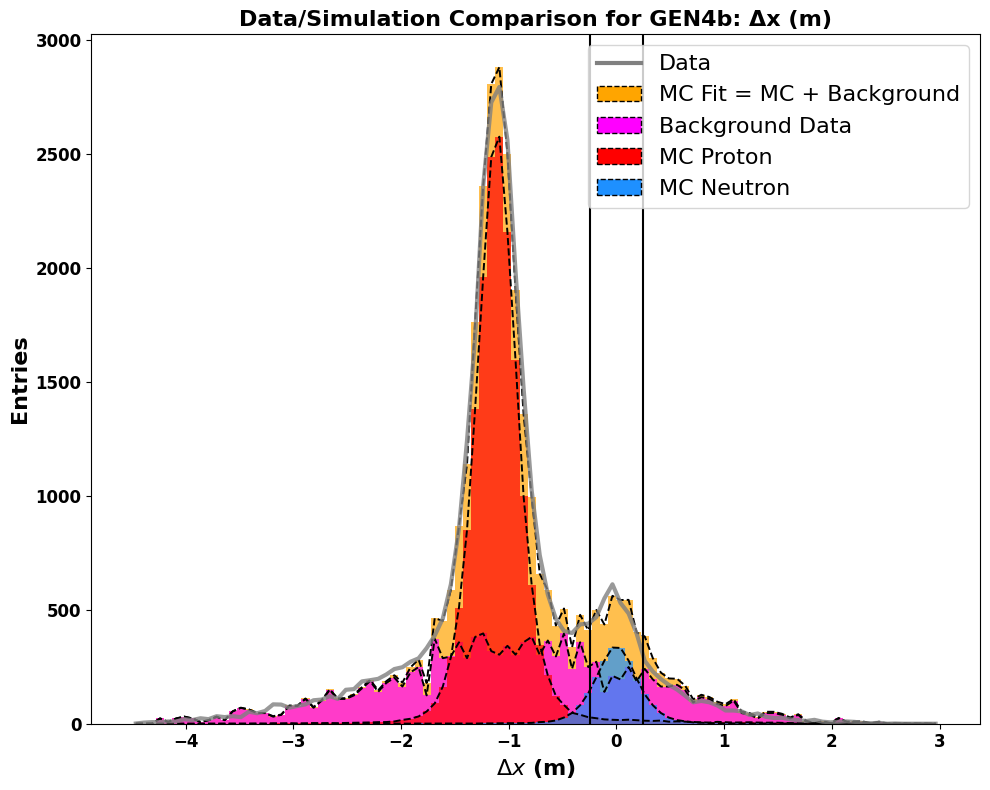

Total entries in fit: 32294.093779149753


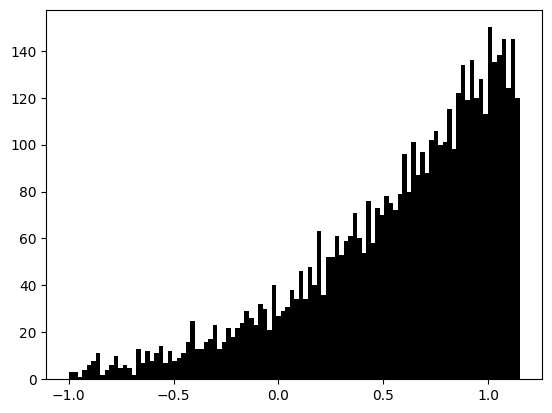

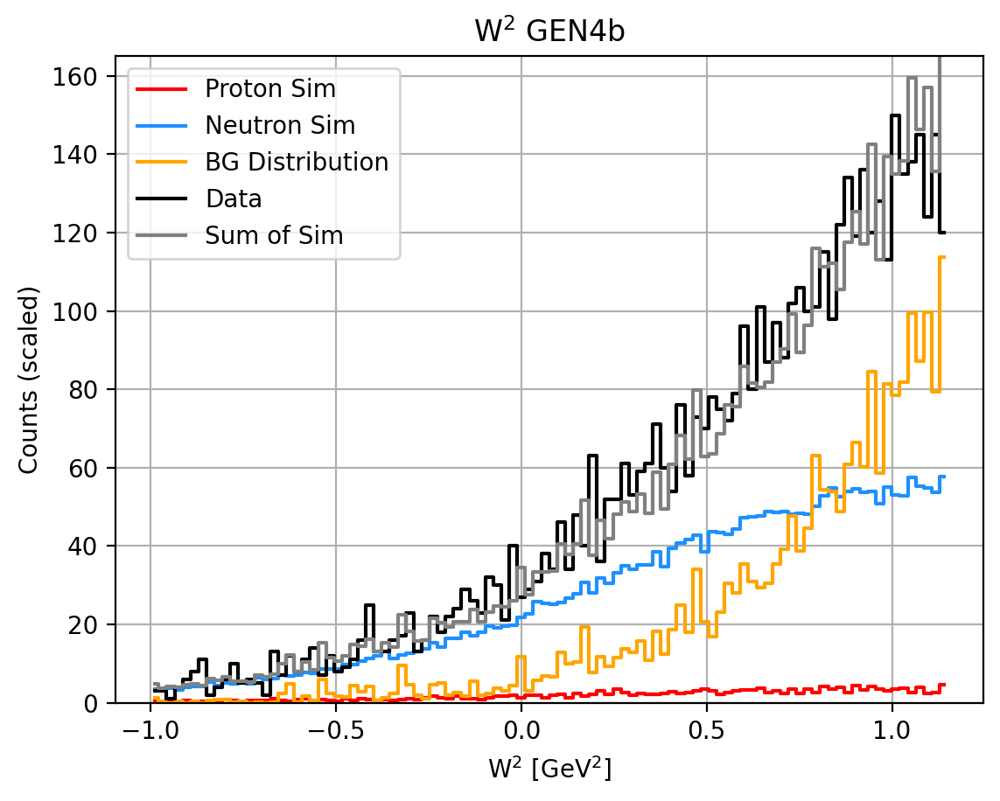

196398 196752
Total events in range (-0.25, 0.25):
  Sim Proton:   109.60
  Sim Neutron:  1622.77
  Background:   1251.26
  Total:        3039.00
Fraction of events in range (-0.25, 0.25):
   Proton Fraction: 0.04
   Background Fraction: 0.41
   W2 Background Fraction: 0.14
   Neutron Fraction: 0.53
__________________________________________________
Target Weighted Avg: 0.38+-0.0216  5.6710%
Beam Weighted Avg: 0.808+-0.0010  0.1201%
__________________________________________________
epsilon = 0.5661
tau_avg = 2.8362
Q2 = 10.0149
Px: 0.9901 Pz: -0.0344
A = 0.06091 ± 0.02147 ± 0.00392
B = 0.41207 (no propagated error)
C = 0.27677 ± 0.10757 ± 0.01966
__________________________________________________
N_plus: 1645 N_minus: 1561
A_raw: 0.0262+=0.0177
A_raw_weighted: 0.0449+-0.0170  37.7455%
__________________________________________________
A_phys_weighted: 0.305
A_phys_stat_error: 0.1076  35.2502%
A_phys_sys_error: 0.0197  6.443%
GEn/GMn*muN: 1.44449+--0.64641+--0.11816
Relative Error: 45.

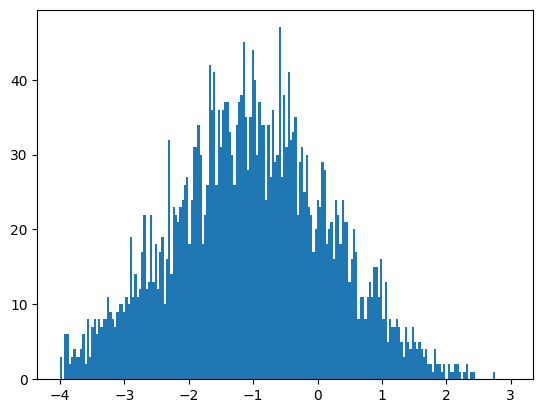

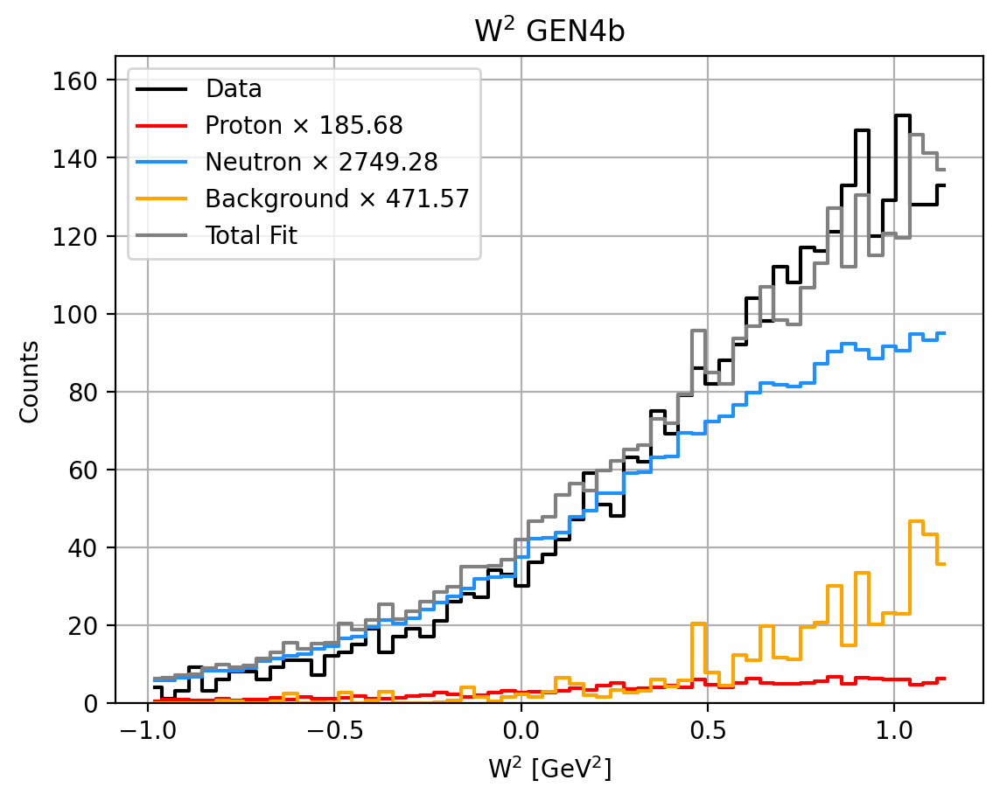

0.8615693461618131 0.05818982680096267 0.8033795193608505 0.13843065383818687


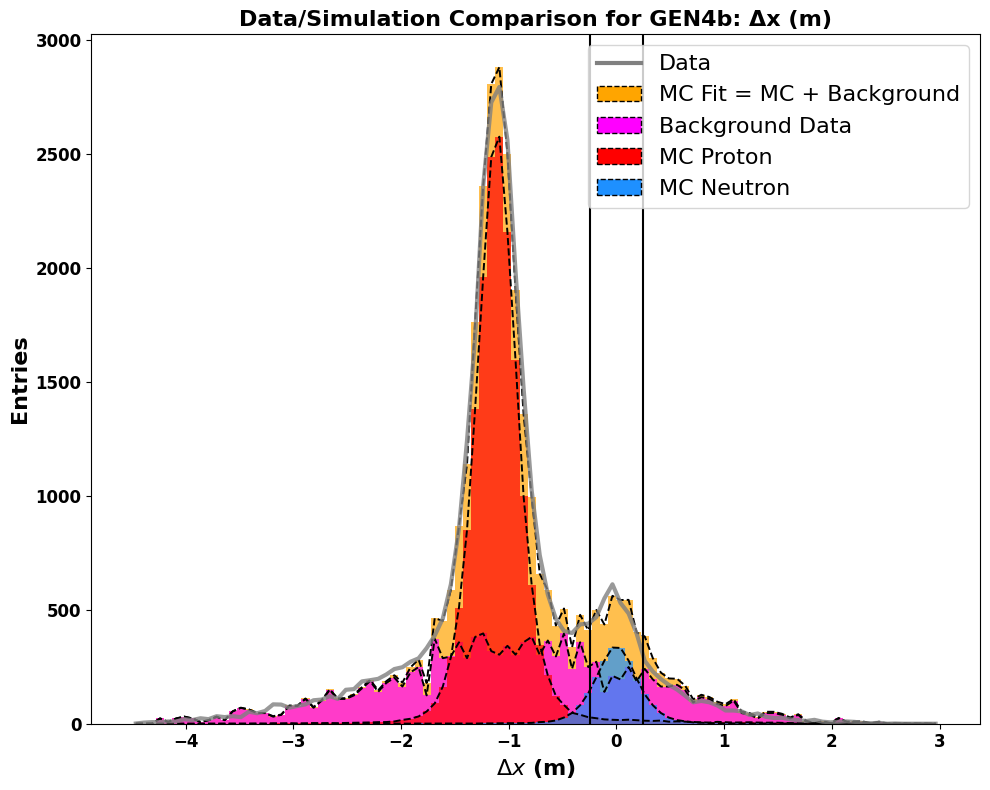

Total entries in fit: 32294.093779149753


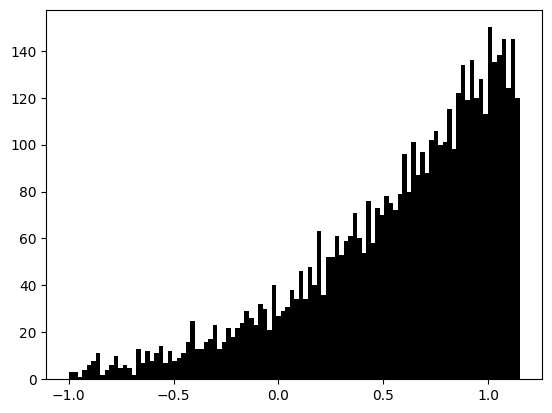

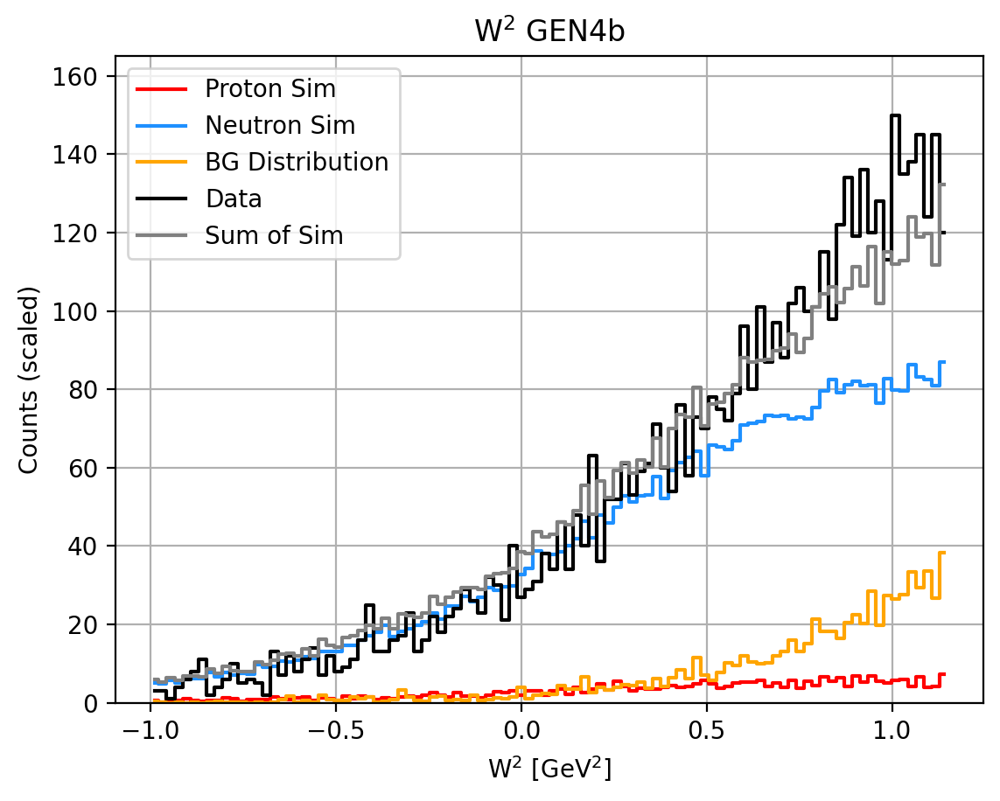

196398 196752
Total events in range (-0.25, 0.25):
  Sim Proton:   109.60
  Sim Neutron:  1622.77
  Background:   1251.26
  Total:        3039.00
Fraction of events in range (-0.25, 0.25):
   Proton Fraction: 0.06
   Background Fraction: 0.14
   W2 Background Fraction: 0.14
   Neutron Fraction: 0.80
__________________________________________________
Target Weighted Avg: 0.38+-0.0216  5.6710%
Beam Weighted Avg: 0.808+-0.0010  0.1201%
__________________________________________________
epsilon = 0.5661
tau_avg = 2.8362
Q2 = 10.0149
Px: 0.9901 Pz: -0.0344
A = 0.04166 ± 0.01476 ± 0.00252
B = 0.41207 (no propagated error)
C = 0.18031 ± 0.07394 ± 0.01261
__________________________________________________
N_plus: 1645 N_minus: 1561
A_raw: 0.0262+=0.0177
A_raw_weighted: 0.0449+-0.0170  37.7455%
__________________________________________________
A_phys_weighted: 0.209
A_phys_stat_error: 0.0739  35.4268%
A_phys_sys_error: 0.0126  6.043%
GEn/GMn*muN: 0.87655+--0.37815+--0.06450
Relative Error: 43.

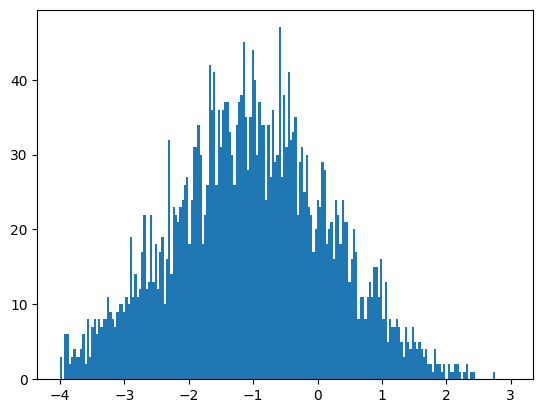

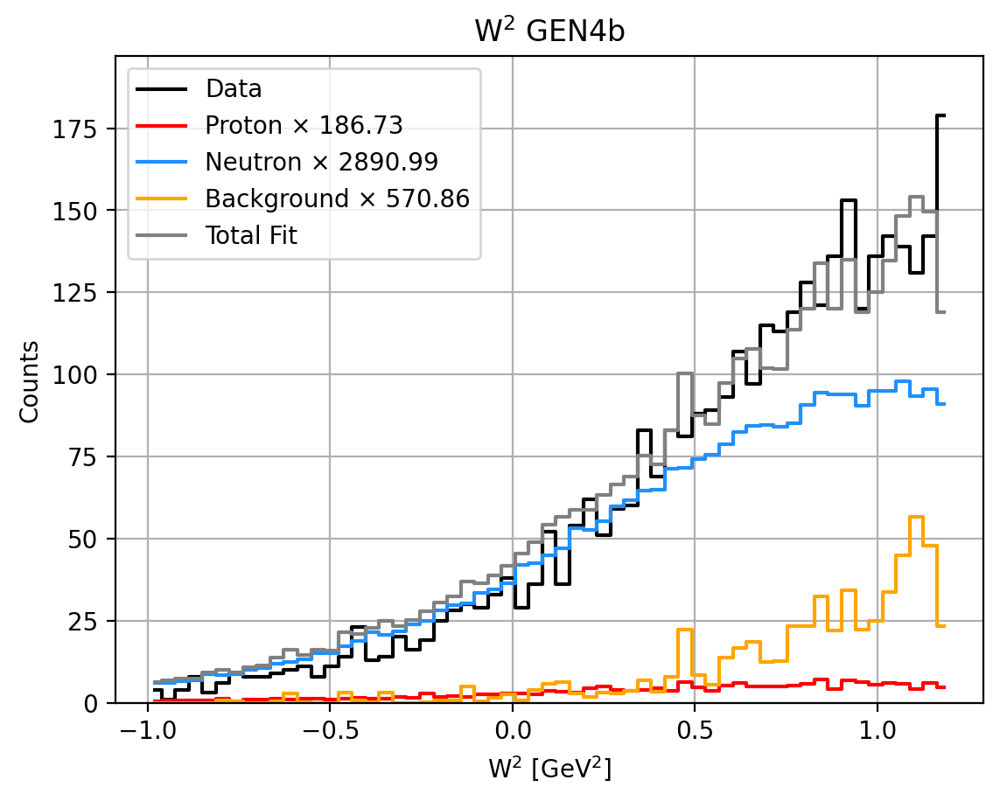

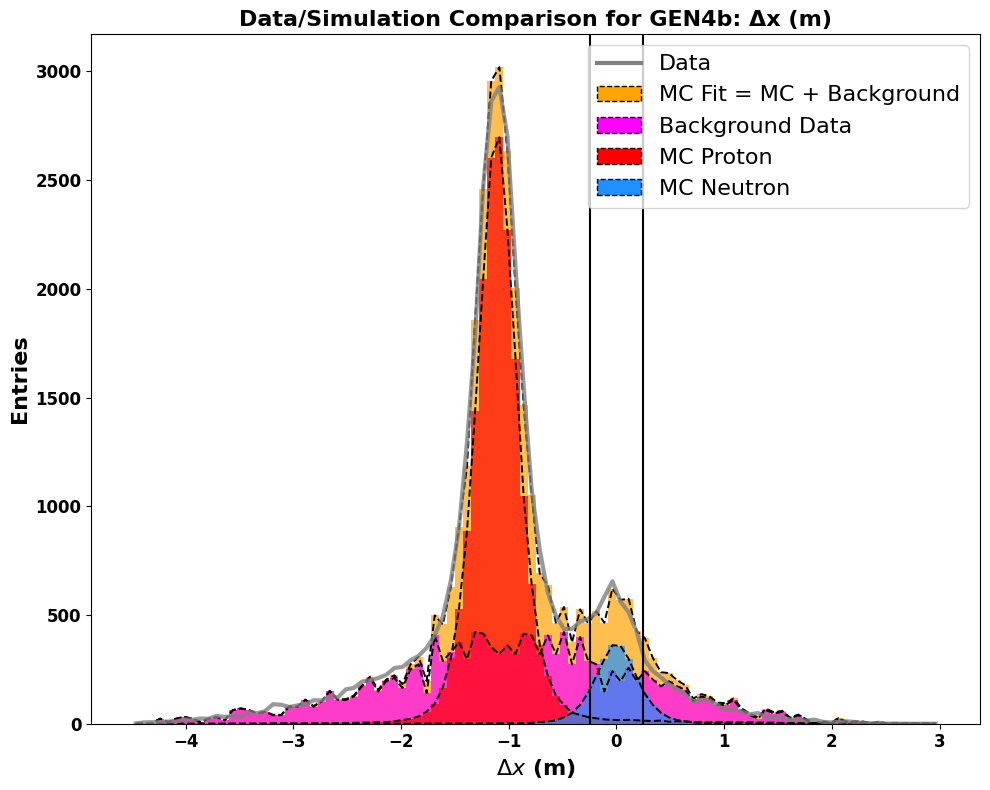

Total entries in fit: 34195.4576350747


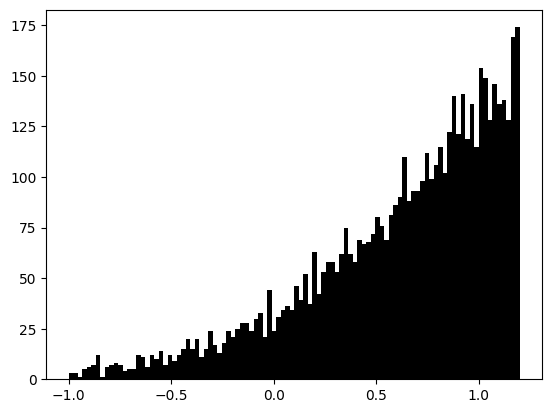

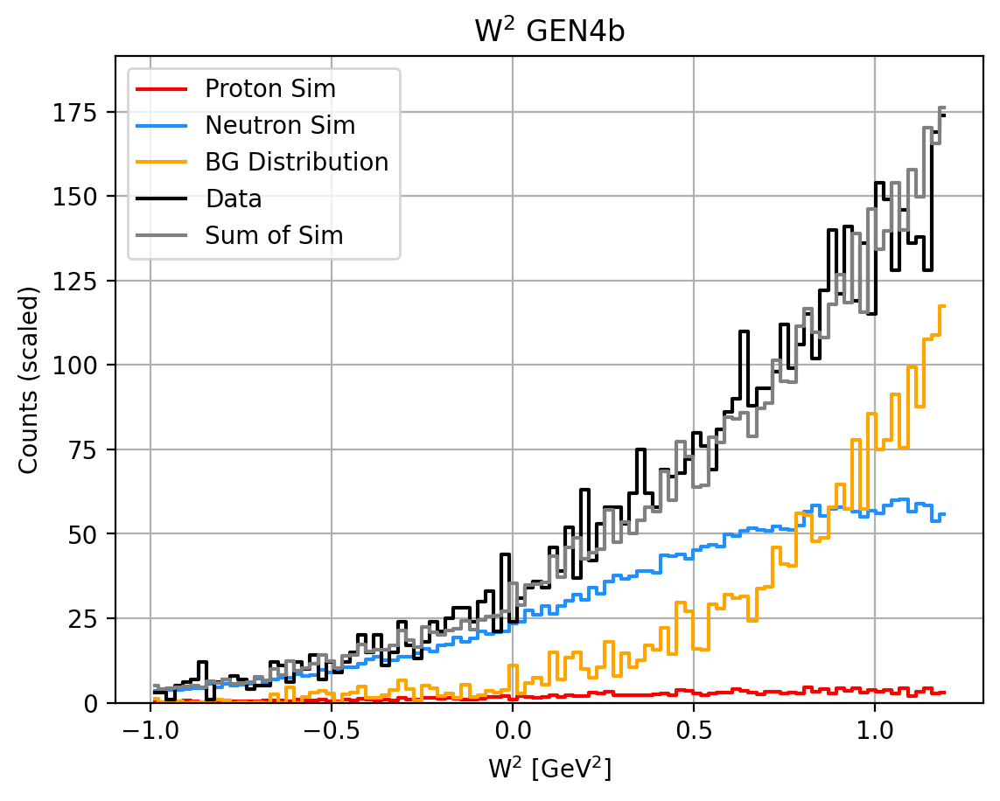

196398 196752
Total events in range (-0.25, 0.25):
  Sim Proton:   112.90
  Sim Neutron:  1747.90
  Background:   1312.46
  Total:        3245.00
Fraction of events in range (-0.25, 0.25):
   Proton Fraction: 0.03
   Background Fraction: 0.40
   W2 Background Fraction: 0.16
   Neutron Fraction: 0.54
__________________________________________________
Target Weighted Avg: 0.38+-0.0214  5.6422%
Beam Weighted Avg: 0.808+-0.0010  0.1201%
__________________________________________________
epsilon = 0.5666
tau_avg = 2.8288
Q2 = 9.9889
Px: 0.9901 Pz: -0.0334
A = 0.06025 ± 0.02045 ± 0.00382
B = 0.41254 (no propagated error)
C = 0.27323 ± 0.10208 ± 0.01909
__________________________________________________
N_plus: 1761 N_minus: 1673
A_raw: 0.0256+=0.0171
A_raw_weighted: 0.0461+-0.0163  35.4451%
__________________________________________________
A_phys_weighted: 0.301
A_phys_stat_error: 0.1021  33.9369%
A_phys_sys_error: 0.0191  6.347%
GEn/GMn*muN: 1.41915+--0.60733+--0.11358
Relative Error: 43.5

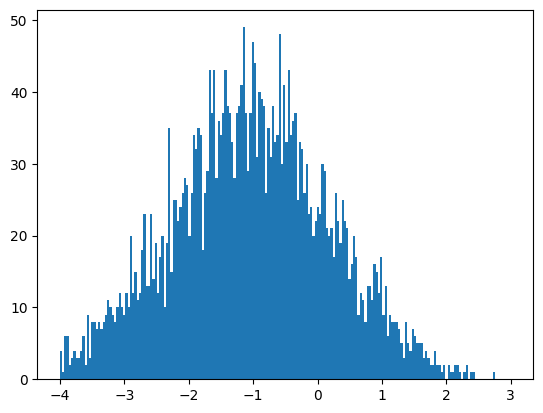

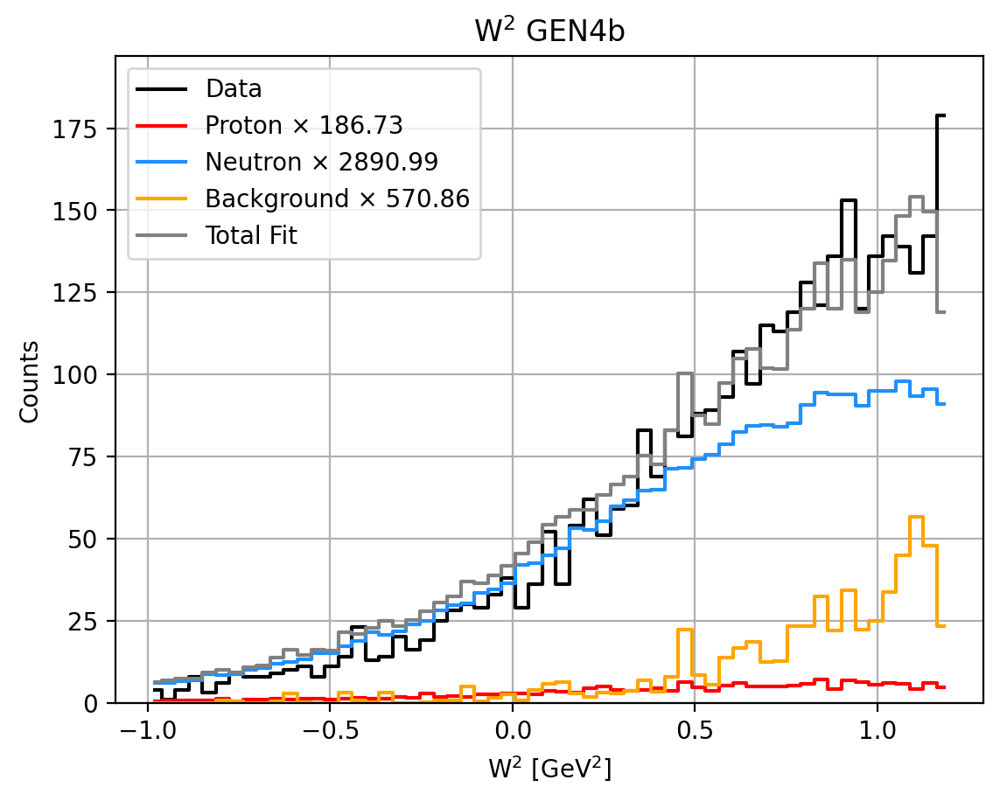

0.8435404888475219 0.05448530013118312 0.7890551887163387 0.15645951115247816


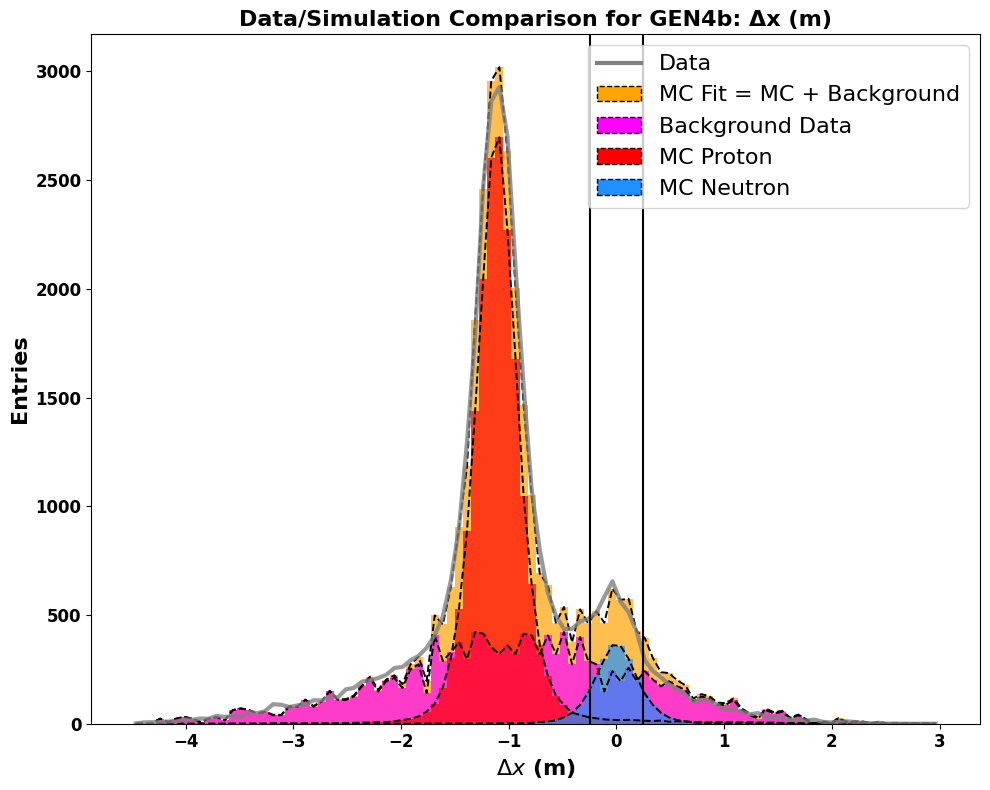

Total entries in fit: 34195.4576350747


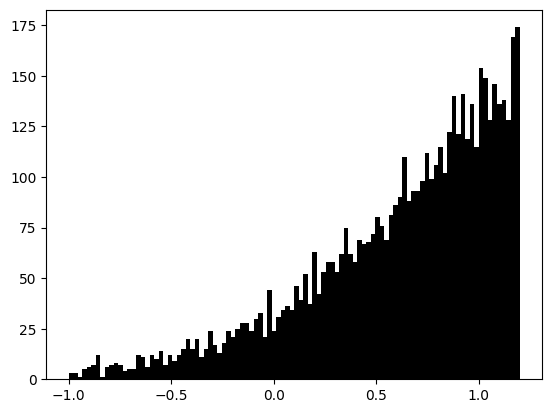

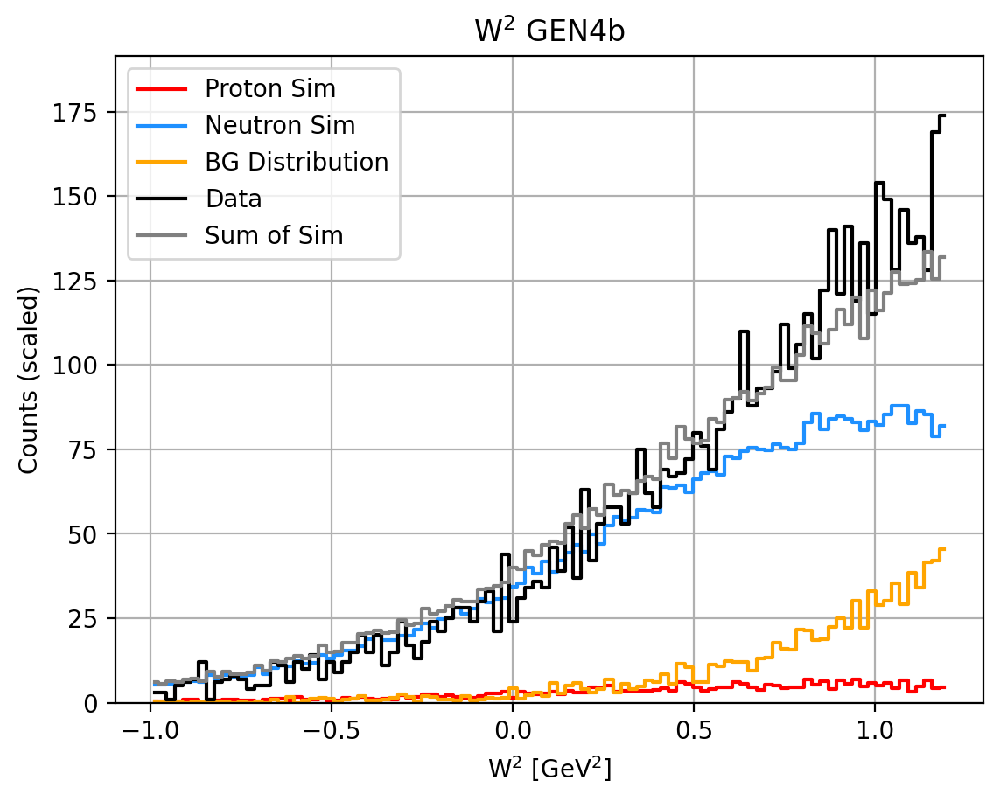

196398 196752
Total events in range (-0.25, 0.25):
  Sim Proton:   112.90
  Sim Neutron:  1747.90
  Background:   1312.46
  Total:        3245.00
Fraction of events in range (-0.25, 0.25):
   Proton Fraction: 0.05
   Background Fraction: 0.16
   W2 Background Fraction: 0.16
   Neutron Fraction: 0.79
__________________________________________________
Target Weighted Avg: 0.38+-0.0214  5.6422%
Beam Weighted Avg: 0.808+-0.0010  0.1201%
__________________________________________________
epsilon = 0.5666
tau_avg = 2.8288
Q2 = 9.9889
Px: 0.9901 Pz: -0.0334
A = 0.04262 ± 0.01453 ± 0.00256
B = 0.41254 (no propagated error)
C = 0.18523 ± 0.07254 ± 0.01276
__________________________________________________
N_plus: 1761 N_minus: 1673
A_raw: 0.0256+=0.0171
A_raw_weighted: 0.0461+-0.0163  35.4451%
__________________________________________________
A_phys_weighted: 0.213
A_phys_stat_error: 0.0725  34.0912%
A_phys_sys_error: 0.0128  5.998%
GEn/GMn*muN: 0.90169+--0.37258+--0.06555
Relative Error: 41.9

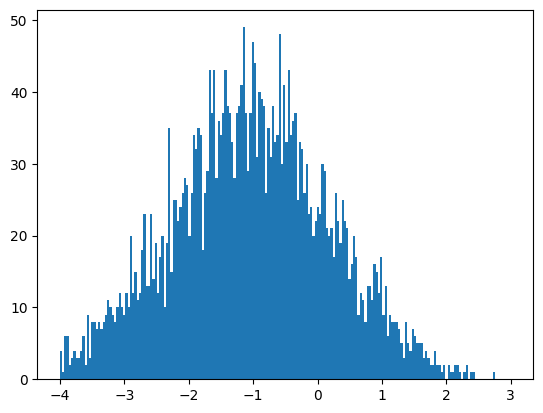

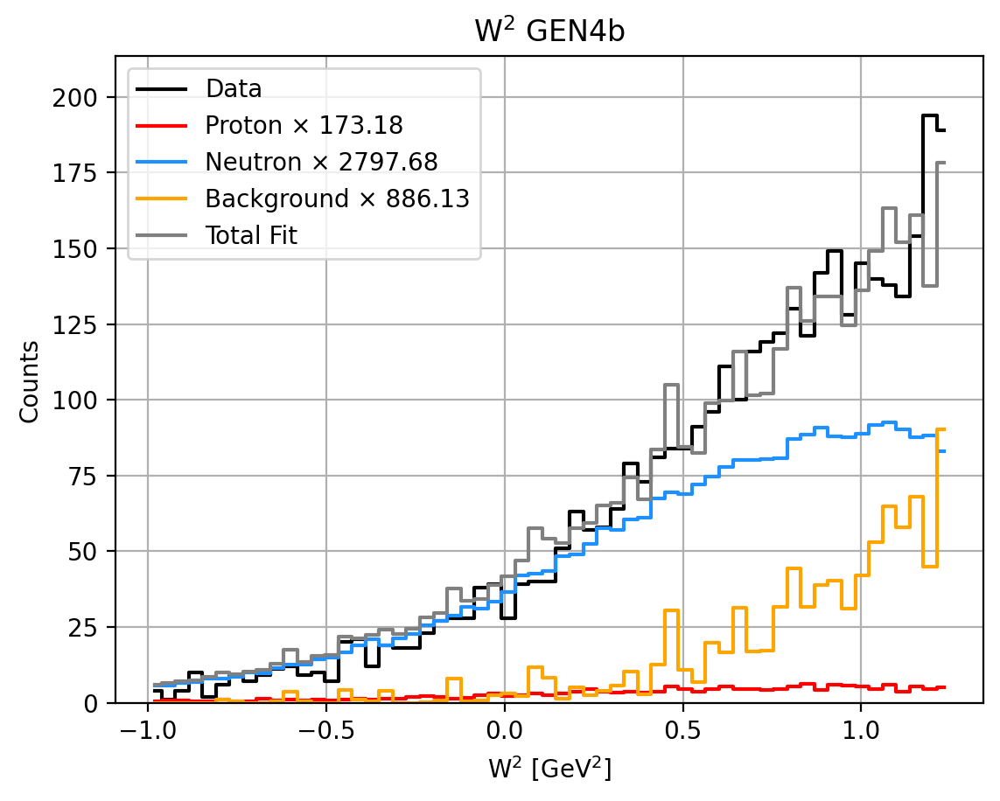

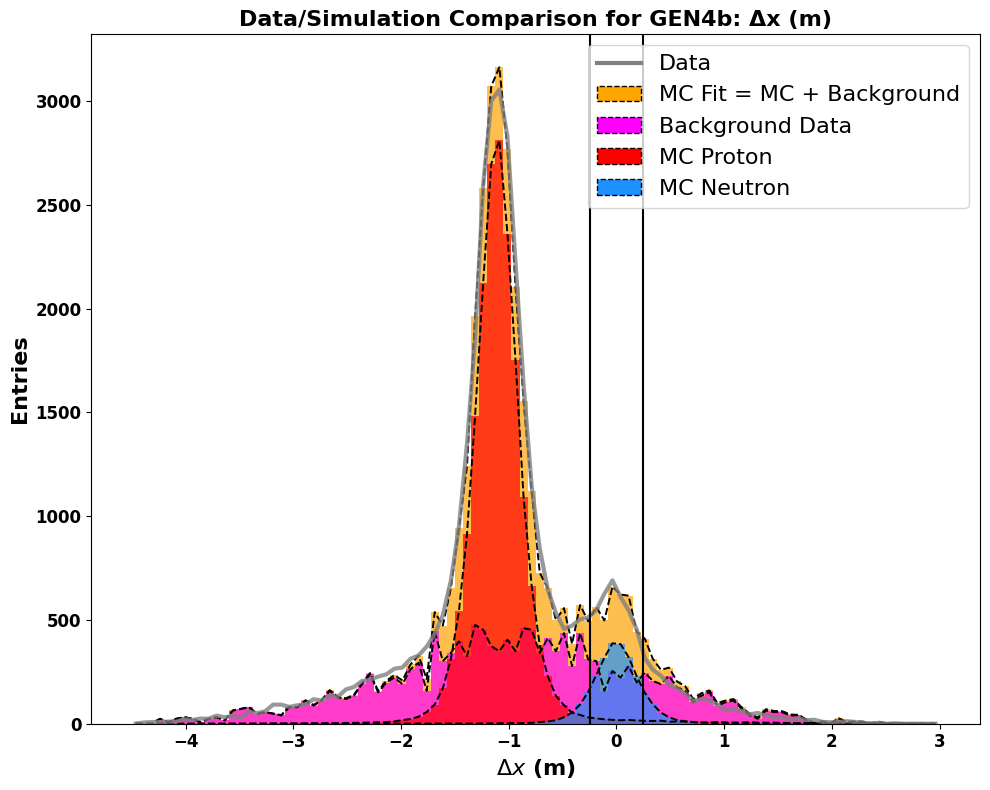

Total entries in fit: 36129.27450394872


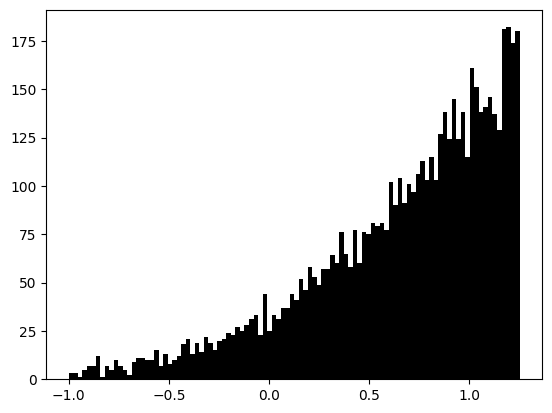

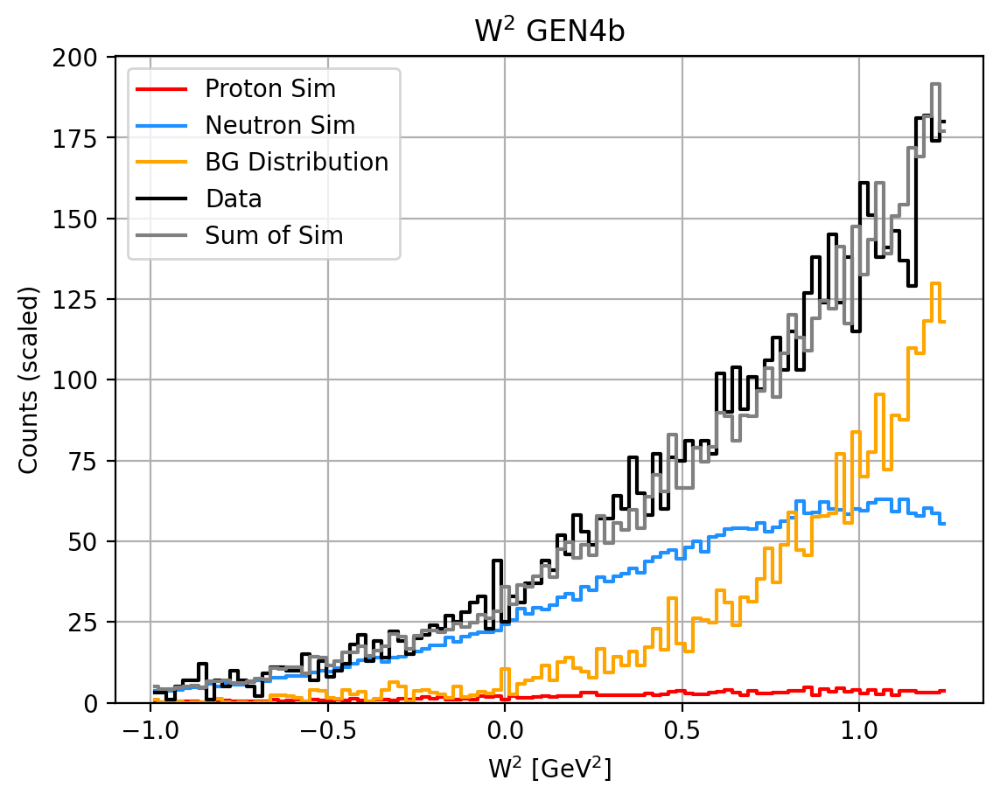

196398 196752
Total events in range (-0.25, 0.25):
  Sim Proton:   116.02
  Sim Neutron:  1874.26
  Background:   1413.49
  Total:        3476.00
Fraction of events in range (-0.25, 0.25):
   Proton Fraction: 0.03
   Background Fraction: 0.41
   W2 Background Fraction: 0.23
   Neutron Fraction: 0.54
__________________________________________________
Target Weighted Avg: 0.379+-0.0214  5.6376%
Beam Weighted Avg: 0.808+-0.0010  0.1201%
__________________________________________________
epsilon = 0.5677
tau_avg = 2.8197
Q2 = 9.9567
Px: 0.9902 Pz: -0.0327
A = 0.05752 ± 0.01992 ± 0.00364
B = 0.41311 (no propagated error)
C = 0.25876 ± 0.09891 ± 0.01809
__________________________________________________
N_plus: 1885 N_minus: 1790
A_raw: 0.0259+=0.0165
A_raw_weighted: 0.0435+-0.0158  36.3426%
__________________________________________________
A_phys_weighted: 0.286
A_phys_stat_error: 0.0989  34.6214%
A_phys_sys_error: 0.0181  6.332%
GEn/GMn*muN: 1.32437+--0.56945+--0.10415
Relative Error: 43.

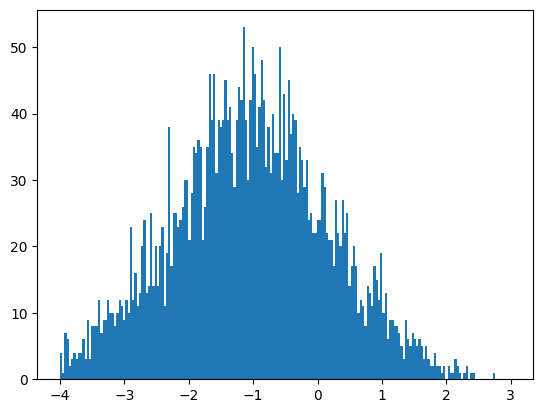

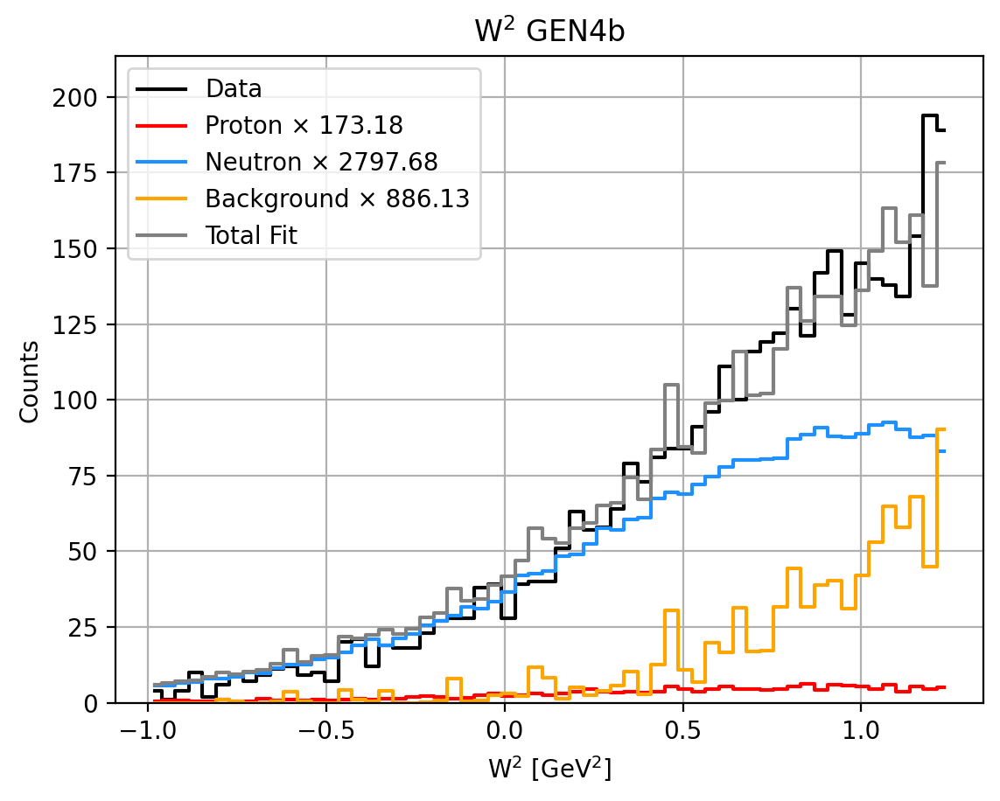

0.7702530838134404 0.04768106267122084 0.7225720211422195 0.22974691618655962


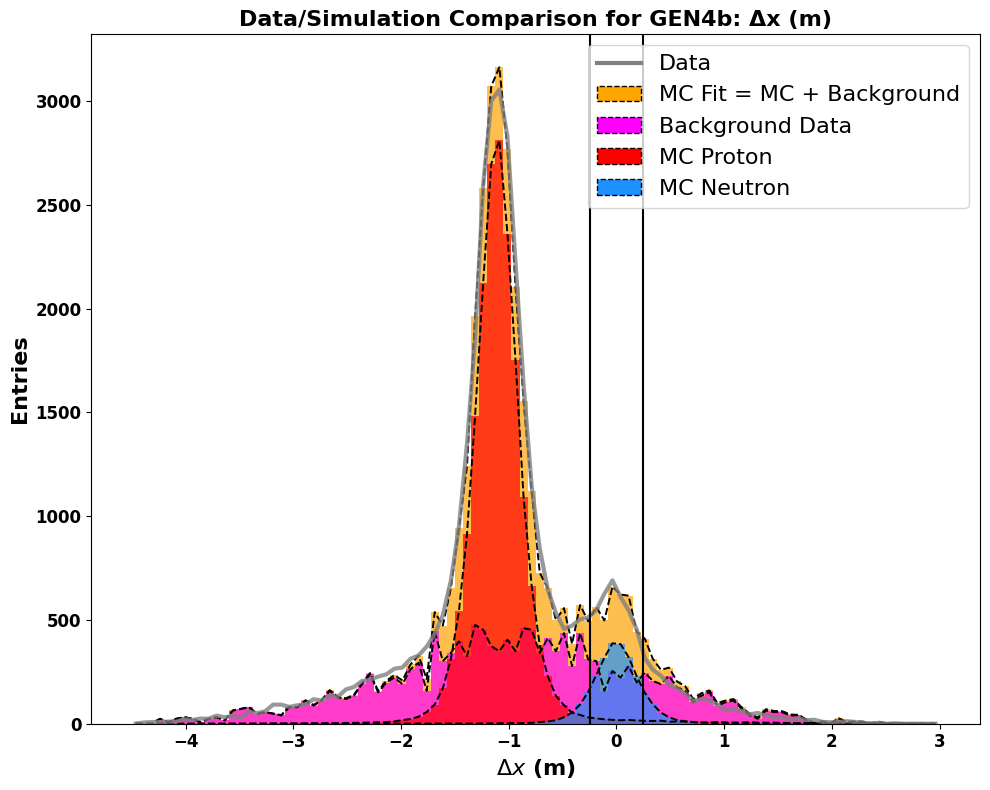

Total entries in fit: 36129.27450394872


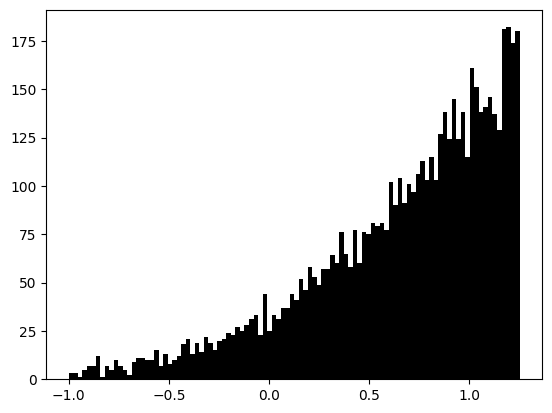

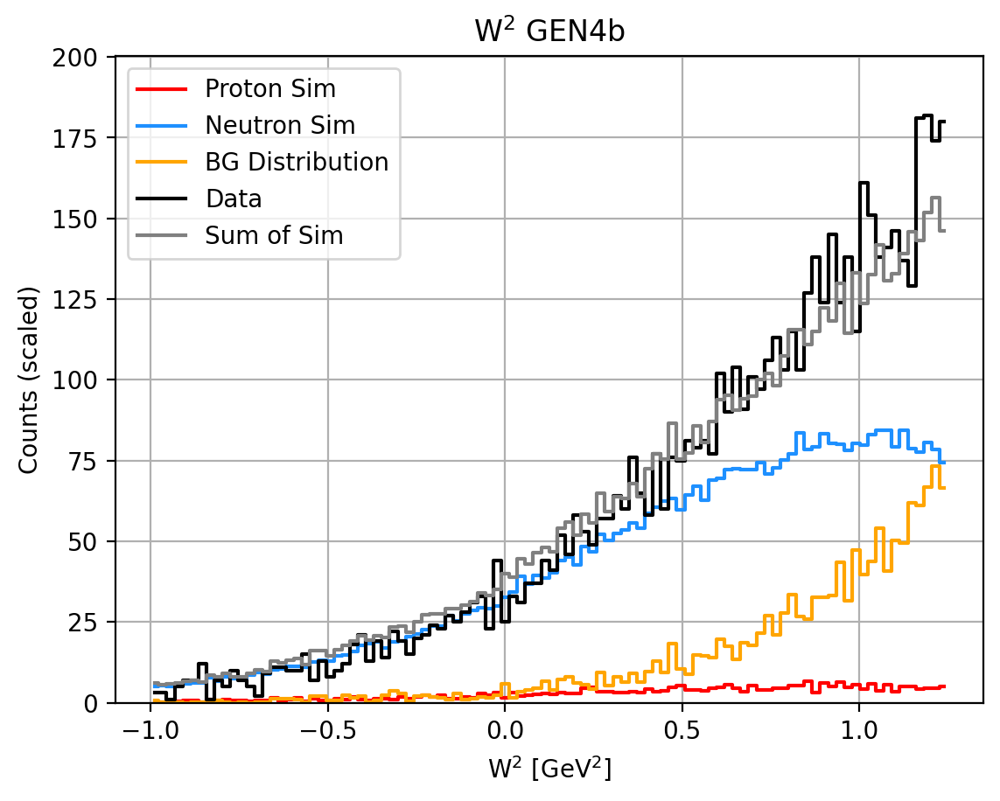

196398 196752
Total events in range (-0.25, 0.25):
  Sim Proton:   116.02
  Sim Neutron:  1874.26
  Background:   1413.49
  Total:        3476.00
Fraction of events in range (-0.25, 0.25):
   Proton Fraction: 0.05
   Background Fraction: 0.23
   W2 Background Fraction: 0.23
   Neutron Fraction: 0.72
__________________________________________________
Target Weighted Avg: 0.379+-0.0214  5.6376%
Beam Weighted Avg: 0.808+-0.0010  0.1201%
__________________________________________________
epsilon = 0.5677
tau_avg = 2.8197
Q2 = 9.9567
Px: 0.9902 Pz: -0.0327
A = 0.04443 ± 0.01543 ± 0.00269
B = 0.41311 (no propagated error)
C = 0.19371 ± 0.07665 ± 0.01335
__________________________________________________
N_plus: 1885 N_minus: 1790
A_raw: 0.0259+=0.0165
A_raw_weighted: 0.0435+-0.0158  36.3426%
__________________________________________________
A_phys_weighted: 0.221
A_phys_stat_error: 0.0767  34.7398%
A_phys_sys_error: 0.0134  6.052%
GEn/GMn*muN: 0.94616+--0.39720+--0.06920
Relative Error: 42.

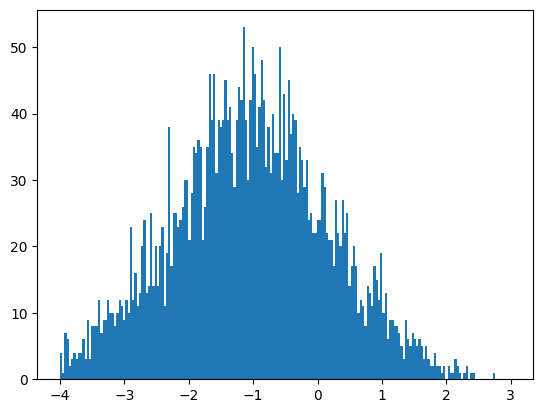

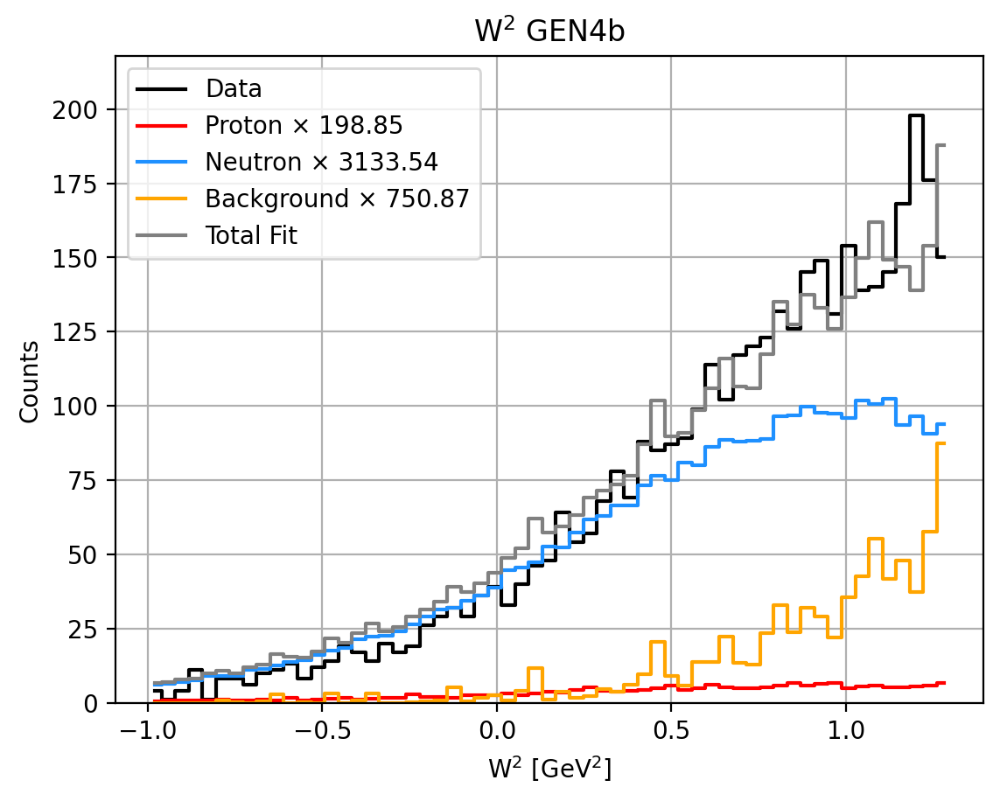

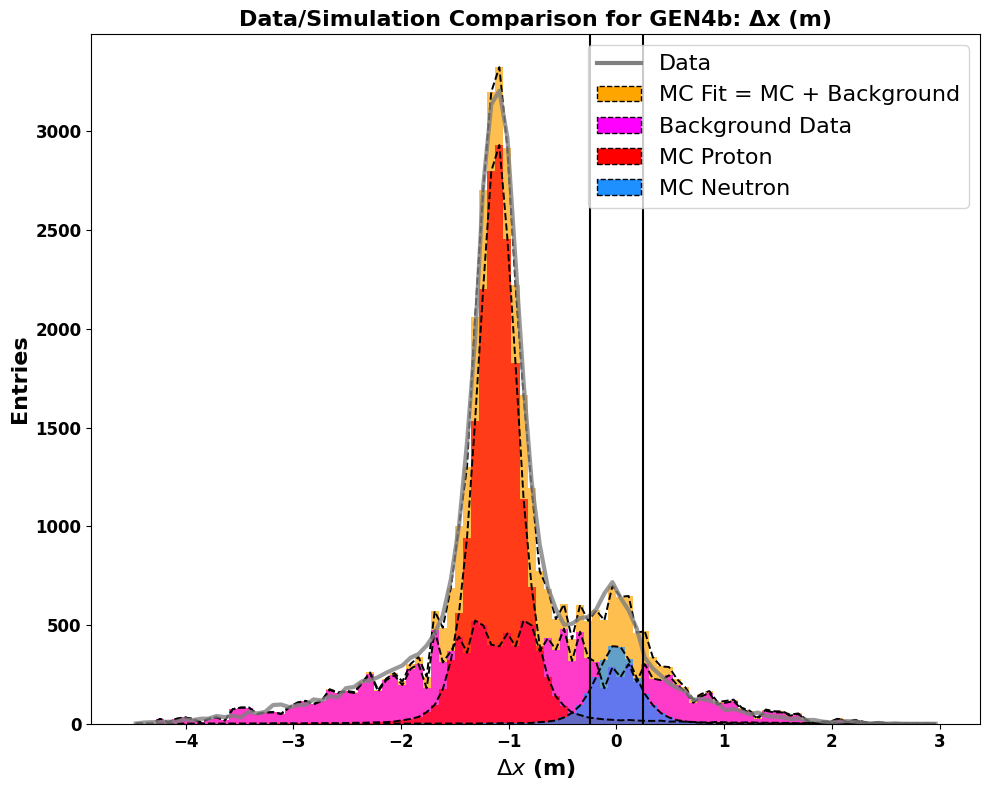

Total entries in fit: 38255.51829497147


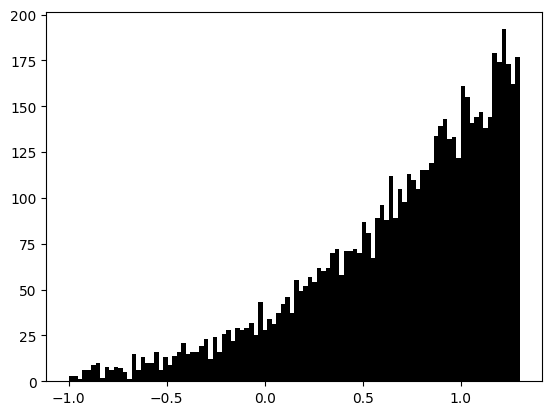

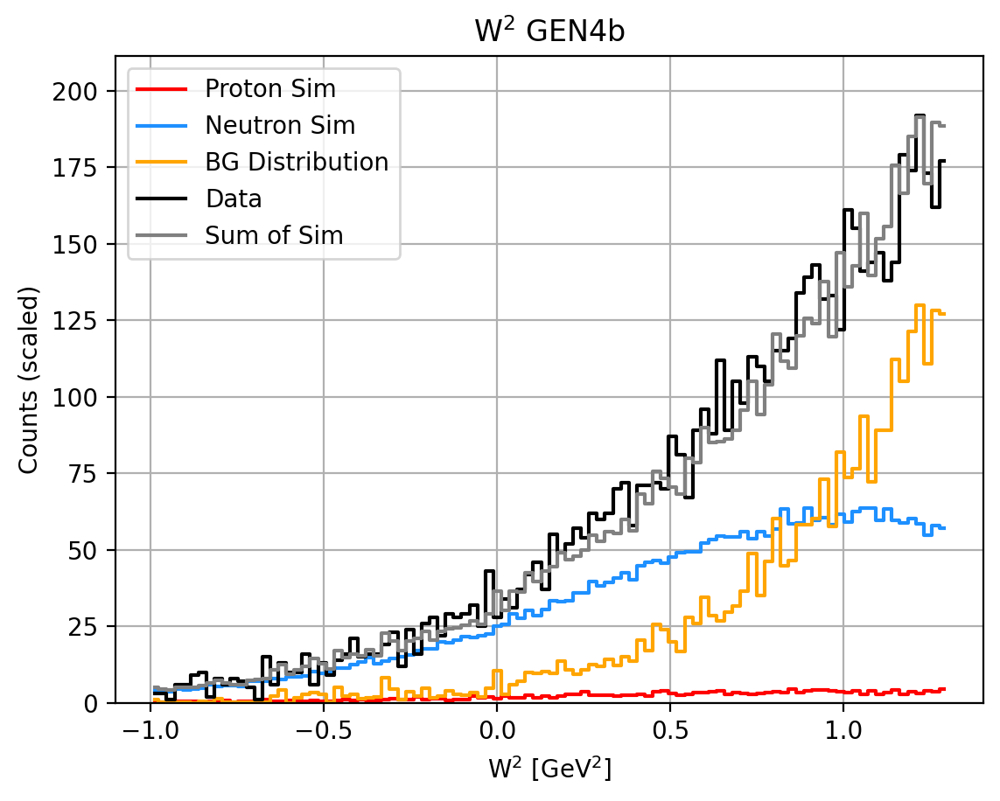

196398 196752
Total events in range (-0.25, 0.25):
  Sim Proton:   120.58
  Sim Neutron:  1900.17
  Background:   1526.80
  Total:        3651.00
Fraction of events in range (-0.25, 0.25):
   Proton Fraction: 0.03
   Background Fraction: 0.42
   W2 Background Fraction: 0.18
   Neutron Fraction: 0.52
__________________________________________________
Target Weighted Avg: 0.379+-0.0214  5.6335%
Beam Weighted Avg: 0.808+-0.0010  0.1201%
__________________________________________________
epsilon = 0.5686
tau_avg = 2.8127
Q2 = 9.9321
Px: 0.9902 Pz: -0.0322
A = 0.04654 ± 0.02000 ± 0.00301
B = 0.41354 (no propagated error)
C = 0.20375 ± 0.09894 ± 0.01487
__________________________________________________
N_plus: 1987 N_minus: 1878
A_raw: 0.0282+=0.0161
A_raw_weighted: 0.0357+-0.0155  43.3230%
__________________________________________________
A_phys_weighted: 0.23
A_phys_stat_error: 0.0989  42.9806%
A_phys_sys_error: 0.0149  6.462%
GEn/GMn*muN: 1.00010+--0.51890+--0.07801
Relative Error: 52.4

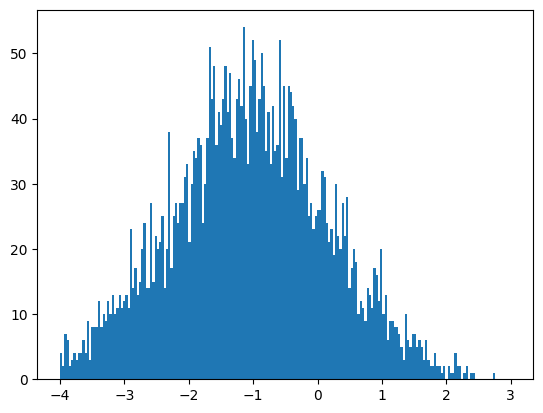

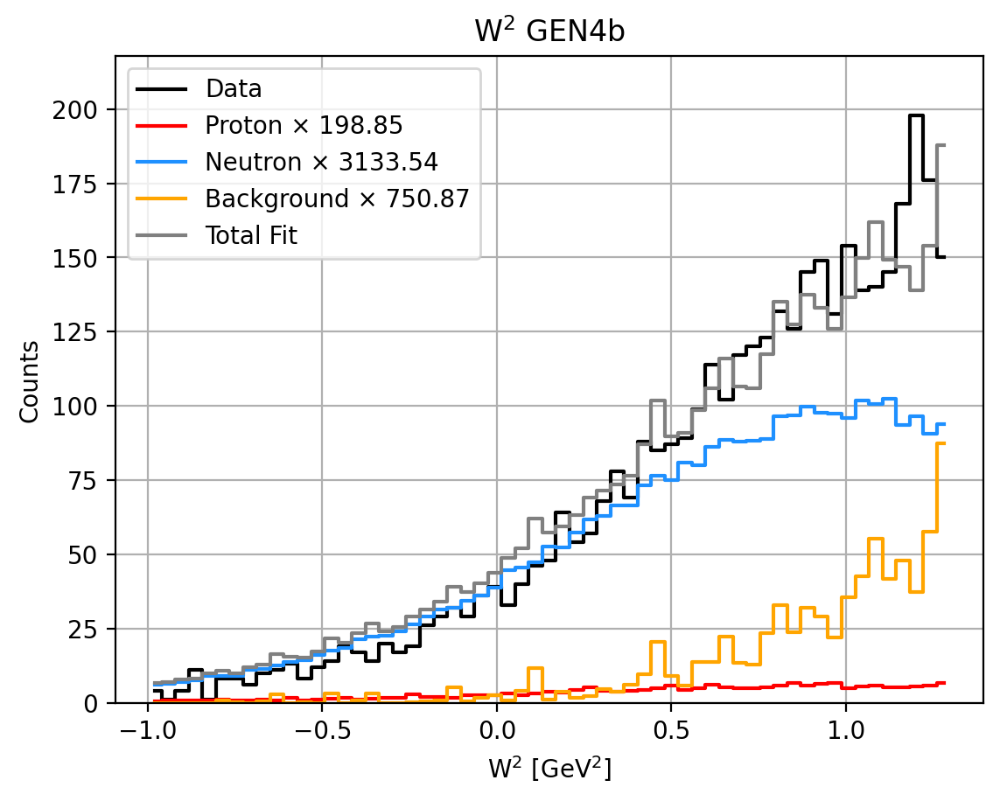

0.8161106612225352 0.051788417971453414 0.7643222432510818 0.18388933877746488


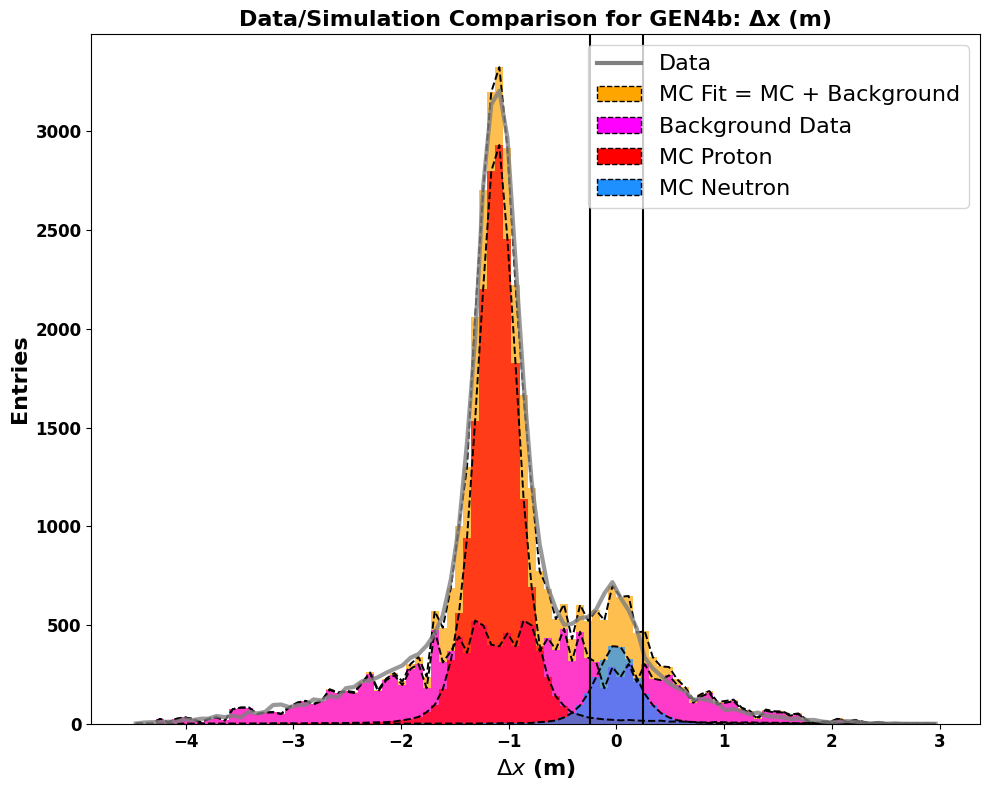

Total entries in fit: 38255.51829497147


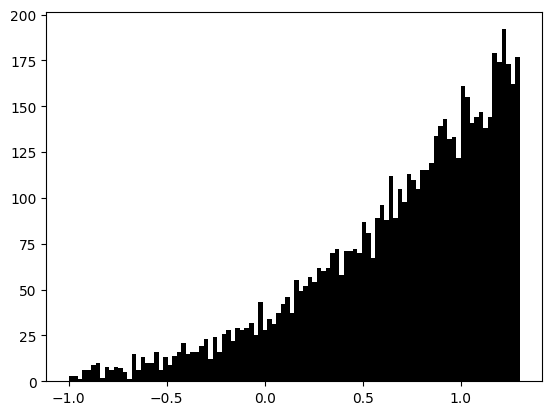

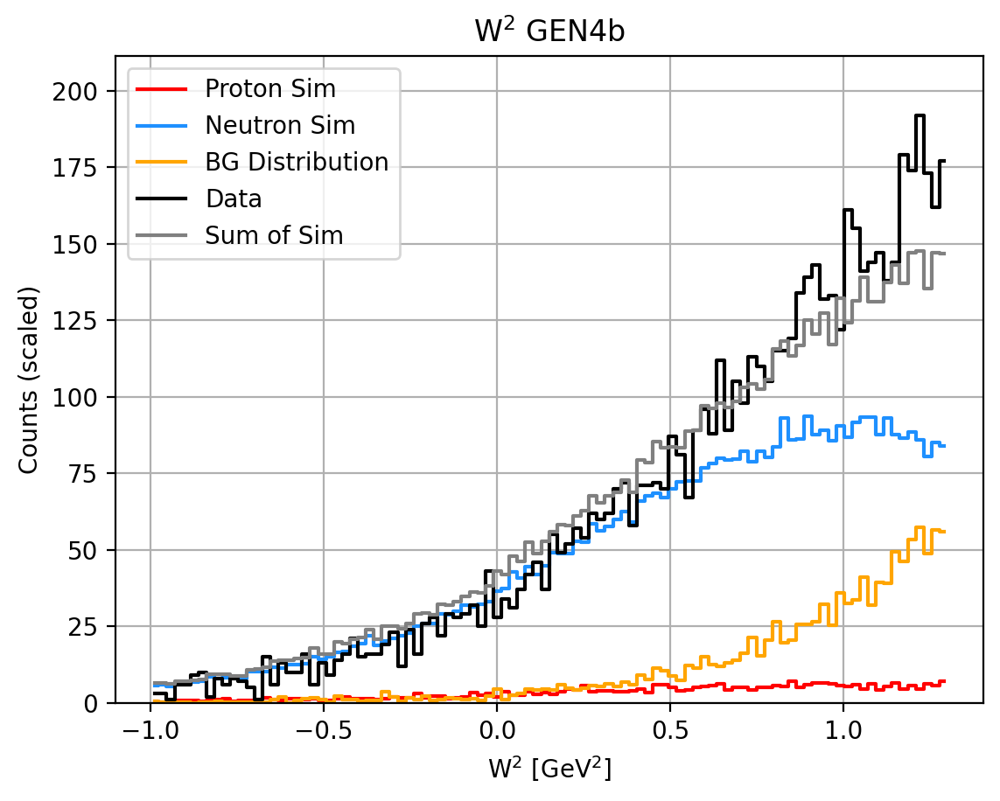

196398 196752
Total events in range (-0.25, 0.25):
  Sim Proton:   120.58
  Sim Neutron:  1900.17
  Background:   1526.80
  Total:        3651.00
Fraction of events in range (-0.25, 0.25):
   Proton Fraction: 0.05
   Background Fraction: 0.18
   W2 Background Fraction: 0.18
   Neutron Fraction: 0.76
__________________________________________________
Target Weighted Avg: 0.379+-0.0214  5.6335%
Beam Weighted Avg: 0.808+-0.0010  0.1201%
__________________________________________________
epsilon = 0.5686
tau_avg = 2.8127
Q2 = 9.9321
Px: 0.9902 Pz: -0.0322
A = 0.03322 ± 0.01436 ± 0.00201
B = 0.41354 (no propagated error)
C = 0.13788 ± 0.07104 ± 0.00994
__________________________________________________
N_plus: 1987 N_minus: 1878
A_raw: 0.0282+=0.0161
A_raw_weighted: 0.0357+-0.0155  43.3230%
__________________________________________________
A_phys_weighted: 0.164
A_phys_stat_error: 0.0710  43.2280%
A_phys_sys_error: 0.0099  6.046%
GEn/GMn*muN: 0.65498+--0.34740+--0.04859
Relative Error: 53.

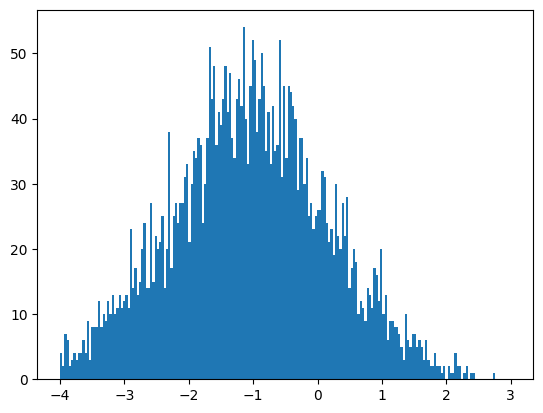

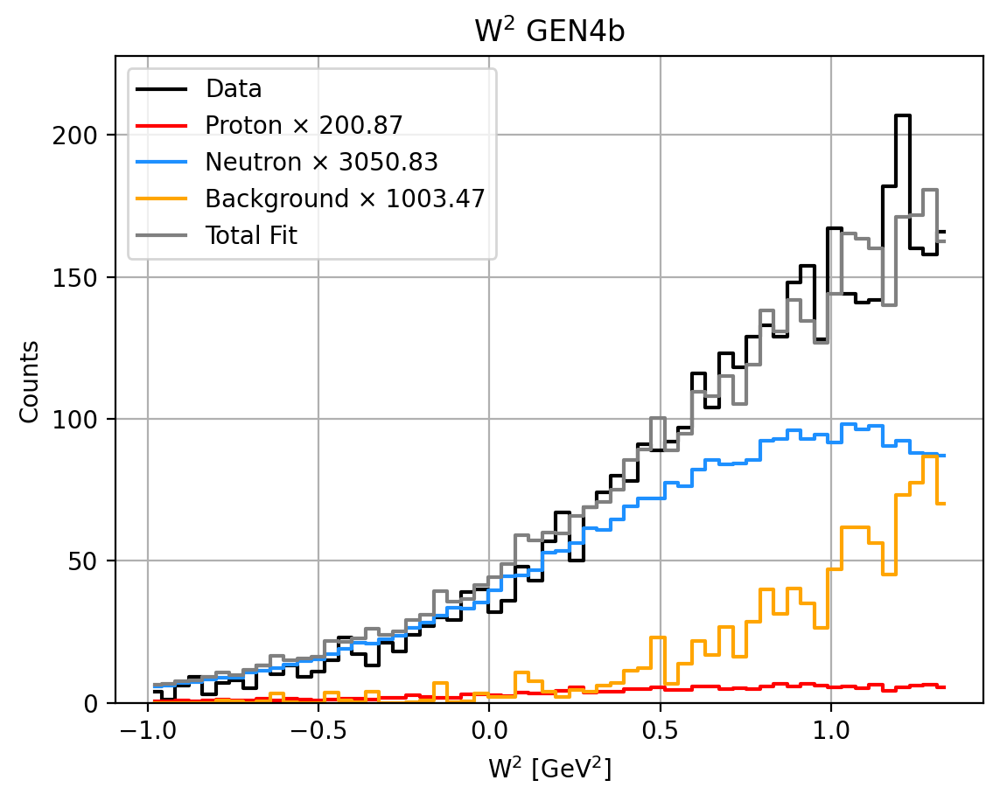

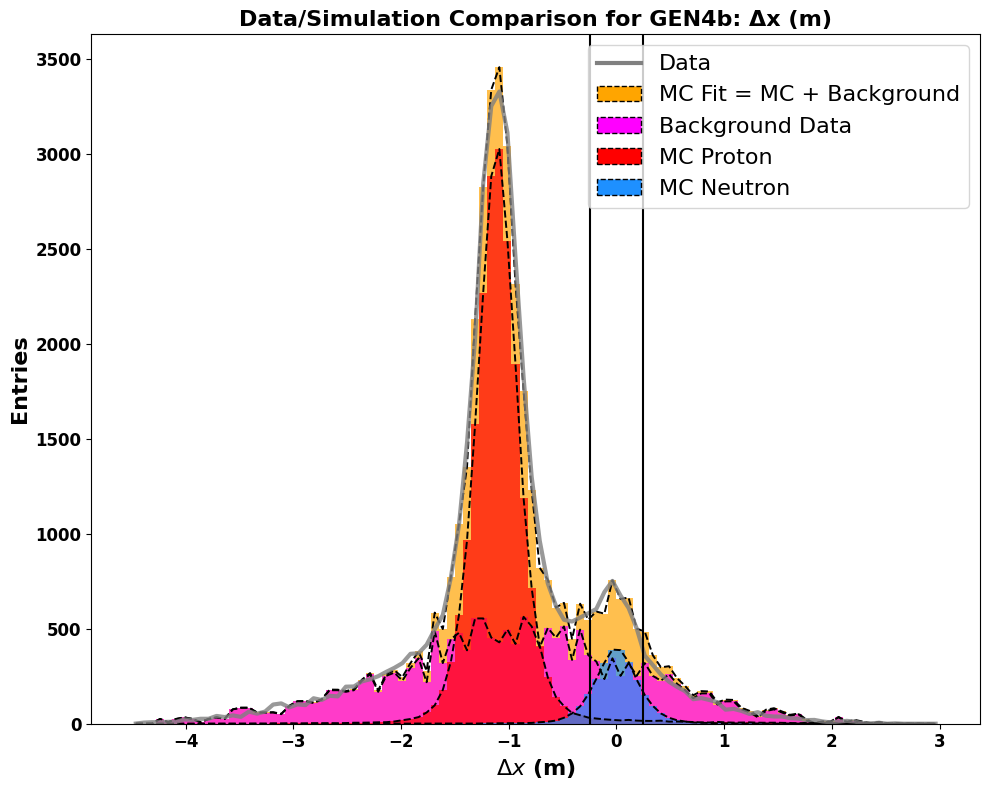

Total entries in fit: 40362.91977525109


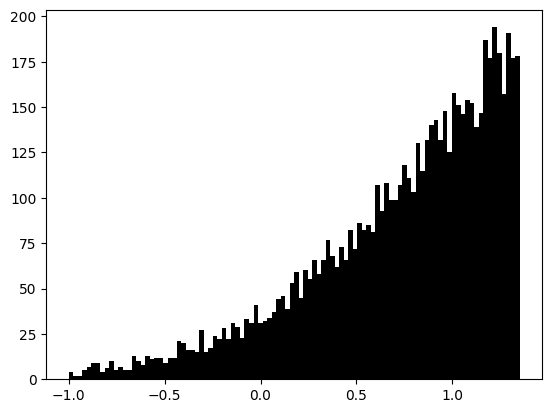

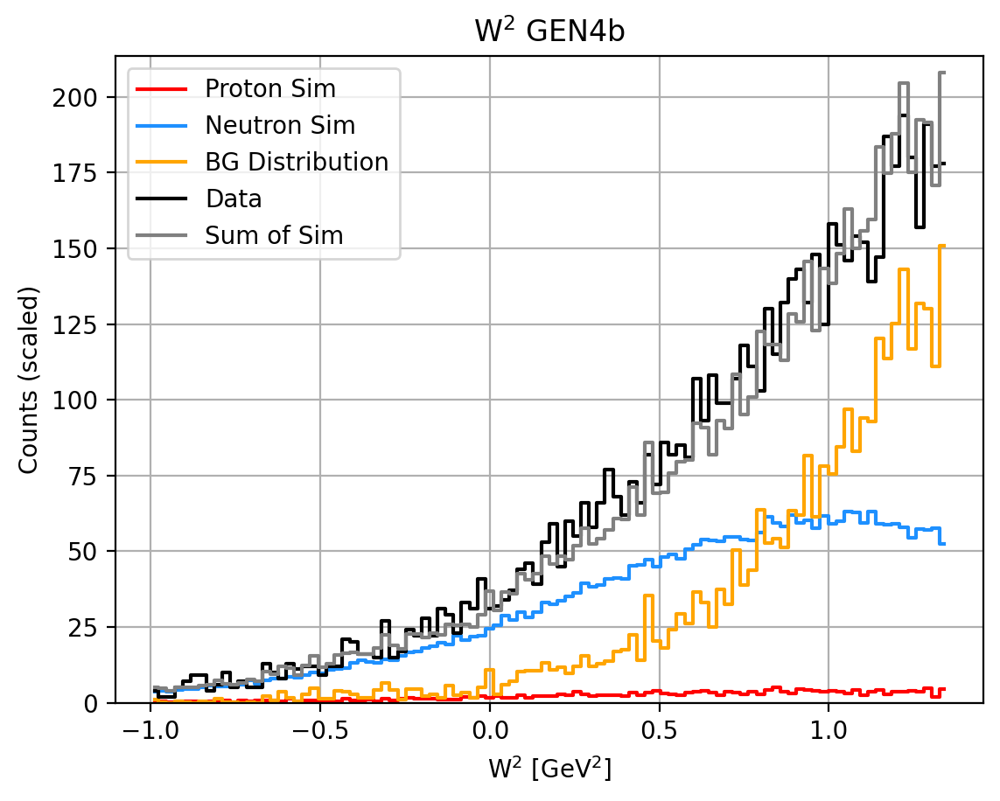

196398 196752
Total events in range (-0.25, 0.25):
  Sim Proton:   124.52
  Sim Neutron:  1891.21
  Background:   1730.18
  Total:        3835.00
Fraction of events in range (-0.25, 0.25):
   Proton Fraction: 0.03
   Background Fraction: 0.45
   W2 Background Fraction: 0.24
   Neutron Fraction: 0.49
__________________________________________________
Target Weighted Avg: 0.379+-0.0213  5.6290%
Beam Weighted Avg: 0.808+-0.0010  0.1201%
__________________________________________________
epsilon = 0.5694
tau_avg = 2.8060
Q2 = 9.9082
Px: 0.9903 Pz: -0.0315
A = 0.03884 ± 0.02087 ± 0.00264
B = 0.41397 (no propagated error)
C = 0.16546 ± 0.10285 ± 0.01300
__________________________________________________
N_plus: 2084 N_minus: 1980
A_raw: 0.0256+=0.0157
A_raw_weighted: 0.0274+-0.0151  55.2070%
__________________________________________________
A_phys_weighted: 0.191
A_phys_stat_error: 0.1029  53.7390%
A_phys_sys_error: 0.0130  6.794%
GEn/GMn*muN: 0.79455+--0.51510+--0.06512
Relative Error: 65.

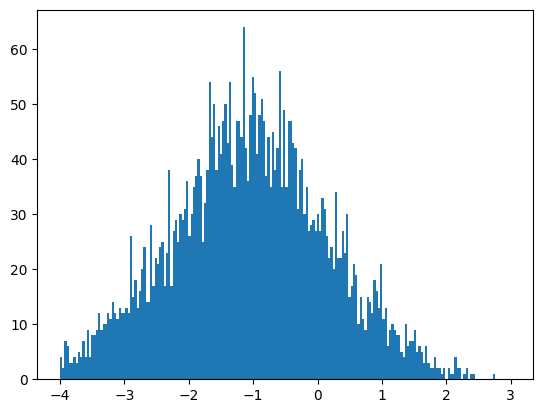

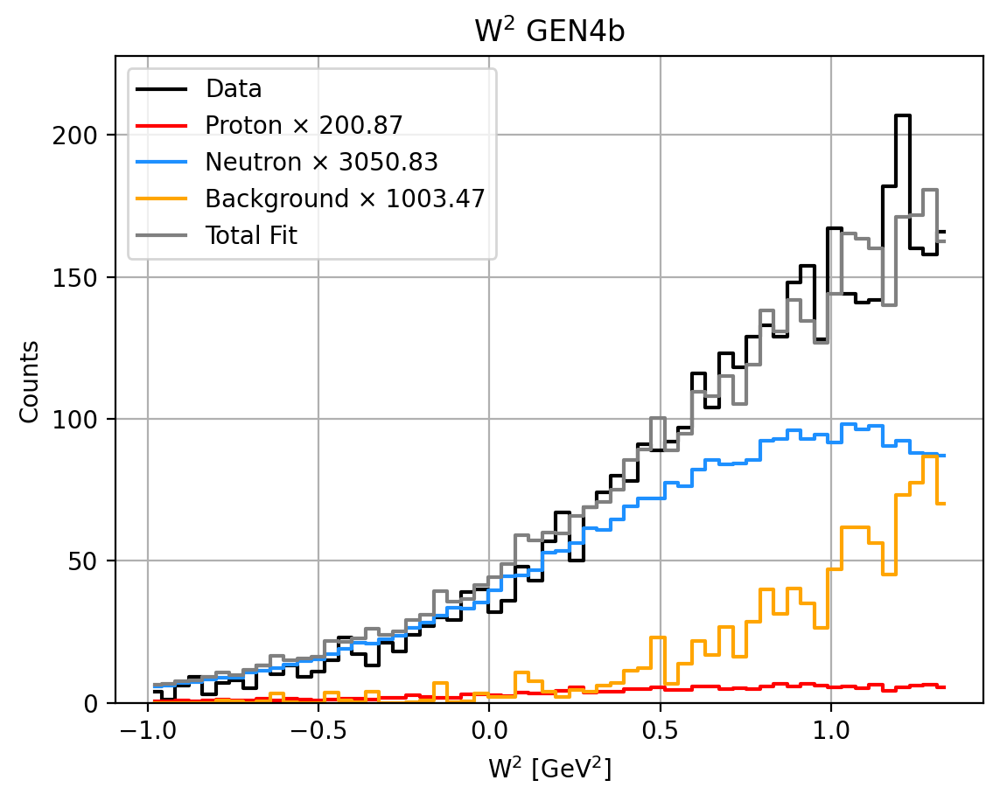

0.7641769052518604 0.050315196925248946 0.7138617083266114 0.23582309474813956


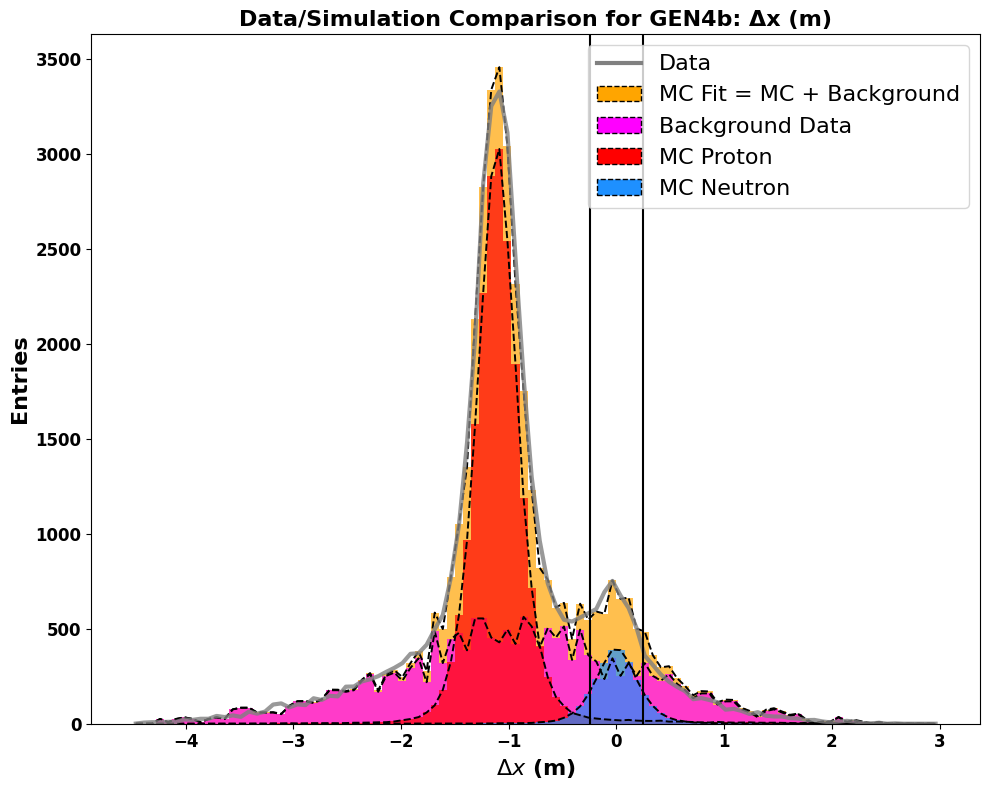

Total entries in fit: 40362.91977525109


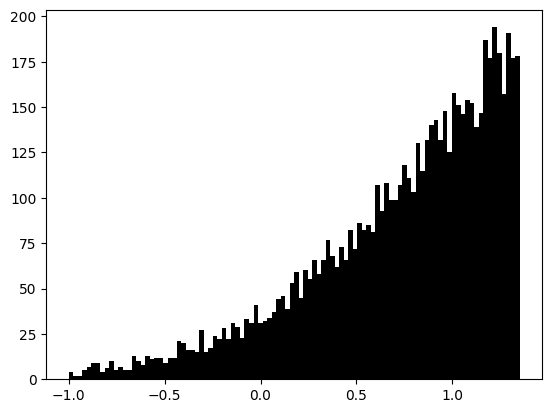

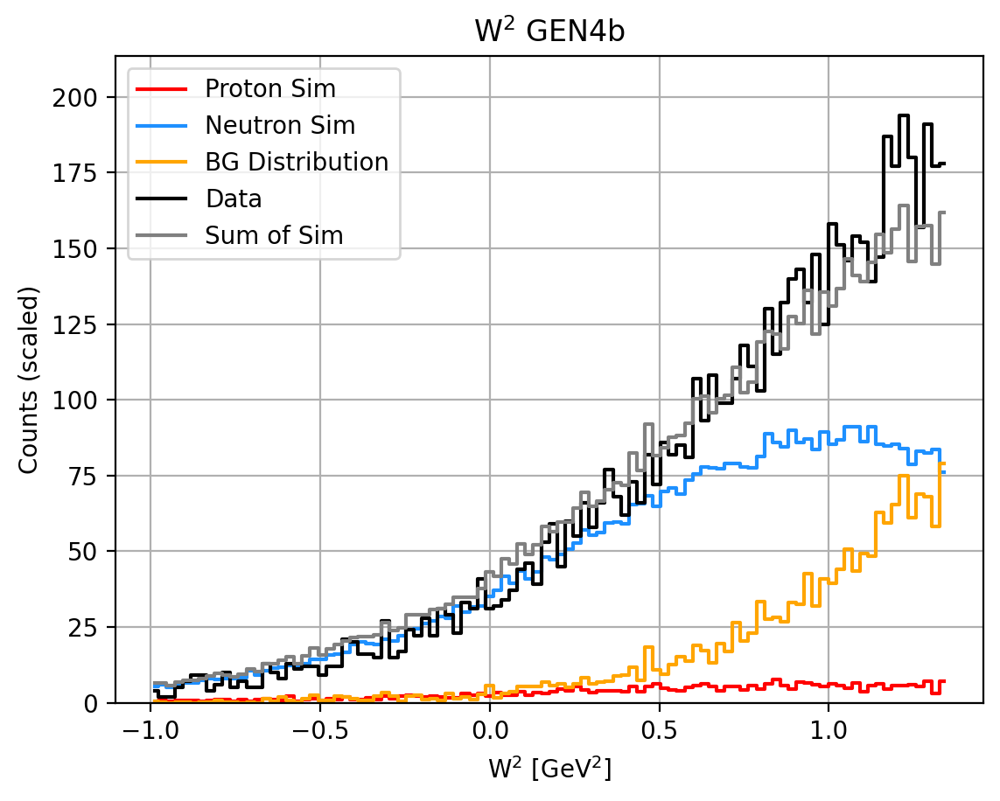

196398 196752
Total events in range (-0.25, 0.25):
  Sim Proton:   124.52
  Sim Neutron:  1891.21
  Background:   1730.18
  Total:        3835.00
Fraction of events in range (-0.25, 0.25):
   Proton Fraction: 0.05
   Background Fraction: 0.24
   W2 Background Fraction: 0.24
   Neutron Fraction: 0.71
__________________________________________________
Target Weighted Avg: 0.379+-0.0213  5.6290%
Beam Weighted Avg: 0.808+-0.0010  0.1201%
__________________________________________________
epsilon = 0.5694
tau_avg = 2.8060
Q2 = 9.9082
Px: 0.9903 Pz: -0.0315
A = 0.02790 ± 0.01510 ± 0.00174
B = 0.41397 (no propagated error)
C = 0.11159 ± 0.07440 ± 0.00856
__________________________________________________
N_plus: 2084 N_minus: 1980
A_raw: 0.0256+=0.0157
A_raw_weighted: 0.0274+-0.0151  55.2070%
__________________________________________________
A_phys_weighted: 0.138
A_phys_stat_error: 0.0744  54.1031%
A_phys_sys_error: 0.0086  6.227%
GEn/GMn*muN: 0.52463+--0.35655+--0.04103
Relative Error: 68.

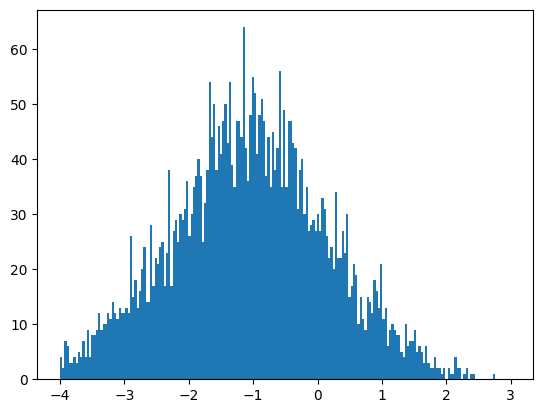

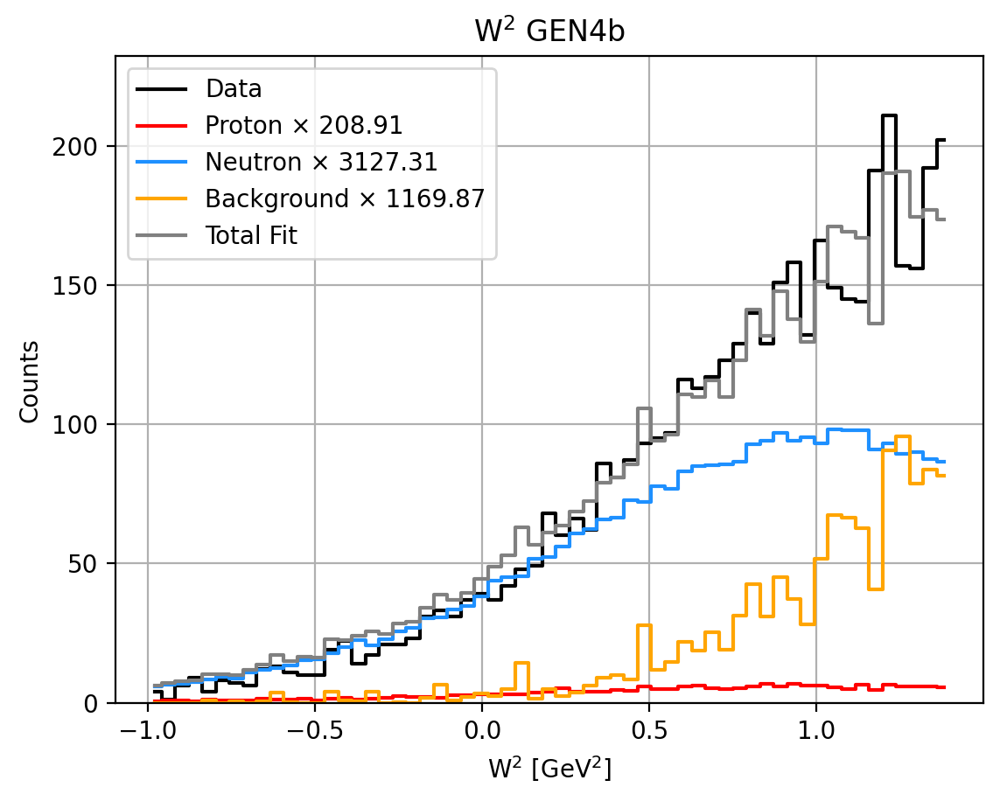

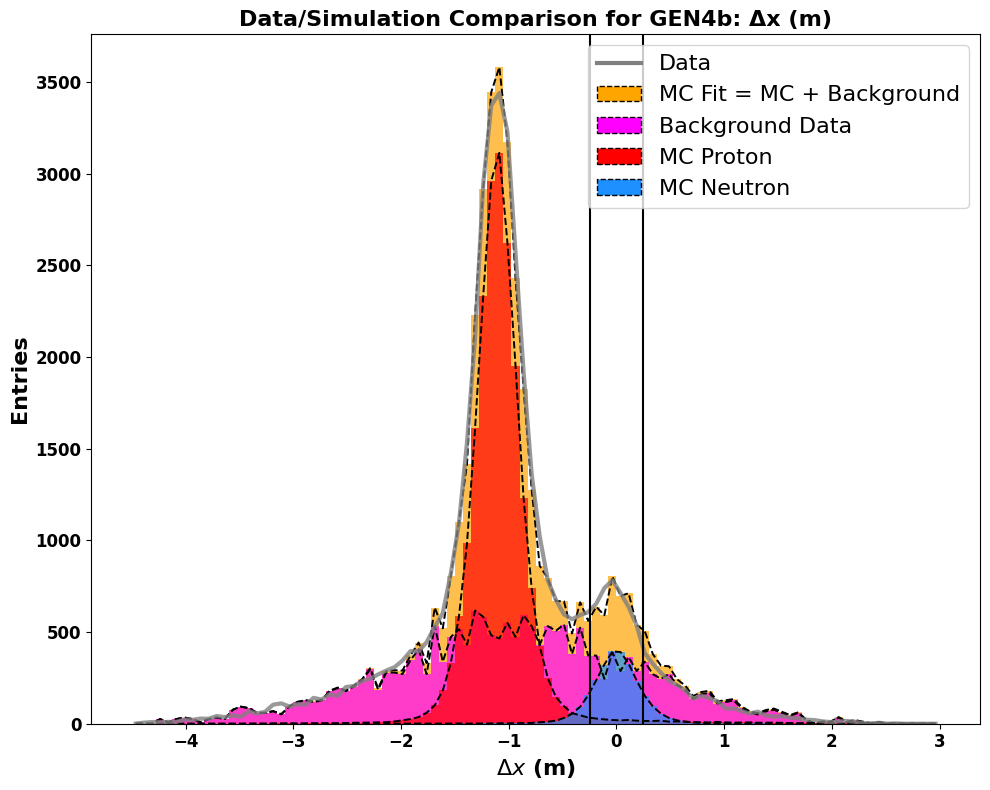

Total entries in fit: 42430.65019600281


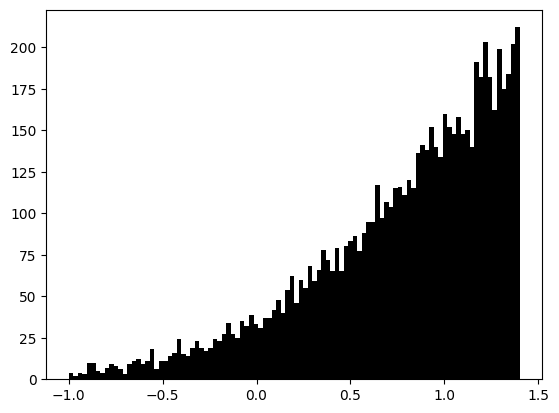

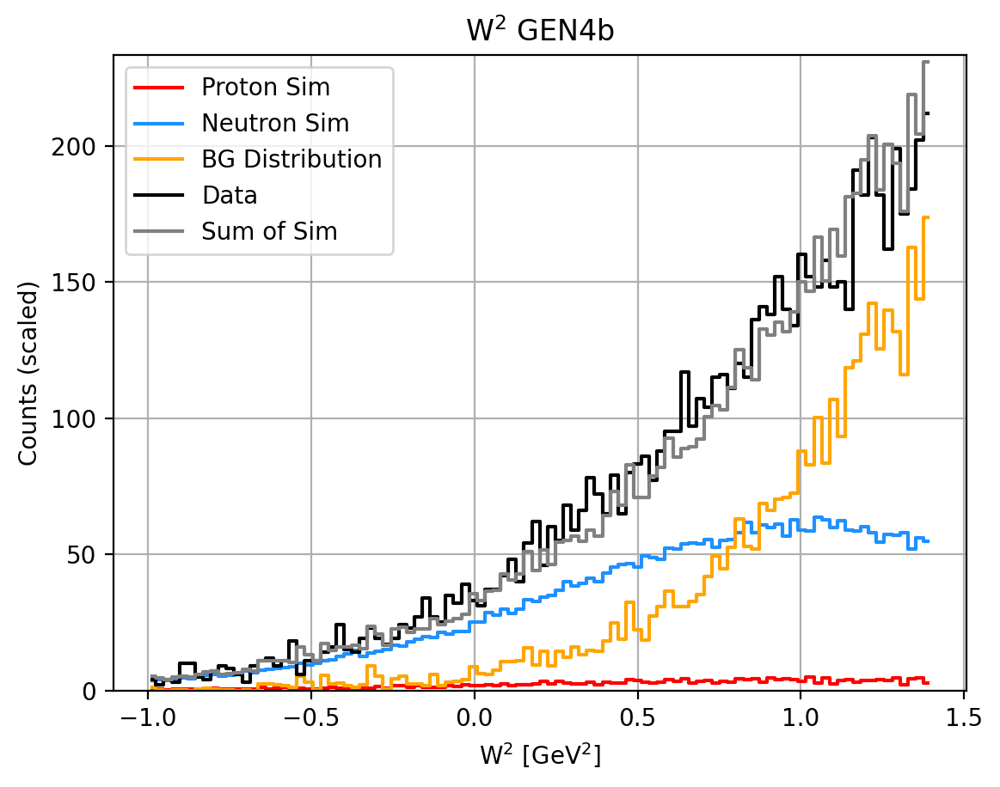

196398 196752
Total events in range (-0.25, 0.25):
  Sim Proton:   127.57
  Sim Neutron:  1909.68
  Background:   1944.09
  Total:        4063.00
Fraction of events in range (-0.25, 0.25):
   Proton Fraction: 0.03
   Background Fraction: 0.48
   W2 Background Fraction: 0.26
   Neutron Fraction: 0.47
__________________________________________________
Target Weighted Avg: 0.378+-0.0213  5.6342%
Beam Weighted Avg: 0.808+-0.0010  0.1201%
__________________________________________________
epsilon = 0.5705
tau_avg = 2.7970
Q2 = 9.8767
Px: 0.9903 Pz: -0.0309
A = 0.04789 ± 0.02144 ± 0.00323
B = 0.41451 (no propagated error)
C = 0.20939 ± 0.10511 ± 0.01583
__________________________________________________
N_plus: 2225 N_minus: 2088
A_raw: 0.0318+=0.0152
A_raw_weighted: 0.033+-0.0147  44.3821%
__________________________________________________
A_phys_weighted: 0.235
A_phys_stat_error: 0.1051  44.7742%
A_phys_sys_error: 0.0158  6.744%
GEn/GMn*muN: 1.02904+--0.55422+--0.08348
Relative Error: 54.4

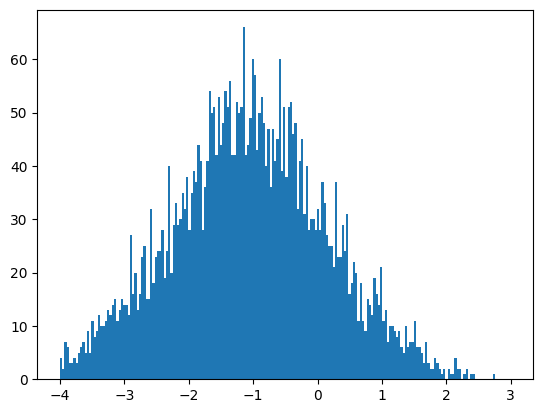

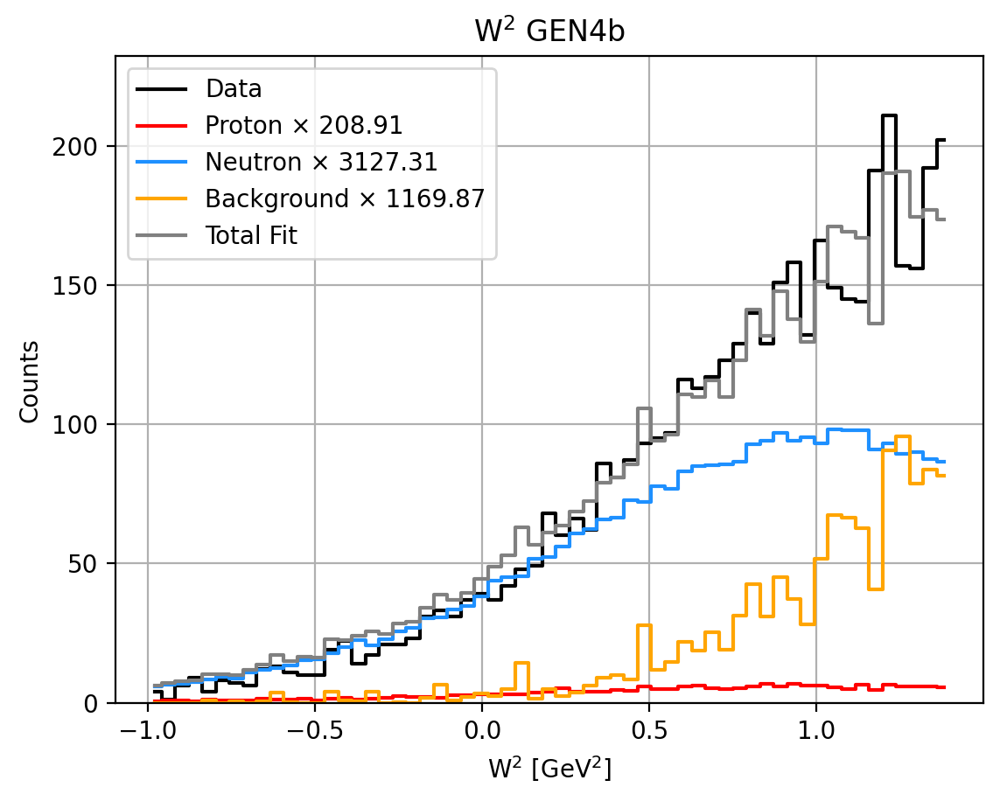

0.7403793549836373 0.049457521180578945 0.6909218338030583 0.25962064501636267


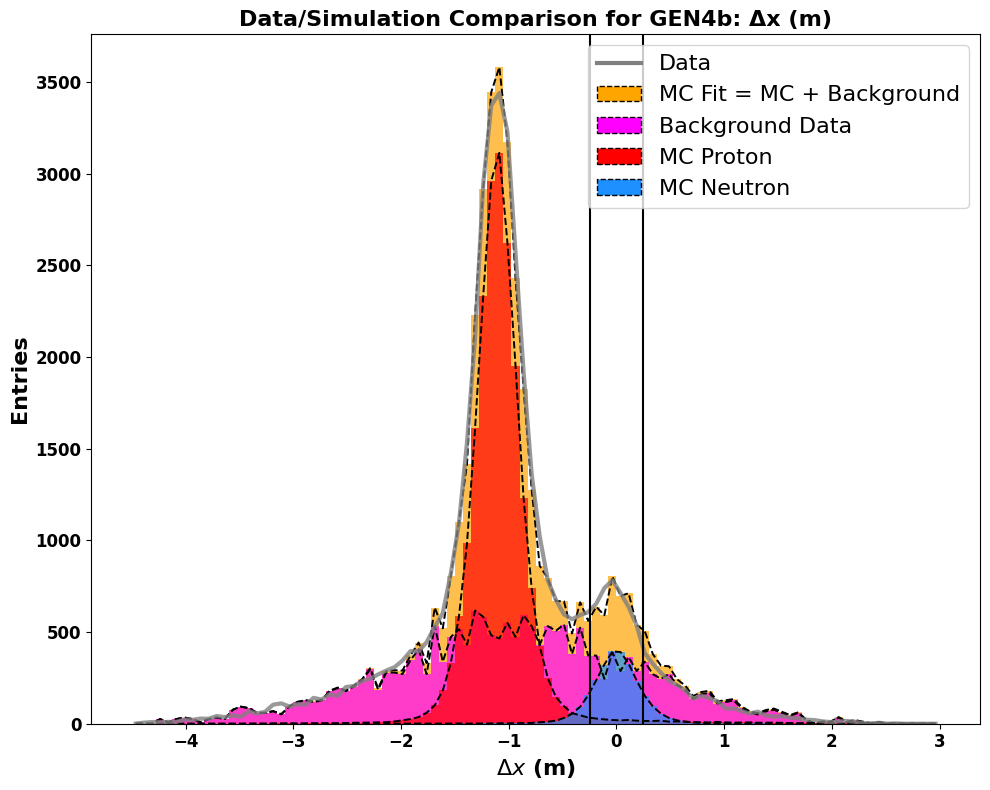

Total entries in fit: 42430.65019600281


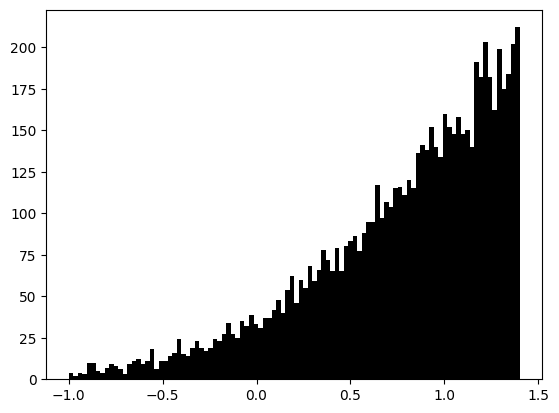

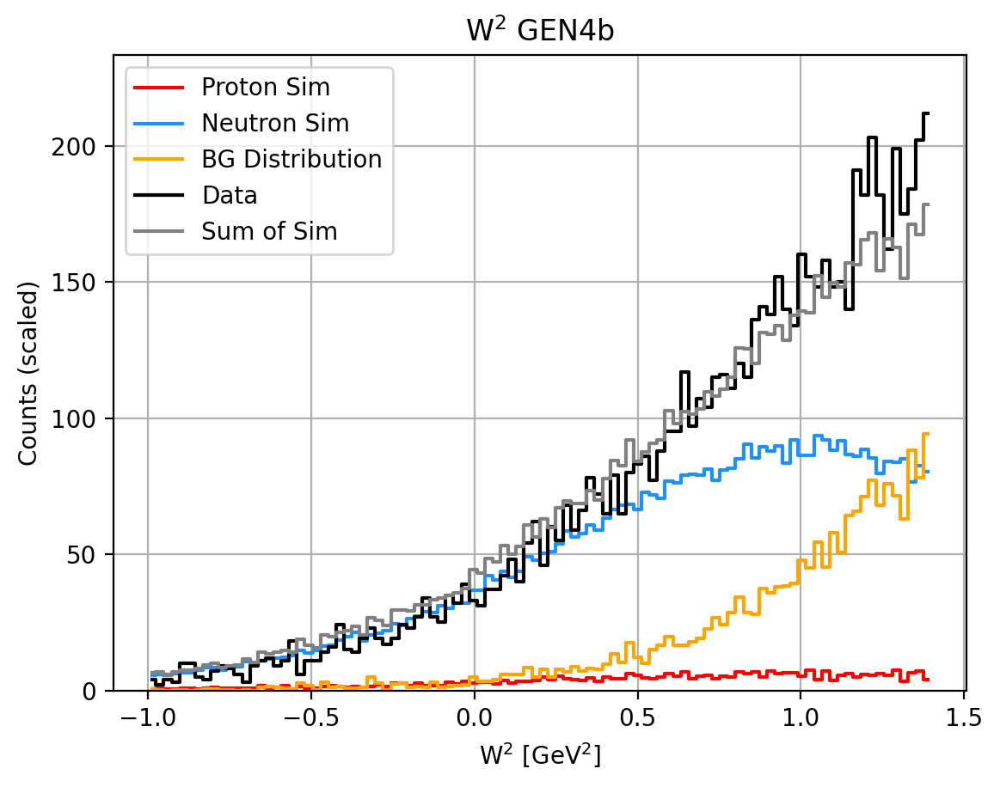

196398 196752
Total events in range (-0.25, 0.25):
  Sim Proton:   127.57
  Sim Neutron:  1909.68
  Background:   1944.09
  Total:        4063.00
Fraction of events in range (-0.25, 0.25):
   Proton Fraction: 0.05
   Background Fraction: 0.26
   W2 Background Fraction: 0.26
   Neutron Fraction: 0.69
__________________________________________________
Target Weighted Avg: 0.378+-0.0213  5.6342%
Beam Weighted Avg: 0.808+-0.0010  0.1201%
__________________________________________________
epsilon = 0.5705
tau_avg = 2.7970
Q2 = 9.8767
Px: 0.9903 Pz: -0.0309
A = 0.03377 ± 0.01521 ± 0.00209
B = 0.41451 (no propagated error)
C = 0.14019 ± 0.07456 ± 0.01024
__________________________________________________
N_plus: 2225 N_minus: 2088
A_raw: 0.0318+=0.0152
A_raw_weighted: 0.033+-0.0147  44.3821%
__________________________________________________
A_phys_weighted: 0.166
A_phys_stat_error: 0.0746  45.0391%
A_phys_sys_error: 0.0102  6.186%
GEn/GMn*muN: 0.66491+--0.36438+--0.05005
Relative Error: 55.3

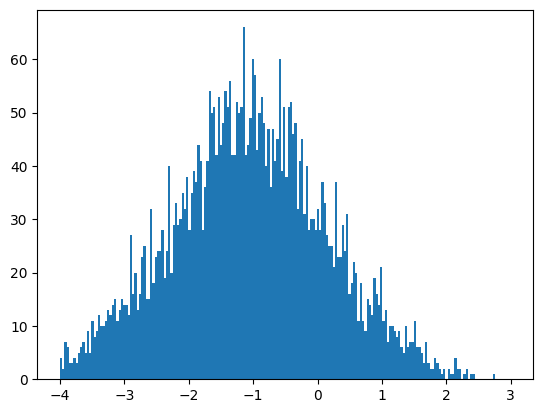

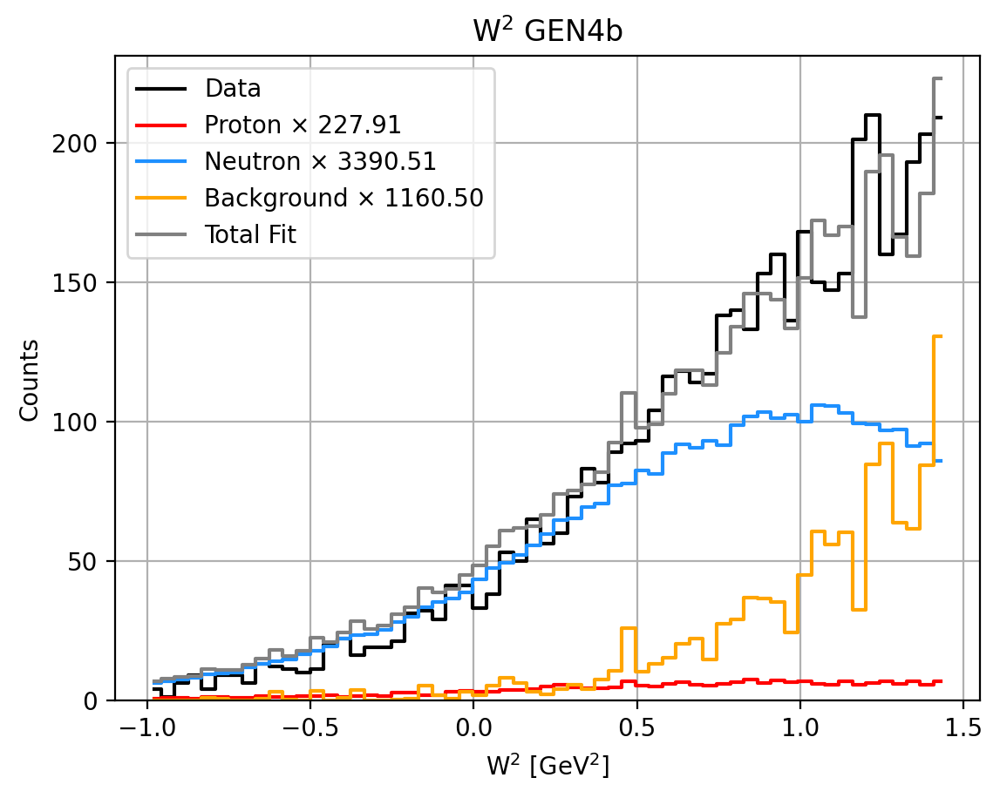

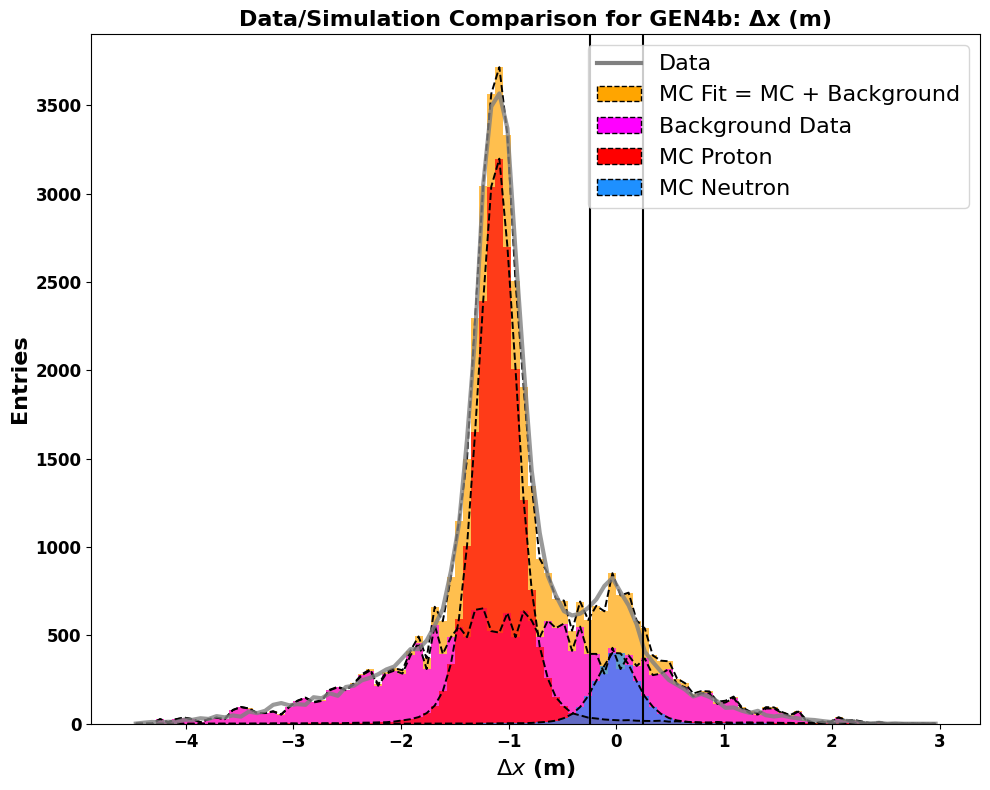

Total entries in fit: 44632.46235948241


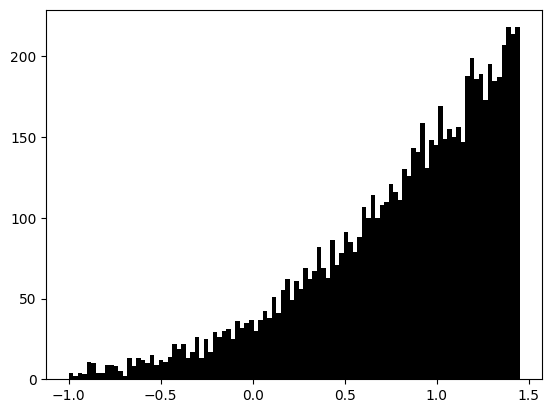

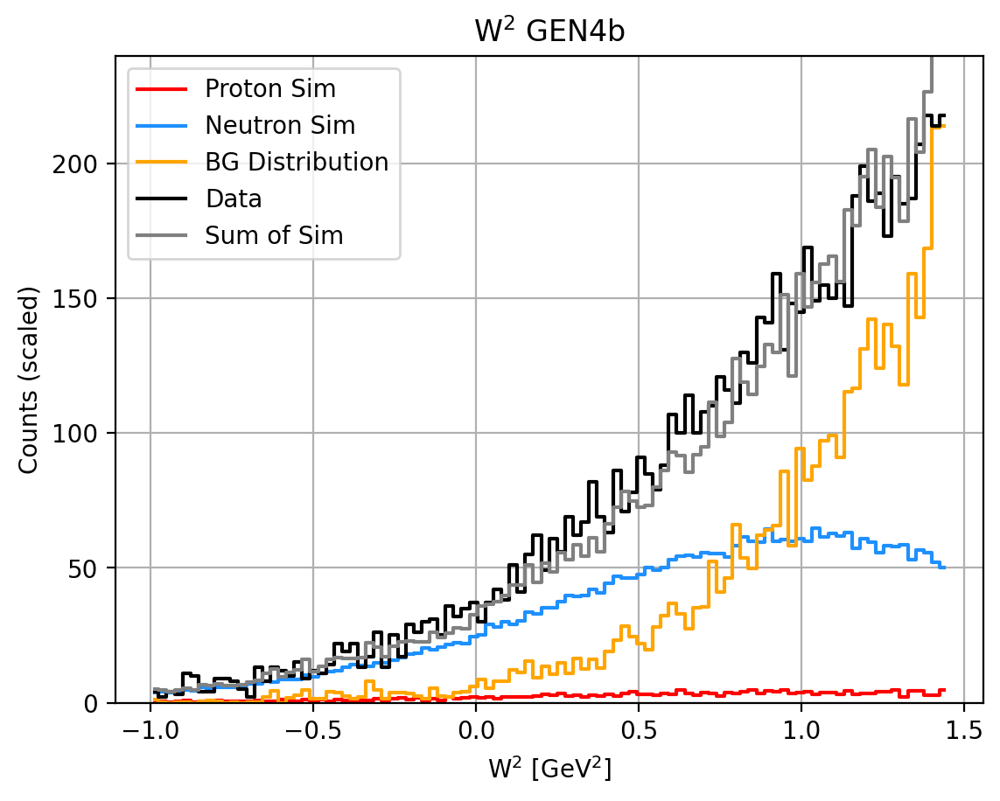

196398 196752
Total events in range (-0.25, 0.25):
  Sim Proton:   130.86
  Sim Neutron:  1946.69
  Background:   2131.20
  Total:        4286.00
Fraction of events in range (-0.25, 0.25):
   Proton Fraction: 0.03
   Background Fraction: 0.50
   W2 Background Fraction: 0.24
   Neutron Fraction: 0.45
__________________________________________________
Target Weighted Avg: 0.378+-0.0213  5.6261%
Beam Weighted Avg: 0.808+-0.0010  0.1201%
__________________________________________________
epsilon = 0.5713
tau_avg = 2.7895
Q2 = 9.8502
Px: 0.9904 Pz: -0.0301
A = 0.05153 ± 0.02171 ± 0.00349
B = 0.41501 (no propagated error)
C = 0.22685 ± 0.10600 ± 0.01706
__________________________________________________
N_plus: 2355 N_minus: 2203
A_raw: 0.0333+=0.0148
A_raw_weighted: 0.0342+-0.0142  41.6585%
__________________________________________________
A_phys_weighted: 0.252
A_phys_stat_error: 0.1060  42.1338%
A_phys_sys_error: 0.0171  6.78%
GEn/GMn*muN: 1.12670+--0.57309+--0.09221
Relative Error: 51.5

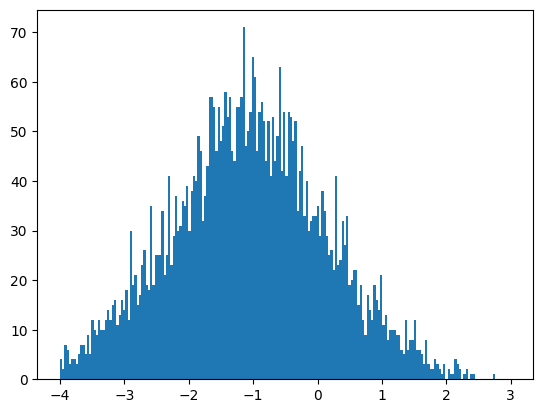

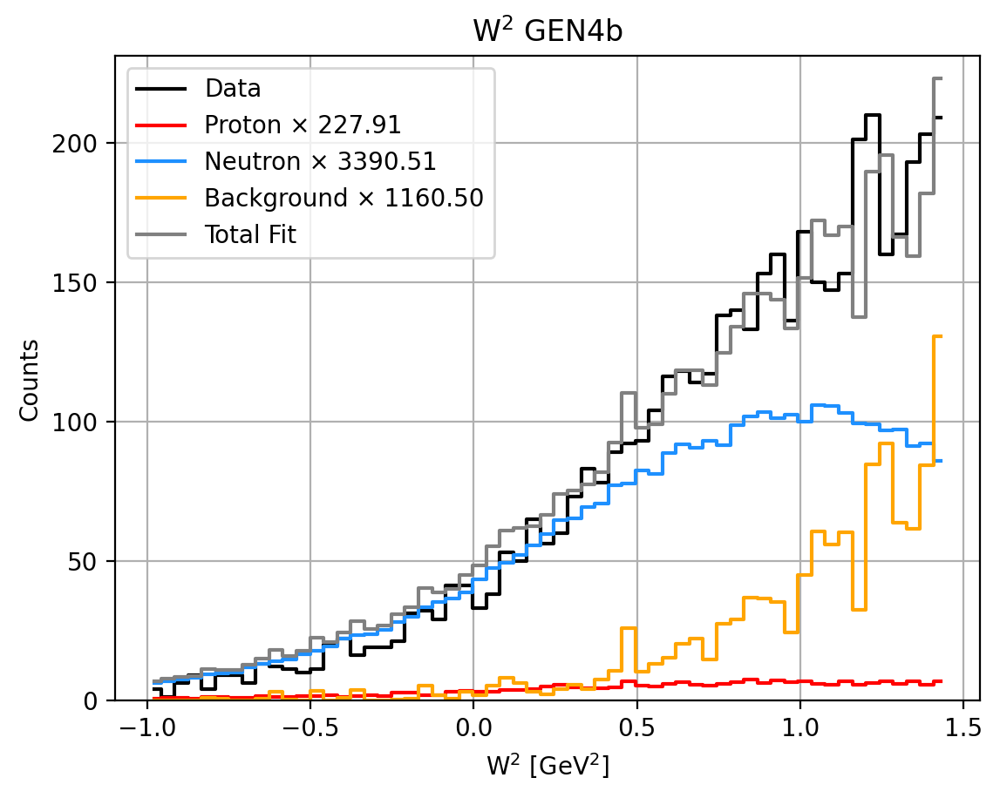

0.7571630259774088 0.05089749010516489 0.7062655358722439 0.2428369740225912


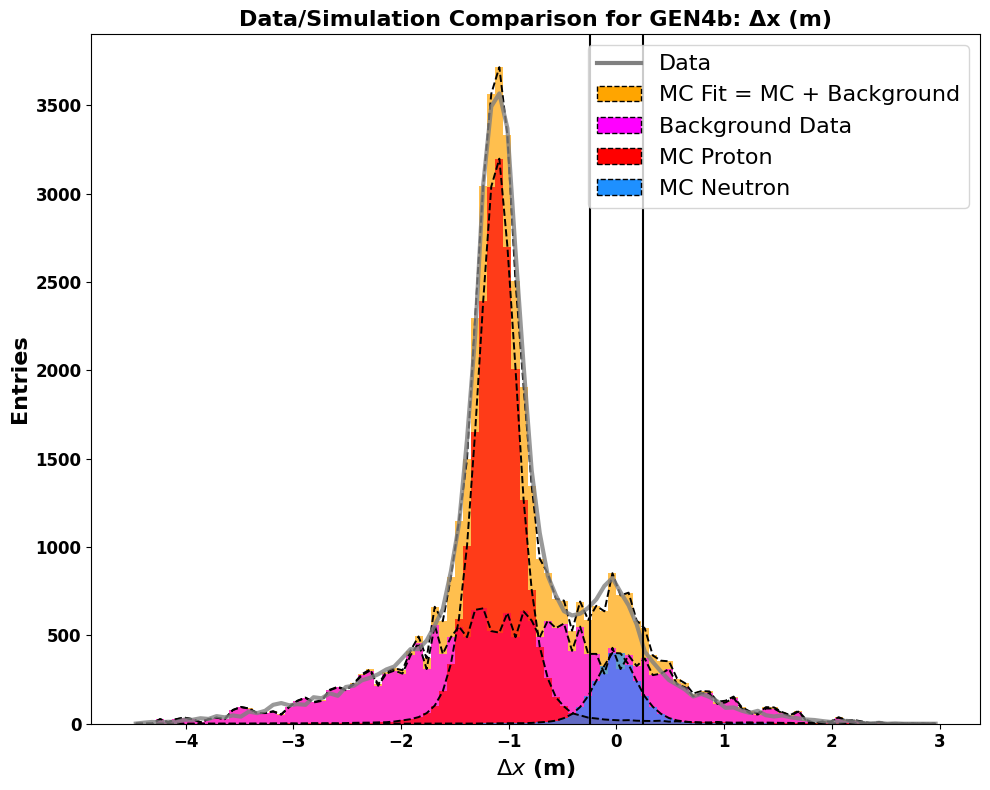

Total entries in fit: 44632.46235948241


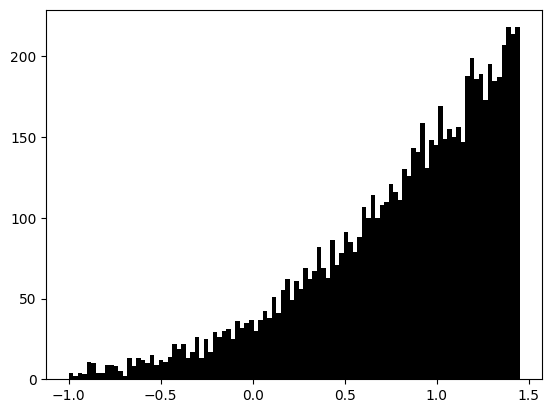

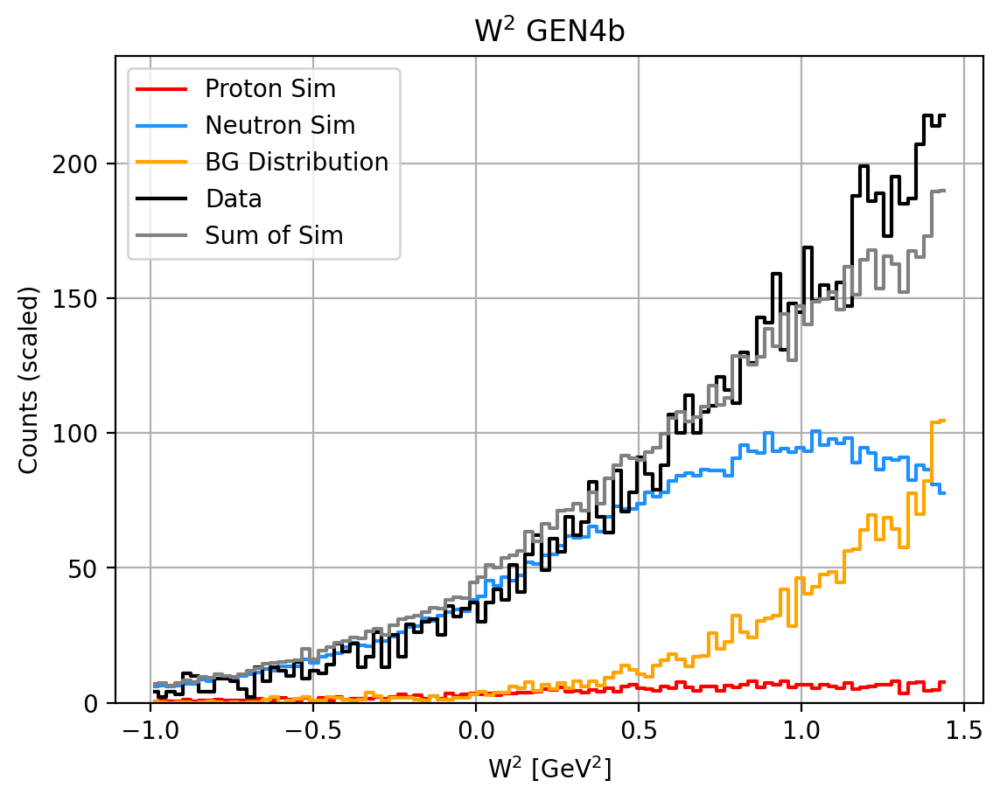

196398 196752
Total events in range (-0.25, 0.25):
  Sim Proton:   130.86
  Sim Neutron:  1946.69
  Background:   2131.20
  Total:        4286.00
Fraction of events in range (-0.25, 0.25):
   Proton Fraction: 0.05
   Background Fraction: 0.24
   W2 Background Fraction: 0.24
   Neutron Fraction: 0.71
__________________________________________________
Target Weighted Avg: 0.378+-0.0213  5.6261%
Beam Weighted Avg: 0.808+-0.0010  0.1201%
__________________________________________________
epsilon = 0.5713
tau_avg = 2.7895
Q2 = 9.8502
Px: 0.9904 Pz: -0.0301
A = 0.03422 ± 0.01452 ± 0.00210
B = 0.41501 (no propagated error)
C = 0.14237 ± 0.07087 ± 0.01026
__________________________________________________
N_plus: 2355 N_minus: 2203
A_raw: 0.0333+=0.0148
A_raw_weighted: 0.0342+-0.0142  41.6585%
__________________________________________________
A_phys_weighted: 0.167
A_phys_stat_error: 0.0709  42.4153%
A_phys_sys_error: 0.0103  6.141%
GEn/GMn*muN: 0.67498+--0.34653+--0.05017
Relative Error: 51.

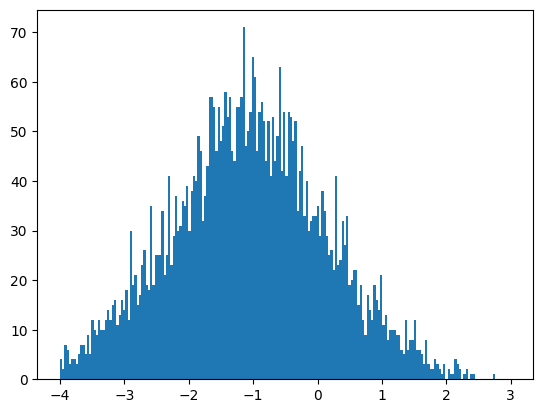

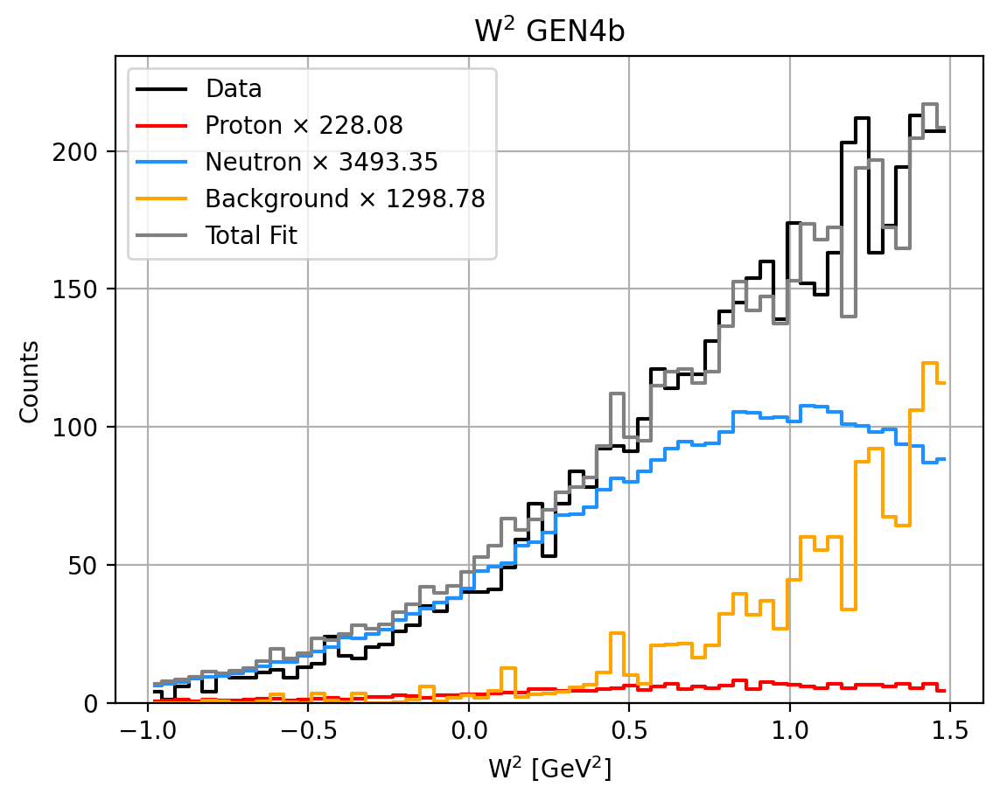

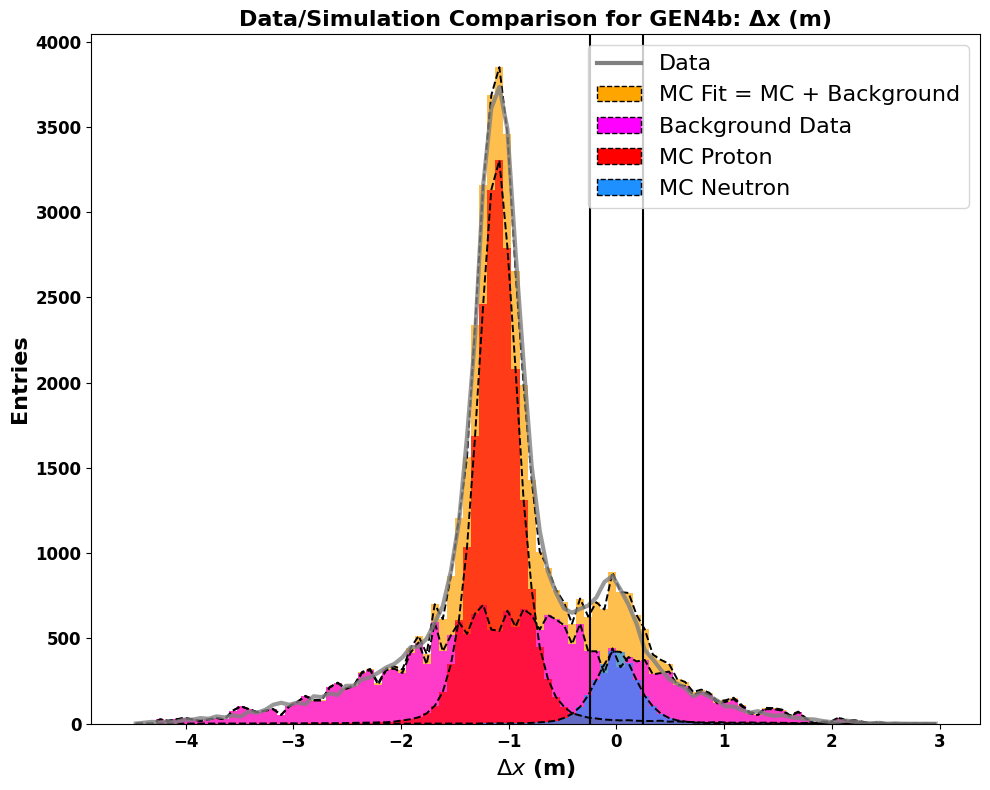

Total entries in fit: 46866.916568428474


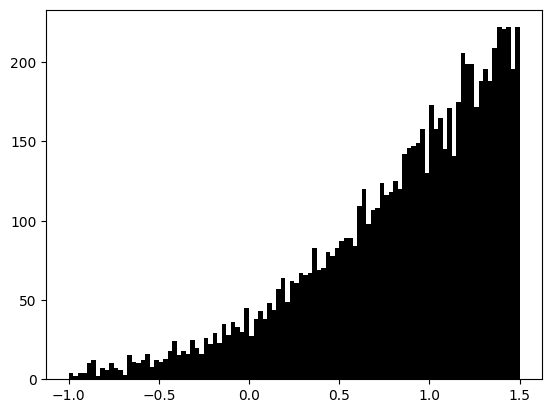

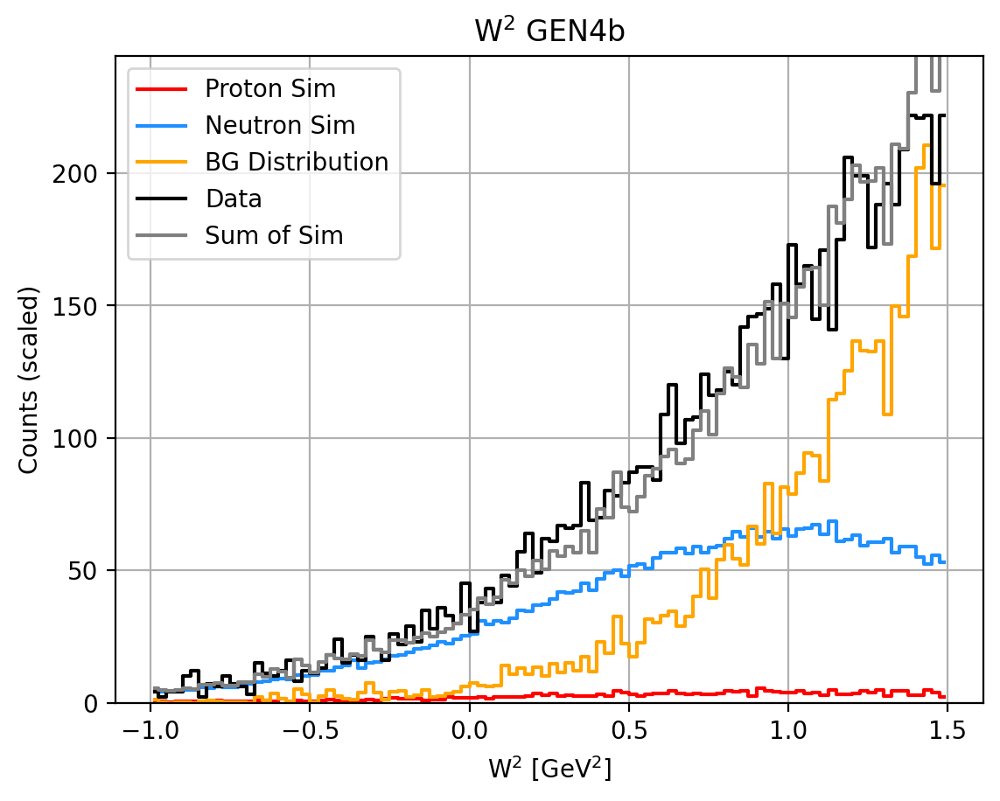

196398 196752
Total events in range (-0.25, 0.25):
  Sim Proton:   134.48
  Sim Neutron:  2059.76
  Background:   2252.48
  Total:        4506.00
Fraction of events in range (-0.25, 0.25):
   Proton Fraction: 0.03
   Background Fraction: 0.50
   W2 Background Fraction: 0.26
   Neutron Fraction: 0.46
__________________________________________________
Target Weighted Avg: 0.378+-0.0213  5.6316%
Beam Weighted Avg: 0.808+-0.0010  0.1201%
__________________________________________________
epsilon = 0.5722
tau_avg = 2.7820
Q2 = 9.8237
Px: 0.9904 Pz: -0.0295
A = 0.05406 ± 0.02136 ± 0.00364
B = 0.41547 (no propagated error)
C = 0.23867 ± 0.10387 ± 0.01768
__________________________________________________
N_plus: 2474 N_minus: 2321
A_raw: 0.0319+=0.0144
A_raw_weighted: 0.0351+-0.0139  39.5224%
__________________________________________________
A_phys_weighted: 0.263
A_phys_stat_error: 0.1039  39.5172%
A_phys_sys_error: 0.0177  6.727%
GEn/GMn*muN: 1.19459+--0.57224+--0.09741
Relative Error: 48.

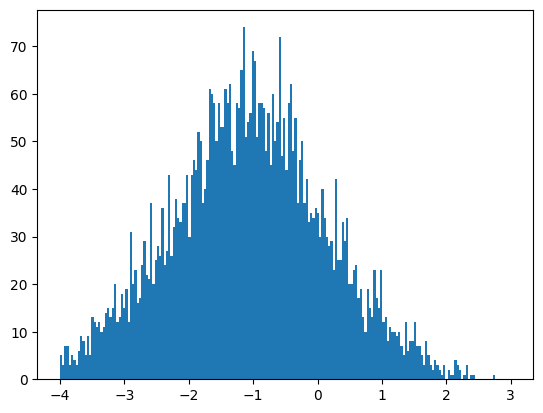

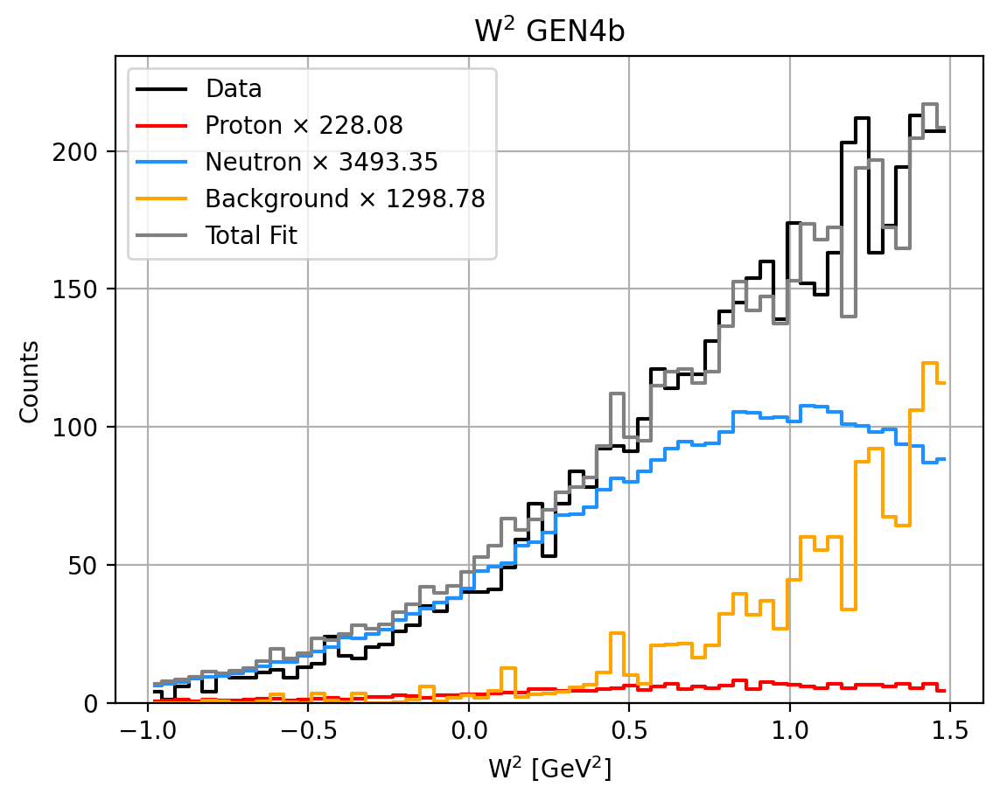

0.7412902855884661 0.04839896605703859 0.6928913195314275 0.25870971441153384


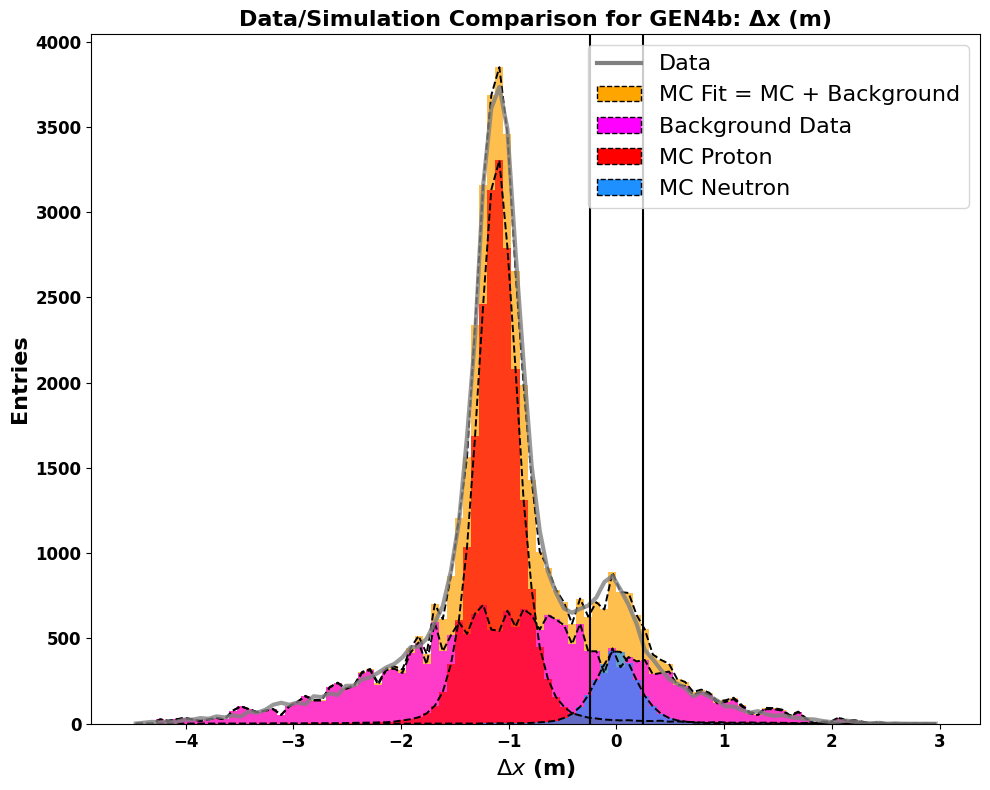

Total entries in fit: 46866.916568428474


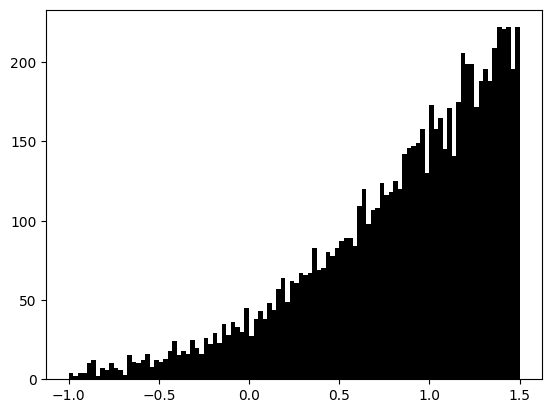

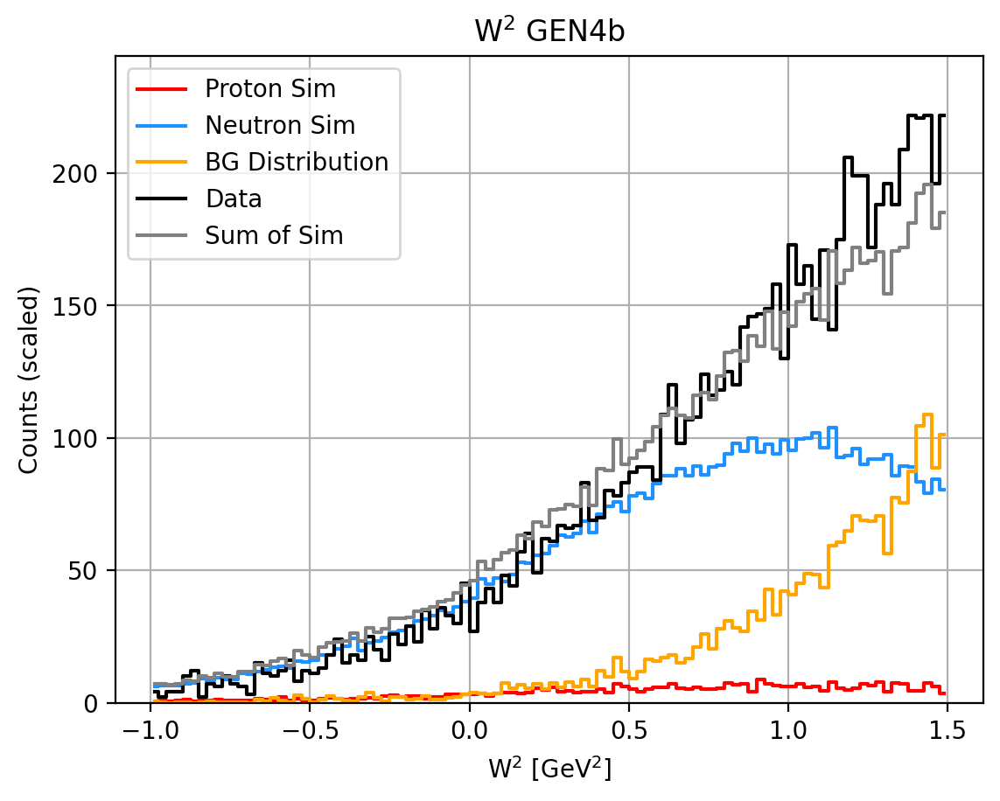

196398 196752
Total events in range (-0.25, 0.25):
  Sim Proton:   134.48
  Sim Neutron:  2059.76
  Background:   2252.48
  Total:        4506.00
Fraction of events in range (-0.25, 0.25):
   Proton Fraction: 0.05
   Background Fraction: 0.26
   W2 Background Fraction: 0.26
   Neutron Fraction: 0.69
__________________________________________________
Target Weighted Avg: 0.378+-0.0213  5.6316%
Beam Weighted Avg: 0.808+-0.0010  0.1201%
__________________________________________________
epsilon = 0.5722
tau_avg = 2.7820
Q2 = 9.8237
Px: 0.9904 Pz: -0.0295
A = 0.03647 ± 0.01450 ± 0.00224
B = 0.41547 (no propagated error)
C = 0.15314 ± 0.07049 ± 0.01088
__________________________________________________
N_plus: 2474 N_minus: 2321
A_raw: 0.0319+=0.0144
A_raw_weighted: 0.0351+-0.0139  39.5224%
__________________________________________________
A_phys_weighted: 0.177
A_phys_stat_error: 0.0705  39.7581%
A_phys_sys_error: 0.0109  6.135%
GEn/GMn*muN: 0.72851+--0.34754+--0.05363
Relative Error: 48.

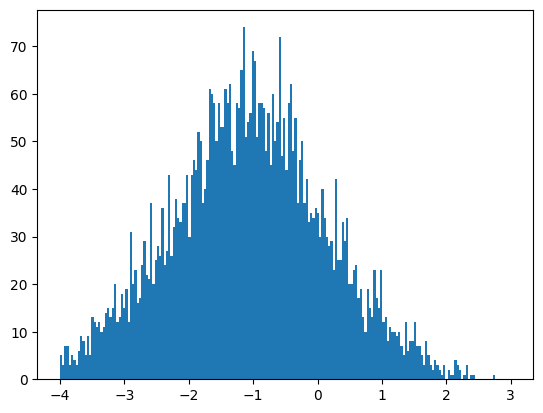

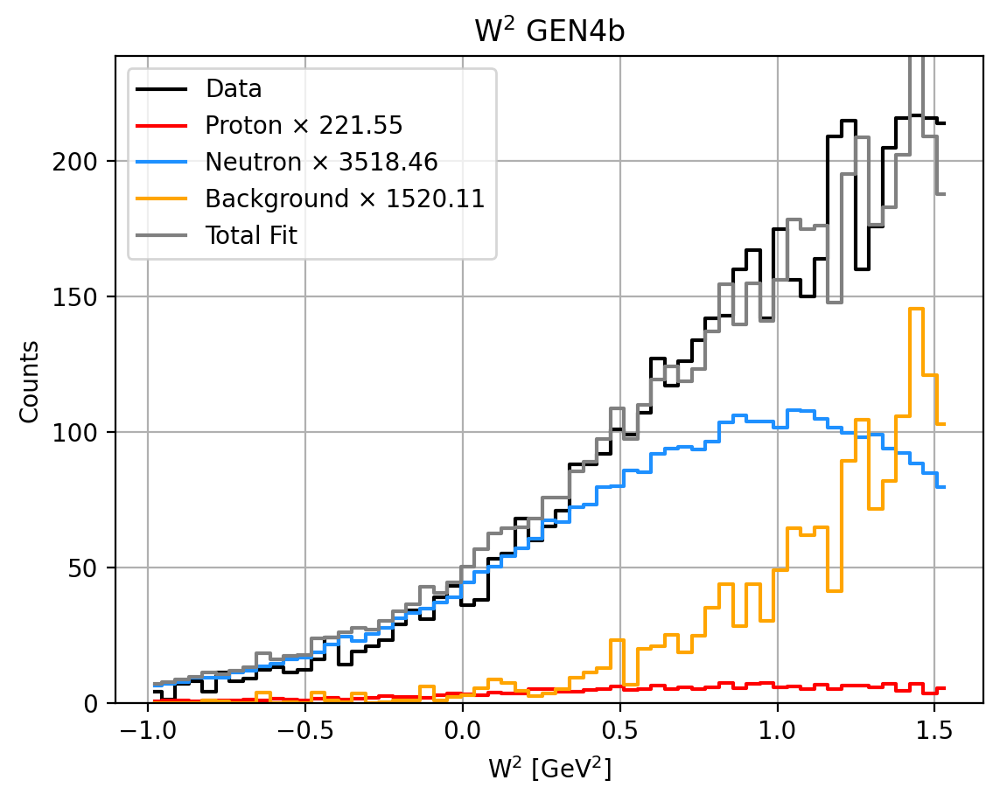

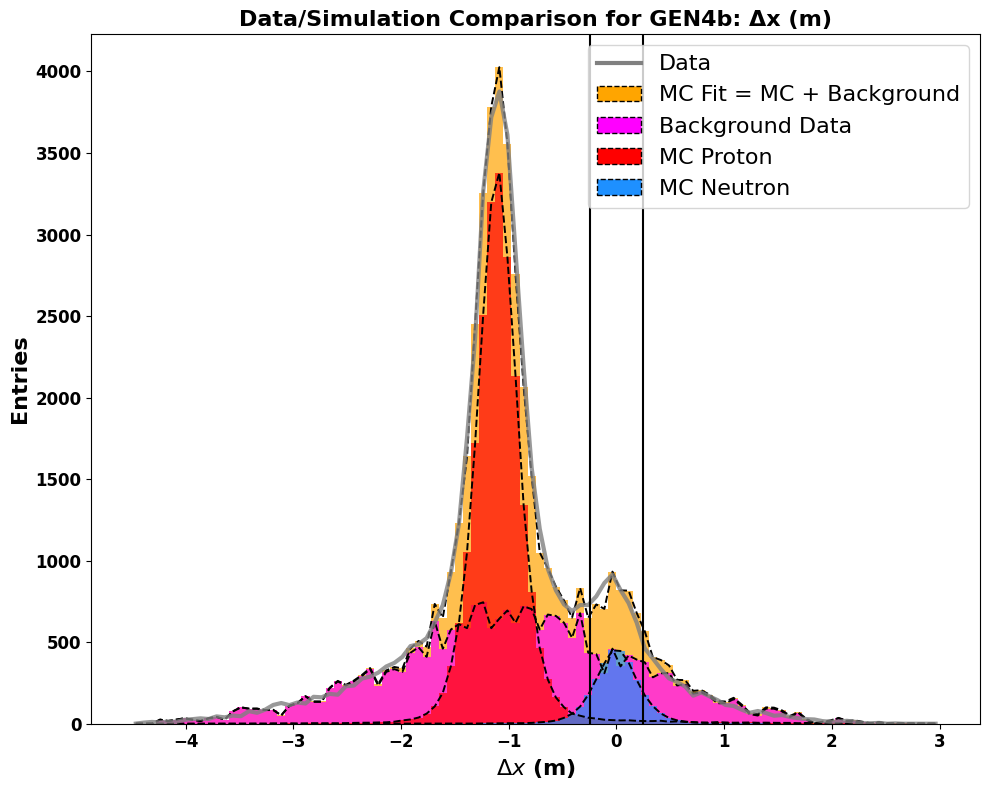

Total entries in fit: 48951.26890214437


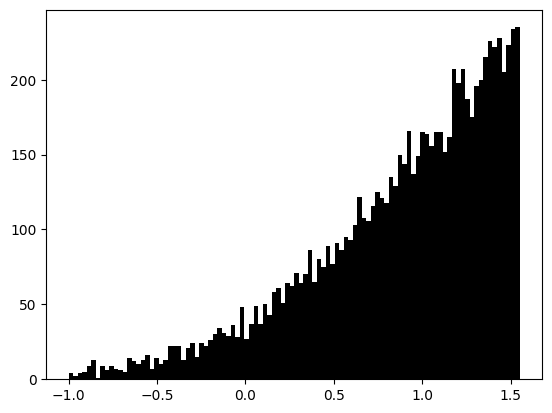

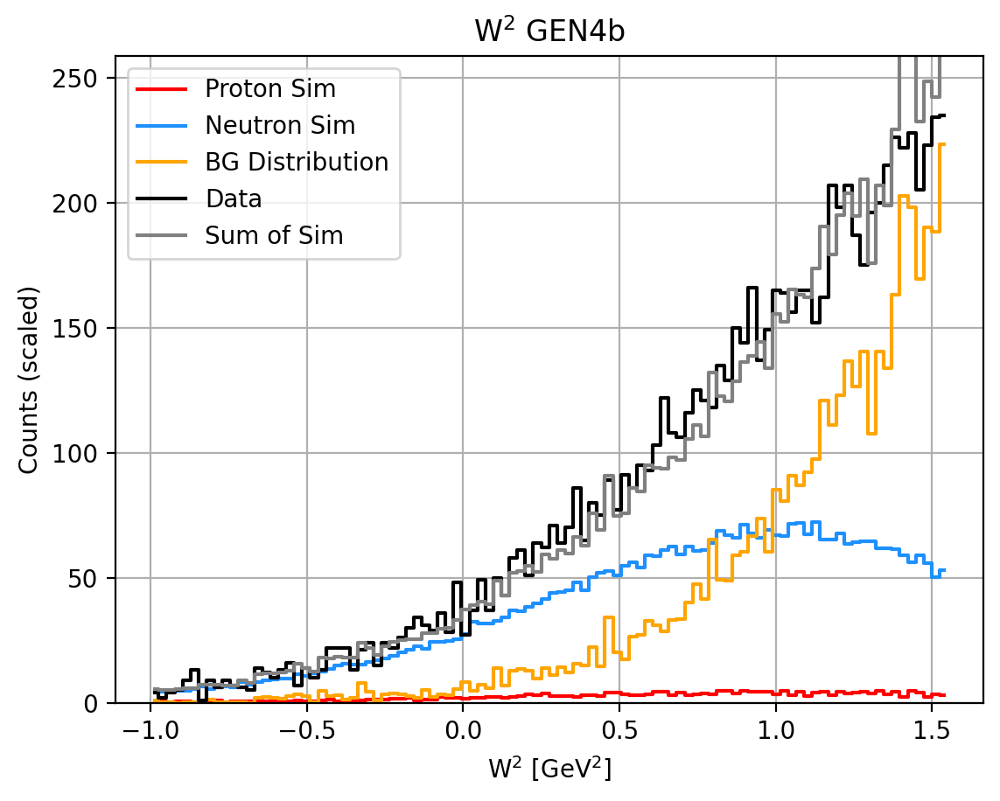

196398 196752
Total events in range (-0.25, 0.25):
  Sim Proton:   137.54
  Sim Neutron:  2184.35
  Background:   2359.89
  Total:        4739.00
Fraction of events in range (-0.25, 0.25):
   Proton Fraction: 0.03
   Background Fraction: 0.50
   W2 Background Fraction: 0.29
   Neutron Fraction: 0.46
__________________________________________________
Target Weighted Avg: 0.378+-0.0214  5.6516%
Beam Weighted Avg: 0.808+-0.0010  0.1201%
__________________________________________________
epsilon = 0.5730
tau_avg = 2.7748
Q2 = 9.7981
Px: 0.9905 Pz: -0.0287
A = 0.05051 ± 0.02073 ± 0.00341
B = 0.41596 (no propagated error)
C = 0.22102 ± 0.10041 ± 0.01653
__________________________________________________
N_plus: 2605 N_minus: 2441
A_raw: 0.0325+=0.0141
A_raw_weighted: 0.0327+-0.0135  41.2423%
__________________________________________________
A_phys_weighted: 0.245
A_phys_stat_error: 0.1004  41.0525%
A_phys_sys_error: 0.0165  6.76%
GEn/GMn*muN: 1.09064+--0.53656+--0.08836
Relative Error: 49.8

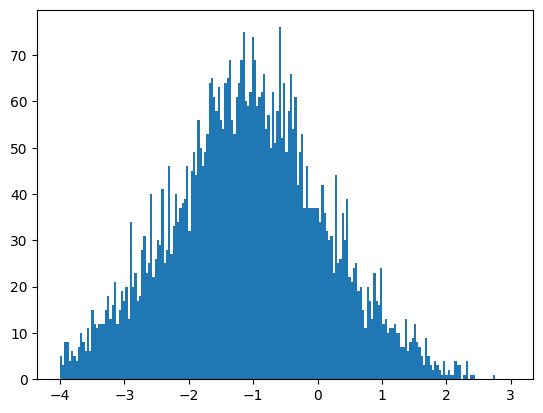

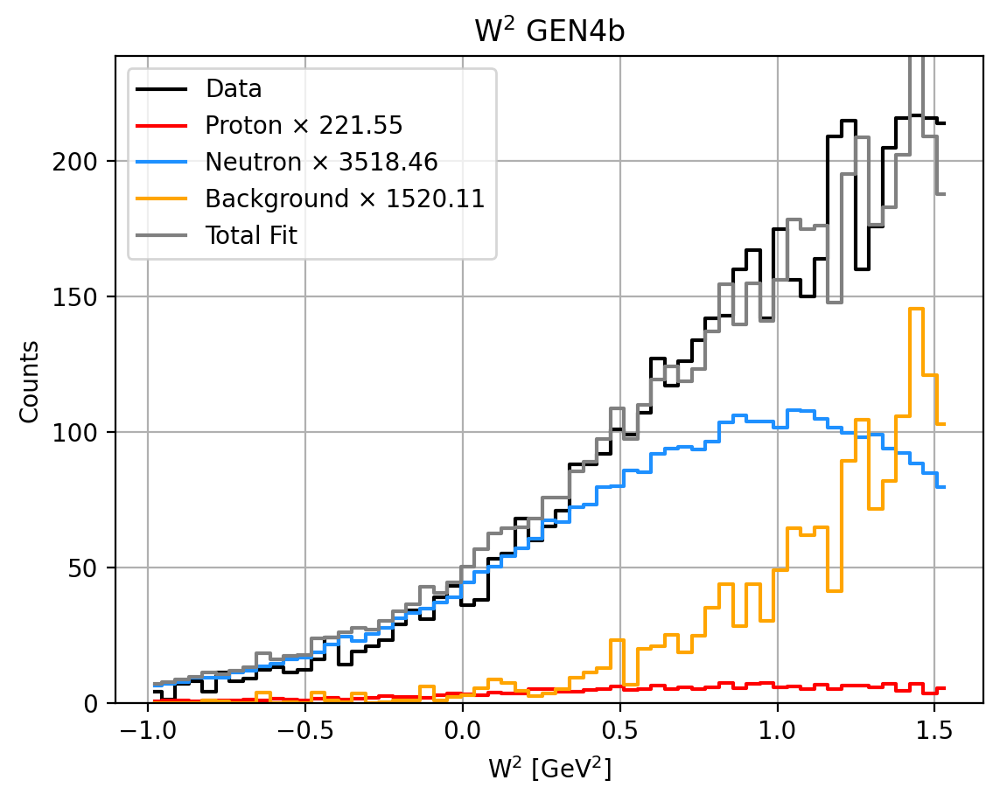

0.7110123863481094 0.0447705821974622 0.6662418041506472 0.28898761365189063


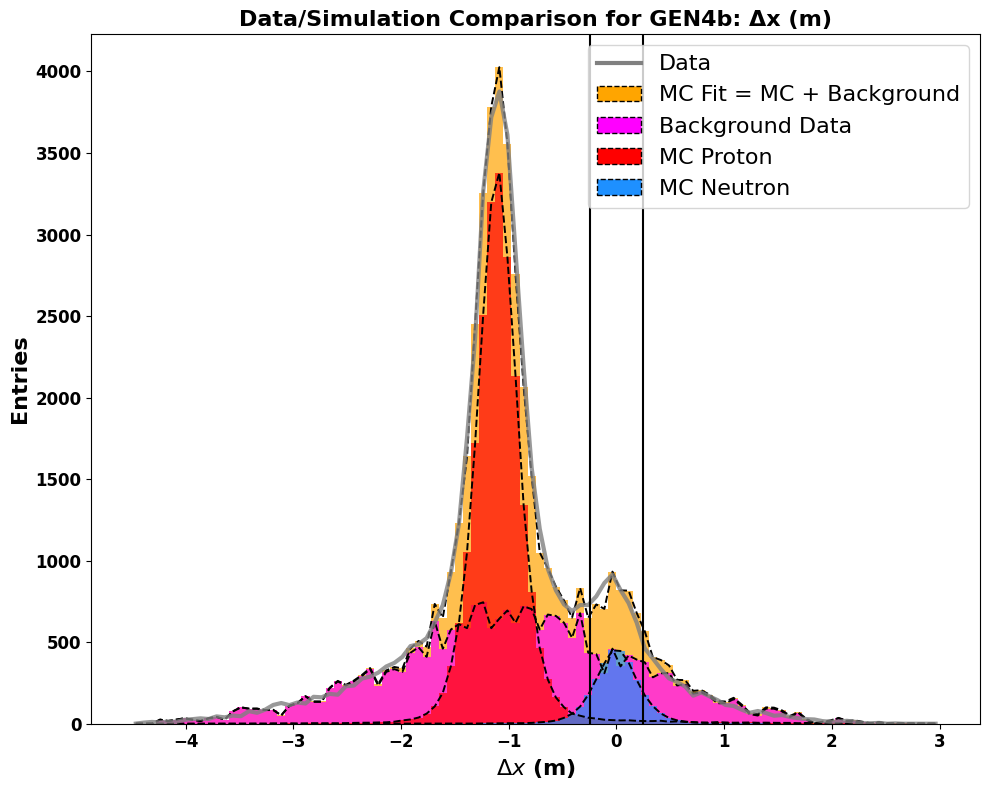

Total entries in fit: 48951.26890214437


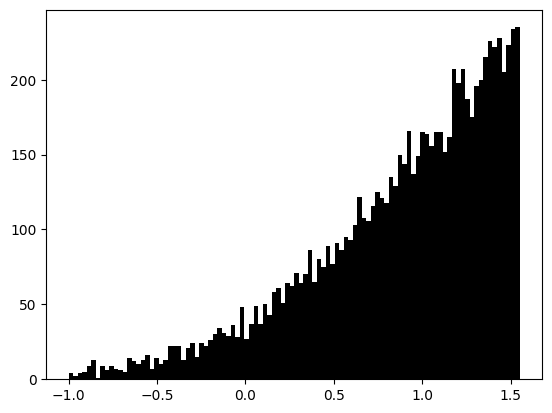

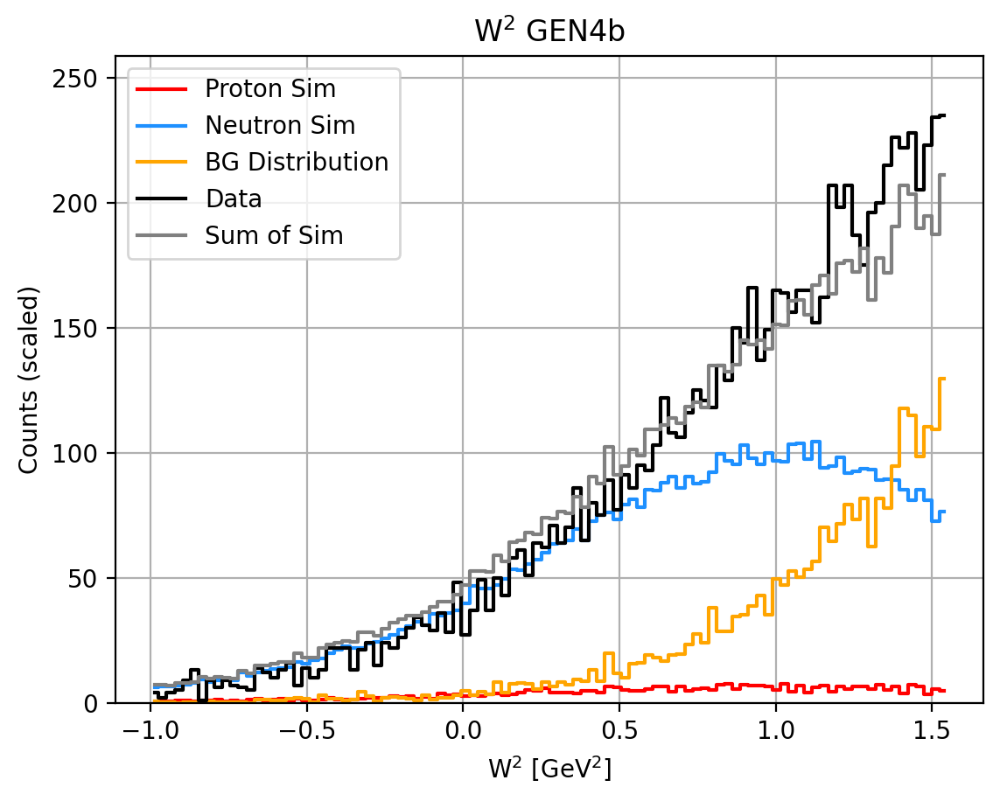

196398 196752
Total events in range (-0.25, 0.25):
  Sim Proton:   137.54
  Sim Neutron:  2184.35
  Background:   2359.89
  Total:        4739.00
Fraction of events in range (-0.25, 0.25):
   Proton Fraction: 0.04
   Background Fraction: 0.29
   W2 Background Fraction: 0.29
   Neutron Fraction: 0.67
__________________________________________________
Target Weighted Avg: 0.378+-0.0214  5.6516%
Beam Weighted Avg: 0.808+-0.0010  0.1201%
__________________________________________________
epsilon = 0.5730
tau_avg = 2.7748
Q2 = 9.7981
Px: 0.9905 Pz: -0.0287
A = 0.03566 ± 0.01472 ± 0.00222
B = 0.41596 (no propagated error)
C = 0.14911 ± 0.07128 ± 0.01073
__________________________________________________
N_plus: 2605 N_minus: 2441
A_raw: 0.0325+=0.0141
A_raw_weighted: 0.0327+-0.0135  41.2423%
__________________________________________________
A_phys_weighted: 0.173
A_phys_stat_error: 0.0713  41.2843%
A_phys_sys_error: 0.0107  6.213%
GEn/GMn*muN: 0.70722+--0.34970+--0.05263
Relative Error: 50.

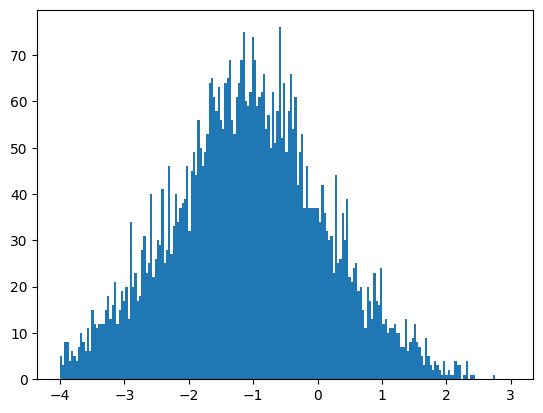

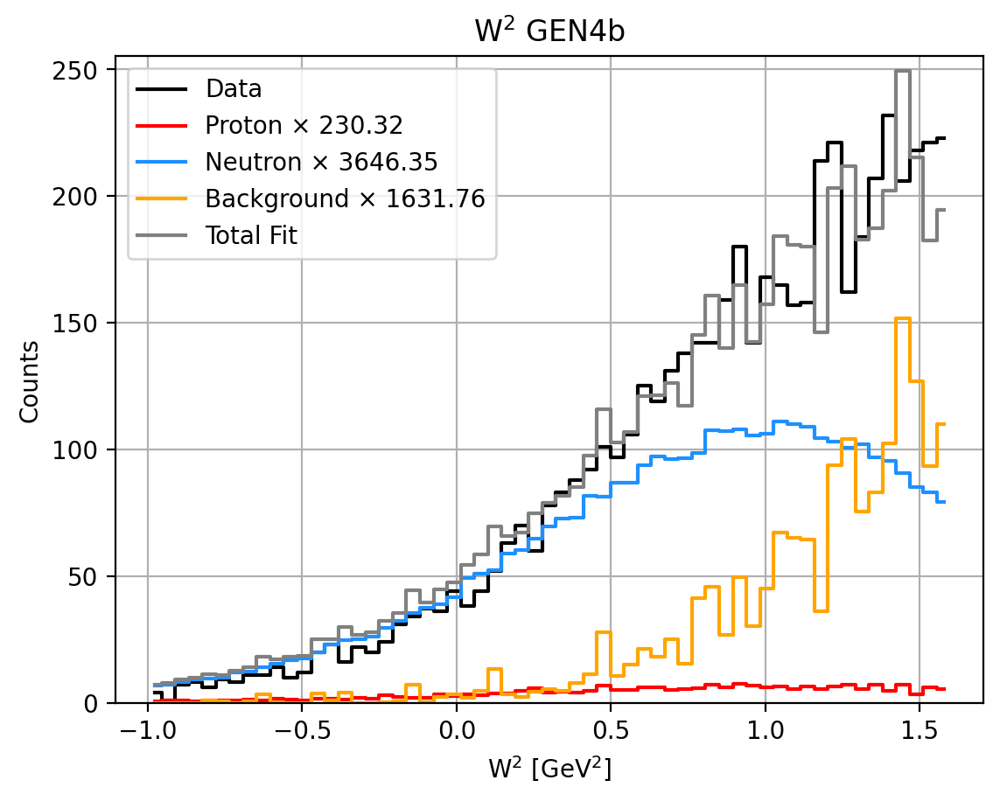

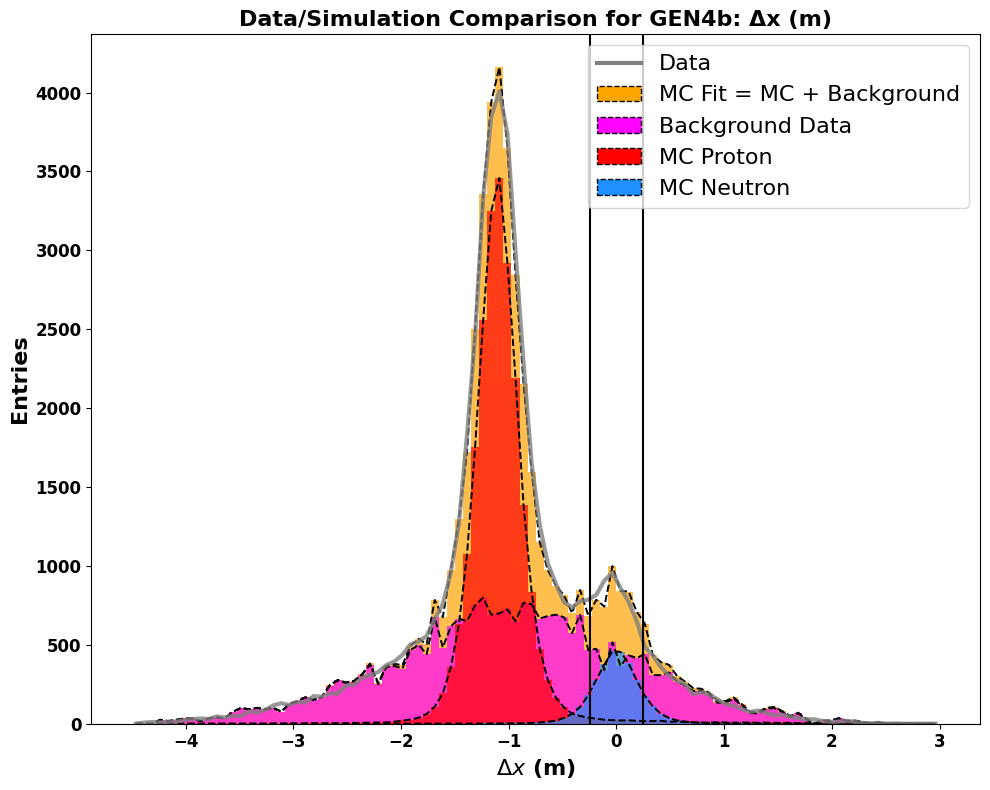

Total entries in fit: 51317.67699909191


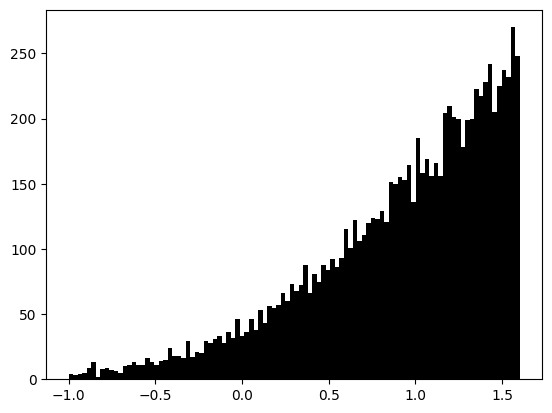

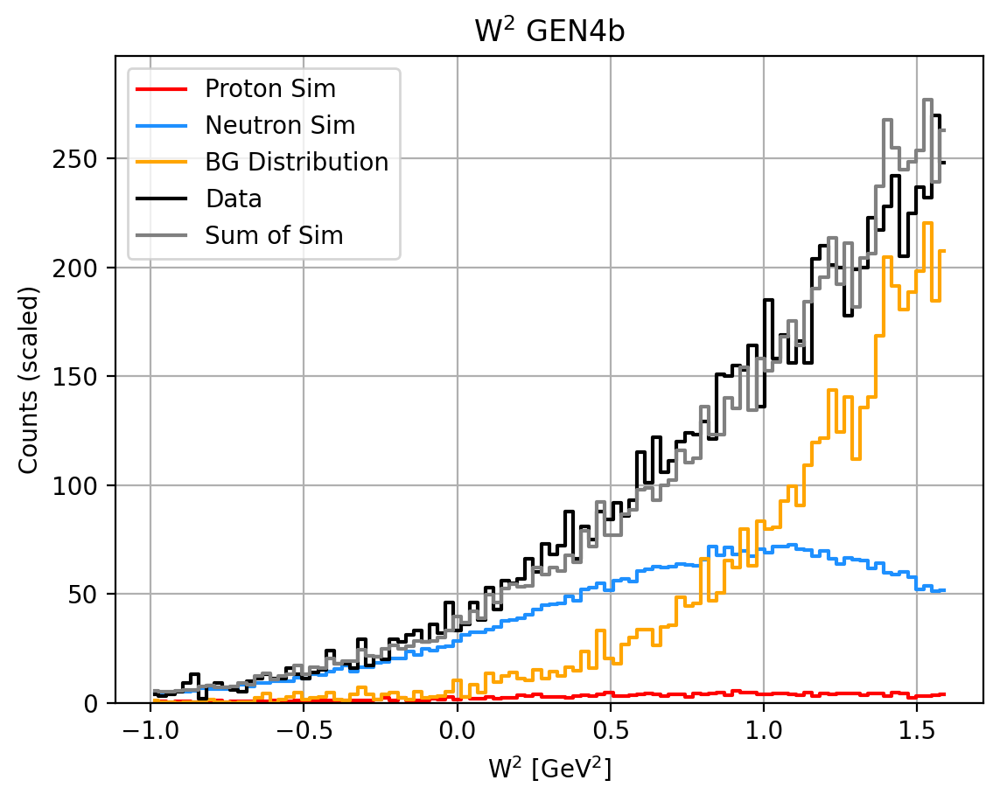

196398 196752
Total events in range (-0.25, 0.25):
  Sim Proton:   140.69
  Sim Neutron:  2227.34
  Background:   2547.91
  Total:        4965.00
Fraction of events in range (-0.25, 0.25):
   Proton Fraction: 0.03
   Background Fraction: 0.51
   W2 Background Fraction: 0.30
   Neutron Fraction: 0.45
__________________________________________________
Target Weighted Avg: 0.379+-0.0214  5.6629%
Beam Weighted Avg: 0.808+-0.0010  0.1201%
__________________________________________________
epsilon = 0.5737
tau_avg = 2.7678
Q2 = 9.7736
Px: 0.9905 Pz: -0.0281
A = 0.04738 ± 0.02097 ± 0.00328
B = 0.41640 (no propagated error)
C = 0.20560 ± 0.10116 ± 0.01581
__________________________________________________
N_plus: 2727 N_minus: 2564
A_raw: 0.0308+=0.0137
A_raw_weighted: 0.0301+-0.0132  43.9056%
__________________________________________________
A_phys_weighted: 0.229
A_phys_stat_error: 0.1012  44.2562%
A_phys_sys_error: 0.0158  6.918%
GEn/GMn*muN: 1.00318+--0.52794+--0.08253
Relative Error: 53.

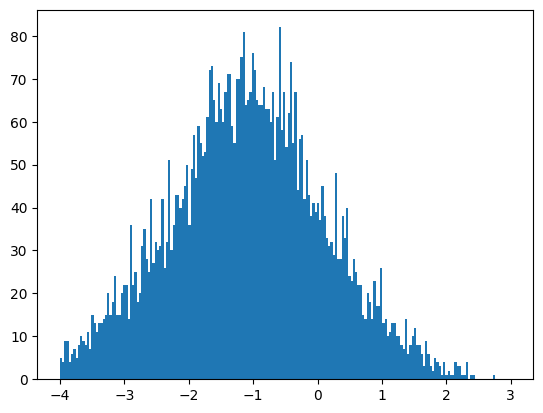

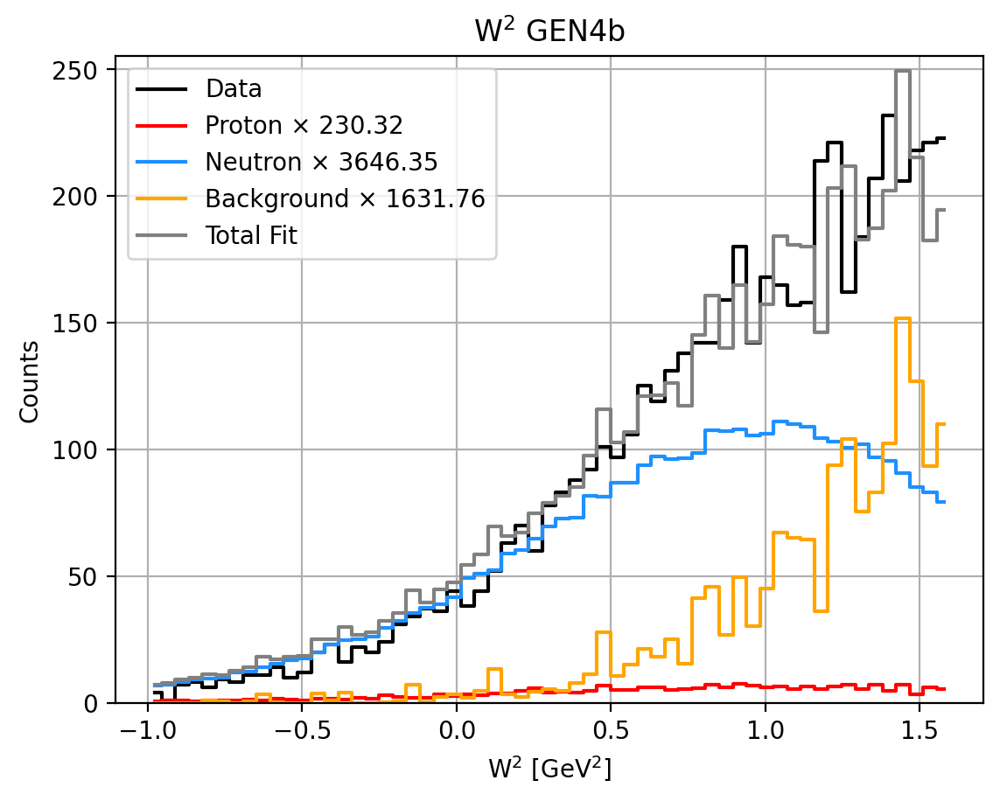

0.7037709824504429 0.04445357130591044 0.6593174111445325 0.29622901754955705


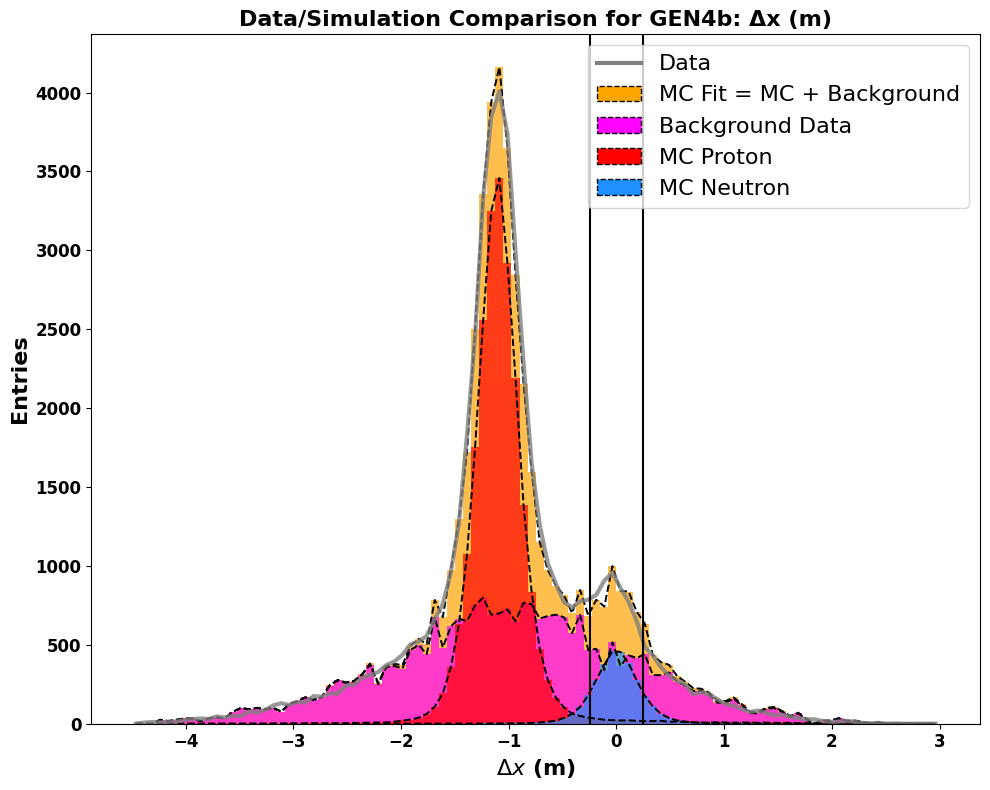

Total entries in fit: 51317.67699909191


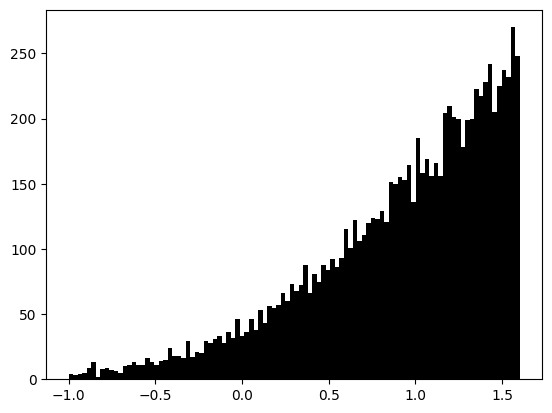

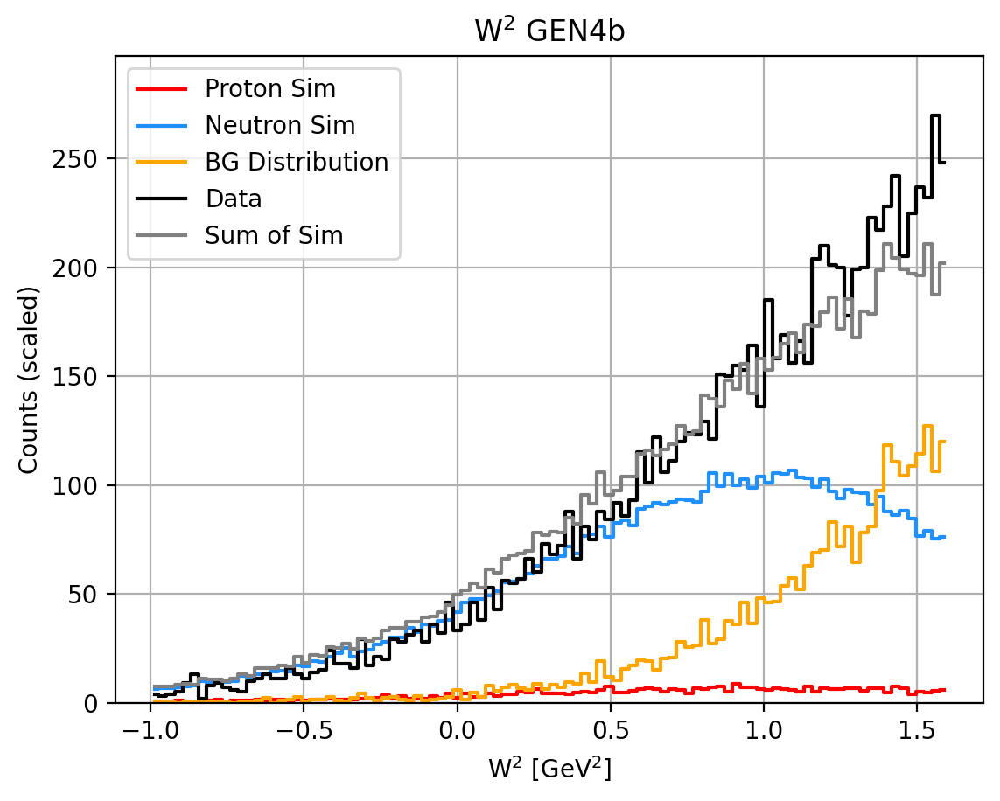

196398 196752
Total events in range (-0.25, 0.25):
  Sim Proton:   140.69
  Sim Neutron:  2227.34
  Background:   2547.91
  Total:        4965.00
Fraction of events in range (-0.25, 0.25):
   Proton Fraction: 0.04
   Background Fraction: 0.30
   W2 Background Fraction: 0.30
   Neutron Fraction: 0.66
__________________________________________________
Target Weighted Avg: 0.379+-0.0214  5.6629%
Beam Weighted Avg: 0.808+-0.0010  0.1201%
__________________________________________________
epsilon = 0.5737
tau_avg = 2.7678
Q2 = 9.7736
Px: 0.9905 Pz: -0.0281
A = 0.03274 ± 0.01458 ± 0.00205
B = 0.41640 (no propagated error)
C = 0.13496 ± 0.07035 ± 0.00991
__________________________________________________
N_plus: 2727 N_minus: 2564
A_raw: 0.0308+=0.0137
A_raw_weighted: 0.0301+-0.0132  43.9056%
__________________________________________________
A_phys_weighted: 0.158
A_phys_stat_error: 0.0703  44.5423%
A_phys_sys_error: 0.0099  6.276%
GEn/GMn*muN: 0.63577+--0.34064+--0.04799
Relative Error: 54.

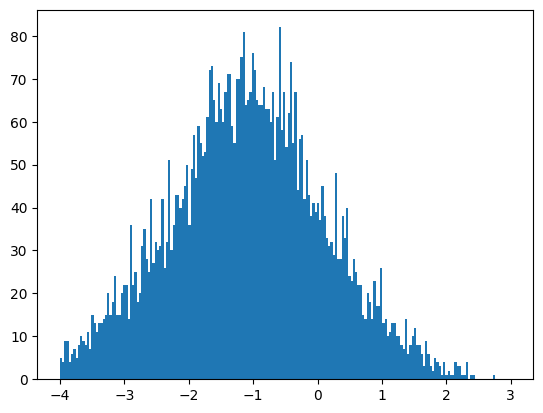

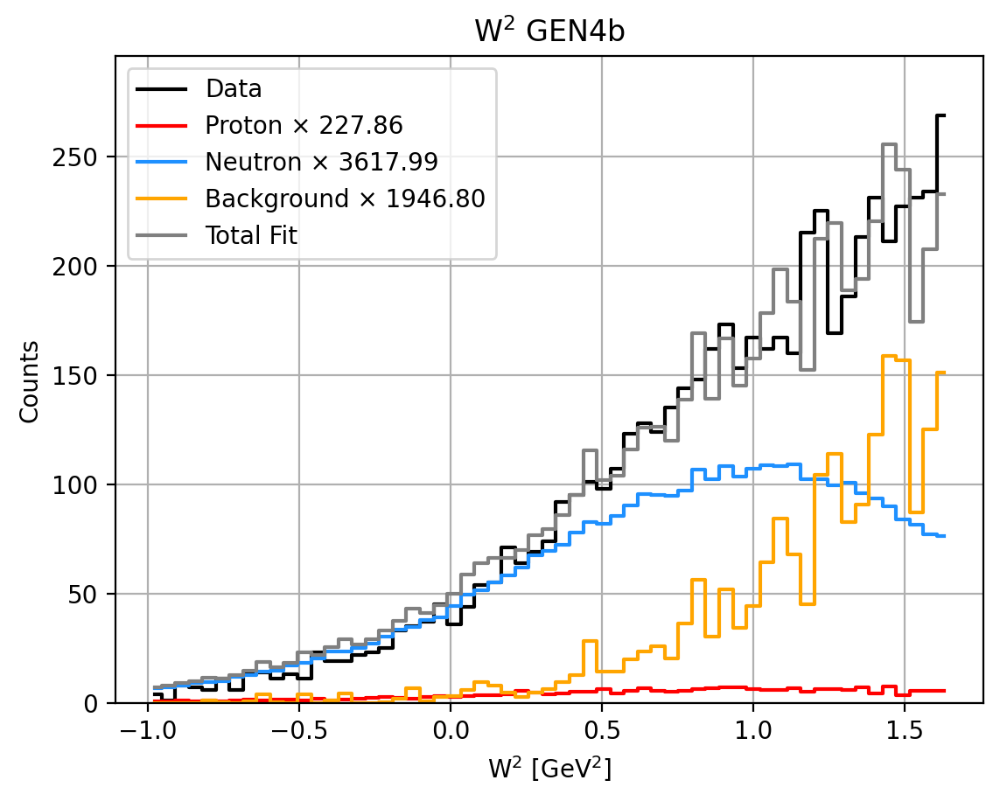

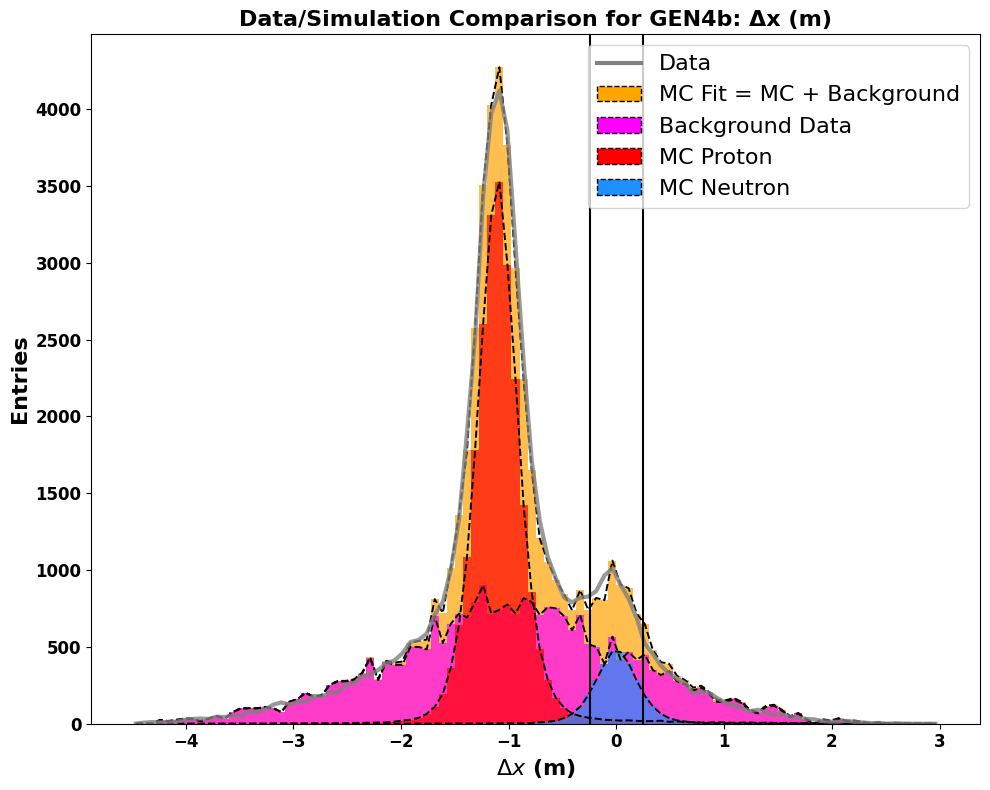

Total entries in fit: 53704.51931541921


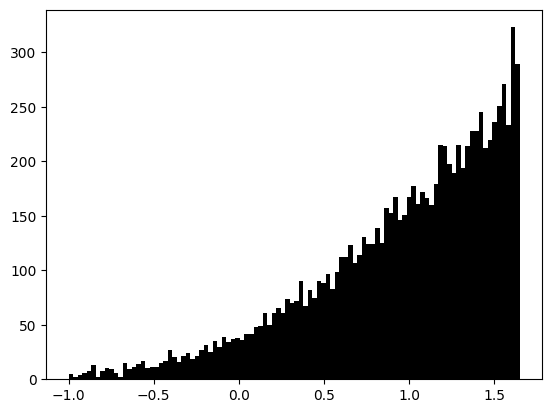

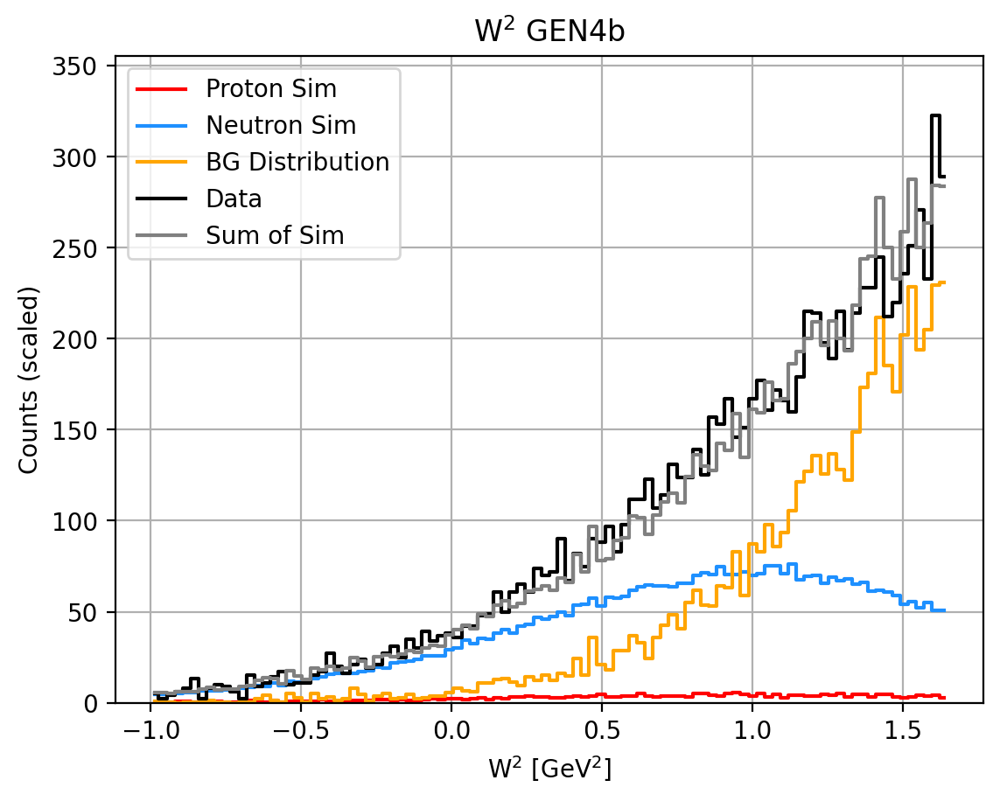

196398 196752
Total events in range (-0.25, 0.25):
  Sim Proton:   143.94
  Sim Neutron:  2285.53
  Background:   2759.98
  Total:        5247.00
Fraction of events in range (-0.25, 0.25):
   Proton Fraction: 0.03
   Background Fraction: 0.53
   W2 Background Fraction: 0.34
   Neutron Fraction: 0.44
__________________________________________________
Target Weighted Avg: 0.379+-0.0214  5.6538%
Beam Weighted Avg: 0.808+-0.0010  0.1201%
__________________________________________________
epsilon = 0.5746
tau_avg = 2.7596
Q2 = 9.7446
Px: 0.9906 Pz: -0.0272
A = 0.04274 ± 0.02100 ± 0.00304
B = 0.41691 (no propagated error)
C = 0.18300 ± 0.10086 ± 0.01461
__________________________________________________
N_plus: 2863 N_minus: 2731
A_raw: 0.0236+=0.0134
A_raw_weighted: 0.0258+-0.0128  49.8162%
__________________________________________________
A_phys_weighted: 0.205
A_phys_stat_error: 0.1009  49.1358%
A_phys_sys_error: 0.0146  7.12%
GEn/GMn*muN: 0.88006+--0.51082+--0.07402
Relative Error: 58.6

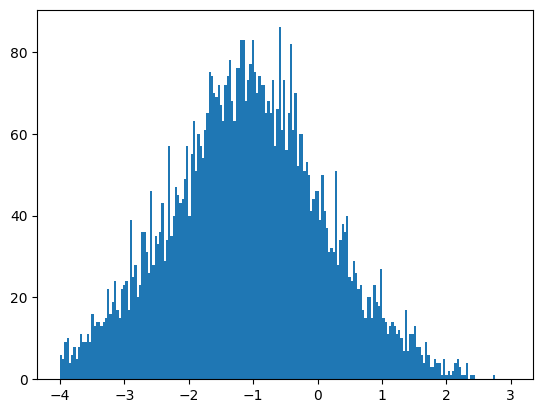

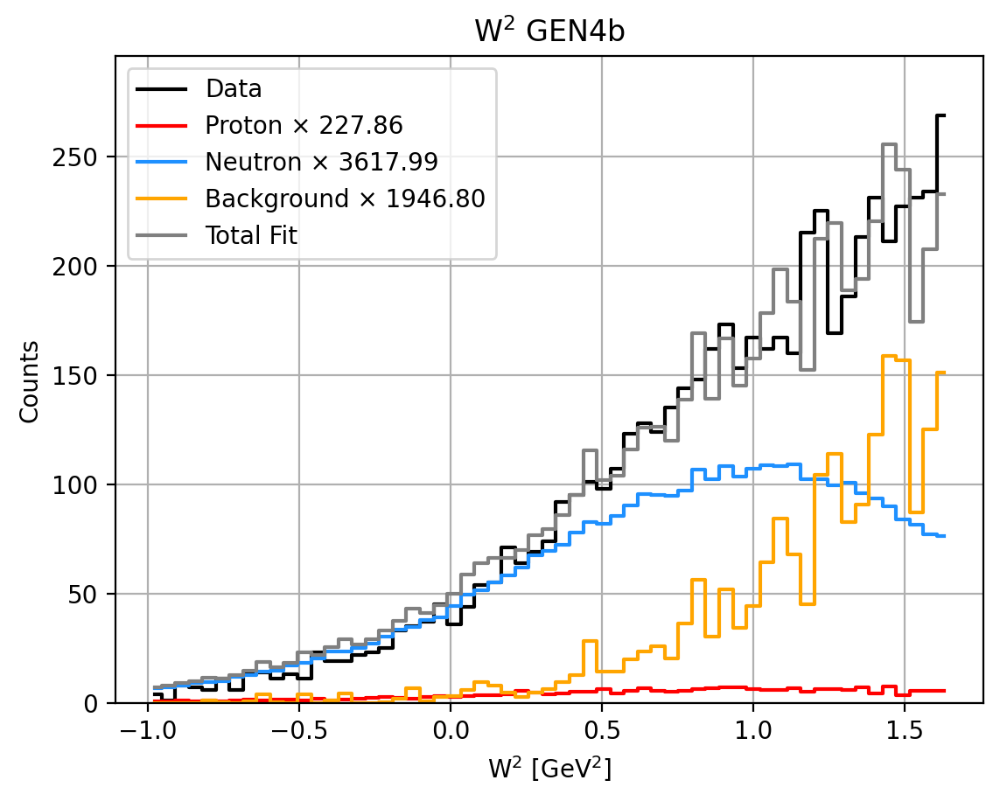

0.6639189318583114 0.04181300470634433 0.6221059271519671 0.3360810681416886


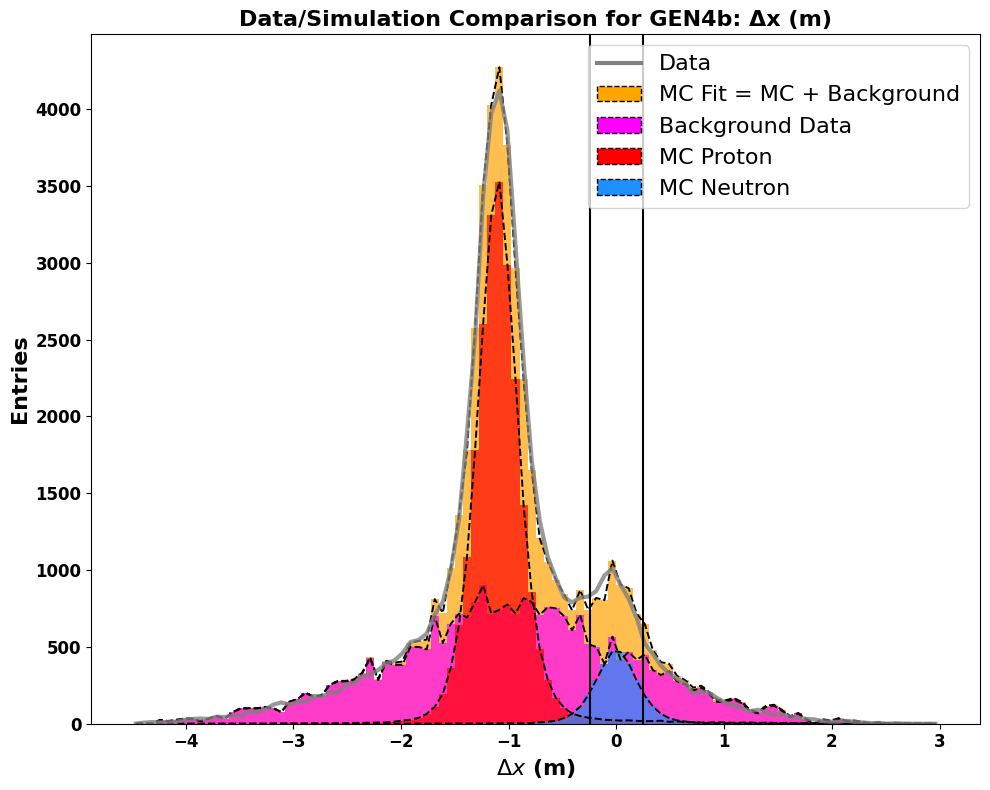

Total entries in fit: 53704.51931541921


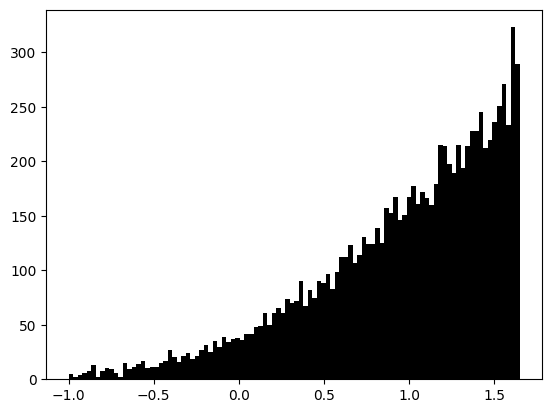

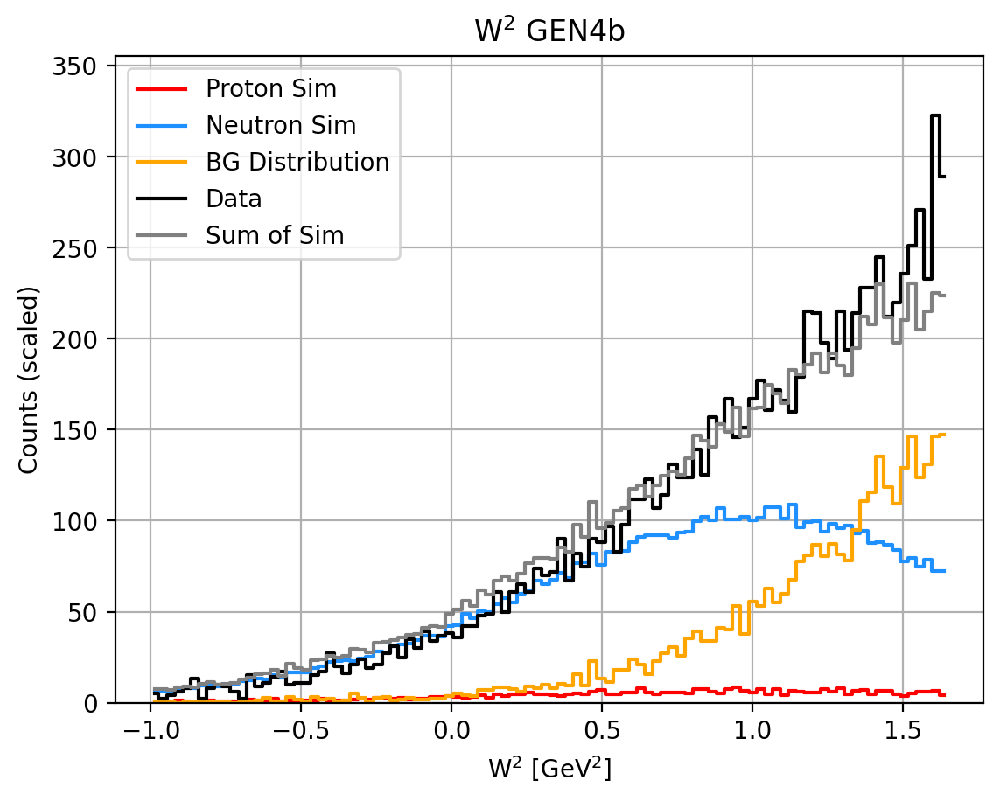

196398 196752
Total events in range (-0.25, 0.25):
  Sim Proton:   143.94
  Sim Neutron:  2285.53
  Background:   2759.98
  Total:        5247.00
Fraction of events in range (-0.25, 0.25):
   Proton Fraction: 0.04
   Background Fraction: 0.34
   W2 Background Fraction: 0.34
   Neutron Fraction: 0.62
__________________________________________________
Target Weighted Avg: 0.379+-0.0214  5.6538%
Beam Weighted Avg: 0.808+-0.0010  0.1201%
__________________________________________________
epsilon = 0.5746
tau_avg = 2.7596
Q2 = 9.7446
Px: 0.9906 Pz: -0.0272
A = 0.03048 ± 0.01507 ± 0.00196
B = 0.41691 (no propagated error)
C = 0.12413 ± 0.07240 ± 0.00942
__________________________________________________
N_plus: 2863 N_minus: 2731
A_raw: 0.0236+=0.0134
A_raw_weighted: 0.0258+-0.0128  49.8162%
__________________________________________________
A_phys_weighted: 0.146
A_phys_stat_error: 0.0724  49.4539%
A_phys_sys_error: 0.0094  6.432%
GEn/GMn*muN: 0.58171+--0.34724+--0.04516
Relative Error: 60.

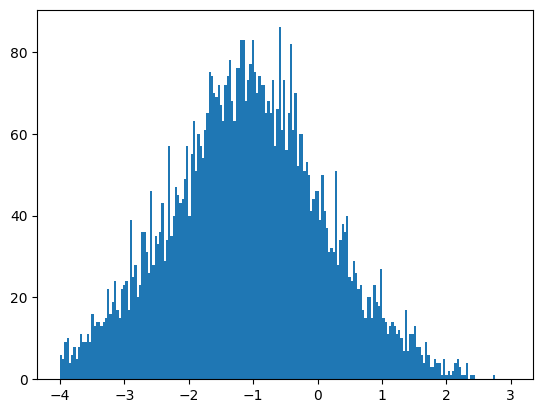

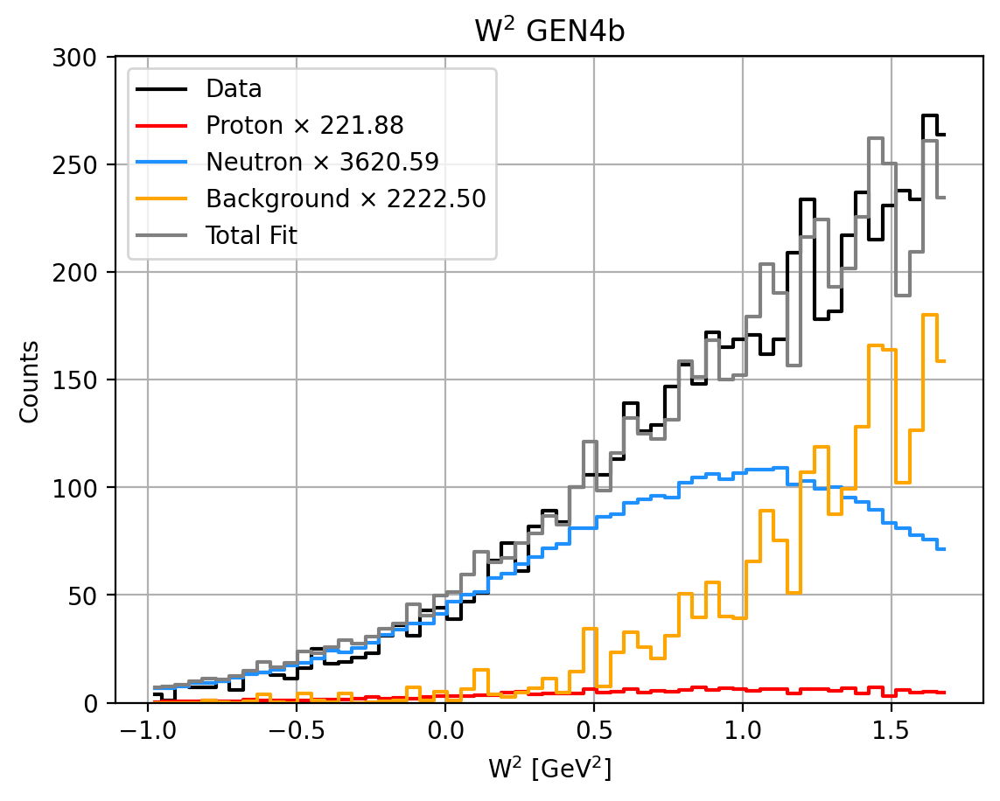

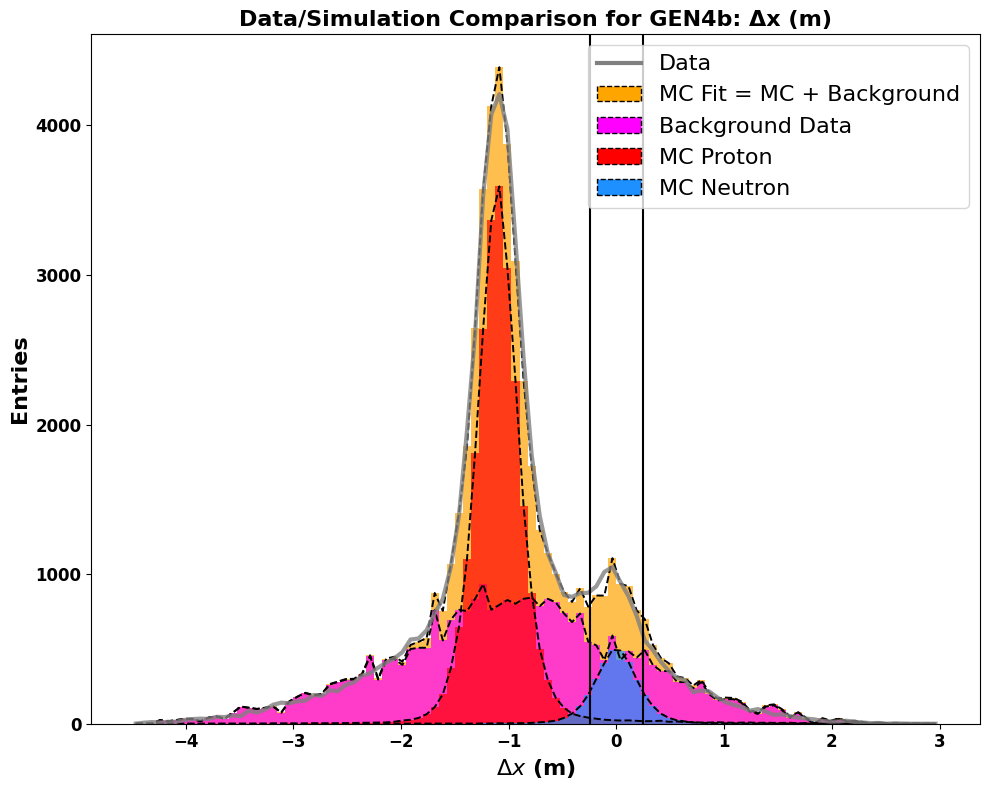

Total entries in fit: 55989.72811204021


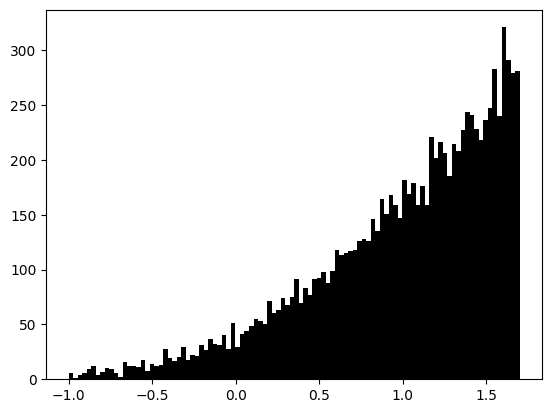

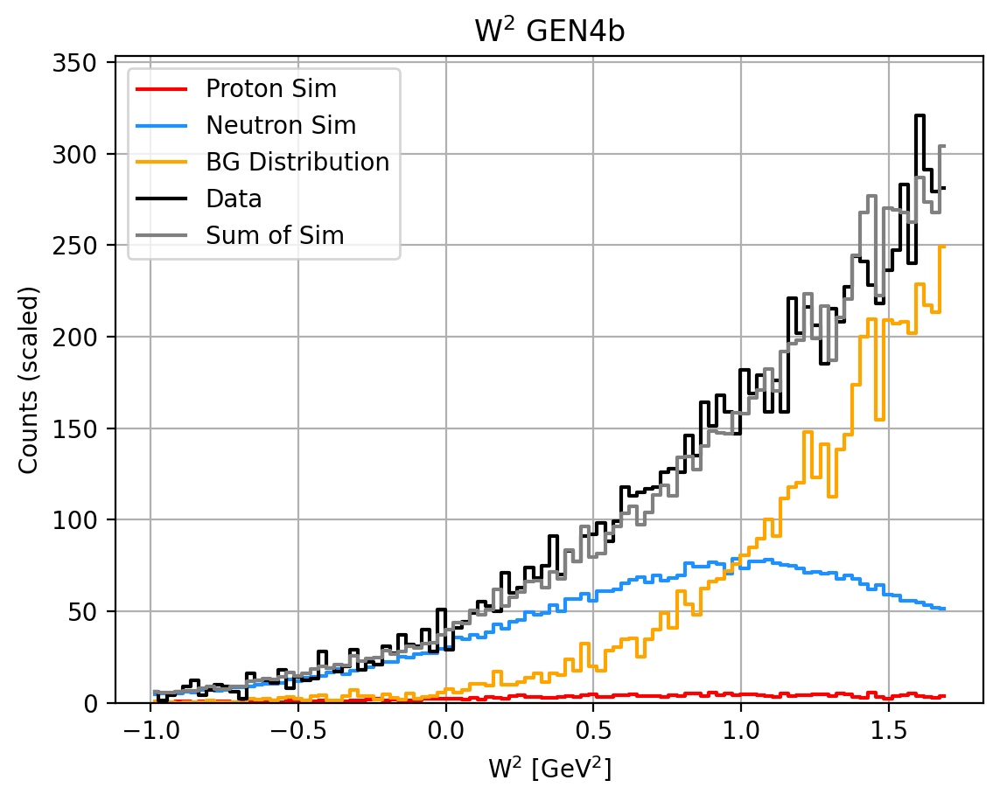

196398 196752
Total events in range (-0.25, 0.25):
  Sim Proton:   146.75
  Sim Neutron:  2394.58
  Background:   2890.14
  Total:        5498.00
Fraction of events in range (-0.25, 0.25):
   Proton Fraction: 0.03
   Background Fraction: 0.53
   W2 Background Fraction: 0.37
   Neutron Fraction: 0.44
__________________________________________________
Target Weighted Avg: 0.379+-0.0214  5.6584%
Beam Weighted Avg: 0.808+-0.0010  0.1201%
__________________________________________________
epsilon = 0.5756
tau_avg = 2.7518
Q2 = 9.7169
Px: 0.9906 Pz: -0.0265
A = 0.05573 ± 0.02054 ± 0.00378
B = 0.41738 (no propagated error)
C = 0.24474 ± 0.09819 ± 0.01806
__________________________________________________
N_plus: 3013 N_minus: 2856
A_raw: 0.0268+=0.0130
A_raw_weighted: 0.0339+-0.0125  36.9611%
__________________________________________________
A_phys_weighted: 0.266
A_phys_stat_error: 0.0982  36.8539%
A_phys_sys_error: 0.0181  6.78%
GEn/GMn*muN: 1.22505+--0.54429+--0.10013
Relative Error: 45.1

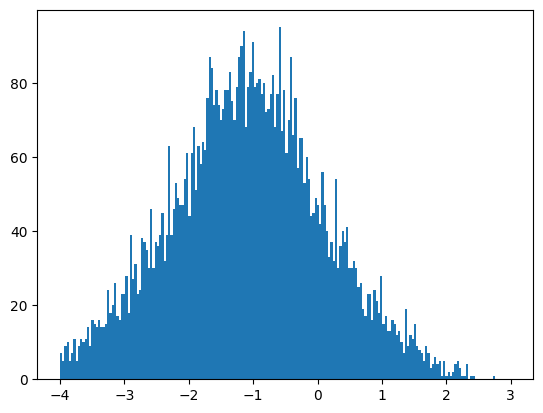

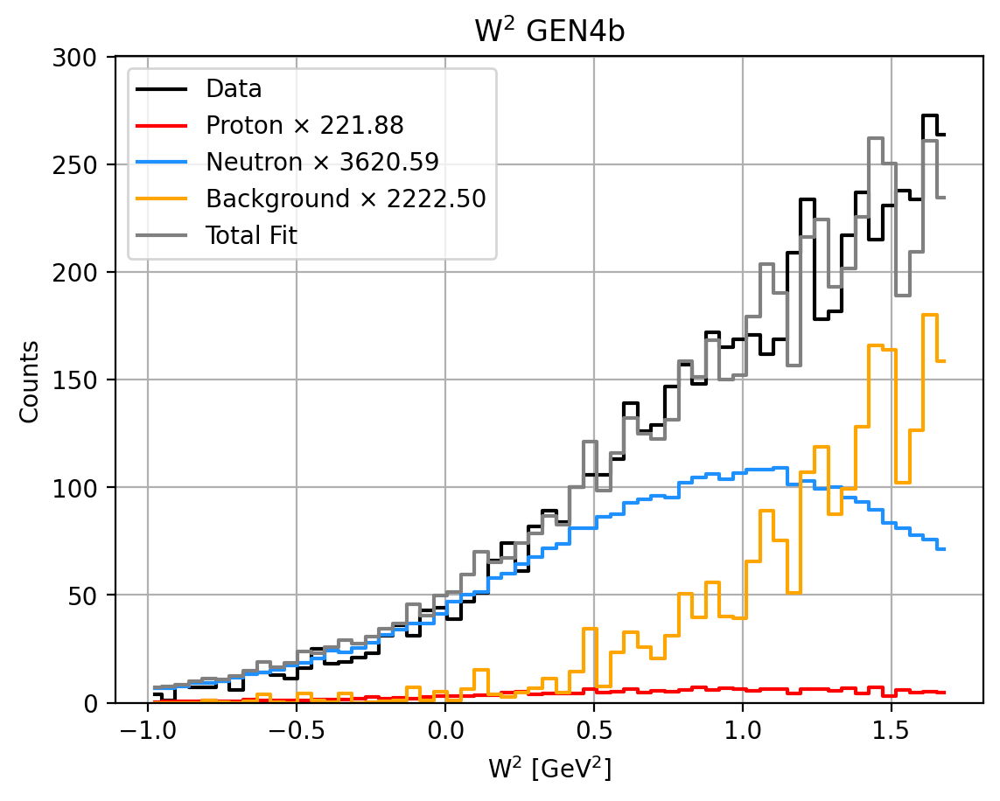

0.6335509339603607 0.038826108595611745 0.5947248253647489 0.36644906603963934


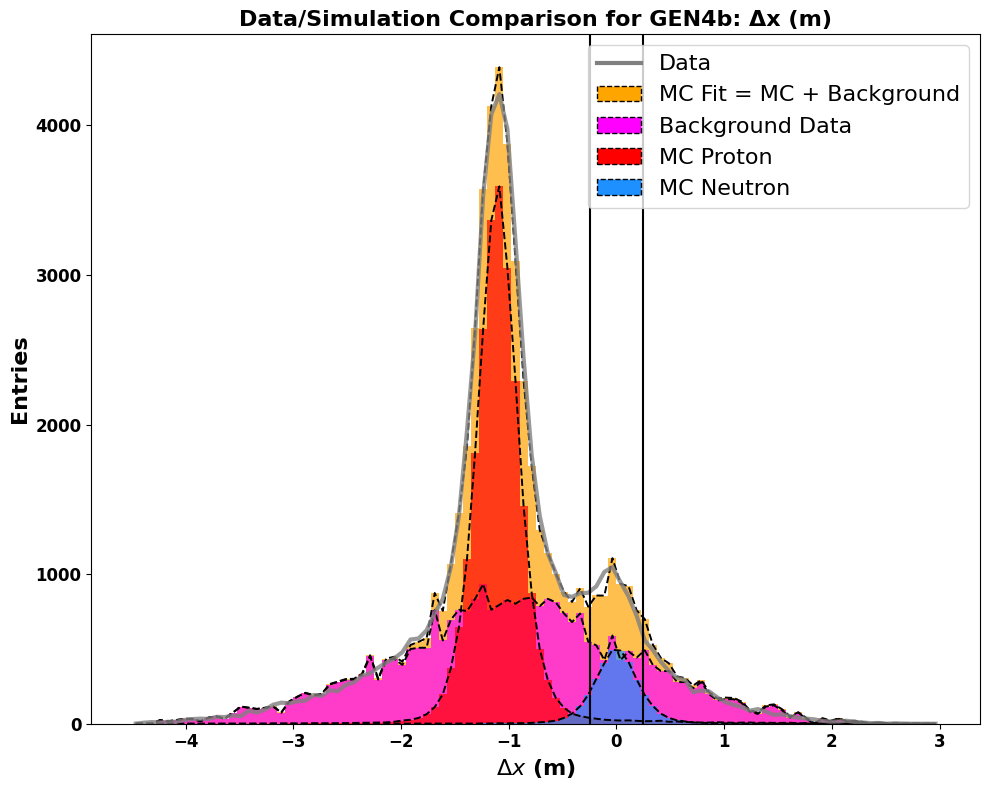

Total entries in fit: 55989.72811204021


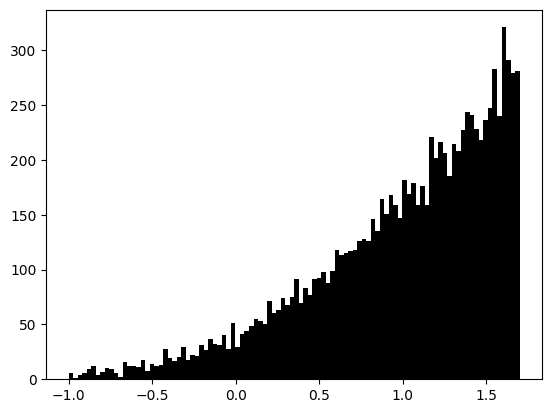

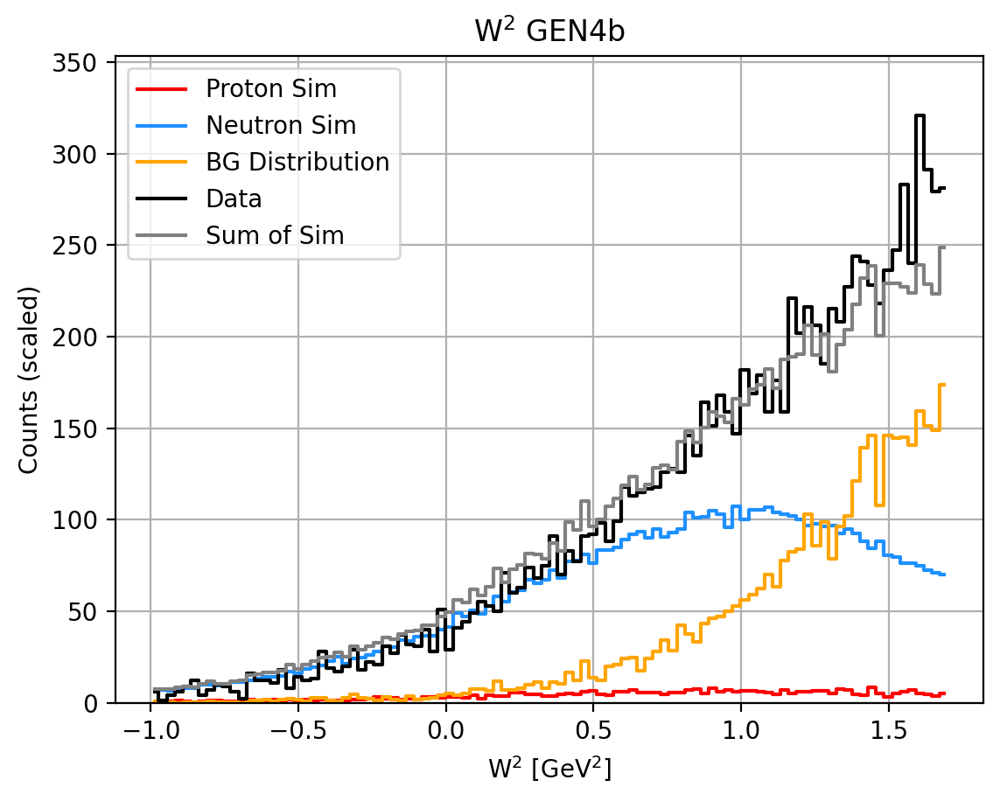

196398 196752
Total events in range (-0.25, 0.25):
  Sim Proton:   146.75
  Sim Neutron:  2394.58
  Background:   2890.14
  Total:        5498.00
Fraction of events in range (-0.25, 0.25):
   Proton Fraction: 0.04
   Background Fraction: 0.37
   W2 Background Fraction: 0.37
   Neutron Fraction: 0.59
__________________________________________________
Target Weighted Avg: 0.379+-0.0214  5.6584%
Beam Weighted Avg: 0.808+-0.0010  0.1201%
__________________________________________________
epsilon = 0.5756
tau_avg = 2.7518
Q2 = 9.7169
Px: 0.9906 Pz: -0.0265
A = 0.04177 ± 0.01546 ± 0.00264
B = 0.41738 (no propagated error)
C = 0.17802 ± 0.07391 ± 0.01261
__________________________________________________
N_plus: 3013 N_minus: 2856
A_raw: 0.0268+=0.0130
A_raw_weighted: 0.0339+-0.0125  36.9611%
__________________________________________________
A_phys_weighted: 0.2
A_phys_stat_error: 0.0739  37.0073%
A_phys_sys_error: 0.0126  6.313%
GEn/GMn*muN: 0.85286+--0.37179+--0.06342
Relative Error: 44.22

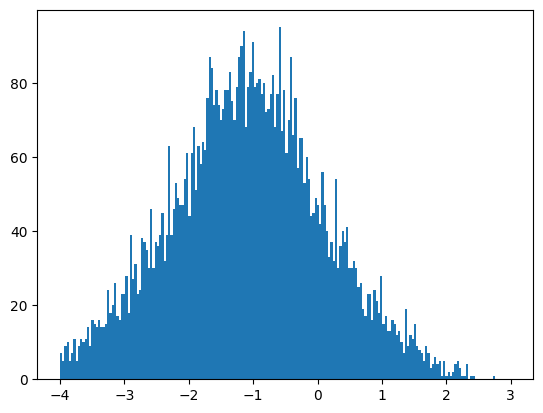

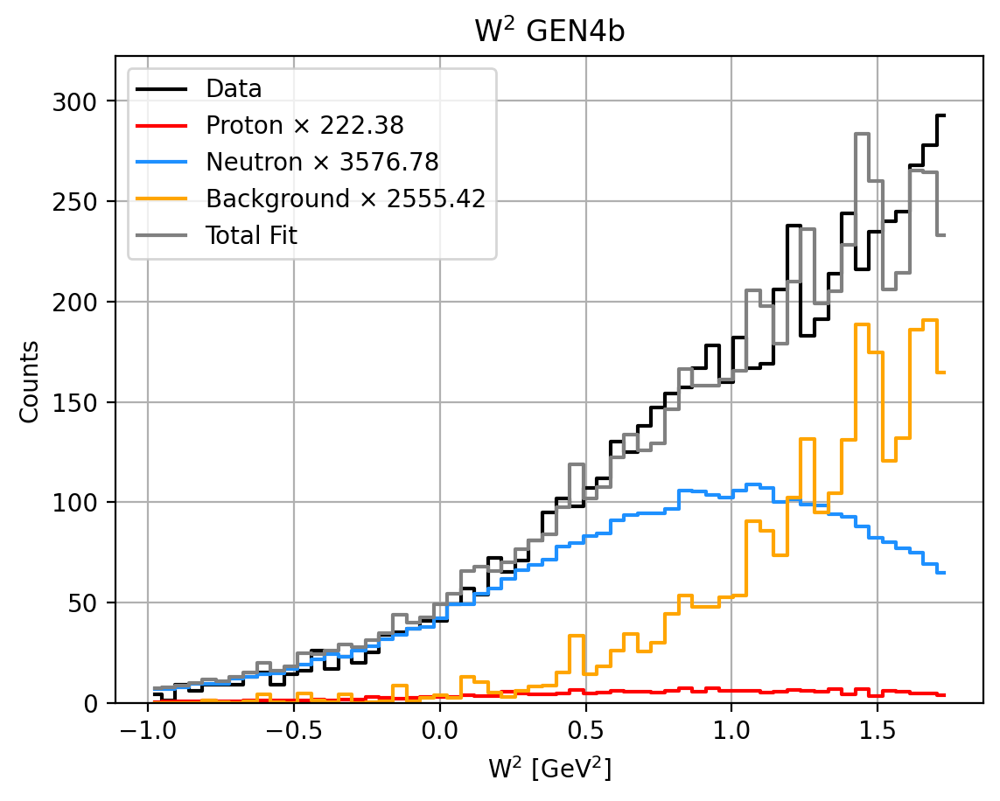

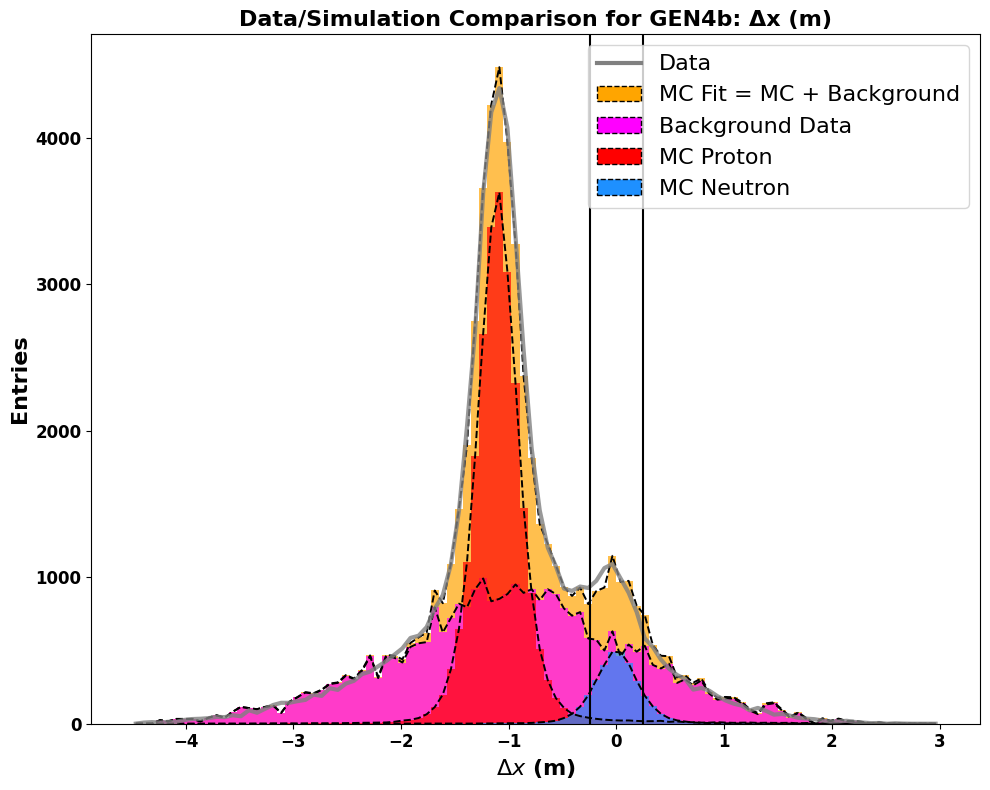

Total entries in fit: 58449.2954641208


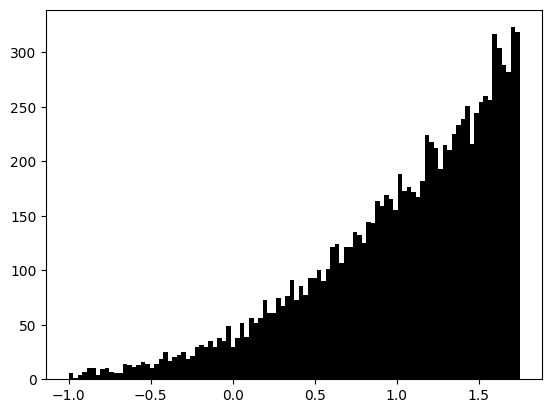

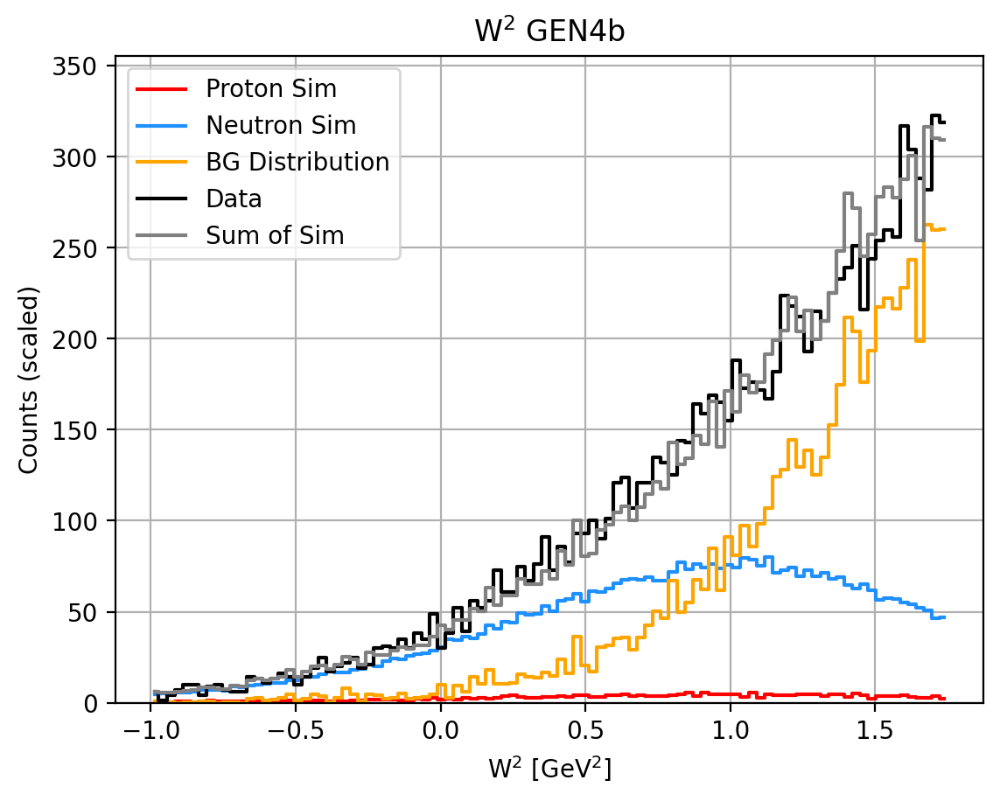

196398 196752
Total events in range (-0.25, 0.25):
  Sim Proton:   148.44
  Sim Neutron:  2387.55
  Background:   3197.44
  Total:        5781.00
Fraction of events in range (-0.25, 0.25):
   Proton Fraction: 0.03
   Background Fraction: 0.55
   W2 Background Fraction: 0.40
   Neutron Fraction: 0.41
__________________________________________________
Target Weighted Avg: 0.379+-0.0214  5.6508%
Beam Weighted Avg: 0.808+-0.0010  0.1201%
__________________________________________________
epsilon = 0.5764
tau_avg = 2.7441
Q2 = 9.6897
Px: 0.9906 Pz: -0.0257
A = 0.05995 ± 0.02144 ± 0.00413
B = 0.41788 (no propagated error)
C = 0.26442 ± 0.10205 ± 0.01966
__________________________________________________
N_plus: 3174 N_minus: 3005
A_raw: 0.0274+=0.0127
A_raw_weighted: 0.0348+-0.0123  35.2012%
__________________________________________________
A_phys_weighted: 0.285
A_phys_stat_error: 0.1021  35.7542%
A_phys_sys_error: 0.0197  6.888%
GEn/GMn*muN: 1.34457+--0.58773+--0.11322
Relative Error: 44.

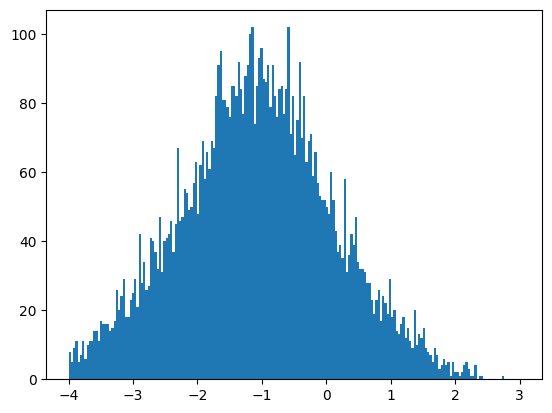

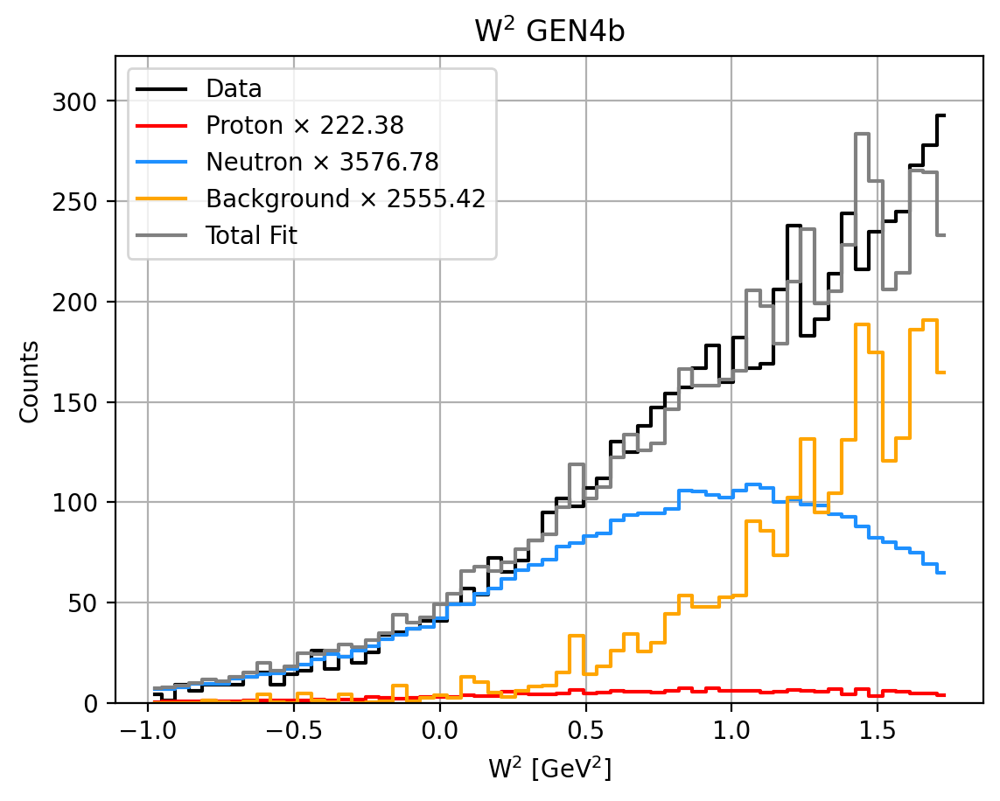

0.5978614365666186 0.037170677161333786 0.5606907594052848 0.4021385634333814


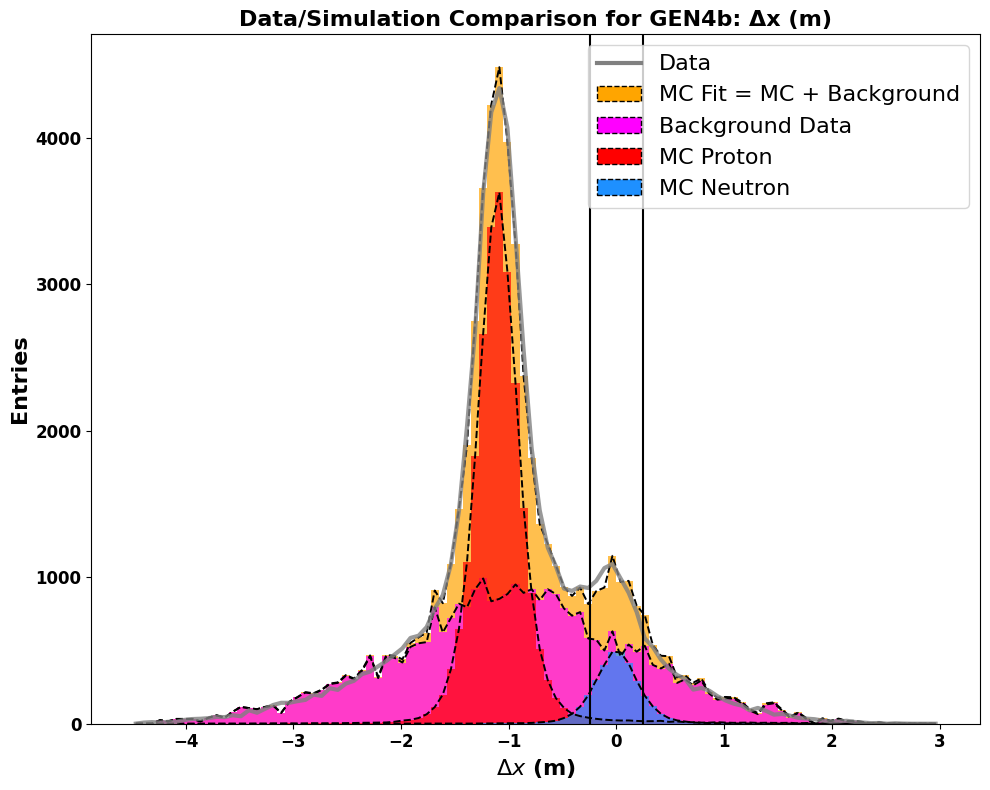

Total entries in fit: 58449.2954641208


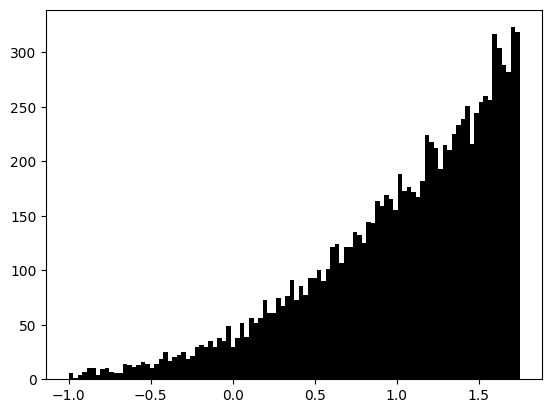

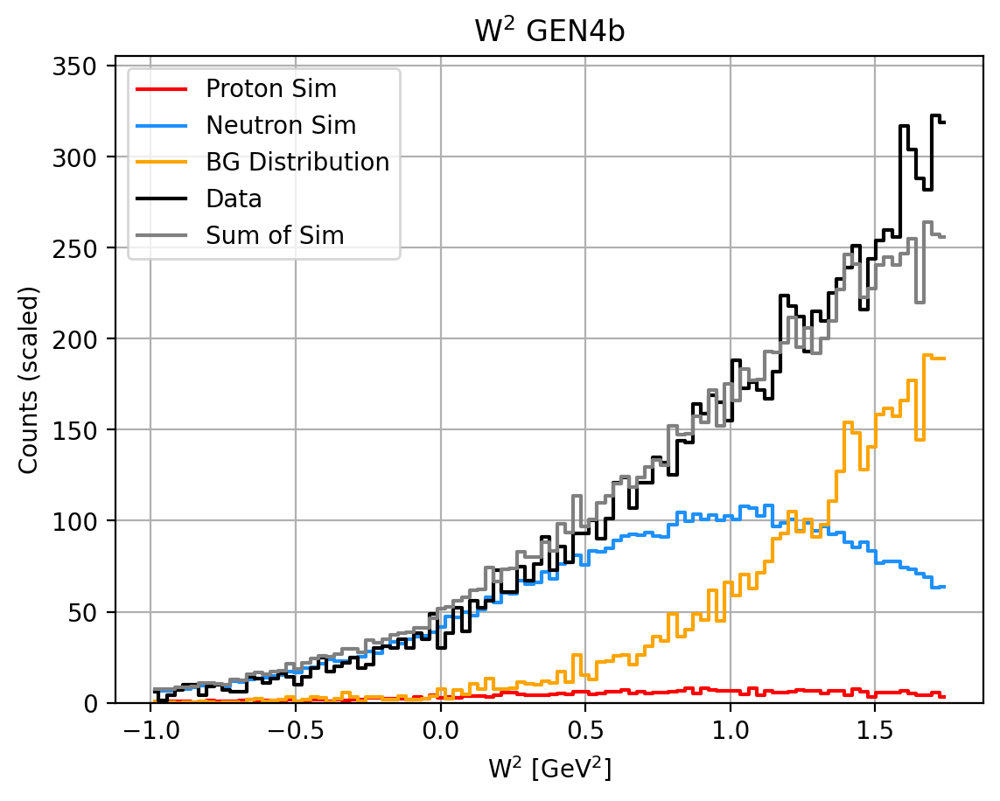

196398 196752
Total events in range (-0.25, 0.25):
  Sim Proton:   148.44
  Sim Neutron:  2387.55
  Background:   3197.44
  Total:        5781.00
Fraction of events in range (-0.25, 0.25):
   Proton Fraction: 0.04
   Background Fraction: 0.40
   W2 Background Fraction: 0.40
   Neutron Fraction: 0.56
__________________________________________________
Target Weighted Avg: 0.379+-0.0214  5.6508%
Beam Weighted Avg: 0.808+-0.0010  0.1201%
__________________________________________________
epsilon = 0.5764
tau_avg = 2.7441
Q2 = 9.6897
Px: 0.9906 Pz: -0.0257
A = 0.04486 ± 0.01610 ± 0.00287
B = 0.41788 (no propagated error)
C = 0.19259 ± 0.07667 ± 0.01365
__________________________________________________
N_plus: 3174 N_minus: 3005
A_raw: 0.0274+=0.0127
A_raw_weighted: 0.0348+-0.0123  35.2012%
__________________________________________________
A_phys_weighted: 0.214
A_phys_stat_error: 0.0767  35.8943%
A_phys_sys_error: 0.0136  6.389%
GEn/GMn*muN: 0.92892+--0.39182+--0.06974
Relative Error: 42.

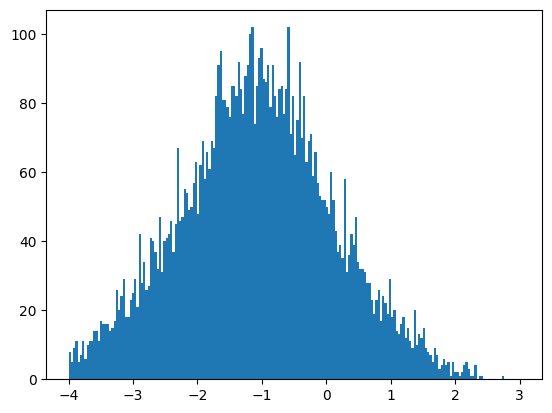

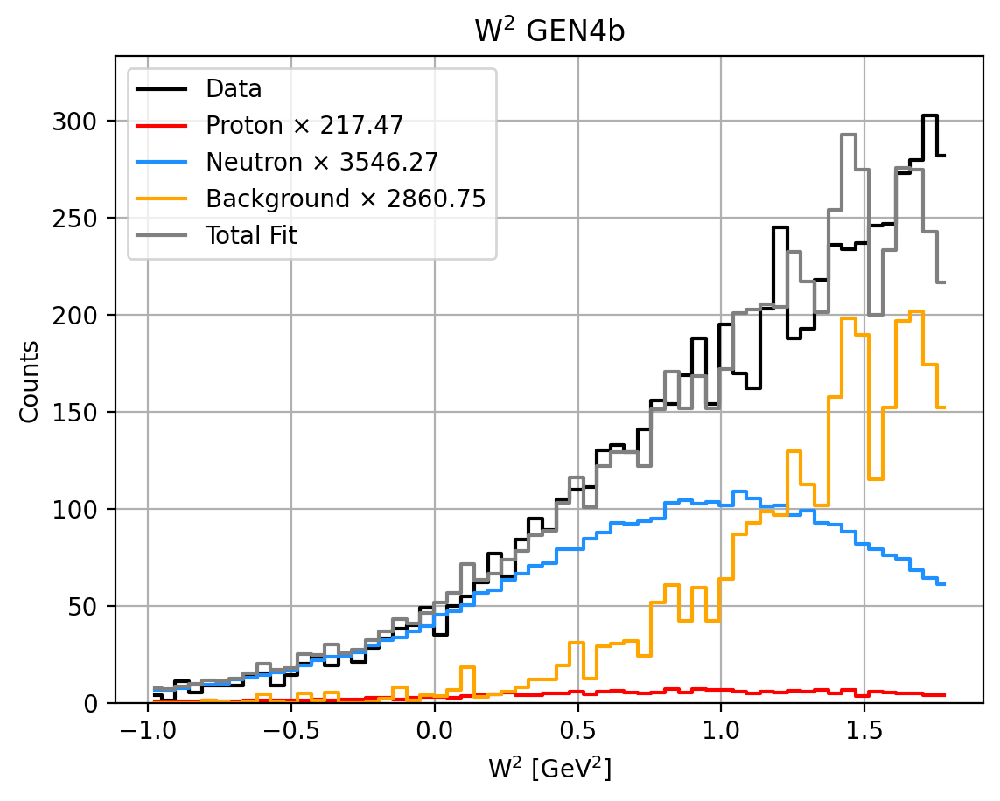

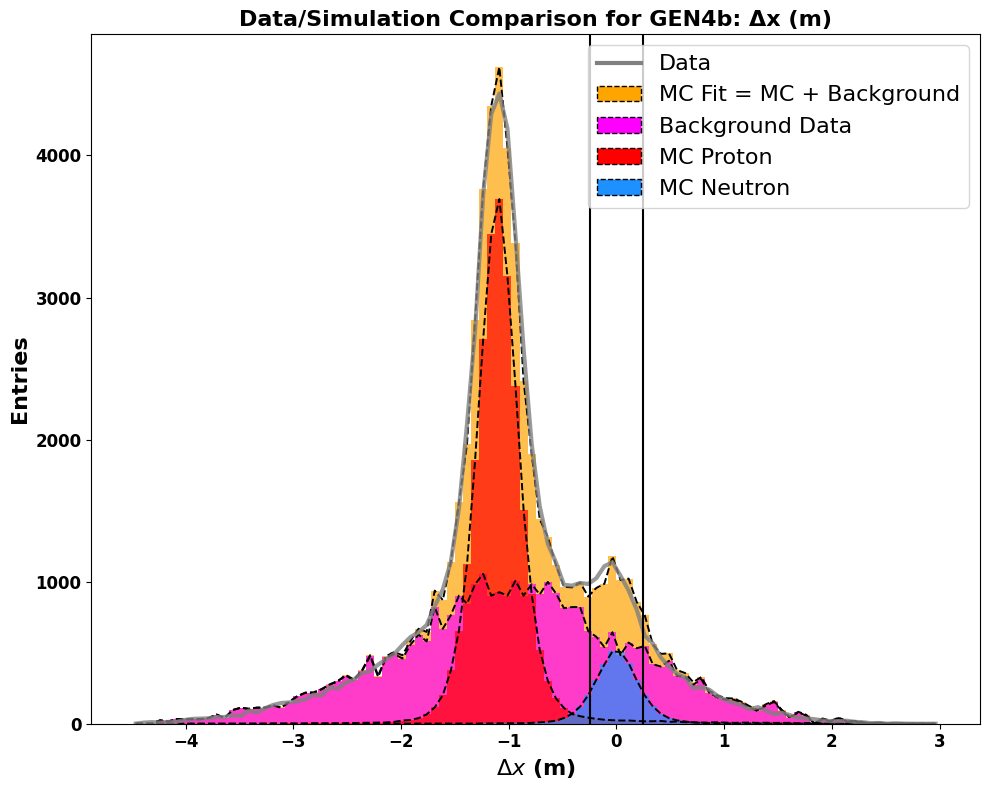

Total entries in fit: 61017.375864005895


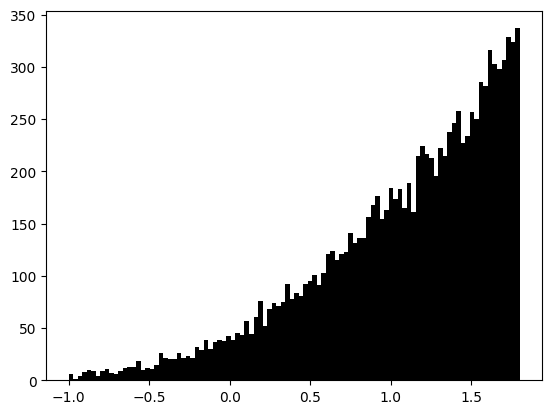

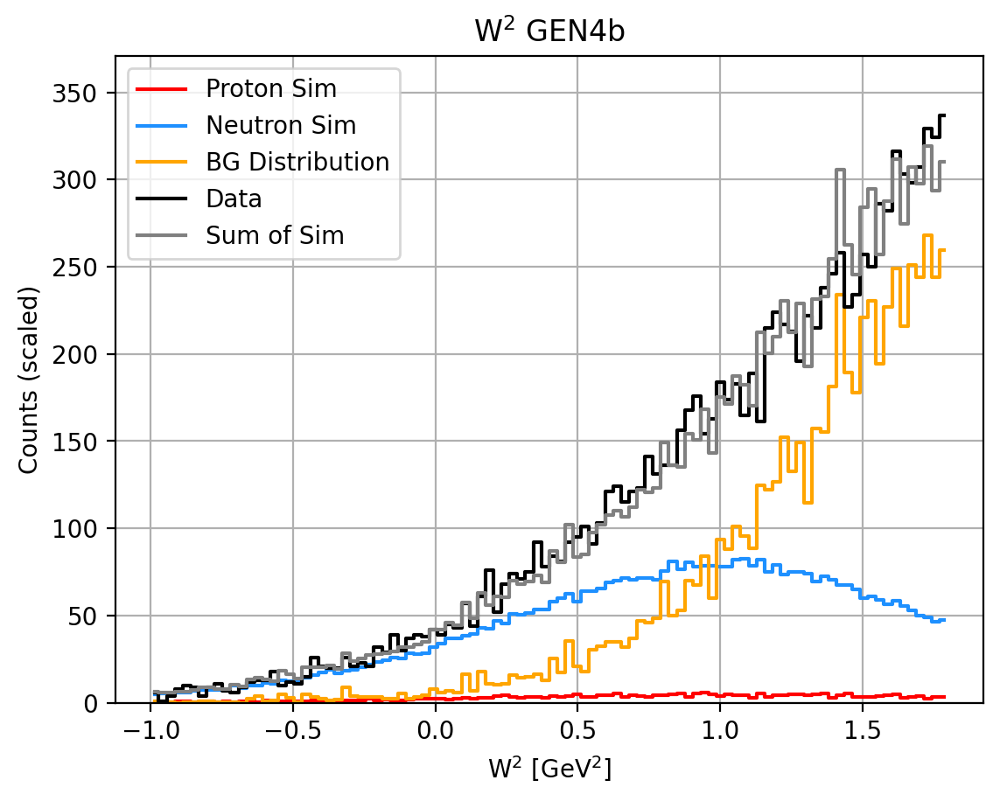

196398 196752
Total events in range (-0.25, 0.25):
  Sim Proton:   151.79
  Sim Neutron:  2475.21
  Background:   3381.07
  Total:        6052.00
Fraction of events in range (-0.25, 0.25):
   Proton Fraction: 0.03
   Background Fraction: 0.56
   W2 Background Fraction: 0.43
   Neutron Fraction: 0.41
__________________________________________________
Target Weighted Avg: 0.379+-0.0215  5.6623%
Beam Weighted Avg: 0.808+-0.0010  0.1201%
__________________________________________________
epsilon = 0.5770
tau_avg = 2.7373
Q2 = 9.6656
Px: 0.9906 Pz: -0.0249
A = 0.05227 ± 0.02130 ± 0.00370
B = 0.41833 (no propagated error)
C = 0.22764 ± 0.10103 ± 0.01753
__________________________________________________
N_plus: 3321 N_minus: 3151
A_raw: 0.0263+=0.0124
A_raw_weighted: 0.0301+-0.0120  39.7585%
__________________________________________________
A_phys_weighted: 0.248
A_phys_stat_error: 0.1010  40.7408%
A_phys_sys_error: 0.0175  7.069%
GEn/GMn*muN: 1.12185+--0.54213+--0.09407
Relative Error: 49.

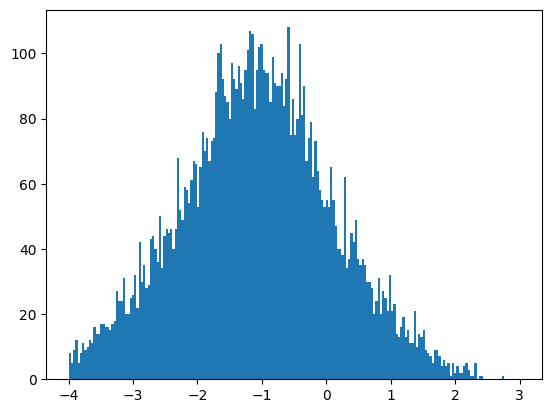

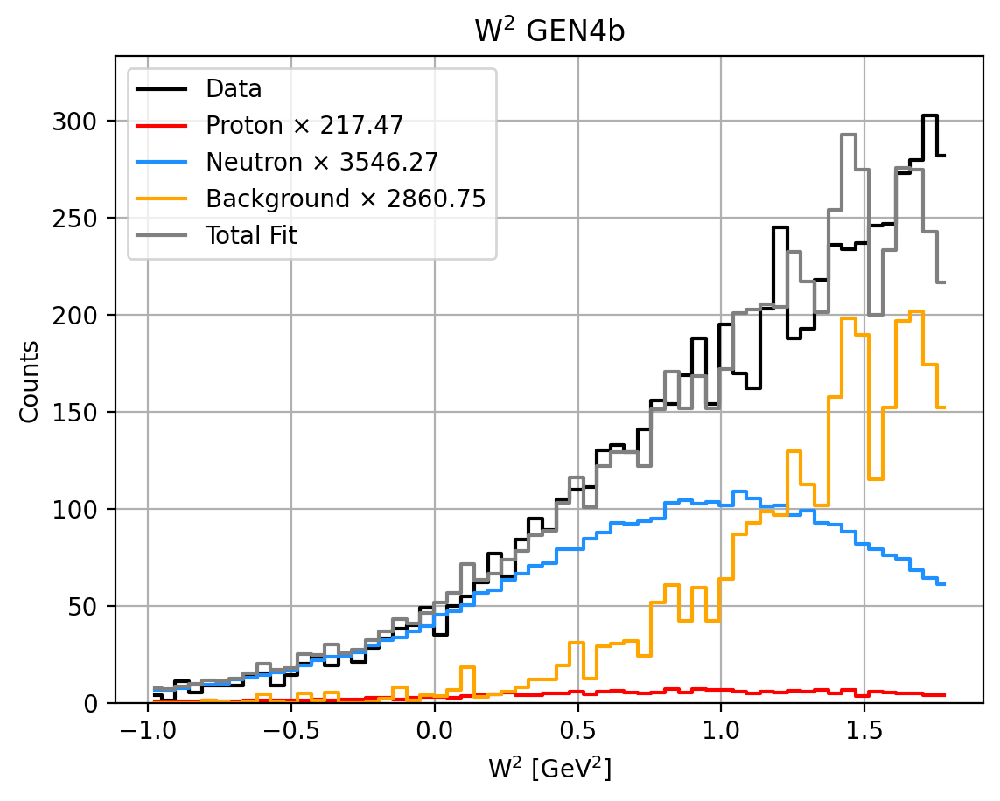

0.5681553377551997 0.034842018978654105 0.5333133187765455 0.43184466224480034


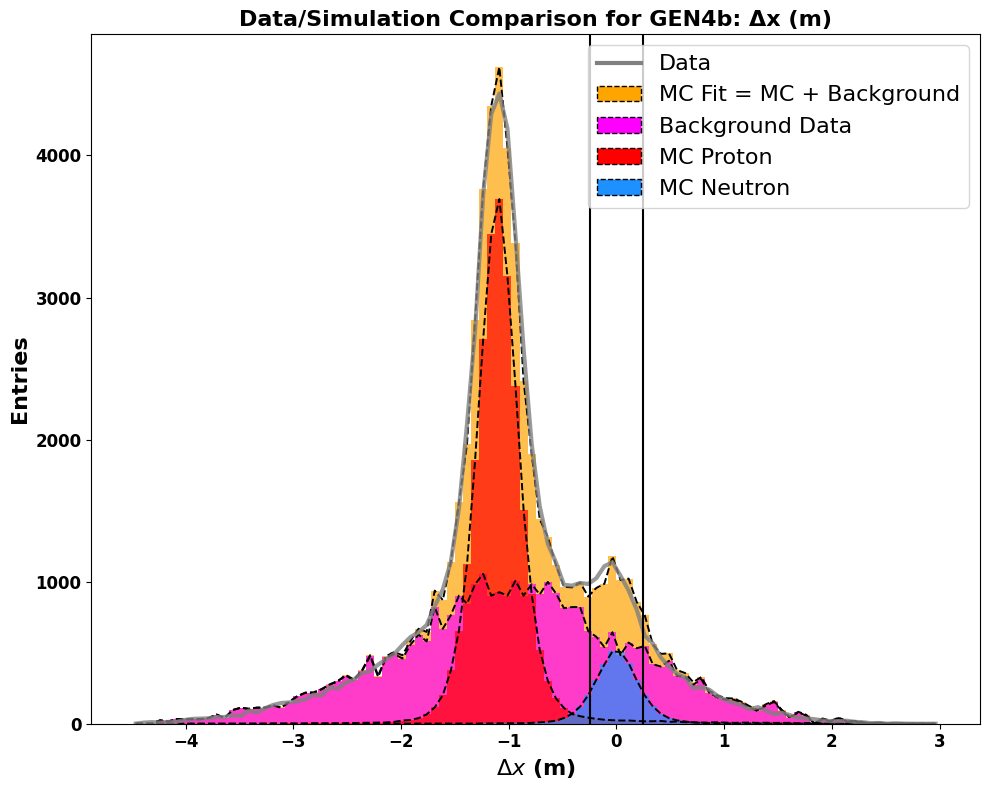

Total entries in fit: 61017.375864005895


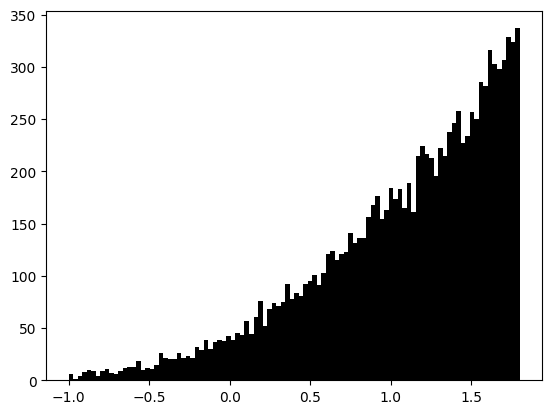

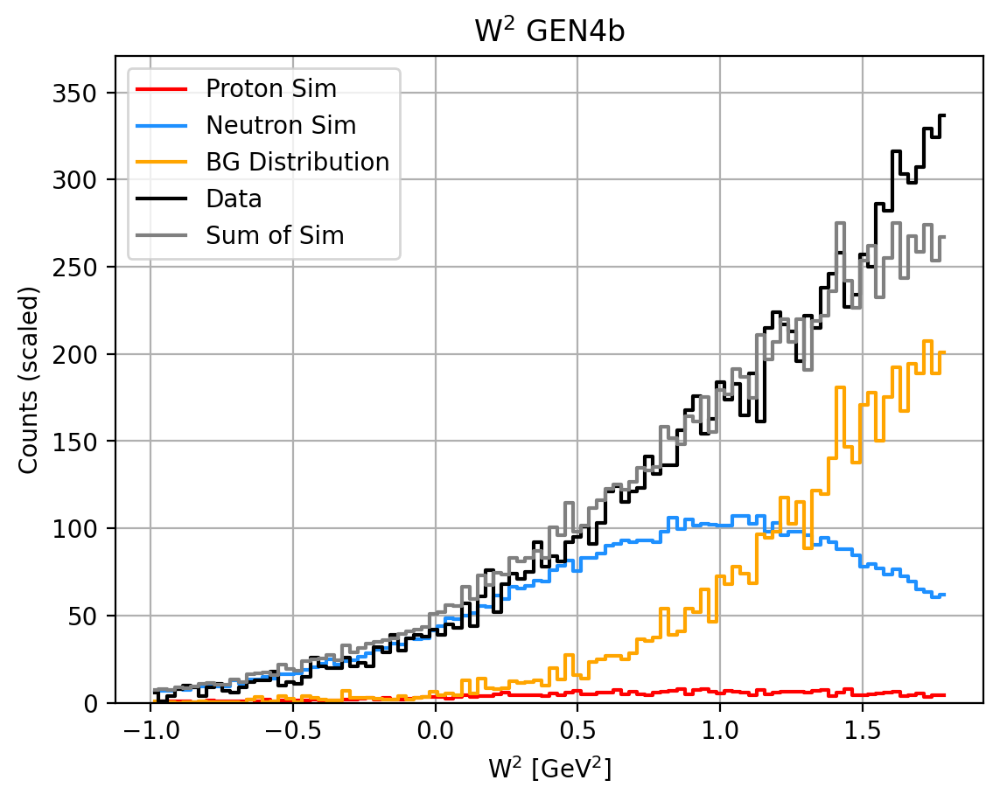

196398 196752
Total events in range (-0.25, 0.25):
  Sim Proton:   151.79
  Sim Neutron:  2475.21
  Background:   3381.07
  Total:        6052.00
Fraction of events in range (-0.25, 0.25):
   Proton Fraction: 0.03
   Background Fraction: 0.43
   W2 Background Fraction: 0.43
   Neutron Fraction: 0.53
__________________________________________________
Target Weighted Avg: 0.379+-0.0215  5.6623%
Beam Weighted Avg: 0.808+-0.0010  0.1201%
__________________________________________________
epsilon = 0.5770
tau_avg = 2.7373
Q2 = 9.6656
Px: 0.9906 Pz: -0.0249
A = 0.04064 ± 0.01662 ± 0.00267
B = 0.41833 (no propagated error)
C = 0.17247 ± 0.07885 ± 0.01268
__________________________________________________
N_plus: 3321 N_minus: 3151
A_raw: 0.0263+=0.0124
A_raw_weighted: 0.0301+-0.0120  39.7585%
__________________________________________________
A_phys_weighted: 0.193
A_phys_stat_error: 0.0789  40.8971%
A_phys_sys_error: 0.0127  6.579%
GEn/GMn*muN: 0.82194+--0.39323+--0.06325
Relative Error: 48.

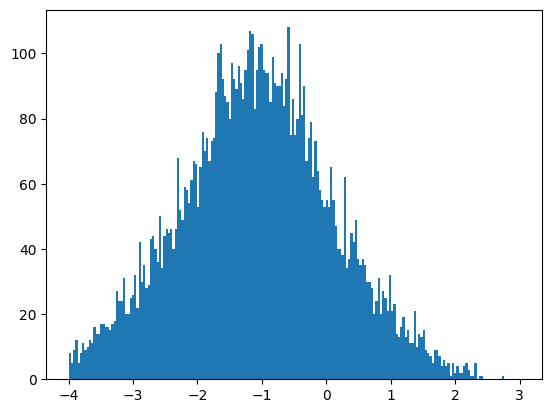

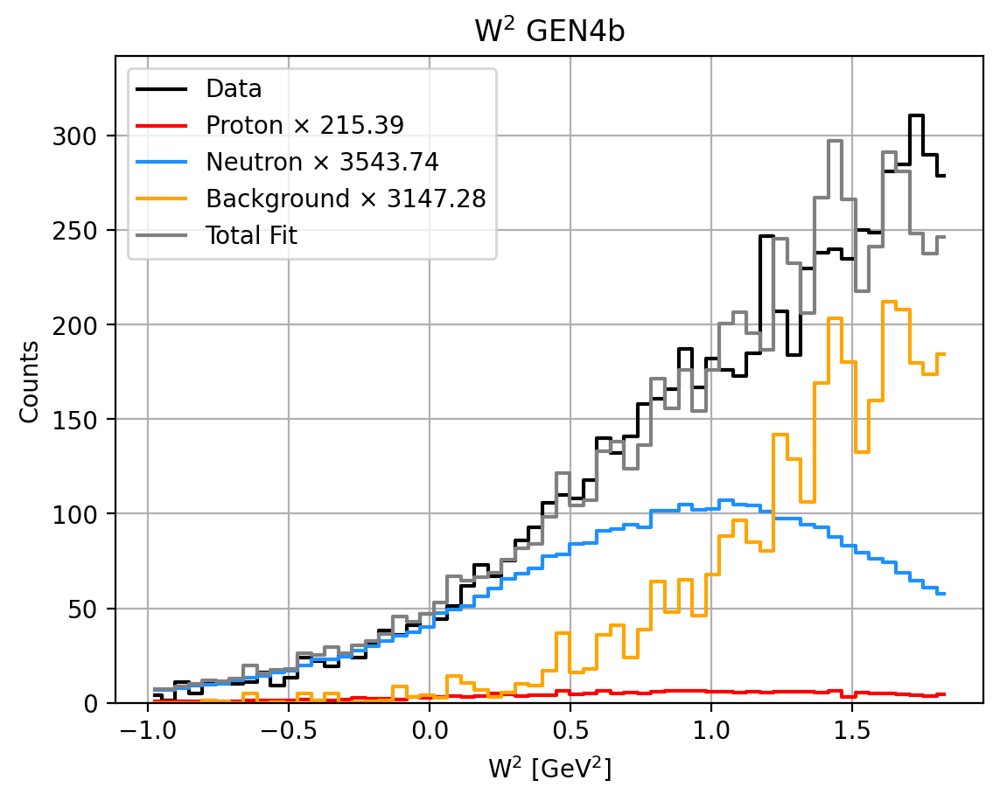

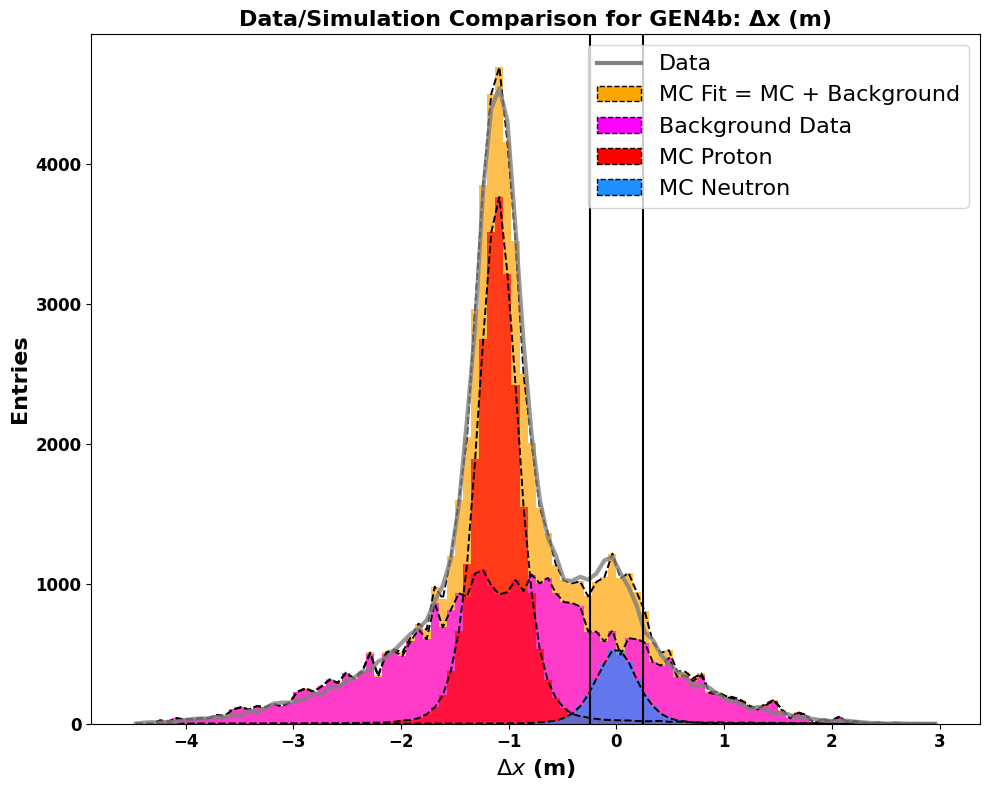

Total entries in fit: 63436.53296028876


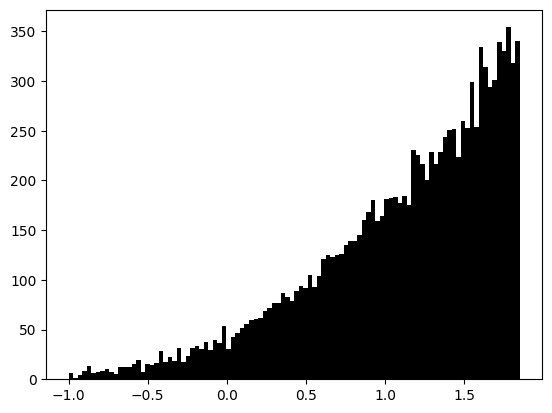

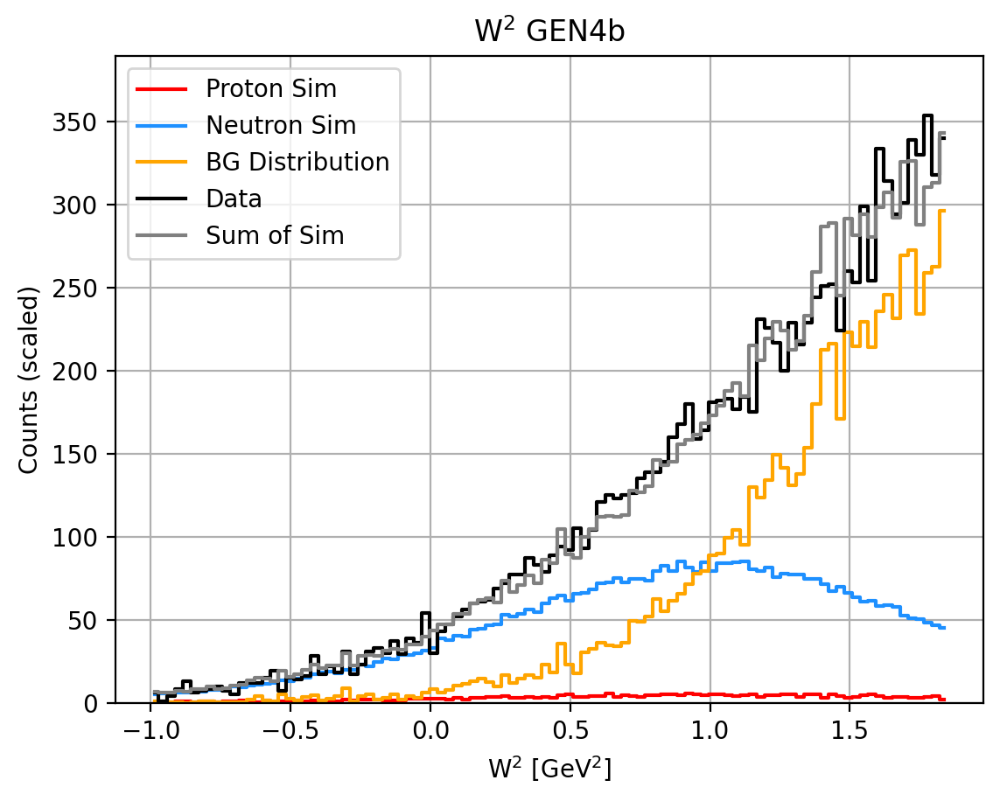

196398 196752
Total events in range (-0.25, 0.25):
  Sim Proton:   155.30
  Sim Neutron:  2555.12
  Background:   3619.17
  Total:        6326.00
Fraction of events in range (-0.25, 0.25):
   Proton Fraction: 0.02
   Background Fraction: 0.57
   W2 Background Fraction: 0.46
   Neutron Fraction: 0.40
__________________________________________________
Target Weighted Avg: 0.379+-0.0214  5.6559%
Beam Weighted Avg: 0.808+-0.0010  0.1201%
__________________________________________________
epsilon = 0.5776
tau_avg = 2.7307
Q2 = 9.6424
Px: 0.9907 Pz: -0.0241
A = 0.05826 ± 0.02161 ± 0.00410
B = 0.41877 (no propagated error)
C = 0.25568 ± 0.10214 ± 0.01939
__________________________________________________
N_plus: 3478 N_minus: 3281
A_raw: 0.0291+=0.0122
A_raw_weighted: 0.0322+-0.0117  36.4500%
__________________________________________________
A_phys_weighted: 0.275
A_phys_stat_error: 0.1021  37.0882%
A_phys_sys_error: 0.0194  7.039%
GEn/GMn*muN: 1.28696+--0.57604+--0.10933
Relative Error: 45.

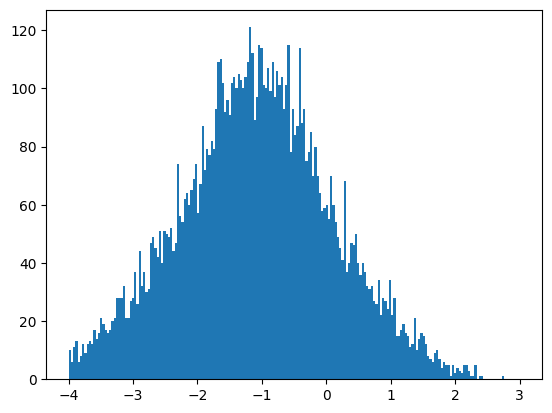

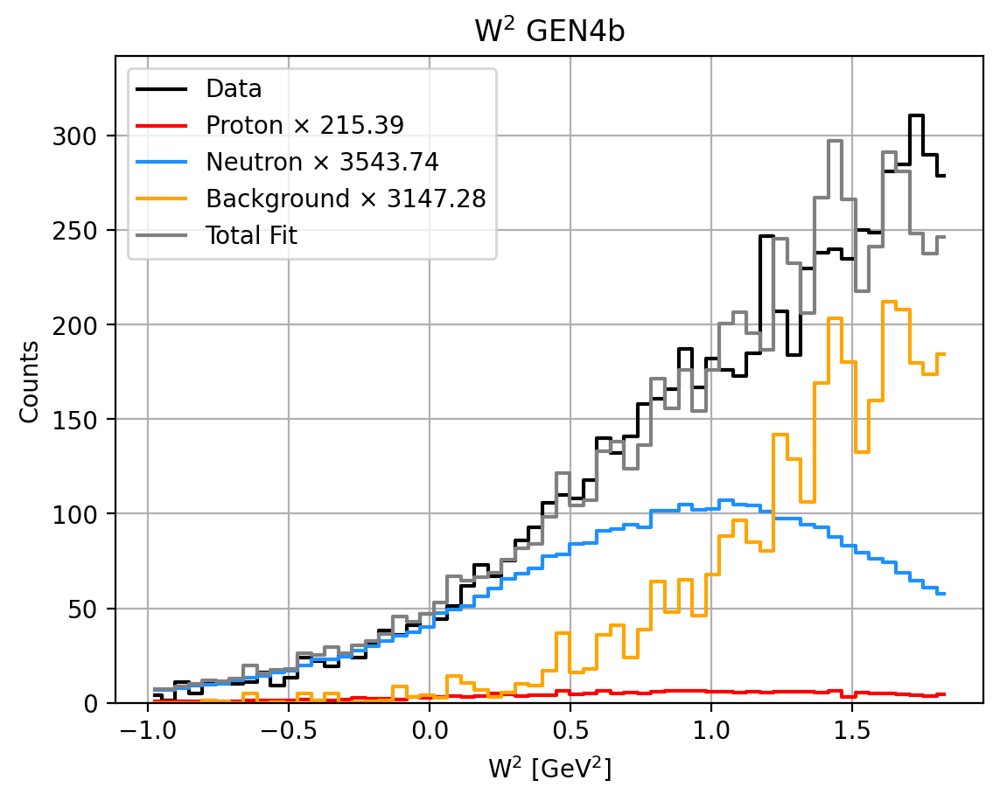

0.544295783268059 0.03308304611003454 0.5112127371580245 0.455704216731941


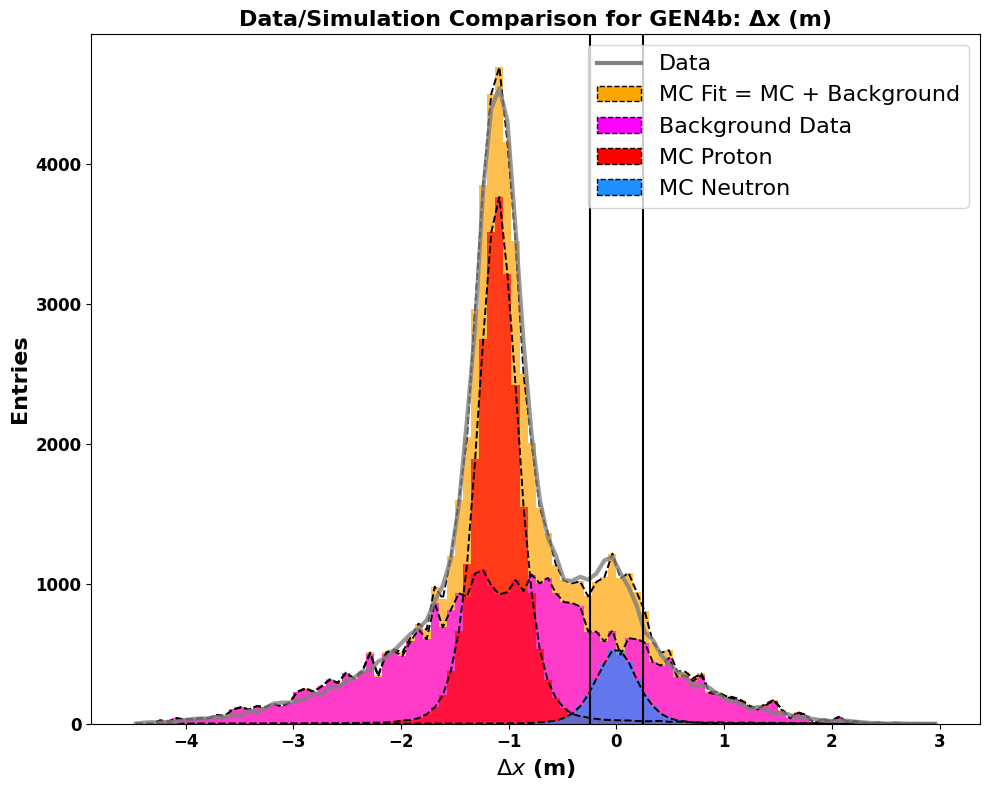

Total entries in fit: 63436.53296028876


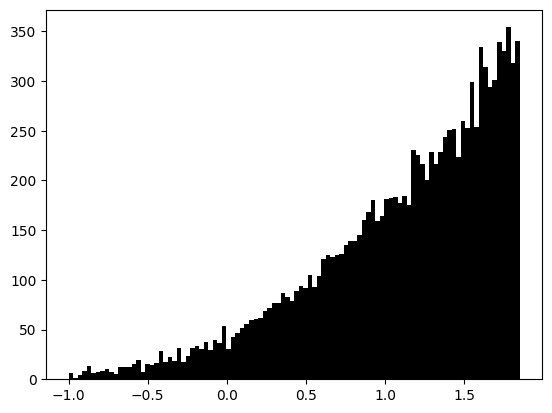

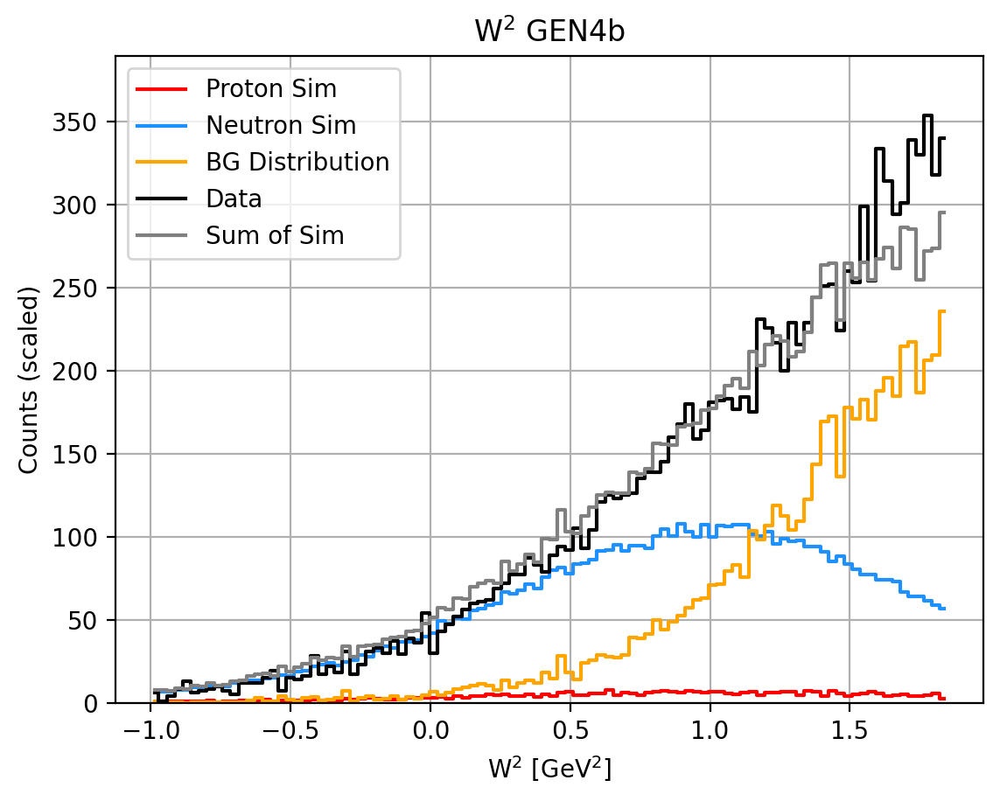

196398 196752
Total events in range (-0.25, 0.25):
  Sim Proton:   155.30
  Sim Neutron:  2555.12
  Background:   3619.17
  Total:        6326.00
Fraction of events in range (-0.25, 0.25):
   Proton Fraction: 0.03
   Background Fraction: 0.46
   W2 Background Fraction: 0.46
   Neutron Fraction: 0.51
__________________________________________________
Target Weighted Avg: 0.379+-0.0214  5.6559%
Beam Weighted Avg: 0.808+-0.0010  0.1201%
__________________________________________________
epsilon = 0.5776
tau_avg = 2.7307
Q2 = 9.6424
Px: 0.9907 Pz: -0.0241
A = 0.04581 ± 0.01705 ± 0.00302
B = 0.41877 (no propagated error)
C = 0.19686 ± 0.08059 ± 0.01426
__________________________________________________
N_plus: 3478 N_minus: 3281
A_raw: 0.0291+=0.0122
A_raw_weighted: 0.0322+-0.0117  36.4500%
__________________________________________________
A_phys_weighted: 0.217
A_phys_stat_error: 0.0806  37.2096%
A_phys_sys_error: 0.0143  6.586%
GEn/GMn*muN: 0.94967+--0.41304+--0.07310
Relative Error: 44.

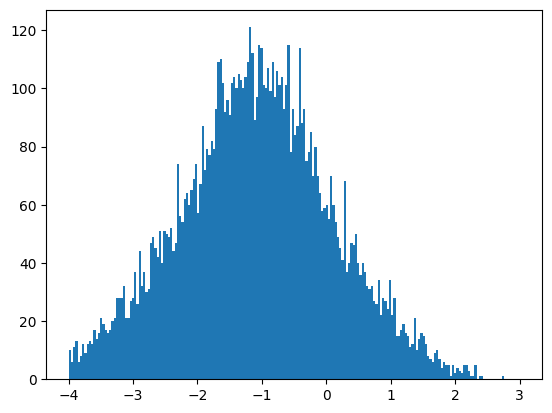

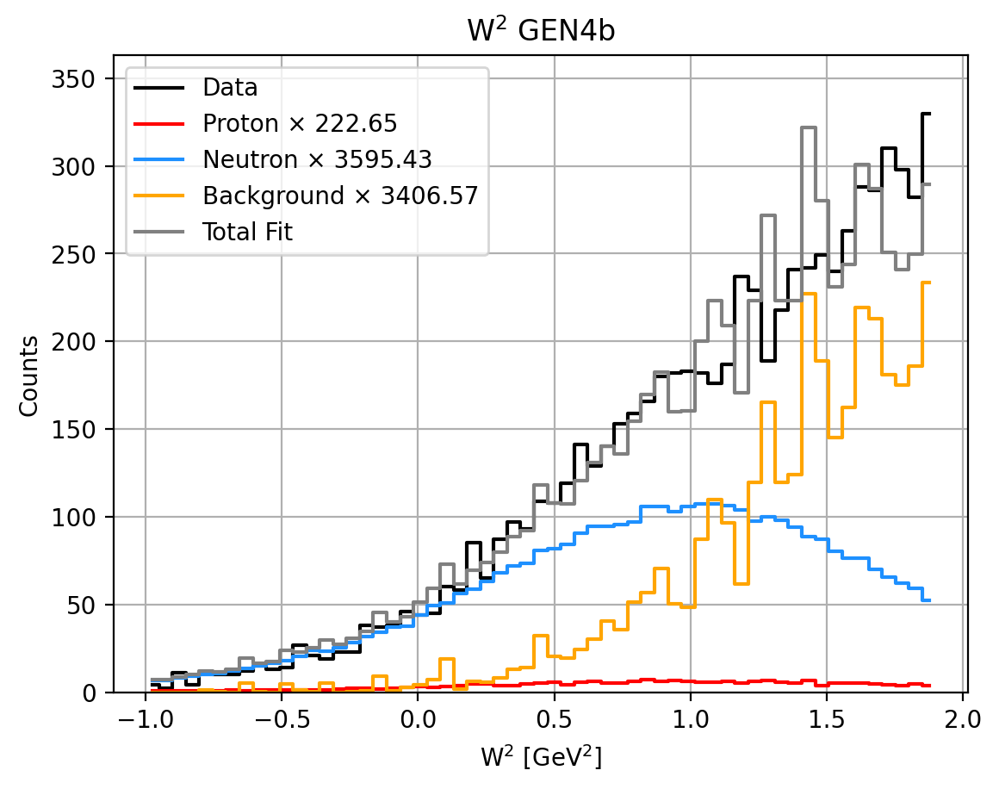

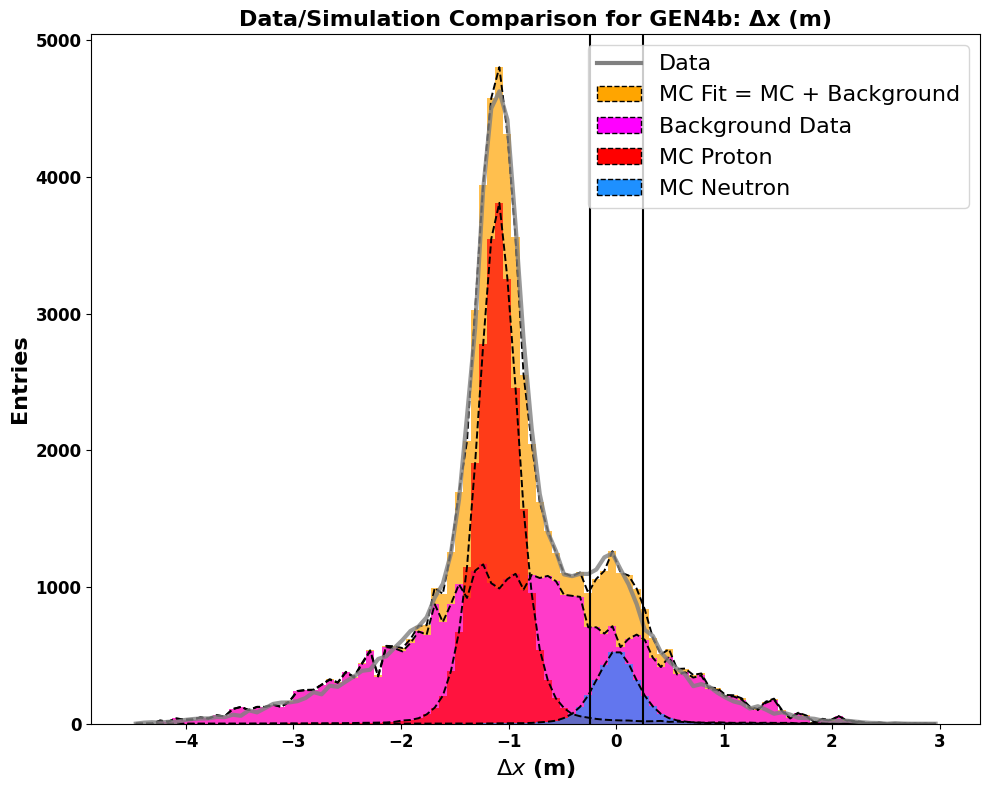

Total entries in fit: 66006.41421764912


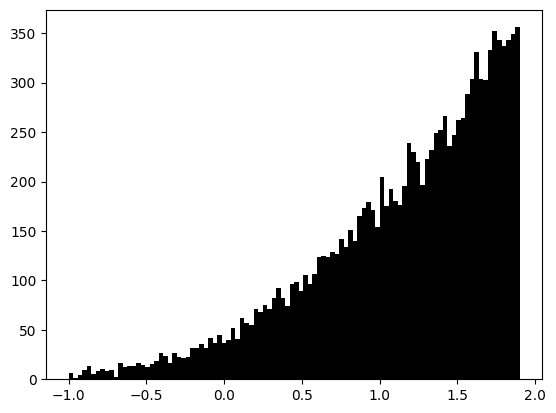

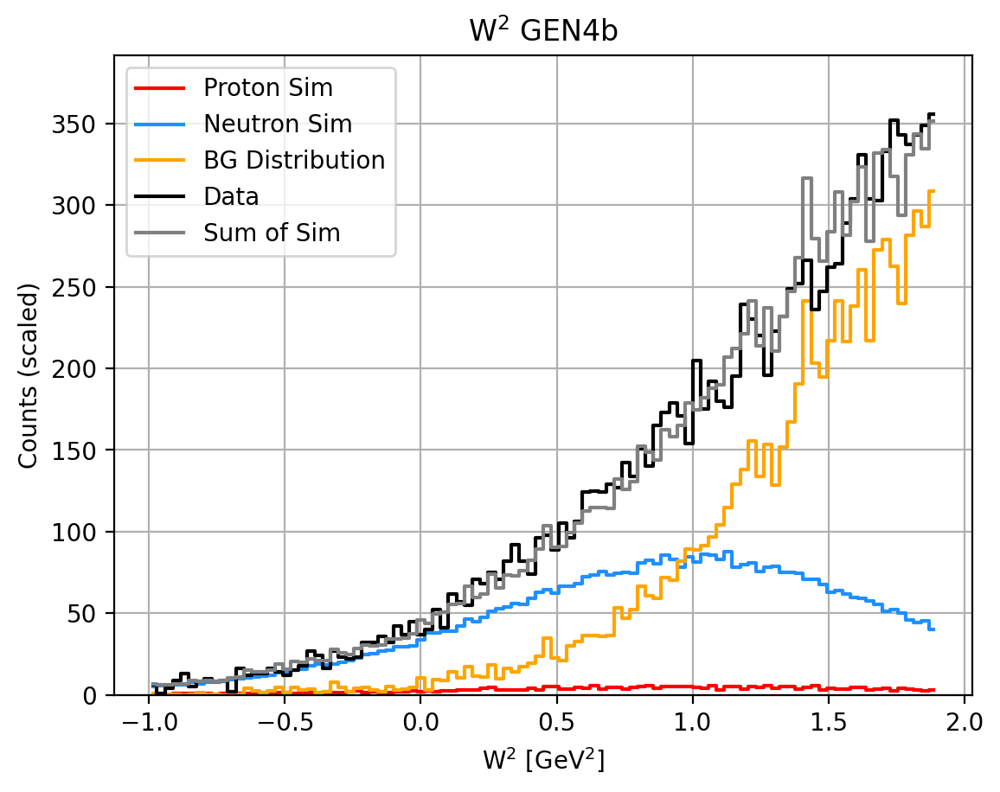

196398 196752
Total events in range (-0.25, 0.25):
  Sim Proton:   157.90
  Sim Neutron:  2549.74
  Background:   3912.83
  Total:        6618.00
Fraction of events in range (-0.25, 0.25):
   Proton Fraction: 0.02
   Background Fraction: 0.59
   W2 Background Fraction: 0.47
   Neutron Fraction: 0.39
__________________________________________________
Target Weighted Avg: 0.379+-0.0214  5.6522%
Beam Weighted Avg: 0.808+-0.0010  0.1201%
__________________________________________________
epsilon = 0.5784
tau_avg = 2.7231
Q2 = 9.6158
Px: 0.9908 Pz: -0.0234
A = 0.05207 ± 0.02220 ± 0.00383
B = 0.41928 (no propagated error)
C = 0.22605 ± 0.10453 ± 0.01805
__________________________________________________
N_plus: 3635 N_minus: 3448
A_raw: 0.0264+=0.0119
A_raw_weighted: 0.0276+-0.0115  41.4549%
__________________________________________________
A_phys_weighted: 0.245
A_phys_stat_error: 0.1045  42.6453%
A_phys_sys_error: 0.0180  7.362%
GEn/GMn*muN: 1.11001+--0.55802+--0.09633
Relative Error: 51.

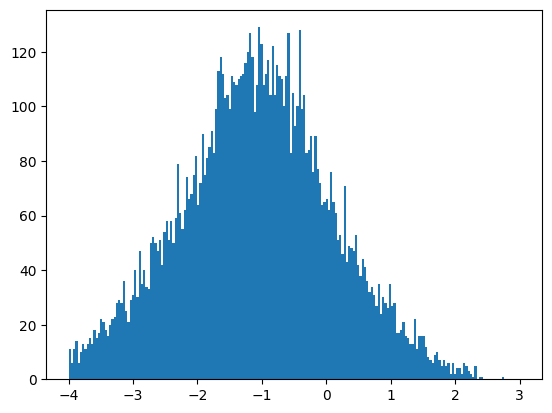

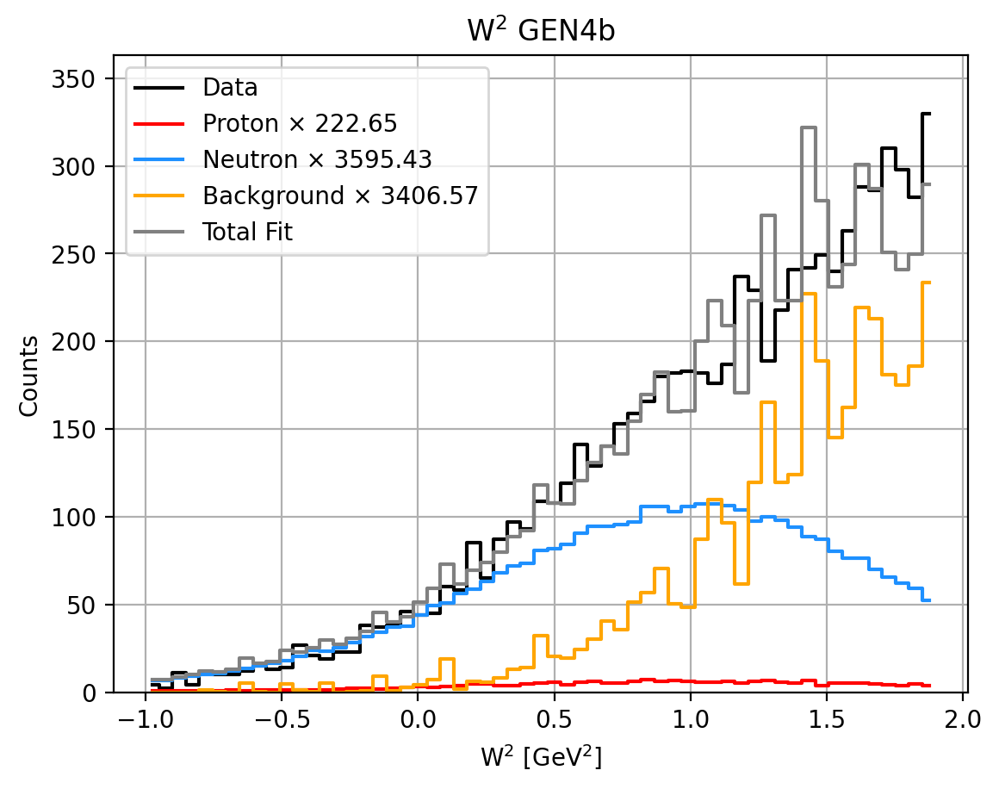

0.5284796174535473 0.03272659265445736 0.49575302479908995 0.47152038254645257


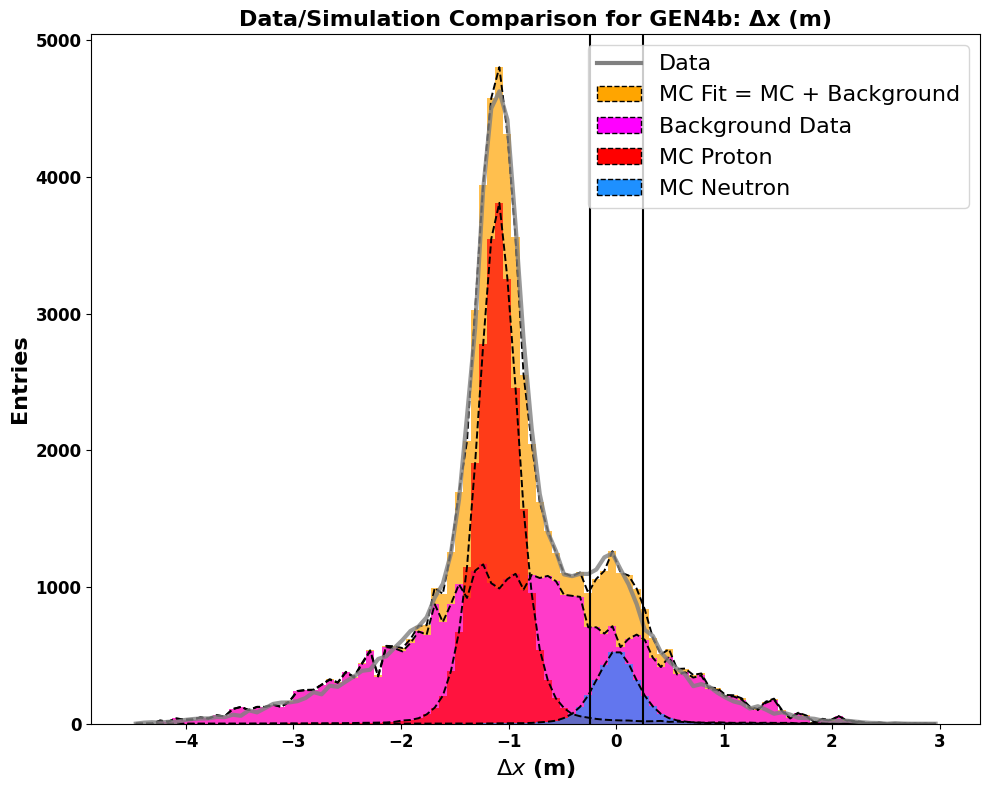

Total entries in fit: 66006.41421764912


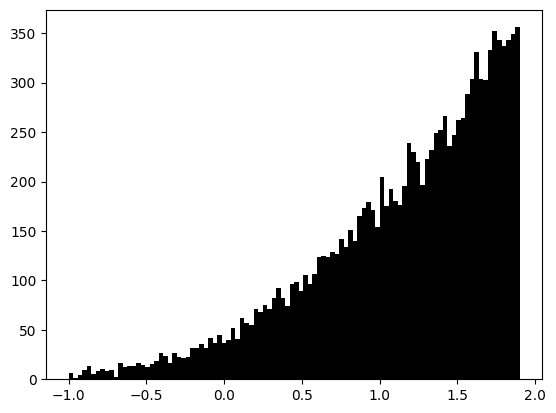

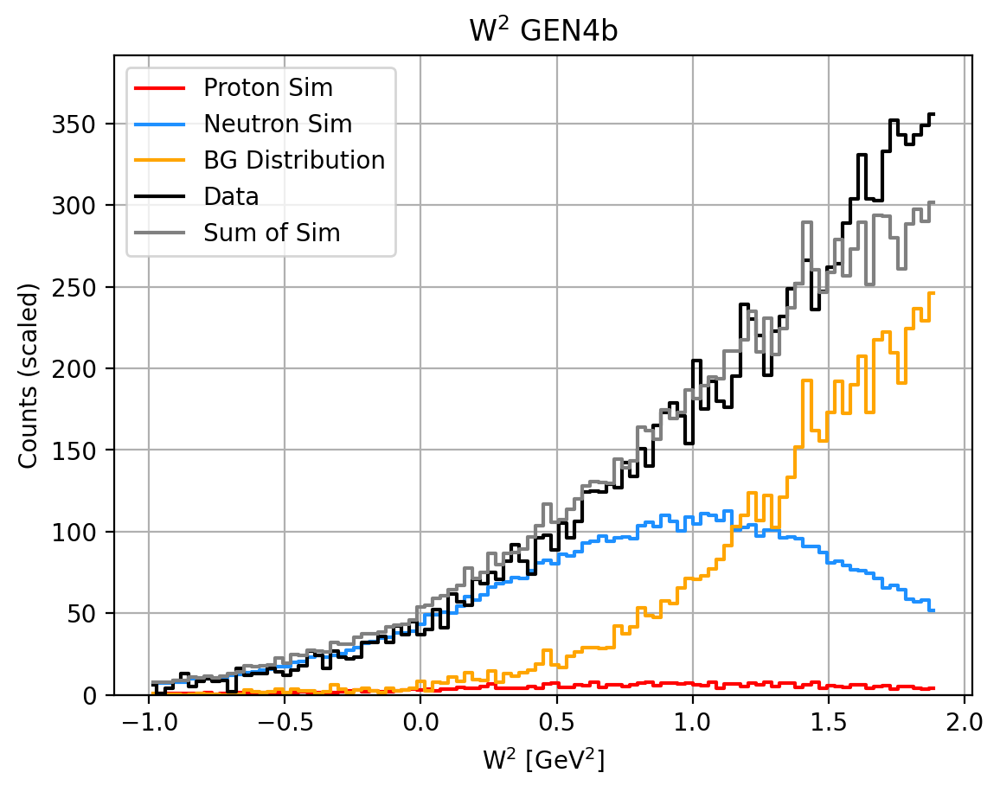

196398 196752
Total events in range (-0.25, 0.25):
  Sim Proton:   157.90
  Sim Neutron:  2549.74
  Background:   3912.83
  Total:        6618.00
Fraction of events in range (-0.25, 0.25):
   Proton Fraction: 0.03
   Background Fraction: 0.47
   W2 Background Fraction: 0.47
   Neutron Fraction: 0.50
__________________________________________________
Target Weighted Avg: 0.379+-0.0214  5.6522%
Beam Weighted Avg: 0.808+-0.0010  0.1201%
__________________________________________________
epsilon = 0.5784
tau_avg = 2.7231
Q2 = 9.6158
Px: 0.9908 Pz: -0.0234
A = 0.04027 ± 0.01724 ± 0.00274
B = 0.41928 (no propagated error)
C = 0.17049 ± 0.08116 ± 0.01289
__________________________________________________
N_plus: 3635 N_minus: 3448
A_raw: 0.0264+=0.0119
A_raw_weighted: 0.0276+-0.0115  41.4549%
__________________________________________________
A_phys_weighted: 0.19
A_phys_stat_error: 0.0812  42.8146%
A_phys_sys_error: 0.0129  6.797%
GEn/GMn*muN: 0.80972+--0.40284+--0.06396
Relative Error: 50.3

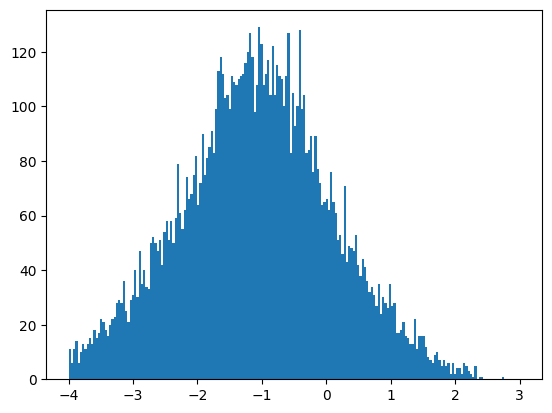

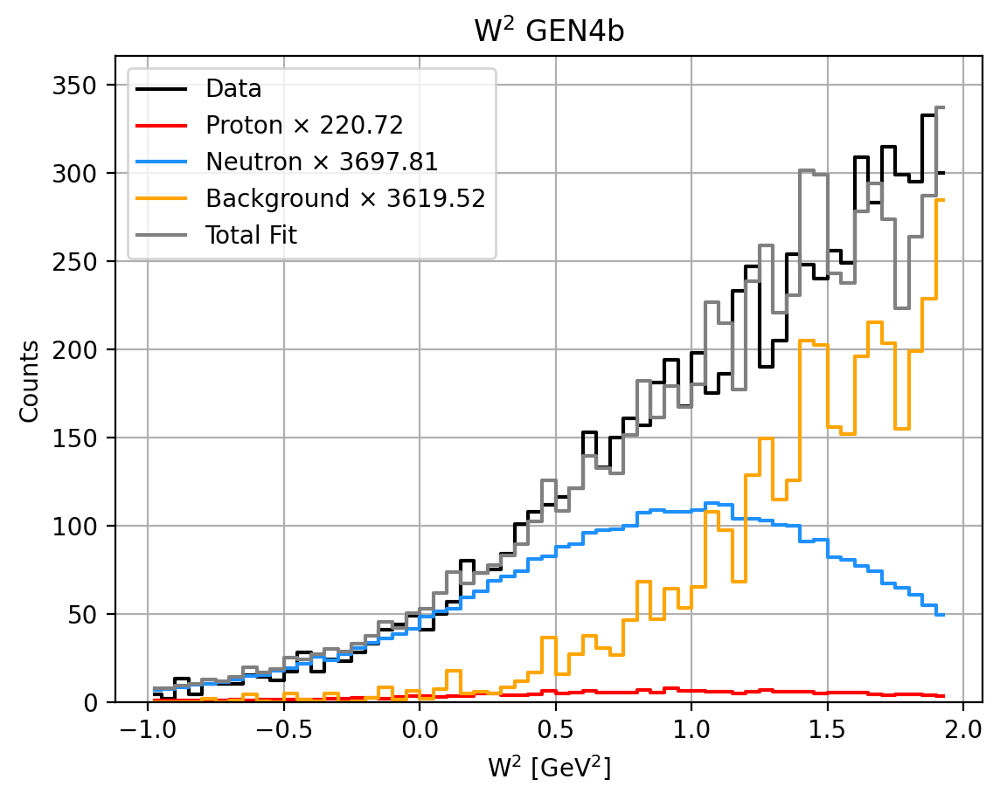

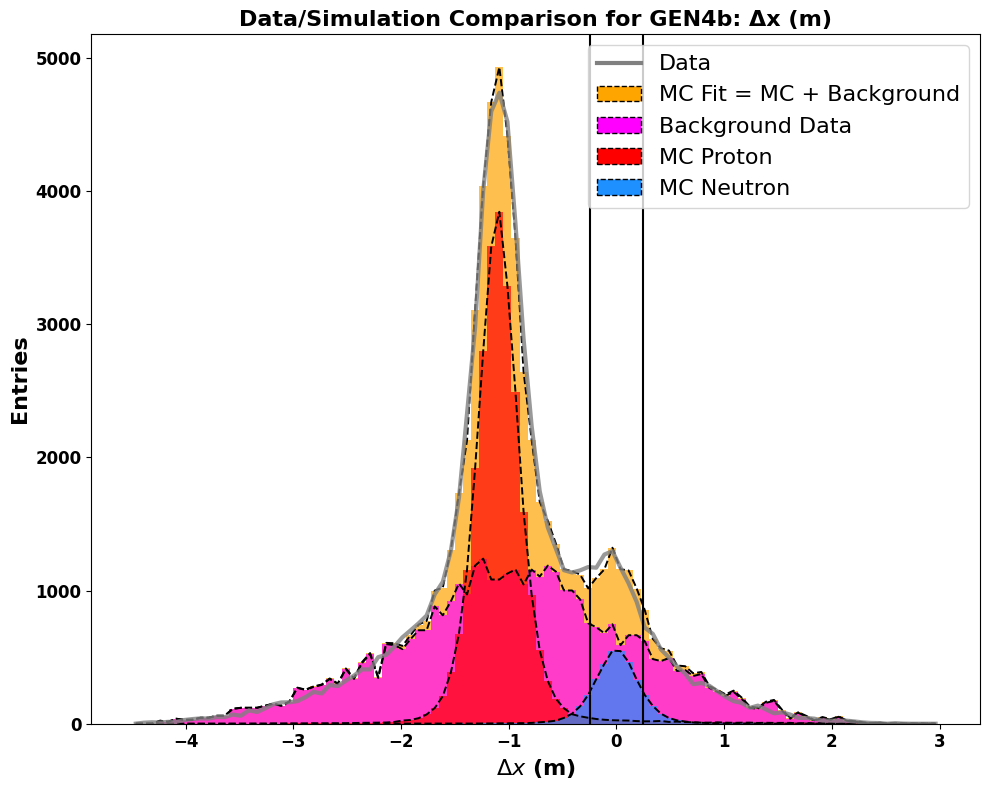

Total entries in fit: 68483.70852032005


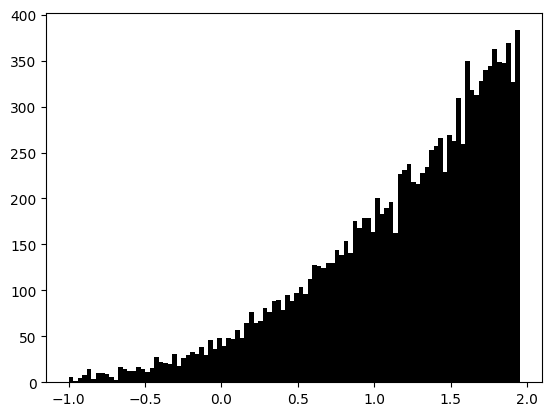

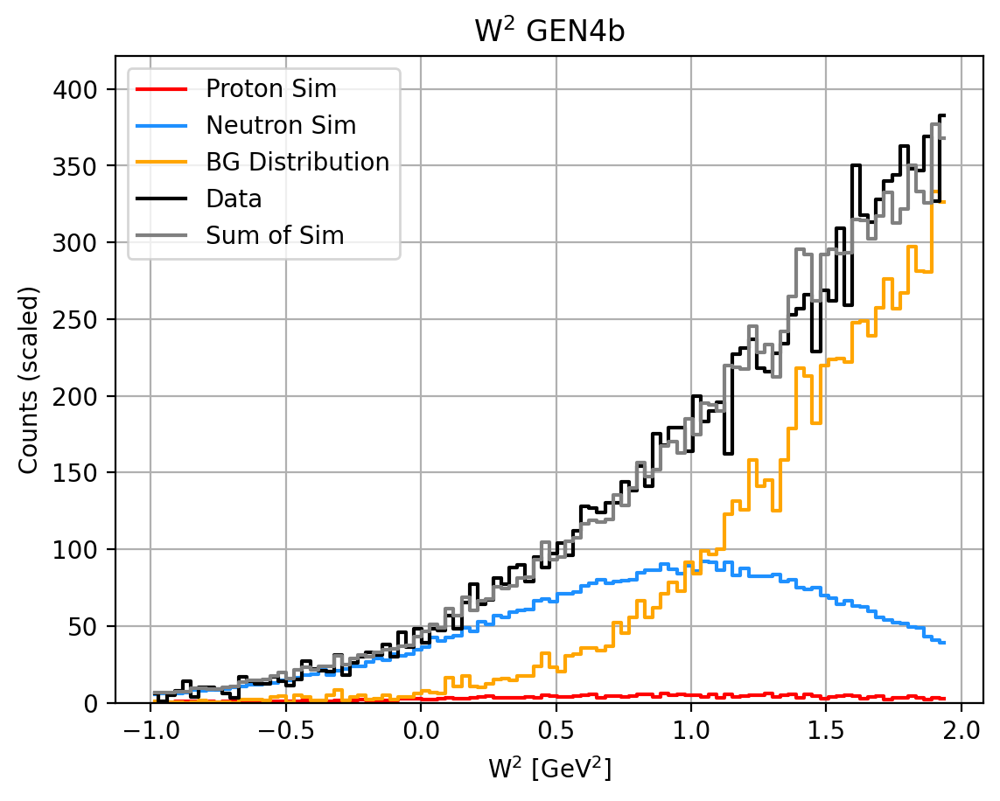

196398 196752
Total events in range (-0.25, 0.25):
  Sim Proton:   159.55
  Sim Neutron:  2672.89
  Background:   4071.44
  Total:        6882.00
Fraction of events in range (-0.25, 0.25):
   Proton Fraction: 0.02
   Background Fraction: 0.59
   W2 Background Fraction: 0.48
   Neutron Fraction: 0.39
__________________________________________________
Target Weighted Avg: 0.379+-0.0214  5.6519%
Beam Weighted Avg: 0.808+-0.0010  0.1201%
__________________________________________________
epsilon = 0.5792
tau_avg = 2.7161
Q2 = 9.5910
Px: 0.9908 Pz: -0.0227
A = 0.04837 ± 0.02185 ± 0.00361
B = 0.41972 (no propagated error)
C = 0.20831 ± 0.10245 ± 0.01692
__________________________________________________
N_plus: 3783 N_minus: 3599
A_raw: 0.0249+=0.0116
A_raw_weighted: 0.0258+-0.0112  43.5301%
__________________________________________________
A_phys_weighted: 0.227
A_phys_stat_error: 0.1024  45.1679%
A_phys_sys_error: 0.0169  7.462%
GEn/GMn*muN: 1.00960+--0.53189+--0.08787
Relative Error: 53.

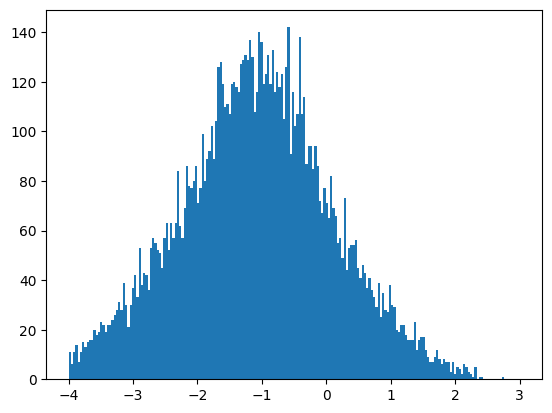

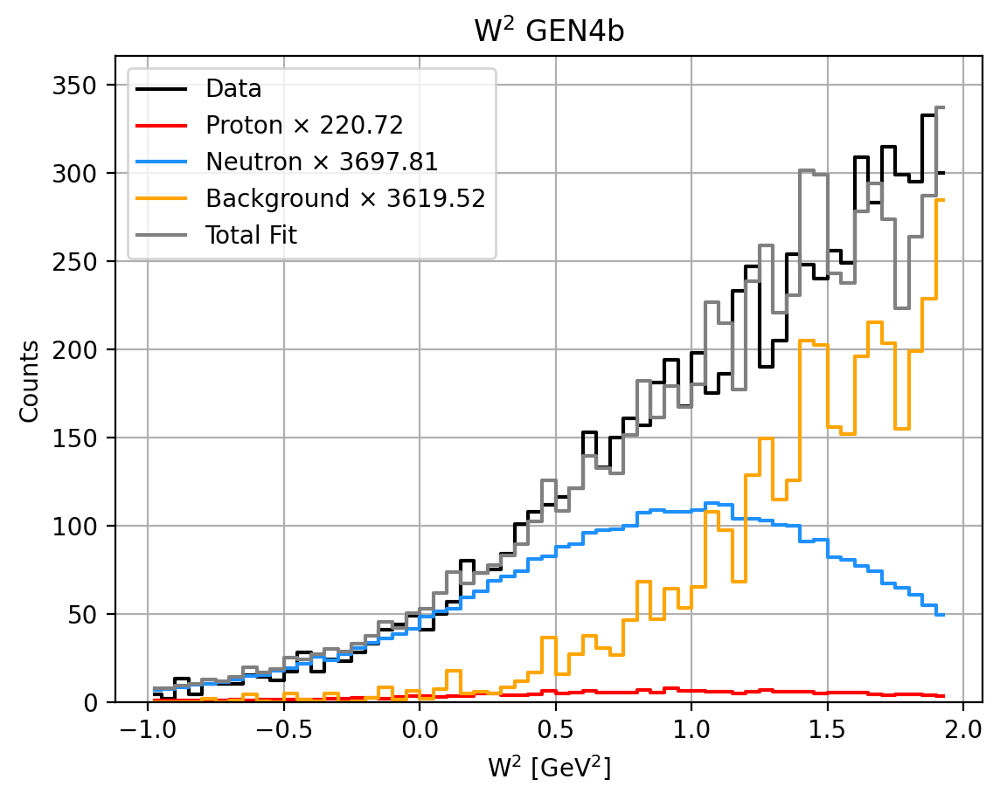

0.5198335219008148 0.031029150748355844 0.48880437115245895 0.48016647809918517


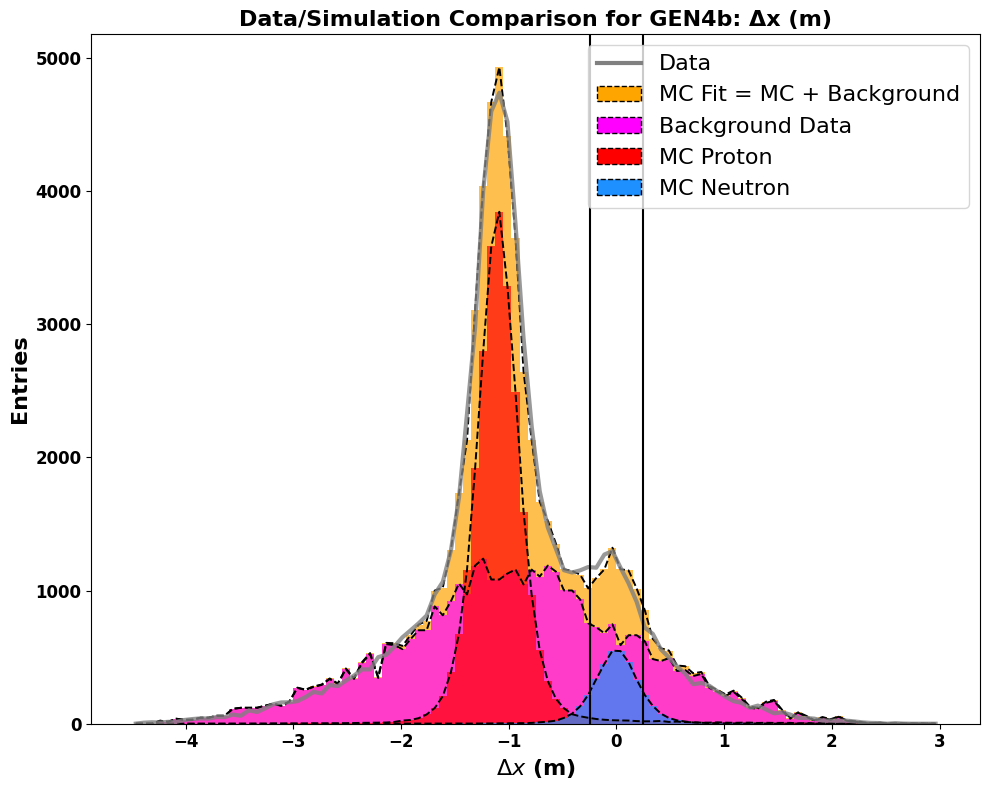

Total entries in fit: 68483.70852032005


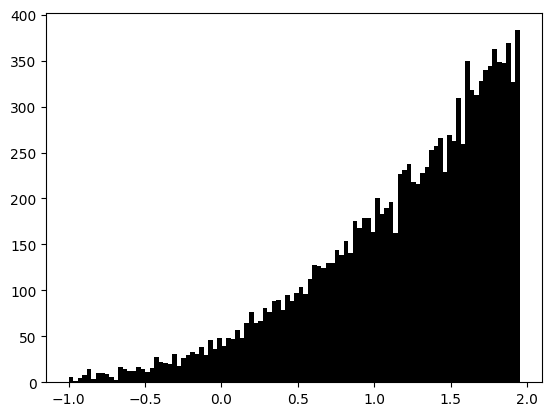

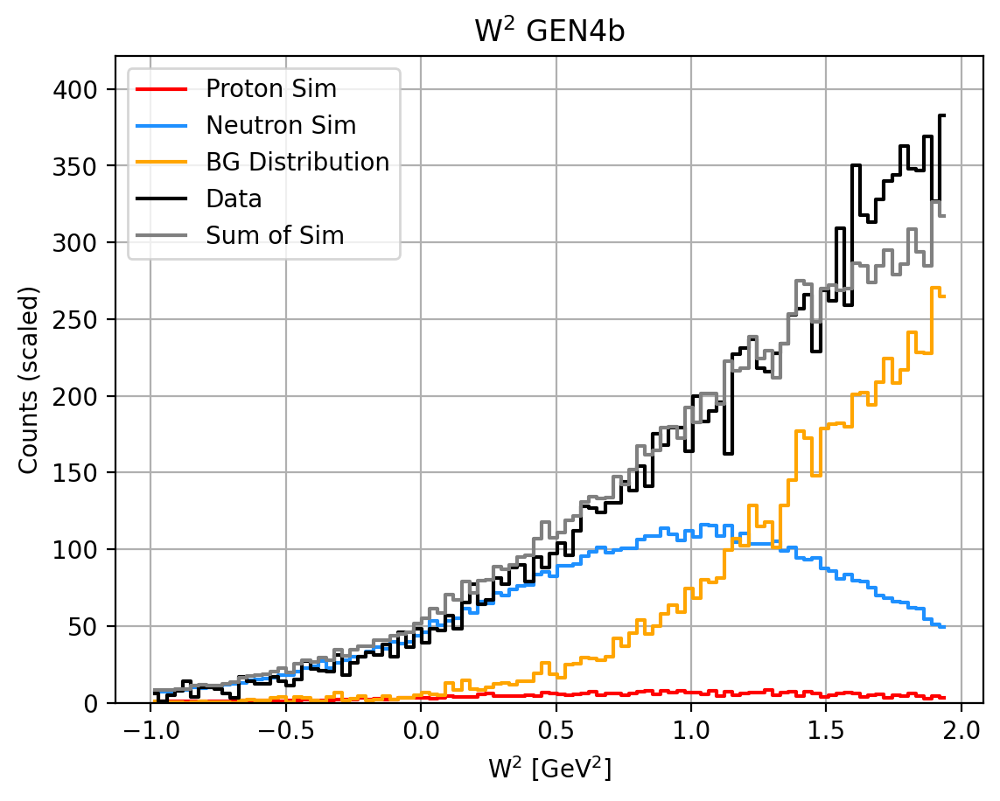

196398 196752
Total events in range (-0.25, 0.25):
  Sim Proton:   159.55
  Sim Neutron:  2672.89
  Background:   4071.44
  Total:        6882.00
Fraction of events in range (-0.25, 0.25):
   Proton Fraction: 0.03
   Background Fraction: 0.48
   W2 Background Fraction: 0.48
   Neutron Fraction: 0.49
__________________________________________________
Target Weighted Avg: 0.379+-0.0214  5.6519%
Beam Weighted Avg: 0.808+-0.0010  0.1201%
__________________________________________________
epsilon = 0.5792
tau_avg = 2.7161
Q2 = 9.5910
Px: 0.9908 Pz: -0.0227
A = 0.03797 ± 0.01722 ± 0.00262
B = 0.41972 (no propagated error)
C = 0.15953 ± 0.08074 ± 0.01229
__________________________________________________
N_plus: 3783 N_minus: 3599
A_raw: 0.0249+=0.0116
A_raw_weighted: 0.0258+-0.0112  43.5301%
__________________________________________________
A_phys_weighted: 0.178
A_phys_stat_error: 0.0807  45.3483%
A_phys_sys_error: 0.0123  6.903%
GEn/GMn*muN: 0.75294+--0.39589+--0.06026
Relative Error: 53.

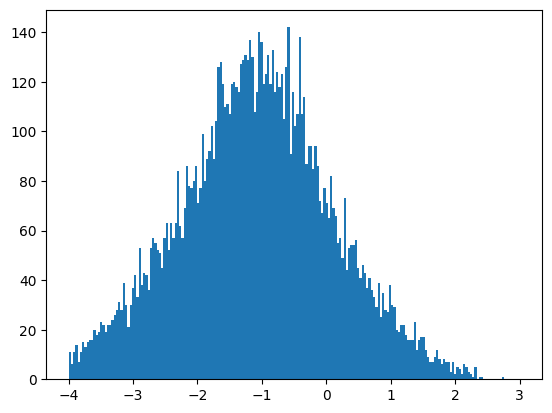

In [375]:
backgroundW2fit=[]
W2maxvalue=[]
gen=[]
gensys=[]
genstat=[]
gen1=[]
gensys1=[]
genstat1=[]
for i in range(0,20):
    backgroundW2fit.append(ShowW2_fixed_ratio(dxcut, dycut, coincut,
                                              Simdycut, Simdxcut, InSimdycut,
                                              InSimdxcut,"FAKE",.73,.01, -1, 1+i/20,Plot=False)[0])
    W2maxvalue.append(1+i/20)
backgrounddxfit=[]   
backgrounddxfit1=[]   
for i in range(0,20):
#print(i)
    try: _,_,stats1,_=DoItAll(-1,1+i/20,new_coinmin,new_coinmax,new_dymin,new_dymax,
                                       new_dxmin,new_dxmax,new_hcalmin,.2,epmin,extracut=False,cluscut=1)
    except:
        continue
    try: _,_,stats2,_=DoItAll(-1,1+i/20,new_coinmin,new_coinmax,new_dymin,new_dymax,
                                       new_dxmin,new_dxmax,new_hcalmin,.2,epmin,extracut=True,cluscut=1)
    except:
        continue
    A=stats1['GE/GM * muN']
    B=stats1['GE/GM_stat_error']
    C=stats1['GE/GM_sys_error']
    A1=stats2['GE/GM * muN']
    B1=stats2['GE/GM_stat_error']
    C1=stats2['GE/GM_sys_error']
    backgrounddxfit.append(stats1["f_bg"])
    gen.append(A)
    gensys.append(C)
    genstat.append(B)
    backgrounddxfit1.append(stats2["f_bg"])
    gen1.append(A1)
    gensys1.append(C1)
    genstat1.append(B1)
    

<ErrorbarContainer object of 3 artists>

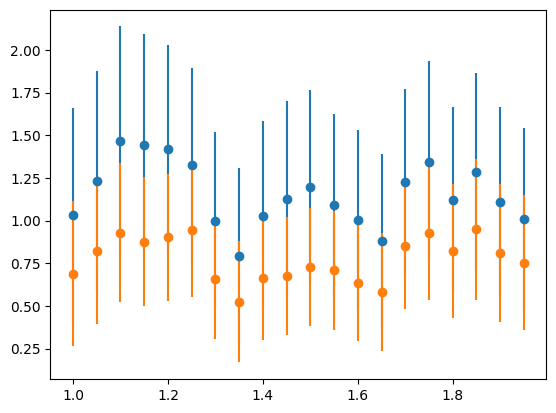

In [376]:
plt.errorbar(W2maxvalue,gen,genstat,fmt='o')
plt.errorbar(W2maxvalue,gen1,genstat1,fmt='o')

<ErrorbarContainer object of 3 artists>

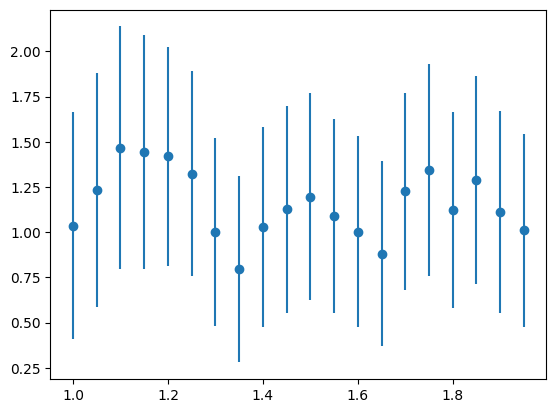

In [377]:
plt.errorbar(W2maxvalue,gen,genstat,fmt='o')

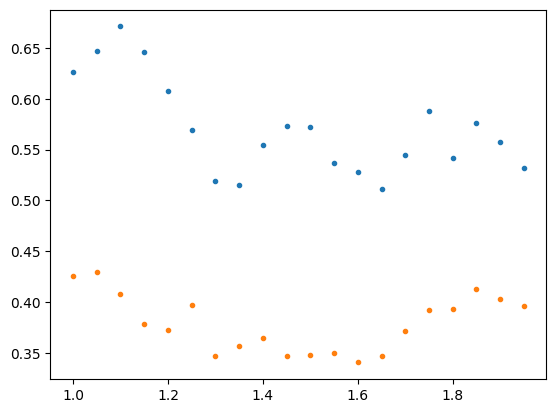

In [378]:
plt.plot(W2maxvalue,genstat,'.')
plt.plot(W2maxvalue,genstat1,'.')

<ErrorbarContainer object of 3 artists>

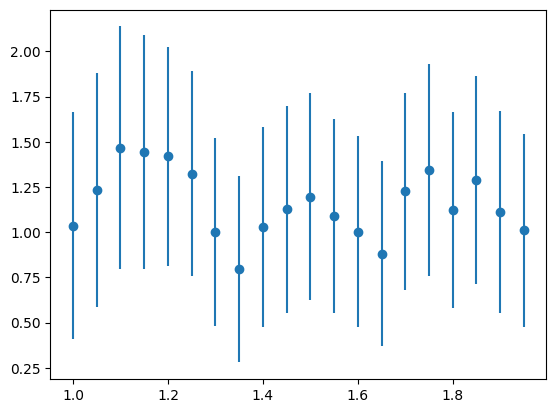

In [379]:
plt.errorbar(W2maxvalue,gen,genstat,fmt='o')

Text(0.5, 0, 'dy value Method 3')

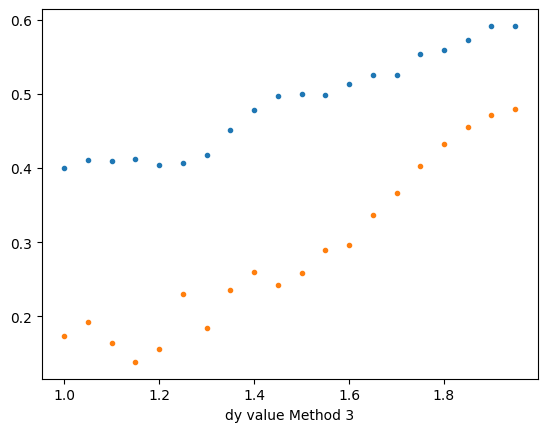

In [380]:
plt.plot(W2maxvalue,backgrounddxfit,'.')
plt.plot(W2maxvalue,backgrounddxfit1,'.')

plt.xlabel("dy value Method 3")

Text(0.5, 0, 'W2max value Method 2')

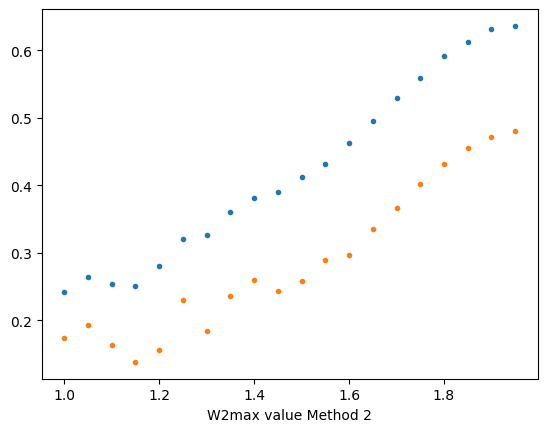

In [382]:
plt.plot(W2maxvalue,backgroundW2fit,'.')
plt.plot(W2maxvalue,backgrounddxfit1,'.')

plt.xlabel("W2max value Method 2")

Text(0.5, 0, 'W2max value')

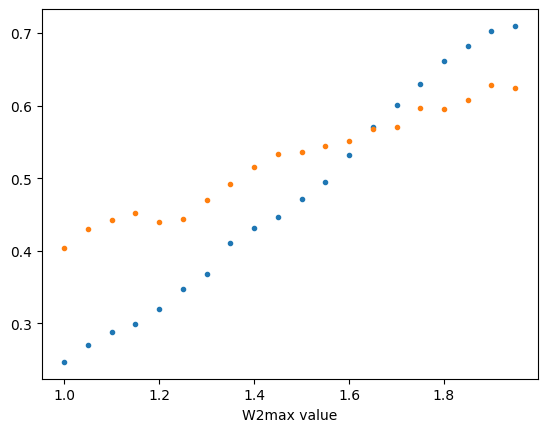

In [104]:
plt.plot(W2maxvalue,backgroundW2fit,'.')
plt.plot(W2maxvalue,backgrounddxfit,'.')

plt.xlabel("W2max value Method 1")

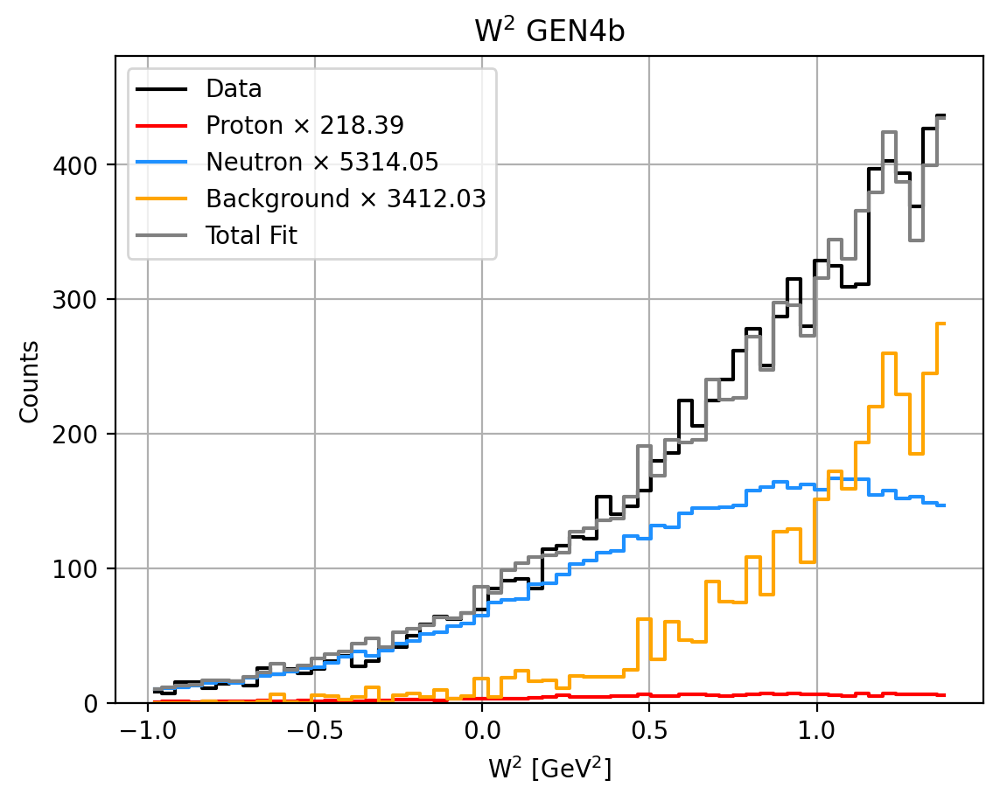

(0.3814685029833844, 0.6185314970166156)

In [384]:
ShowW2_fixed_ratio(dxcut, dycut, coincut, Simdycut, Simdxcut, InSimdycut, InSimdxcut,"FAKE",.73,.03, -1, 1.4)

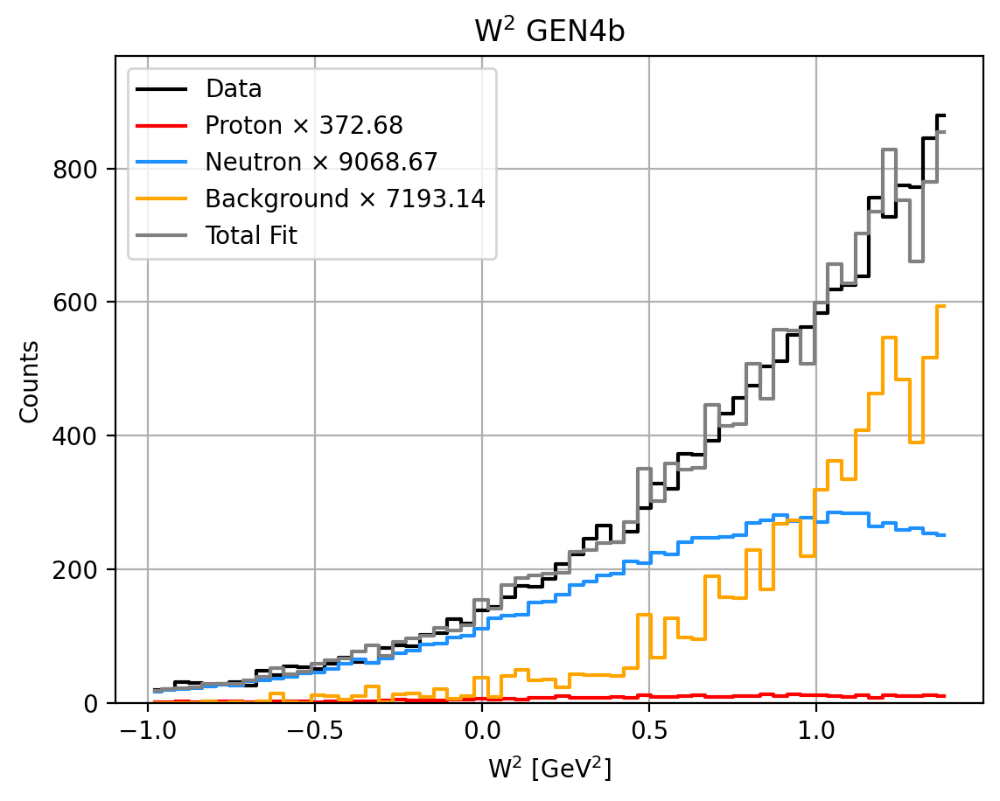

(0.43242327221708926, 0.5675767277829107)

In [386]:
ShowW2_fixed_ratio(dxcut, dycut, coincut, Simdycut, Simdxcut, InSimdycut, InSimdxcut,"FAKE",.73,.03, -1, 1.4)